# Load files

In [74]:
import pandas as pd

In [75]:
incoming_run_df = pd.read_parquet("./df/incoming_run_df.parquet")
run_data_df = pd.read_parquet("./df/run_data_df.parquet")
metrology_df = pd.read_parquet("./df/metrology_df.parquet")

# Aggregate

### Aggregate run_data_df

In [76]:
run_agg = (
    run_data_df.groupby(["Run ID", "Sensor Name"])
    .agg(
        mean=("Sensor Value", "mean"),
        std=("Sensor Value", "std"),
        min=("Sensor Value", "min"),
        max=("Sensor Value", "max"),
        last=("Sensor Value", "last"),
    )
    .reset_index()
)

run_features = run_agg.pivot_table(index="Run ID", columns="Sensor Name")
run_features.columns = [
    f"curr_{stat}_{sensor}" for stat, sensor in run_features.columns
]
run_features = run_features.reset_index()

### Aggregate incoming_run_df

In [77]:
incoming_agg = (
    incoming_run_df.groupby(["Run ID", "Sensor Name"])
    .agg(
        mean=("Sensor Value", "mean"),
        std=("Sensor Value", "std"),
        min=("Sensor Value", "min"),
        max=("Sensor Value", "max"),
        last=("Sensor Value", "last"),
    )
    .reset_index()
)

incoming_features = incoming_agg.pivot_table(index="Run ID", columns="Sensor Name")
incoming_features.columns = [
    f"incoming_{stat}_{sensor}" for stat, sensor in incoming_features.columns
]
incoming_features = incoming_features.reset_index()

# Merging

### Merge current + incoming sensor features

In [78]:
merged_features = run_features.merge(incoming_features, on="Run ID", how="outer")

##### merged_features adds run level features to each row

### Merge with metrology target data

##### metrology_df gives 49 row per run (1 for each (X, Y) point)

In [79]:
model_input_df = metrology_df.merge(merged_features, on="Run ID", how="left")

# Save for inspection/modelling

In [80]:
model_input_df.to_csv("model_input_table.csv", index=False)
model_input_df.head()

,Run ID,Run Start Time,Run End Time,X_index,Y_index,X,Y,Point Index,Measurement,curr_last_Sensor_A,...,incoming_std_Sensor_38,incoming_std_Sensor_39,incoming_std_Sensor_4,incoming_std_Sensor_40,incoming_std_Sensor_41,incoming_std_Sensor_5,incoming_std_Sensor_6,incoming_std_Sensor_7,incoming_std_Sensor_8,incoming_std_Sensor_9
0,00970470-f2f4-5759-86c4-f31fe6abdc5a,2024-01-01 04:41:20,2024-01-01 04:53:55,1,23,-143.877551,-9.183673,3,10.104178,-0.024632,...,91.958504,91.706749,0.307164,0.671355,10.310566,3.806108,0.099544,0.361217,93.416199,93.430374
1,00970470-f2f4-5759-86c4-f31fe6abdc5a,2024-01-01 04:41:20,2024-01-01 04:53:55,1,29,-143.877551,27.551020,48,10.064924,-0.024632,...,91.958504,91.706749,0.307164,0.671355,10.310566,3.806108,0.099544,0.361217,93.416199,93.430374
2,00970470-f2f4-5759-86c4-f31fe6abdc5a,2024-01-01 04:41:20,2024-01-01 04:53:55,2,34,-137.755102,58.163265,43,10.039947,-0.024632,...,91.958504,91.706749,0.307164,0.671355,10.310566,3.806108,0.099544,0.361217,93.416199,93.430374
3,00970470-f2f4-5759-86c4-f31fe6abdc5a,2024-01-01 04:41:20,2024-01-01 04:53:55,3,14,-131.632653,-64.285714,20,10.139306,-0.024632,...,91.958504,91.706749,0.307164,0.671355,10.310566,3.806108,0.099544,0.361217,93.416199,93.430374
4,00970470-f2f4-5759-86c4-f31fe6abdc5a,2024-01-01 04:41:20,2024-01-01 04:53:55,5,39,-119.387755,88.775510,8,10.037289,-0.024632,...,91.958504,91.706749,0.307164,0.671355,10.310566,3.806108,0.099544,0.361217,93.416199,93.430374


# Coordinate feature model

In [81]:
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
from lightgbm import LGBMRegressor
from math import sqrt


### Load the merged dataset

In [82]:
model_input_df = pd.read_csv("model_input_table.csv")

### Prepare features and target

In [83]:
exclude_cols = ["Run ID", "Run Start Time", "Run End Time", "Measurement"]
X = model_input_df.drop(columns=exclude_cols, errors="ignore")

### Include X and Y spatial coordinates

#### X, Y : Spatial coordinates on the wafer surface (location of the measurement)

#### Measurement : The actual quality/performance value at that location

In [84]:
X = X.select_dtypes(include=[np.number])  # keep numeric only
X["X"] = model_input_df["X"]
X["Y"] = model_input_df["Y"]

y = model_input_df["Measurement"]

### Train-Test-Split

In [85]:
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42
)

### Engineered spatial features

In [86]:
# 1️⃣ Base numeric features (you already had this)
X = X.select_dtypes(include=[np.number])  # keep numeric only

# 2️⃣ Add back raw spatial coordinates (you already had this)
X["X"] = model_input_df["X"]
X["Y"] = model_input_df["Y"]

# 3️⃣ Add normalized spatial coordinates
x_min = model_input_df["X"].min()
x_max = model_input_df["X"].max()
y_min = model_input_df["Y"].min()
y_max = model_input_df["Y"].max()

X["X_scaled"] = 2 * (model_input_df["X"] - x_min) / (x_max - x_min) - 1
X["Y_scaled"] = 2 * (model_input_df["Y"] - y_min) / (y_max - y_min) - 1

# 4️⃣ Add Radial distance and Angle
import numpy as np

X["R"] = np.sqrt(X["X_scaled"] ** 2 + X["Y_scaled"] ** 2)
X["Theta"] = np.arctan2(X["Y_scaled"], X["X_scaled"])

# 5️⃣ Optional: Polynomial terms (can help LightGBM even more)
X["X_squared"] = X["X_scaled"] ** 2
X["Y_squared"] = X["Y_scaled"] ** 2
X["XY_interaction"] = X["X_scaled"] * X["Y_scaled"]

# 6️⃣ Optional: Zone-based clustering
from sklearn.cluster import KMeans

XY_scaled = X[["X_scaled", "Y_scaled"]].values
kmeans = KMeans(n_clusters=6, random_state=42)
X["Zone_ID"] = kmeans.fit_predict(XY_scaled)

# 7️⃣ Target
y = model_input_df["Measurement"]

# 8️⃣ Show sample X
X.head()


/Users/shan/Workspace/Hackathon/Micron-AI-Challenge/.venv/lib/python3.13/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/Users/shan/Workspace/Hackathon/Micron-AI-Challenge/.venv/lib/python3.13/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/Users/shan/Workspace/Hackathon/Micron-AI-Challenge/.venv/lib/python3.13/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
/Users/shan/Workspace/Hackathon/Micron-AI-Challenge/.venv/lib/python3.13/site-packages/sklearn/cluster/_kmeans.py:237: RuntimeWarning: divide by zero encountered in matmul
  current_pot = closest_dist_sq @ sample_weight
/Users/shan/Workspace/Hackathon/Micron-AI-Challenge/.venv/lib/python3.13/site-packages/sklearn/cluster/_kmeans.py:237: RuntimeWarning: overflow encountered in matmul
  current_pot = closest_dist_sq @ sample_weight
/Users/shan/Workspace

,X_index,Y_index,X,Y,Point Index,curr_last_Sensor_A,curr_last_Sensor_B,curr_last_Sensor_C,curr_last_Sensor_D,curr_last_Sensor_E,...,incoming_std_Sensor_8,incoming_std_Sensor_9,X_scaled,Y_scaled,R,Theta,X_squared,Y_squared,XY_interaction,Zone_ID
0,1,23,-143.877551,-9.183673,3,-0.024632,-191.70132,33.579544,-0.175166,2.940996,...,93.4162,93.430374,-1.000000,-0.063830,1.002035,-3.077849,1.000000,0.004074,0.063830,5
1,1,29,-143.877551,27.551020,48,-0.024632,-191.70132,33.579544,-0.175166,2.940996,...,93.4162,93.430374,-1.000000,0.191489,1.018169,2.952394,1.000000,0.036668,-0.191489,5
2,2,34,-137.755102,58.163265,43,-0.024632,-191.70132,33.579544,-0.175166,2.940996,...,93.4162,93.430374,-0.957447,0.404255,1.039291,2.742077,0.916704,0.163422,-0.387053,5
3,3,14,-131.632653,-64.285714,20,-0.024632,-191.70132,33.579544,-0.175166,2.940996,...,93.4162,93.430374,-0.914894,-0.446809,1.018169,-2.687291,0.837030,0.199638,0.408782,4
4,5,39,-119.387755,88.775510,8,-0.024632,-191.70132,33.579544,-0.175166,2.940996,...,93.4162,93.430374,-0.829787,0.617021,1.034051,2.502207,0.688547,0.380715,-0.511996,5


### Train LightGBM Regressor

In [60]:
model = LGBMRegressor(n_estimators=100, learning_rate=0.1, random_state=42)
model.fit(X_train, y_train)

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.027901 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 71579
[LightGBM] [Info] Number of data points in the train set: 162288, number of used features: 285
[LightGBM] [Info] Start training from score 10.223959


LGBMRegressor(random_state=42)

In [90]:
lgb_model = lgb.LGBMRegressor(
    n_estimators=100, max_depth=5, learning_rate=0.1, random_state=42
)

lgb_model.fit(X_train, y_train)

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.026288 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 71857
[LightGBM] [Info] Number of data points in the train set: 162288, number of used features: 293
[LightGBM] [Info] Start training from score 10.223959
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

LGBMRegressor(max_depth=5, random_state=42)

### Evaluation

In [14]:
# y_pred = model.predict(X_test)
# rmse = mean_squared_error(y_test, y_pred, squared=False)
# f"RMSE: {rmse:.4f}"

# Error

In [15]:
y_pred = model.predict(X_test)
mse = mean_squared_error(y_test, y_pred)
rmse = sqrt(mse)
rmse

0.02796757295956767

### New RMSE after featured spatial engineering

In [94]:
from sklearn.model_selection import train_test_split

In [95]:
# Re-split with updated X and same y
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42
)

In [96]:
import lightgbm as lgb

In [97]:
y_pred = lgb_model.predict(X_test)

In [98]:
from sklearn.metrics import mean_squared_error
import numpy as np

In [100]:
from sklearn.metrics import mean_squared_error
import numpy as np

rmse = np.sqrt(mean_squared_error(y_test, y_pred))
rmse


np.float64(0.02753026633796133)

### Radial and angular feature extraction

In [103]:
# Assuming you already computed these earlier:
x_min = model_input_df["X"].min()
x_max = model_input_df["X"].max()
y_min = model_input_df["Y"].min()
y_max = model_input_df["Y"].max()

model_input_df["X_scaled"] = 2 * (model_input_df["X"] - x_min) / (x_max - x_min) - 1
model_input_df["Y_scaled"] = 2 * (model_input_df["Y"] - y_min) / (y_max - y_min) - 1


In [104]:
# Radial distance → distance from wafer center
model_input_df["R"] = np.sqrt(
    model_input_df["X_scaled"] ** 2 + model_input_df["Y_scaled"] ** 2
)

# Angular position → angle in radians
model_input_df["Theta"] = np.arctan2(
    model_input_df["Y_scaled"], model_input_df["X_scaled"]
)


In [105]:
X = X.select_dtypes(include=[np.number])  # keep numeric features

# You can now add these spatial features (if not already in X):
X["X"] = model_input_df["X"]
X["Y"] = model_input_df["Y"]
X["X_scaled"] = model_input_df["X_scaled"]
X["Y_scaled"] = model_input_df["Y_scaled"]
X["R"] = model_input_df["R"]
X["Theta"] = model_input_df["Theta"]


### new rmse after Radial and angular feature extraction

In [106]:
from sklearn.model_selection import train_test_split

# Re-split with updated X and y
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42
)


In [107]:
import lightgbm as lgb

# Initialize model
lgb_model = lgb.LGBMRegressor(
    n_estimators=100, max_depth=5, learning_rate=0.1, random_state=42
)

# Train model
lgb_model.fit(X_train, y_train)


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.026973 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 71857
[LightGBM] [Info] Number of data points in the train set: 162288, number of used features: 293
[LightGBM] [Info] Start training from score 10.223959
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

LGBMRegressor(max_depth=5, random_state=42)

In [108]:
# Predict
y_pred = lgb_model.predict(X_test)


In [110]:
from sklearn.metrics import mean_squared_error
import numpy as np

# Compute RMSE
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
rmse


np.float64(0.02753026633796133)

### Spatial heatmap

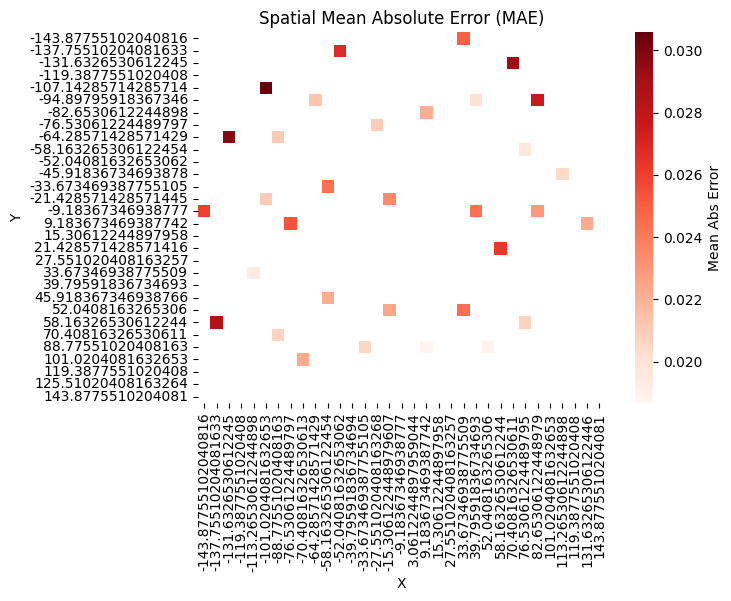

In [111]:
# 1️⃣ Compute Abs Error (if not already done)
# You need df_predictions with columns: Run ID, X, Y, Predicted, True, Abs_Error
df_predictions["Abs_Error"] = abs(df_predictions["Predicted"] - df_predictions["True"])

# 2️⃣ Build pivot table → Spatial MAE
pivot_table = (
    df_predictions.groupby(["Y", "X"])["Abs_Error"]
    .mean()
    .reset_index()
    .pivot(index="Y", columns="X", values="Abs_Error")
)

# 3️⃣ Plot clean Spatial MAE heatmap
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(8, 6))
sns.heatmap(
    pivot_table,
    cmap="Reds",
    square=True,
    cbar_kws={"label": "Mean Abs Error"},  # correct label
)
plt.title("Spatial Mean Absolute Error (MAE)")
plt.xlabel("X")
plt.ylabel("Y")
plt.tight_layout()
plt.show()


# Visualise predictions vs actuals to help understand how well the model is performing

In [16]:
import matplotlib.pyplot as plt
import seaborn as sns

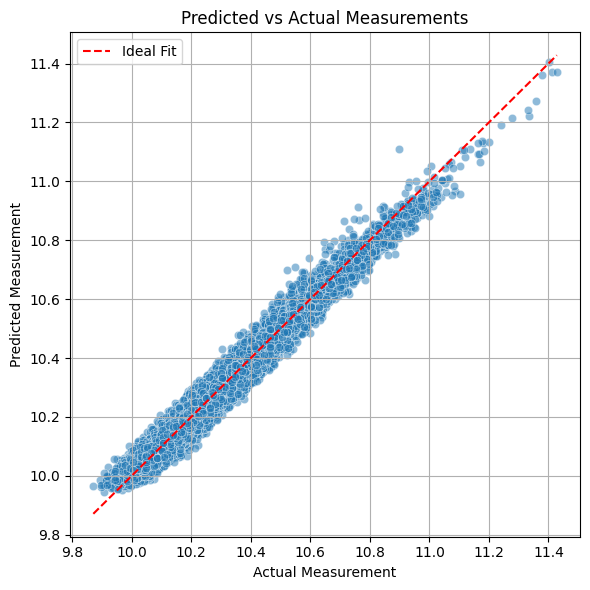

In [17]:
plt.figure(figsize=(6, 6))
sns.scatterplot(x=y_test, y=y_pred, alpha=0.5)
plt.plot(
    [y_test.min(), y_test.max()], [y_test.min(), y_test.max()], "r--", label="Ideal Fit"
)
plt.xlabel("Actual Measurement")
plt.ylabel("Predicted Measurement")
plt.title("Predicted vs Actual Measurements")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# Residual Plot (Prediction Error)

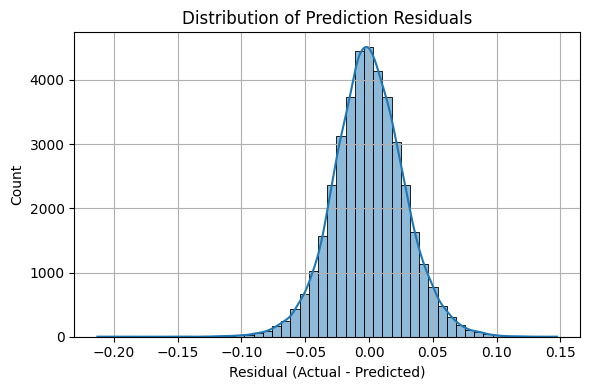

In [18]:
residuals = y_test - y_pred

plt.figure(figsize=(6, 4))
sns.histplot(residuals, bins=50, kde=True)
plt.title("Distribution of Prediction Residuals")
plt.xlabel("Residual (Actual - Predicted)")
plt.grid(True)
plt.tight_layout()
plt.show()

Centered around 0:
    Residuals are equally distributed above and below the actual value
    → Model is not biased (doesn’t consistently over/under-predict)

Roughly symmetric bell shape (Gaussian-like):
    Suggests model errors are random rather than systematic
    No strong pattern that could still be learned

Narrow spread (small standard deviation):
    Smaller error overall → better accuracy
    Wider = model is uncertain or missing key signal

For the current residual plot:
    Centered to 0: Model is unbiased on average
        Does not over-predict or under-predict across the dataset
    Symmetric bell curve:
        Model errors are random and not systematic - this is good!
        Not missing any major feature that skews the prediction in one direction
    Narrowly spread (mostly between +- 0.05)
        95% of the residual lies within +- 0.05
        Model is consistently making small error; good for regression
    
    Problem:
        Slightly longer R tail (under-prediction)

** Consider deeper models (LSTM, Transformer) for performance boost — but only if needed

# Per (X,Y) Error Analysis : Aggregate RMSE or MAE by each spatial coordinate pair.

### Construct a DataFrame from the test set

In [19]:
xy_error_df = pd.DataFrame(
    {
        "X": X_test["X"],
        "Y": X_test["Y"],
        "Actual": y_test,
        "Predicted": y_pred,
    }
)

### Compute absolute error or squared error

In [20]:
xy_error_df["abs_error"] = np.abs(xy_error_df["Actual"] - xy_error_df["Predicted"])

### Group by spatial position and compute mean error

In [21]:
xy_grouped = xy_error_df.groupby(["X", "Y"])["abs_error"].mean().reset_index()

### Heatmap or scatter plot of spatial error

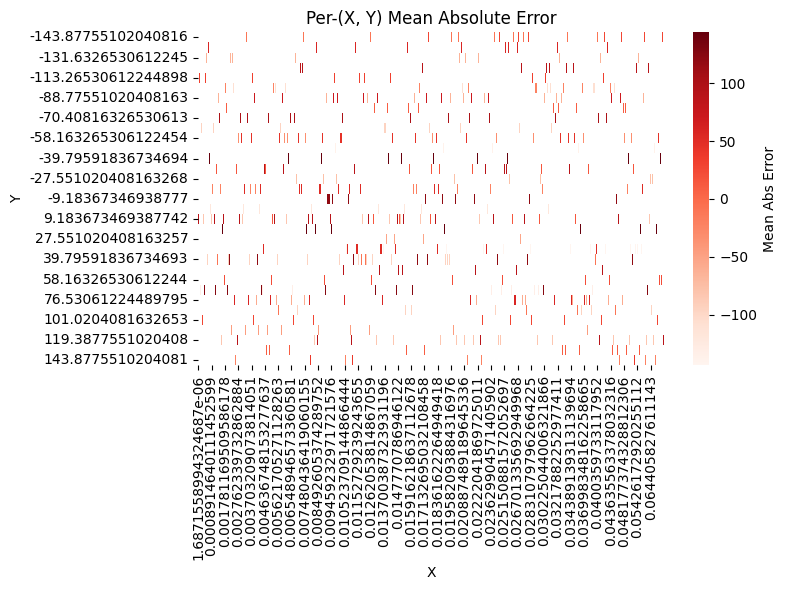

In [22]:
plt.figure(figsize=(8, 6))
pivoted = xy_error_df.pivot_table("Y", "X", "abs_error")
sns.heatmap(pivoted, cmap="Reds", cbar_kws={"label": "Mean Abs Error"})
plt.title("Per-(X, Y) Mean Absolute Error")
plt.xlabel("X")
plt.ylabel("Y")
plt.tight_layout()
plt.show()

Each square on the heatmap corresponds to a spatial coordinate (X, Y) on the wafer.
    Color = Mean Absolute Error (MAE) at that location across all test samples
    Brighter red = higher average error
    Darker = lower error (better predictions)

Uniformly low error across all points → Your model is spatially consistent 
    It generalizes well across the entire wafer.

High error in specific regions → The model struggles to predict those points accurately.
    1. High error at edges: Sensor inputs may not capture edge effects
    2. High error at center: Nonlinear effects not captured
    3. Random clusters of error: Tool-specific behavior or underfitting certain (X,Y) patterns

For the current Per (X,Y) Error Analysis:
    Mostly light colors (low errors): Most (X, Y) are white to light pink, model has low mean absolute error at the majority of wafer locations.
    Sporadic Dark Red Streaks: 
        Along certain X values and few concentrated Y bands: Higher prediction error at specific spatial positions

In [57]:
df_meta = model_input_df[["Run ID", "X", "Y"]]


In [58]:
X_train, X_test, y_train, y_test, meta_train, meta_test = train_test_split(
    X, y, df_meta, test_size=0.2, random_state=42
)


In [62]:
import lightgbm as lgb

# Initialize model
lgb_model = lgb.LGBMRegressor(
    n_estimators=100, max_depth=5, learning_rate=0.1, random_state=42
)

# Train model
lgb_model.fit(X_train, y_train)


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.025984 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 71579
[LightGBM] [Info] Number of data points in the train set: 162288, number of used features: 285
[LightGBM] [Info] Start training from score 10.223959
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

LGBMRegressor(max_depth=5, random_state=42)

In [63]:
y_pred = lgb_model.predict(X_test)


In [64]:
# Train LightGBM model
import lightgbm as lgb

lgb_model = lgb.LGBMRegressor(
    n_estimators=100, max_depth=5, learning_rate=0.1, random_state=42
)

lgb_model.fit(X_train, y_train)

# Predict
y_pred = lgb_model.predict(X_test)

# Build df_predicted
df_predicted = pd.DataFrame(
    {
        "Run ID": meta_test["Run ID"].values,
        "X": meta_test["X"].values,
        "Y": meta_test["Y"].values,
        "Predicted": y_pred,
    }
)


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.024600 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 71579
[LightGBM] [Info] Number of data points in the train set: 162288, number of used features: 285
[LightGBM] [Info] Start training from score 10.223959
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

### merge with metrology df

In [65]:
# Prepare True measurements
df_true = metrology_df[["Run ID", "X", "Y", "Measurement"]].rename(
    columns={"Measurement": "True"}
)

# Merge df_predicted with df_true
df_predictions = df_predicted.merge(df_true, on=["Run ID", "X", "Y"], how="left")

# Check sample
df_predictions.head()


,Run ID,X,Y,Predicted,True
0,ab14da3f-7f81-5f11-a891-1024e14c967b,-113.265306,33.673469,10.079795,10.083551
1,e42851b4-df47-5f47-bed9-6149d69d3221,-101.020408,-21.428571,10.117070,10.146840
2,14cec881-ef53-5f01-9a64-d867a412e1c1,39.795918,-94.897959,10.257071,10.272266
3,34096ea9-e315-565f-b7f3-777e80856d89,-58.163265,45.918367,10.687281,10.806732
4,760aa792-e88b-57f8-82a7-6244e188aa67,-119.387755,88.775510,10.122873,NaN


### merge with consumable life

In [66]:
# Prepare Consumable Life per Run ID
run_consumable_life = (
    run_data_df.groupby("Run ID")["Consumable Life"].first().reset_index()
)

# Merge
df_predictions = df_predictions.merge(run_consumable_life, on="Run ID", how="left")

# Check sample again
df_predictions.head()


,Run ID,X,Y,Predicted,True,Consumable Life
0,ab14da3f-7f81-5f11-a891-1024e14c967b,-113.265306,33.673469,10.079795,10.083551,71.397758
1,e42851b4-df47-5f47-bed9-6149d69d3221,-101.020408,-21.428571,10.117070,10.146840,234.296310
2,14cec881-ef53-5f01-9a64-d867a412e1c1,39.795918,-94.897959,10.257071,10.272266,394.801727
3,34096ea9-e315-565f-b7f3-777e80856d89,-58.163265,45.918367,10.687281,10.806732,109.120293
4,760aa792-e88b-57f8-82a7-6244e188aa67,-119.387755,88.775510,10.122873,NaN,322.535950


### Abs Error

In [67]:
# Compute Absolute Error
df_predictions["Abs_Error"] = abs(df_predictions["Predicted"] - df_predictions["True"])


In [68]:
import matplotlib.pyplot as plt
import seaborn as sns


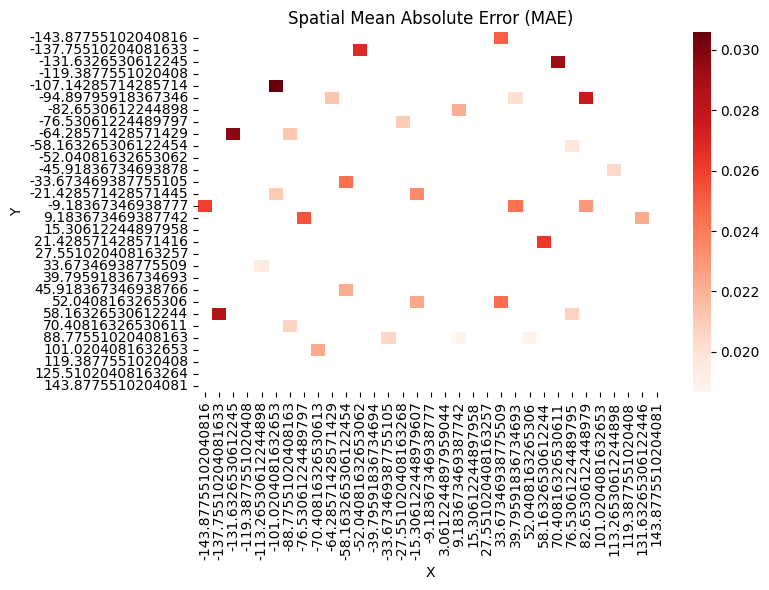

In [69]:
# Compute Spatial MAE per (X,Y)
pivot_table = (
    df_predictions.groupby(["Y", "X"])["Abs_Error"]
    .mean()
    .reset_index()
    .pivot(index="Y", columns="X", values="Abs_Error")
)

# Plot heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(pivot_table, cmap="Reds")
plt.title("Spatial Mean Absolute Error (MAE)")
plt.xlabel("X")
plt.ylabel("Y")
plt.tight_layout()
plt.show()


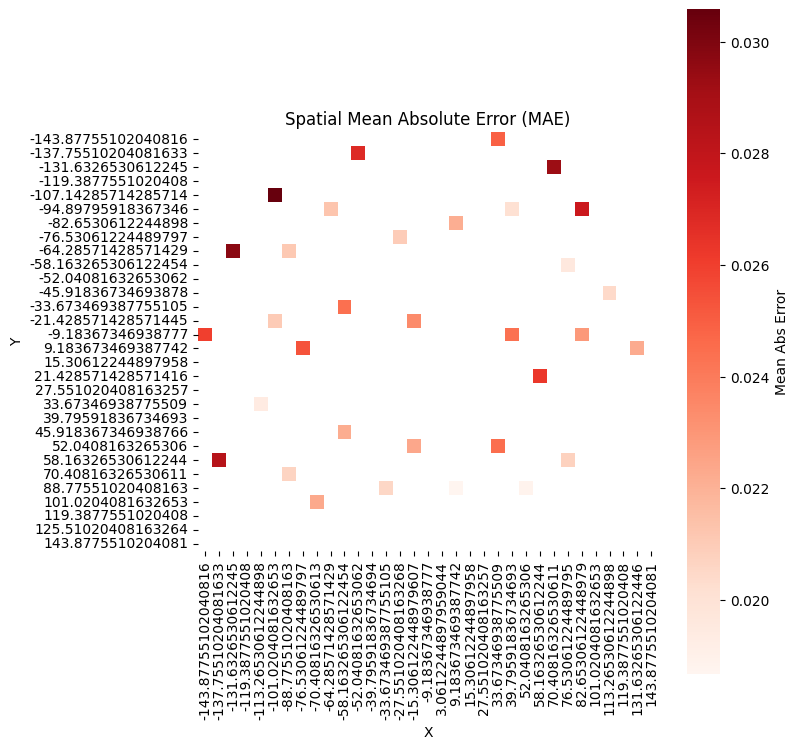

In [70]:
plt.figure(figsize=(8, 8))  # square figure
sns.heatmap(
    pivot_table,
    cmap="Reds",
    square=True,  # ensures each cell is square
    cbar_kws={"label": "Mean Abs Error"},
)
plt.title("Spatial Mean Absolute Error (MAE)")
plt.xlabel("X")
plt.ylabel("Y")
plt.tight_layout()
plt.show()


<Axes: xlabel='X', ylabel='Y'>

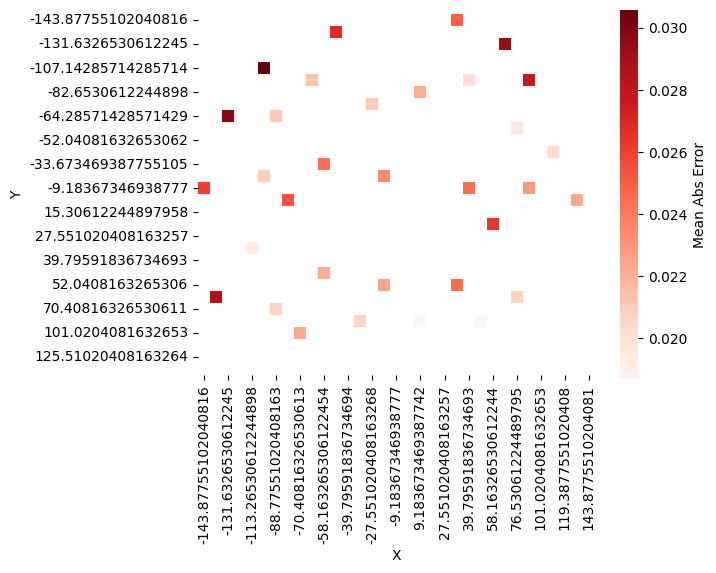

In [71]:
sns.heatmap(
    pivot_table,
    cmap="Reds",
    square=True,
    vmin=pivot_table.min().min(),
    vmax=pivot_table.max().max(),
    cbar_kws={"label": "Mean Abs Error"},
)


In [72]:
plt.text(
    x=center_x_index,
    y=center_y_index,
    s="✔️ Low Error",
    ha="center",
    va="center",
    fontsize=10,
    color="black",
)


NameError: name 'center_x_index' is not defined

### Feature Engineering to improve the model

In [23]:
model_input_df["X2"] = model_input_df["X"] ** 2
model_input_df["Y2"] = model_input_df["Y"] ** 2
model_input_df["XY"] = model_input_df["X"] * model_input_df["Y"]

### Attach predictions back to the original rows

In [24]:
toolwise = model_input_df.iloc[y_test.index].copy()

### Add predictions and error

In [25]:
toolwise["Predicted"] = y_pred
toolwise["Actual"] = y_test.values
toolwise["Abs Error"] = abs(toolwise["Actual"] - toolwise["Predicted"])

### Run a breakdown of prediction error by Tool ID 

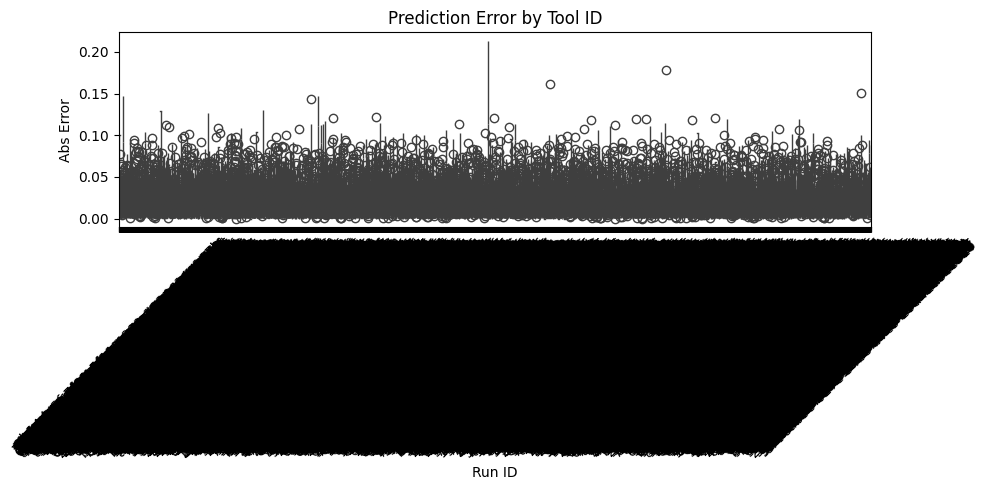

In [26]:
plt.figure(figsize=(10, 5))
sns.boxplot(x="Run ID", y="Abs Error", data=toolwise)
plt.xticks(rotation=45)
plt.title("Prediction Error by Tool ID")
plt.tight_layout()
plt.show()

Error is below 0.1 : Healthy error range
No dominant tool with clearly worse performance across the board
Model generalises well across most tool

A few spikes of error beyond 0.15–0.20:
    These tools could be outliers or tools with few training samples (higher variance)

Overcrowding of X-Axis:
    Hard to visualise exactly which tools are problematic

### Group tools by average error : Instead of plotting every single point, compute per-tool summary

In [27]:
tool_errors = toolwise.groupby("Run ID")["Abs Error"].mean().reset_index()
tool_errors = tool_errors.sort_values("Abs Error", ascending=False)

### Bar plot for top-k worst tools

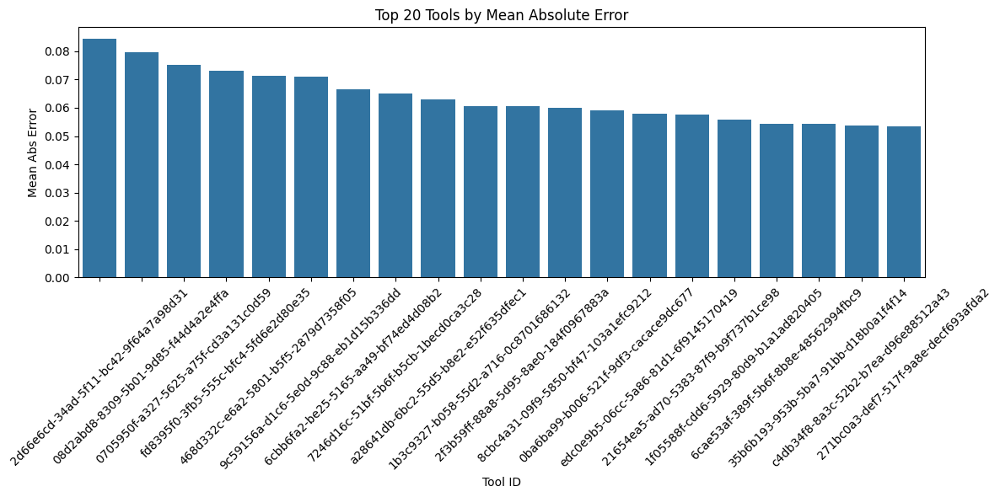

In [28]:
top_k = 20
plt.figure(figsize=(12, 6))
sns.barplot(x="Run ID", y="Abs Error", data=tool_errors.head(top_k))
plt.xticks(rotation=45)
plt.title(f"Top {top_k} Tools by Mean Absolute Error")
plt.ylabel("Mean Abs Error")
plt.xlabel("Tool ID")
plt.tight_layout()
plt.show()


# Combine with Consumable Life or Step ID : Reveals degradation-driven errors

### Merge metadata into toolwise

In [29]:
# Step 1a: Get per-run average Consumable Life and first Step ID
meta_map = (
    run_data_df.groupby("Run ID")
    .agg({"Consumable Life": "mean", "Step ID": "first"})
    .reset_index()
)

# Step 1b: Merge into toolwise
toolwise = toolwise.merge(meta_map, on="Run ID", how="left")


### Analyze Error vs. Consumable Life

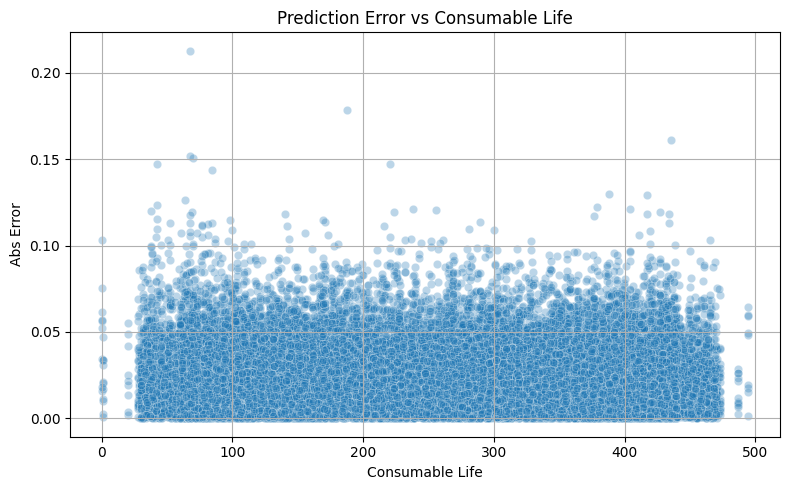

In [30]:
plt.figure(figsize=(8, 5))
sns.scatterplot(data=toolwise, x="Consumable Life", y="Abs Error", alpha=0.3)
plt.title("Prediction Error vs Consumable Life")
plt.xlabel("Consumable Life")
plt.ylabel("Abs Error")
plt.grid(True)
plt.tight_layout()
plt.show()

Check if older tools (more worn out) lead to higher error.
    Upward trend → older tools → worse predictions → model missing degradation effects
    Flat = good generalization across all tool ages

*** Add consumable life as a feature to the model

### Regression trendline

/Users/shan/Workspace/Hackathon/Micron-AI-Challenge/.venv/lib/python3.13/site-packages/numpy/linalg/_linalg.py:3383: RuntimeWarning: divide by zero encountered in matmul
  return _core_matmul(x1, x2)
/Users/shan/Workspace/Hackathon/Micron-AI-Challenge/.venv/lib/python3.13/site-packages/numpy/linalg/_linalg.py:3383: RuntimeWarning: overflow encountered in matmul
  return _core_matmul(x1, x2)
/Users/shan/Workspace/Hackathon/Micron-AI-Challenge/.venv/lib/python3.13/site-packages/numpy/linalg/_linalg.py:3383: RuntimeWarning: invalid value encountered in matmul
  return _core_matmul(x1, x2)


<Axes: xlabel='Consumable Life', ylabel='Abs Error'>

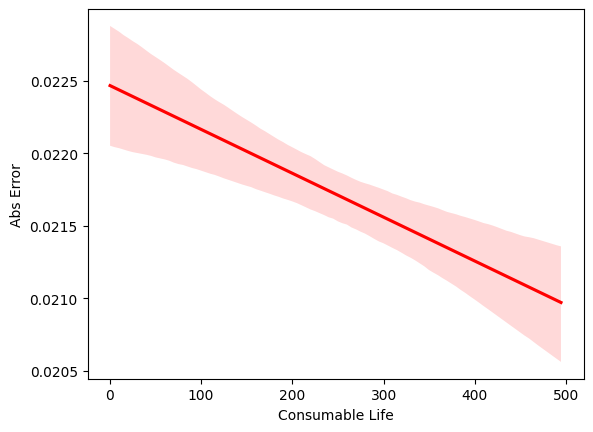

In [31]:
sns.regplot(
    data=toolwise, x="Consumable Life", y="Abs Error", scatter=False, color="red"
)

Clear downward trend: Prediction error decreases as the tool ages.
    Counterintuitive — we often expect tools to degrade with age.

Main trend:
The red line is sloping downward → as Consumable Life increases, the Abs Error decreases.
    Model is making slightly smaller errors on older tools (higher Consumable Life).
    Model performs better on older tools, worse on new tools.

### Spatial MAE for each 49 points

In [52]:
# We take metrology_df → true target
df_true = metrology_df[["Run ID", "X", "Y", "Measurement"]].rename(
    columns={"Measurement": "True"}
)


### Plot Error vs Tool Run Order or Calendar Time

In [32]:
toolwise = model_input_df.iloc[y_test.index].copy()
toolwise["Prediction"] = y_pred
toolwise["Actual"] = y_test.to_numpy()

# Now add Tool ID and Process Step again
tool_id_map = run_data_df[["Run ID", "Tool ID"]].drop_duplicates()
process_step_map = run_data_df[["Run ID", "Process Step"]].drop_duplicates()

toolwise = toolwise.merge(tool_id_map, on="Run ID", how="left")
toolwise = toolwise.merge(process_step_map, on="Run ID", how="left")

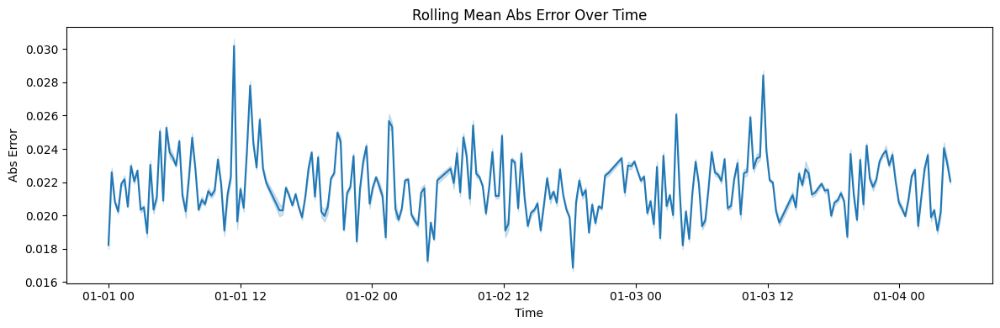

In [33]:
toolwise["Run Start Time"] = pd.to_datetime(toolwise["Run Start Time"])
toolwise["Abs Error"] = abs(toolwise["Actual"] - toolwise["Prediction"])

# Sort by time and plot
toolwise_sorted = toolwise.sort_values("Run Start Time")
toolwise_sorted["Rolling Error"] = toolwise_sorted["Abs Error"].rolling(100).mean()

plt.figure(figsize=(12, 4))
sns.lineplot(x="Run Start Time", y="Rolling Error", data=toolwise_sorted)
plt.title("Rolling Mean Abs Error Over Time")
plt.ylabel("Abs Error")
plt.xlabel("Time")
plt.tight_layout()
plt.show()


This will show a smooth trend of error over time, helping you identify: Drift, Sudden jumps,Seasonal patterns,Tool degradation trends

### Group by Tool ID : Why: Reveals if some tools consistently perform better or worse 

In [34]:
# plt.figure(figsize=(12, 6))
# sns.boxplot(x="Run ID", y="Abs Error", data=toolwise)
# plt.xticks(rotation=45)
# plt.title("Prediction Error by Tool ID")
# plt.tight_layout()
# plt.show()


In [35]:
import matplotlib.pyplot as plt
import seaborn as sns

### Group by Plot Error Trend Per Tool

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_7130/3718685817.py:2: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


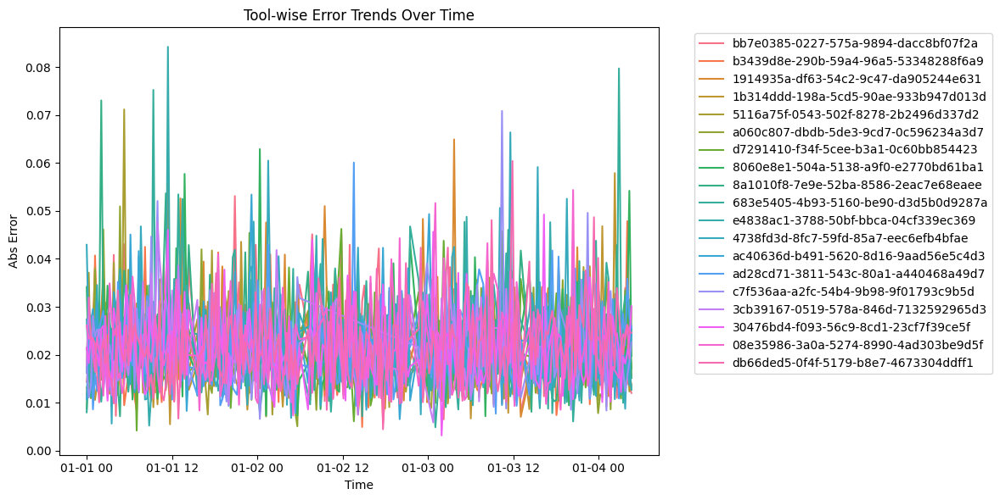

In [36]:
plt.figure(figsize=(12, 6))
sns.lineplot(
    data=toolwise.sort_values("Run Start Time"),
    x="Run Start Time",
    y="Abs Error",
    hue="Tool ID",
    estimator="mean",
    ci=None,
)
plt.title("Tool-wise Error Trends Over Time")
plt.ylabel("Abs Error")
plt.xlabel("Time")
plt.legend(bbox_to_anchor=(1.05, 1), loc="upper left")
plt.tight_layout()
plt.show()


### Analyze Error by Step ID

In [37]:
plt.figure(figsize=(10, 5))
sns.boxplot(data=toolwise, x="Step ID", y="Abs Error")
plt.xticks(rotation=45)
plt.title("Prediction Error by Step ID")
plt.ylabel("Abs Error")
plt.tight_layout()
plt.show()


ValueError: Could not interpret value `Step ID` for `x`. An entry with this name does not appear in `data`.

<Figure size 1000x500 with 0 Axes>

In [ ]:
toolwise["Step ID"].value_counts()

Step ID
Step_0    40572
Name: count, dtype: int64

In [ ]:
step_id_map = (
    run_data_df.sort_values("Time Stamp")
    .groupby("Run ID")["Step ID"]
    .last()
    .reset_index()
)

In [ ]:
toolwise = toolwise.merge(step_id_map, on="Run ID", how="left")

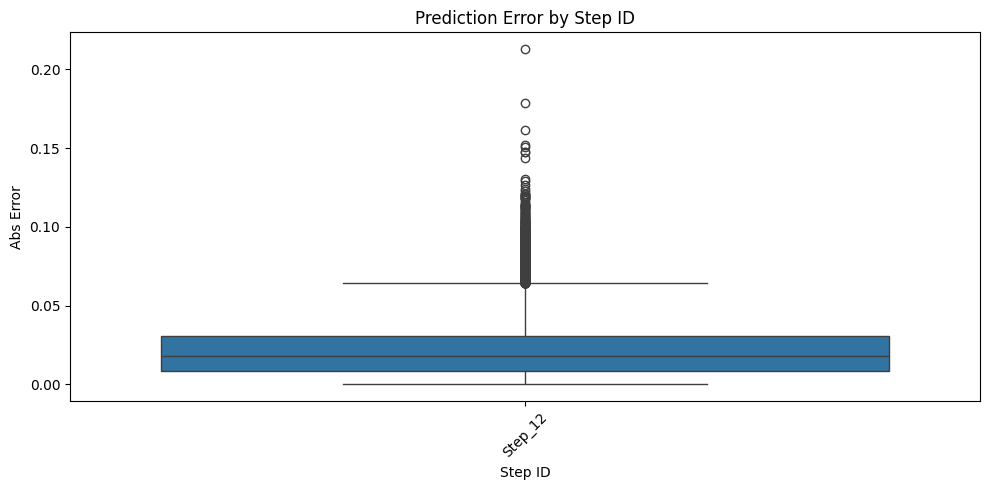

In [ ]:
plt.figure(figsize=(10, 5))
sns.boxplot(data=toolwise, x="Step ID", y="Abs Error")
plt.xticks(rotation=45)
plt.title("Prediction Error by Step ID")
plt.ylabel("Abs Error")
plt.tight_layout()
plt.show()


# Prediction Error per Step ID

###  Aggregate run_data_df per (Run ID, Step ID)

In [ ]:
# First, aggregate run_data_df per Run ID, Step ID, Sensor Name
agg_funcs = ["mean", "std", "min", "max"]

step_features = (
    run_data_df.groupby(["Run ID", "Step ID", "Sensor Name"])["Sensor Value"]
    .agg(agg_funcs)
    .reset_index()
)

# Pivot to wide format: one row per (Run ID, Step ID), columns like Sensor_1_mean, Sensor_1_std, etc.
step_features_wide = step_features.pivot_table(
    index=["Run ID", "Step ID"],
    columns="Sensor Name",
    values=["mean", "std", "min", "max"],
)

# Flatten column names
step_features_wide.columns = [
    f"{stat}_{sensor}" for stat, sensor in step_features_wide.columns
]

step_features_wide = step_features_wide.reset_index()


### Merge with toolwise to get Metrology Error

In [ ]:
# Prepare a DataFrame of (Run ID → final Abs Error per Run)
run_error_df = toolwise.groupby("Run ID")["Abs Error"].mean().reset_index()
run_error_df = run_error_df.rename(columns={"Abs Error": "Final Metrology Abs Error"})

# Merge into step_features_wide
stepwise_df = step_features_wide.merge(run_error_df, on="Run ID", how="left")


### Analyze Error vs Step ID : Error Distribution by Step ID

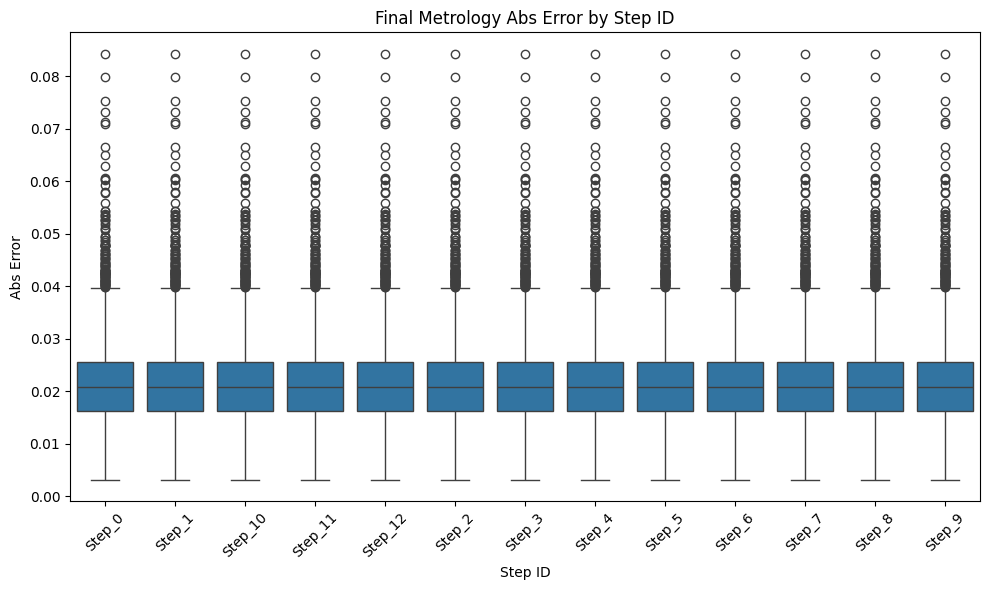

In [ ]:
plt.figure(figsize=(10, 6))
sns.boxplot(x="Step ID", y="Final Metrology Abs Error", data=stepwise_df)
plt.title("Final Metrology Abs Error by Step ID")
plt.ylabel("Abs Error")
plt.xlabel("Step ID")
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

X-axis : Step ID (Step_0, Step_1, ..., Step_12)
Y-axis : Final Metrology Abs Error → the final wafer measurement error after all steps.
For each Step ID, the box shows the distribution of Metrology error across Runs that included this step.

Interpetation: 
The box shows the interquartile range (middle 50%) of Metrology error.
The line inside the box → median error.
The whiskers and dots → spread and outliers.

This shows:
    All Step IDs show very similar distributions:
    Median error ~ 0.02
    Interquartile range ~ 0.015 to ~0.03
    Outliers go to ~0.08

    No Step ID seems to cause consistently higher or lower final error
    Either the process is well-balanced across Steps,or the Step ID itself is not the dominant source of variation in your Metrology error.

### Analyze Error vs Step ID : Correlation of Sensors per Step with Final Error

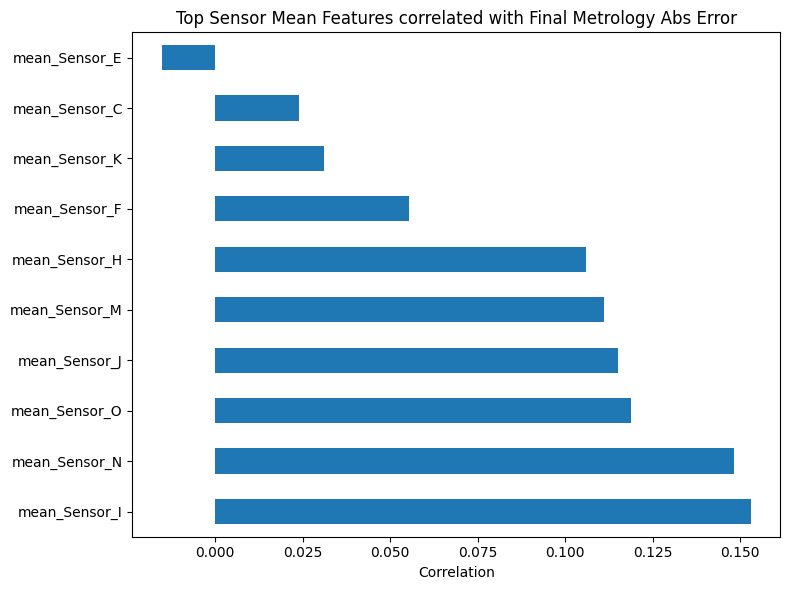

In [ ]:
# Example: correlation of Sensor_1_mean with Final Error
sensor_cols = [col for col in stepwise_df.columns if "mean" in col]

corrs = {}
for col in sensor_cols:
    corr = stepwise_df[col].corr(stepwise_df["Final Metrology Abs Error"])
    corrs[col] = corr

# Plot top correlations
top_corrs = pd.Series(corrs).sort_values(key=lambda x: abs(x), ascending=False).head(10)

plt.figure(figsize=(8, 6))
top_corrs.plot(kind="barh")
plt.title("Top Sensor Mean Features correlated with Final Metrology Abs Error")
plt.xlabel("Correlation")
plt.tight_layout()
plt.show()


X-axis : Correlation coefficient between the sensor mean and Final Metrology Abs Error.
    Positive correlation → when sensor mean is high, error tends to be high.
    Negative correlation → when sensor mean is high, error tends to be low. (In this case, all are positive.)

Y-axis → Sensor (aggregated mean across runs, probably per Step ID).

mean_Sensor_I and mean_Sensor_N have the strongest correlations (~0.15).
    This suggests: when these sensors have higher mean values → the wafer Metrology Error tends to increase.

mean_Sensor_O, mean_Sensor_J, mean_Sensor_M → also moderately predictive.

sensors like mean_Sensor_E and mean_Sensor_C → low correlation → probably not important for driving final error.

### Sensor Value vs. Consumable Life Trend

In [ ]:
sensor_cols = [col for col in sensor_plot_df.columns if "mean_" in col]

sensor_cols

['curr_mean_Sensor_A',
 'curr_mean_Sensor_B',
 'curr_mean_Sensor_C',
 'curr_mean_Sensor_D',
 'curr_mean_Sensor_E',
 'curr_mean_Sensor_F',
 'curr_mean_Sensor_G',
 'curr_mean_Sensor_H',
 'curr_mean_Sensor_I',
 'curr_mean_Sensor_J',
 'curr_mean_Sensor_K',
 'curr_mean_Sensor_L',
 'curr_mean_Sensor_M',
 'curr_mean_Sensor_N',
 'curr_mean_Sensor_O',
 'incoming_mean_Sensor_1',
 'incoming_mean_Sensor_10',
 'incoming_mean_Sensor_11',
 'incoming_mean_Sensor_12',
 'incoming_mean_Sensor_13',
 'incoming_mean_Sensor_14',
 'incoming_mean_Sensor_15',
 'incoming_mean_Sensor_16',
 'incoming_mean_Sensor_17',
 'incoming_mean_Sensor_18',
 'incoming_mean_Sensor_19',
 'incoming_mean_Sensor_2',
 'incoming_mean_Sensor_20',
 'incoming_mean_Sensor_21',
 'incoming_mean_Sensor_22',
 'incoming_mean_Sensor_23',
 'incoming_mean_Sensor_24',
 'incoming_mean_Sensor_25',
 'incoming_mean_Sensor_26',
 'incoming_mean_Sensor_27',
 'incoming_mean_Sensor_28',
 'incoming_mean_Sensor_29',
 'incoming_mean_Sensor_3',
 'incoming_mea

In [ ]:
# Derive sensor_cols dynamically (robust version)
sensor_cols = [col for col in sensor_plot_df.columns if "mean_" in col]

# Compute correlation
corr = sensor_plot_df[sensor_cols + ["Abs Error"]].corr()

# Get top sensors
top_sensors = corr["Abs Error"].abs().sort_values(ascending=False).index[1:11]

"Top Sensors:", top_sensors.tolist()


('Top Sensors:',
 ['curr_mean_Sensor_N',
  'curr_mean_Sensor_I',
  'curr_mean_Sensor_O',
  'curr_mean_Sensor_J',
  'curr_mean_Sensor_F',
  'curr_mean_Sensor_M',
  'curr_mean_Sensor_H',
  'curr_mean_Sensor_D',
  'curr_mean_Sensor_K',
  'curr_mean_Sensor_C'])

In [ ]:
# Merge Consumable Life into model_input_df
consumable_map = run_data_df[["Run ID", "Consumable Life"]].drop_duplicates()
sensor_plot_df = model_input_df.merge(consumable_map, on="Run ID", how="left")

# Merge Abs Error from toolwise
abs_error_map = toolwise.groupby("Run ID")["Abs Error"].mean().reset_index()
sensor_plot_df = sensor_plot_df.merge(abs_error_map, on="Run ID", how="left")

### Split sensir columns by type

In [ ]:
curr_sensor_cols = [col for col in sensor_plot_df.columns if "curr_mean_" in col]
incoming_sensor_cols = [
    col for col in sensor_plot_df.columns if "incoming_mean_" in col
]

### Correlation for current sensors

In [ ]:
# Curr Sensors Correlation
curr_corr = sensor_plot_df[curr_sensor_cols + ["Abs Error"]].corr()
curr_top_sensors = curr_corr["Abs Error"].abs().sort_values(ascending=False).index[1:11]

"Top Curr Sensors:", curr_top_sensors.tolist()


Top Curr Sensors: ['curr_mean_Sensor_N', 'curr_mean_Sensor_I', 'curr_mean_Sensor_O', 'curr_mean_Sensor_J', 'curr_mean_Sensor_F', 'curr_mean_Sensor_M', 'curr_mean_Sensor_H', 'curr_mean_Sensor_D', 'curr_mean_Sensor_K', 'curr_mean_Sensor_C']


### Correlation for incoming sensors

In [ ]:
incoming_corr = sensor_plot_df[incoming_sensor_cols + ["Abs Error"]].corr()
incoming_top_sensors = (
    incoming_corr["Abs Error"].abs().sort_values(ascending=False).index[1:11]
)

"Top Incoming Sensors:", incoming_top_sensors.tolist()


('Top Incoming Sensors:',
 ['incoming_mean_Sensor_14',
  'incoming_mean_Sensor_31',
  'incoming_mean_Sensor_33',
  'incoming_mean_Sensor_37',
  'incoming_mean_Sensor_1',
  'incoming_mean_Sensor_5',
  'incoming_mean_Sensor_13',
  'incoming_mean_Sensor_10',
  'incoming_mean_Sensor_15',
  'incoming_mean_Sensor_23'])

### Current sensor VS Consumable Life

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_9630/1959173939.py:4: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


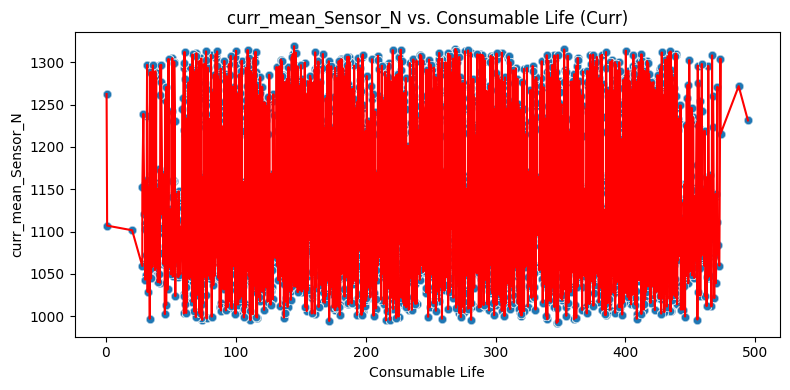

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_9630/1959173939.py:4: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


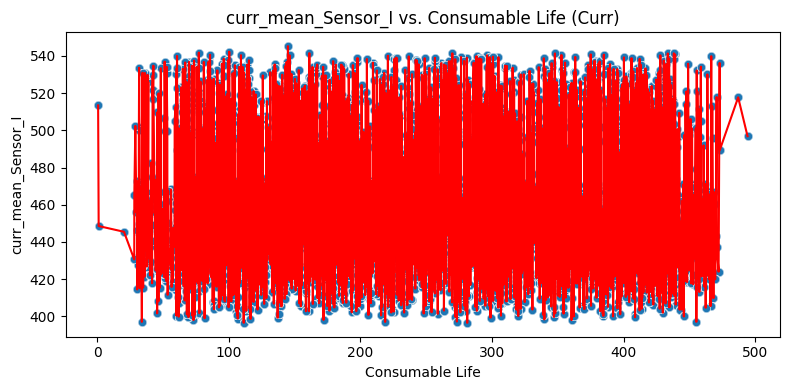

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_9630/1959173939.py:4: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


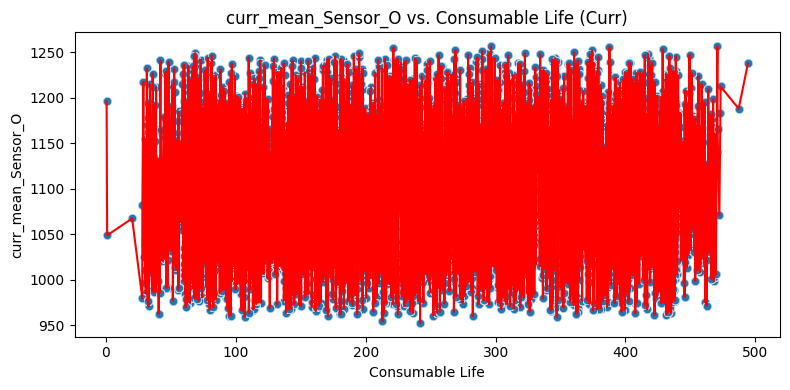

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_9630/1959173939.py:4: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


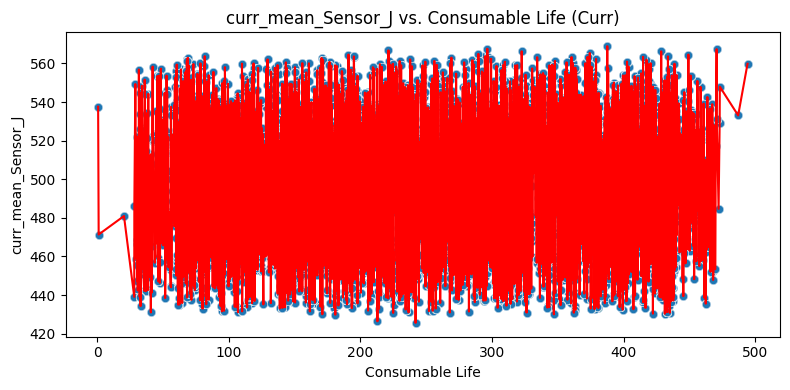

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_9630/1959173939.py:4: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


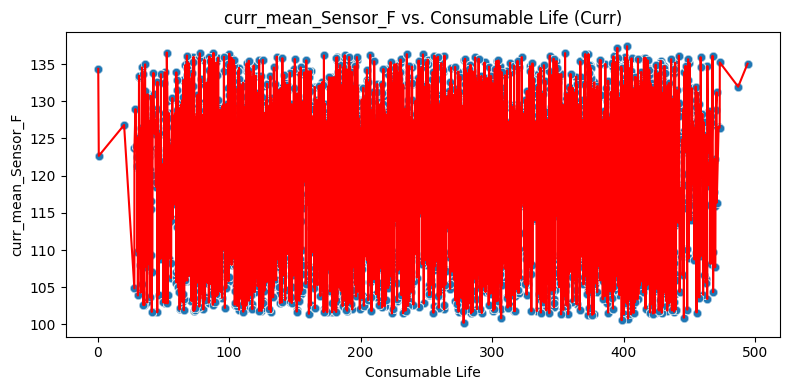

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_9630/1959173939.py:4: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


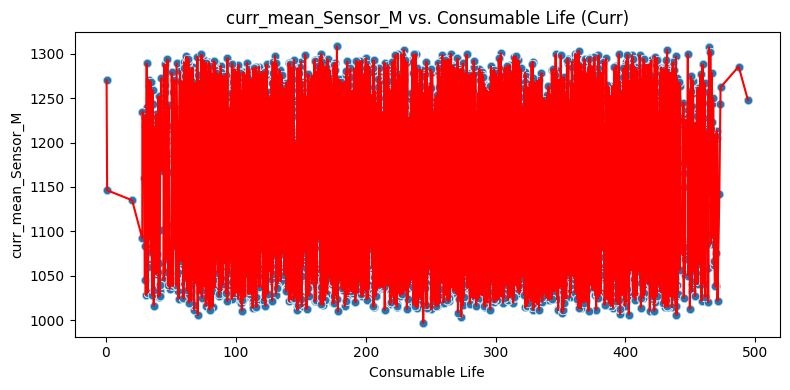

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_9630/1959173939.py:4: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


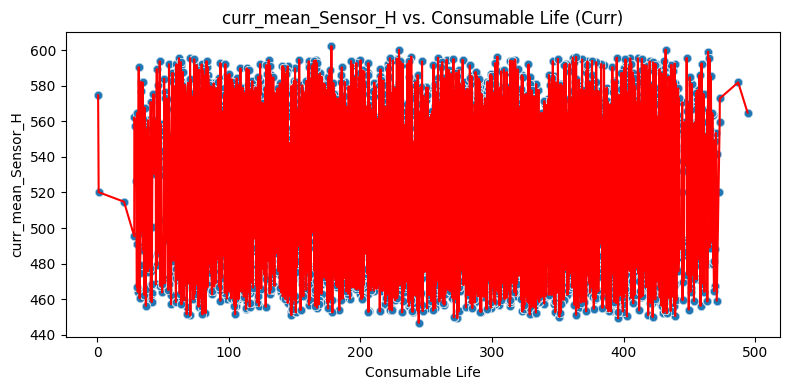

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_9630/1959173939.py:4: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


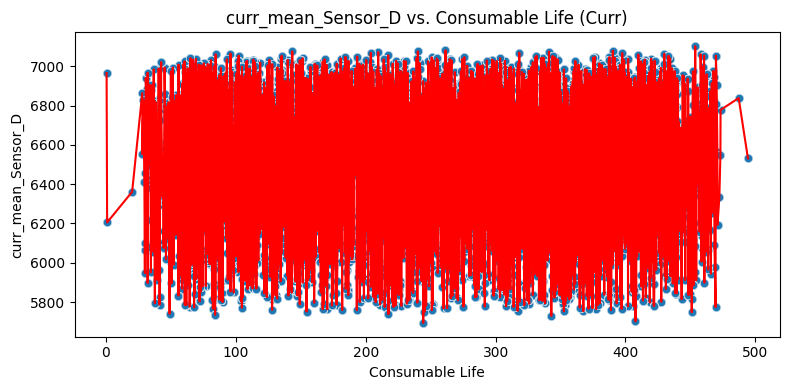

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_9630/1959173939.py:4: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


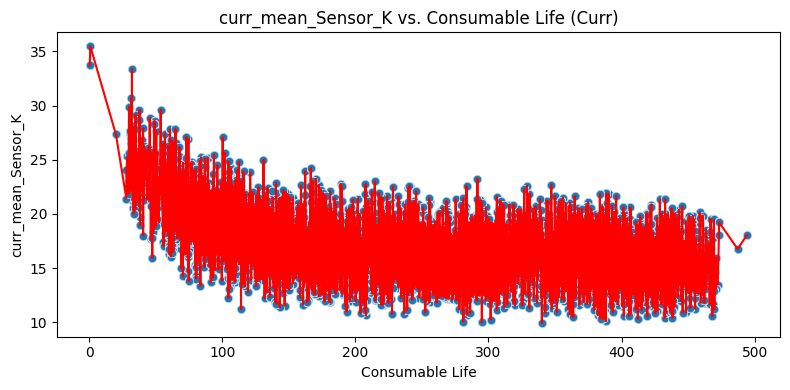

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_9630/1959173939.py:4: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


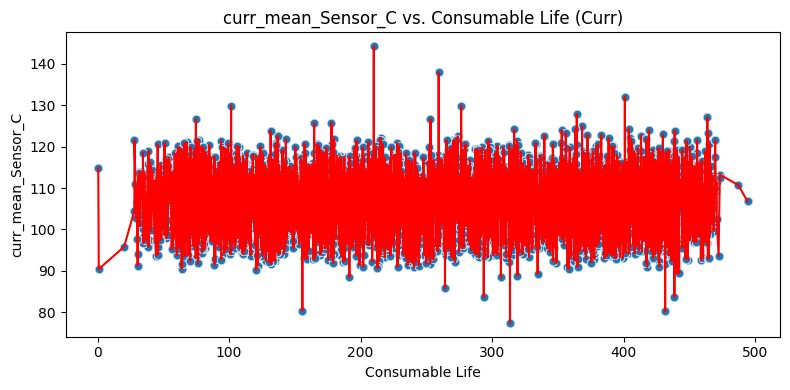

In [ ]:
for sensor in curr_top_sensors:
    plt.figure(figsize=(8, 4))
    sns.scatterplot(x="Consumable Life", y=sensor, data=sensor_plot_df, alpha=0.3)
    sns.lineplot(
        x="Consumable Life", y=sensor, data=sensor_plot_df, color="red", ci=None
    )
    plt.title(f"{sensor} vs. Consumable Life (Curr)")
    plt.tight_layout()
    plt.show()


### Plot incoming sensors VS Consumable Life

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_9630/3192801755.py:4: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


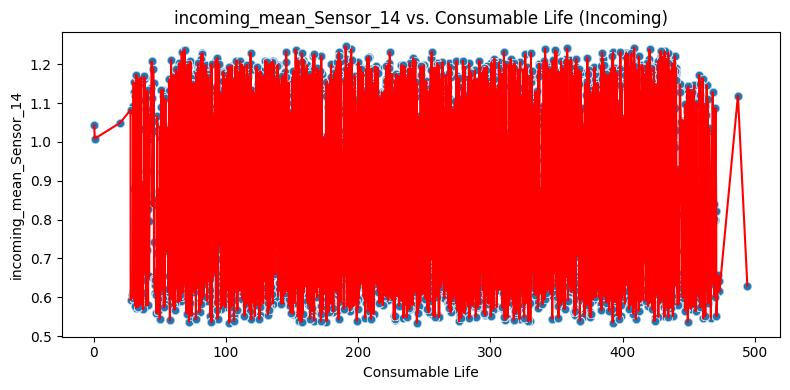

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_9630/3192801755.py:4: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


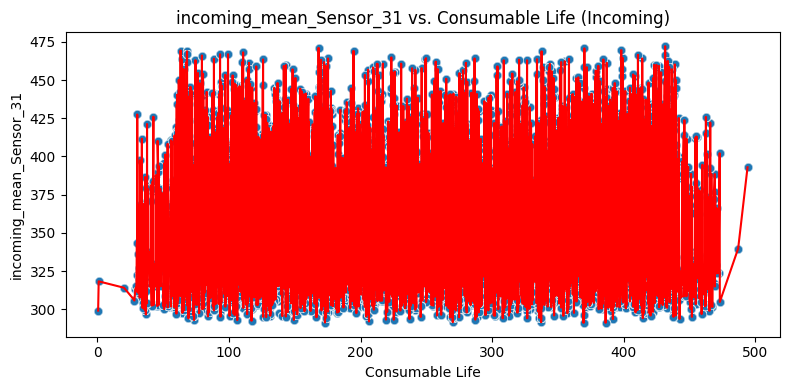

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_9630/3192801755.py:4: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


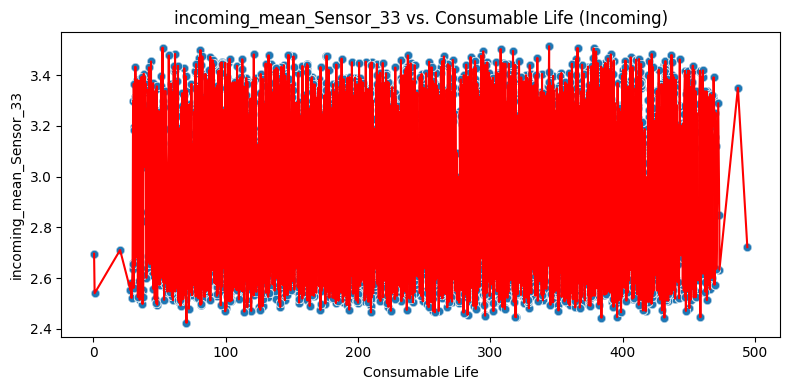

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_9630/3192801755.py:4: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


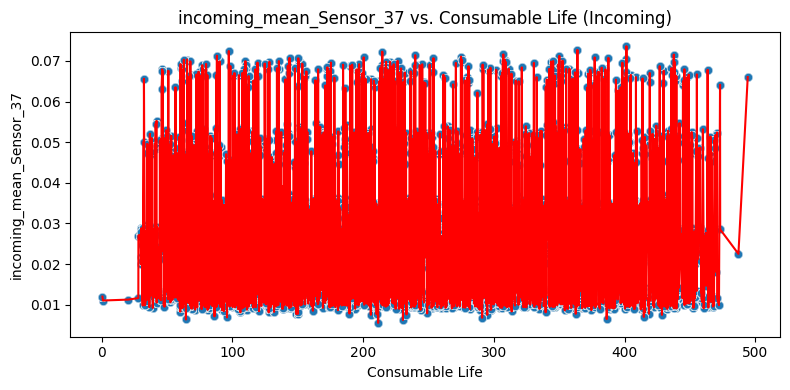

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_9630/3192801755.py:4: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


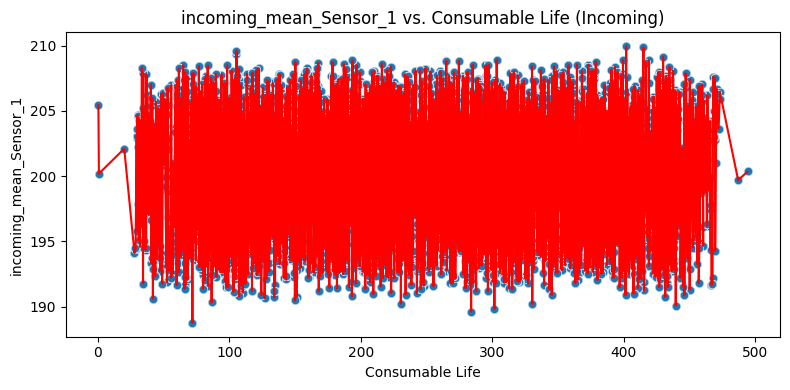

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_9630/3192801755.py:4: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


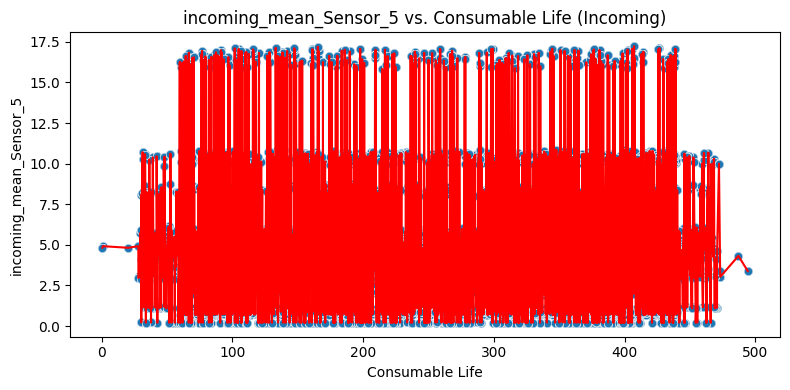

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_9630/3192801755.py:4: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


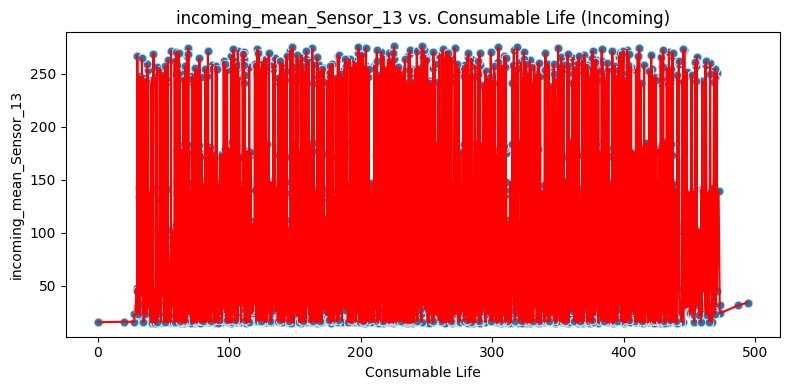

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_9630/3192801755.py:4: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


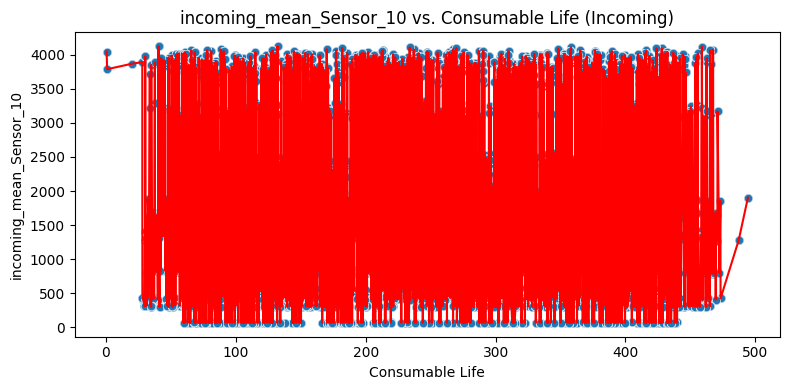

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_9630/3192801755.py:4: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


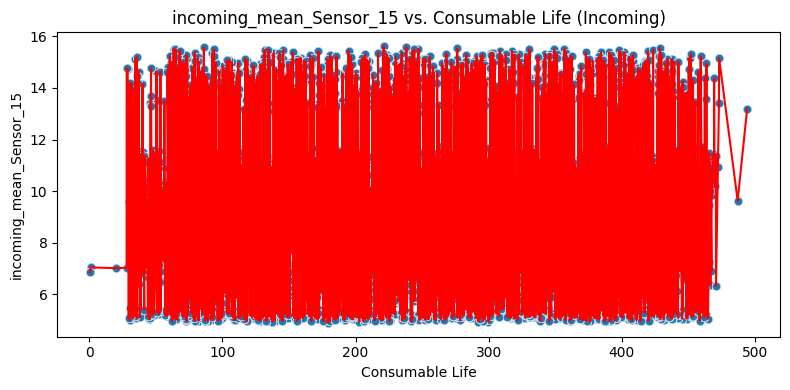

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_9630/3192801755.py:4: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


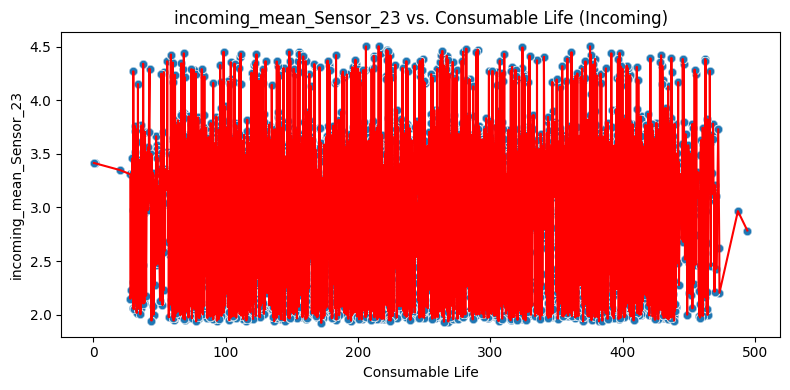

In [ ]:
for sensor in incoming_top_sensors:
    plt.figure(figsize=(8, 4))
    sns.scatterplot(x="Consumable Life", y=sensor, data=sensor_plot_df, alpha=0.3)
    sns.lineplot(
        x="Consumable Life", y=sensor, data=sensor_plot_df, color="red", ci=None
    )
    plt.title(f"{sensor} vs. Consumable Life (Incoming)")
    plt.tight_layout()
    plt.show()


### Sensor Value by Tool ID

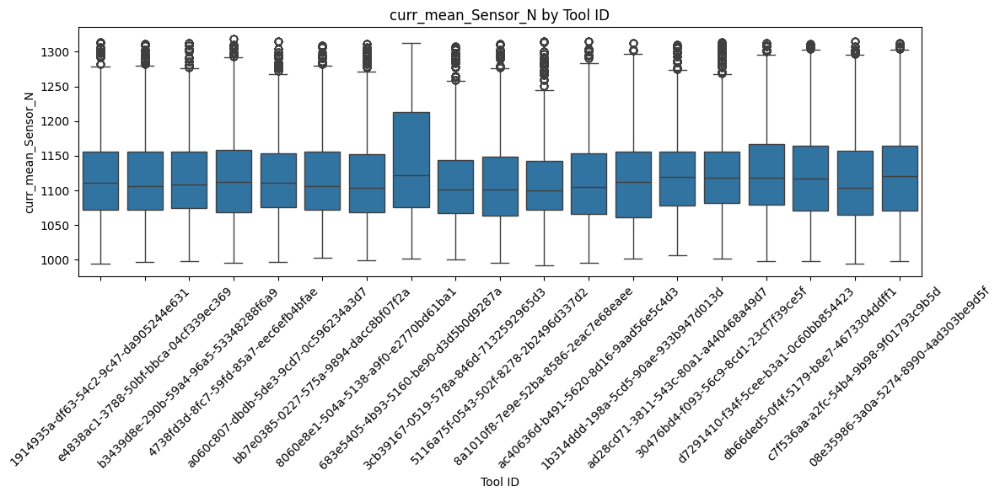

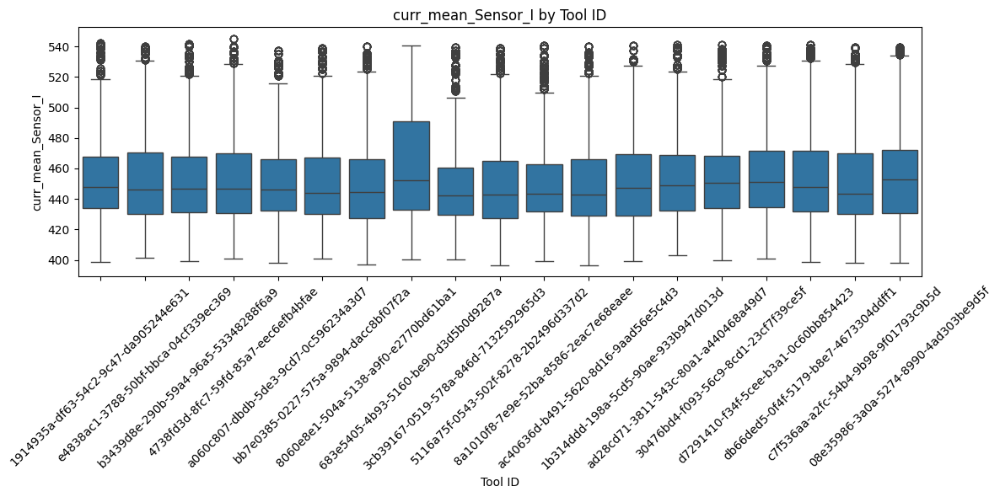

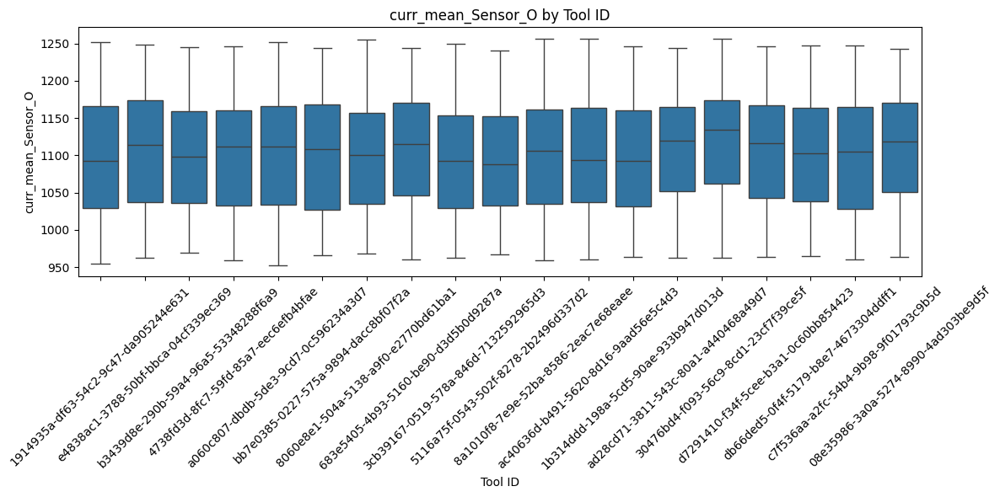

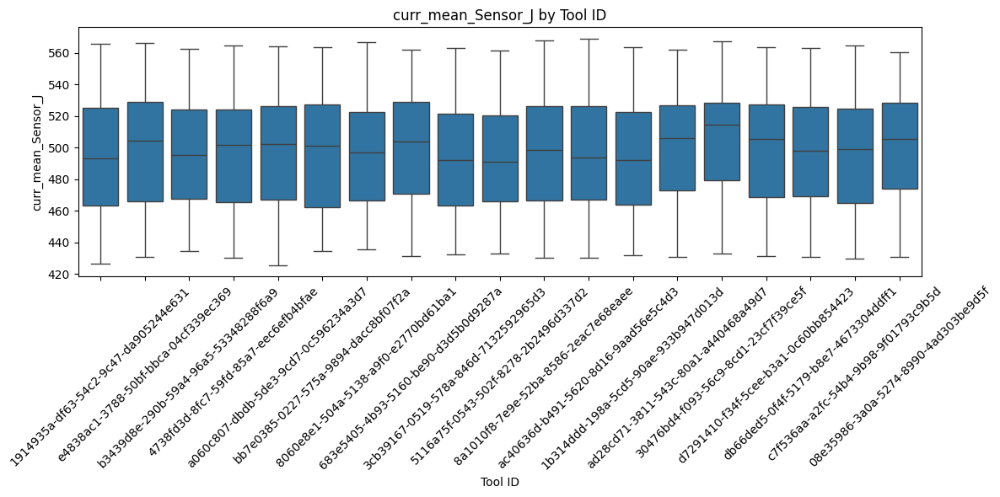

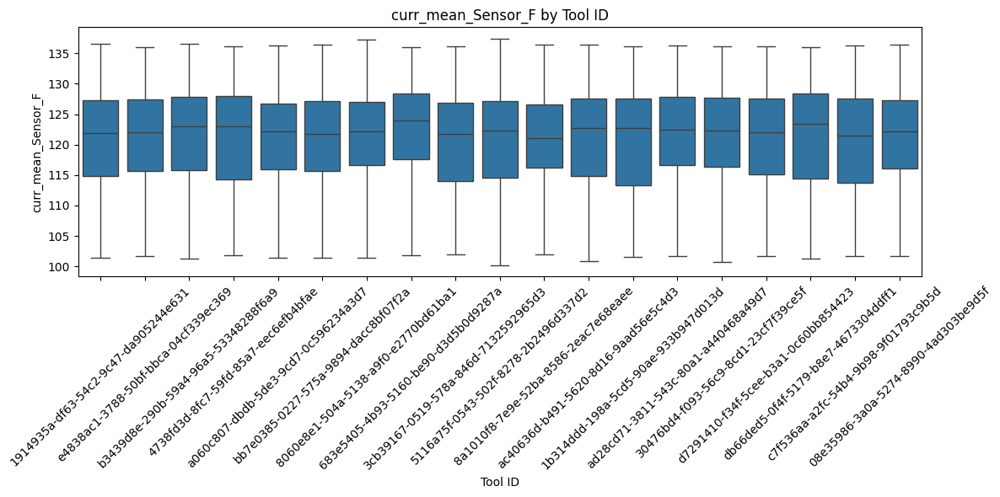

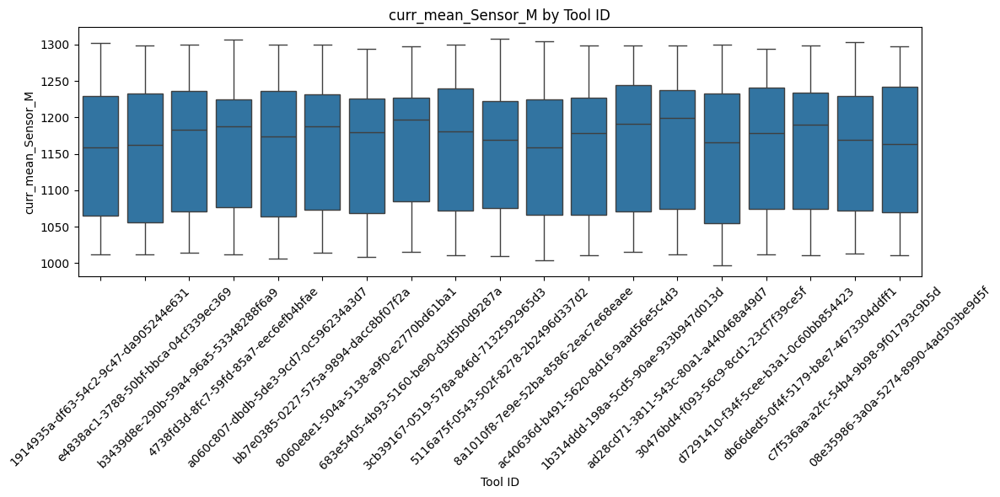

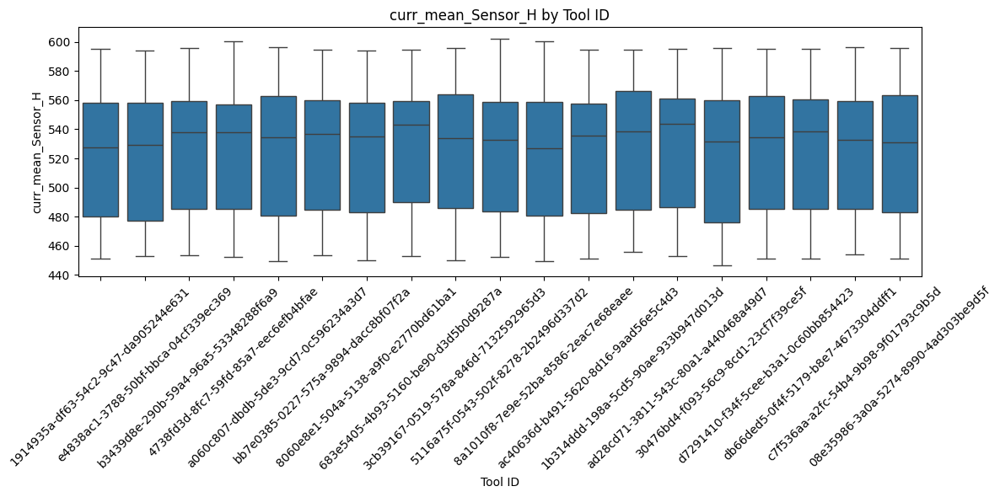

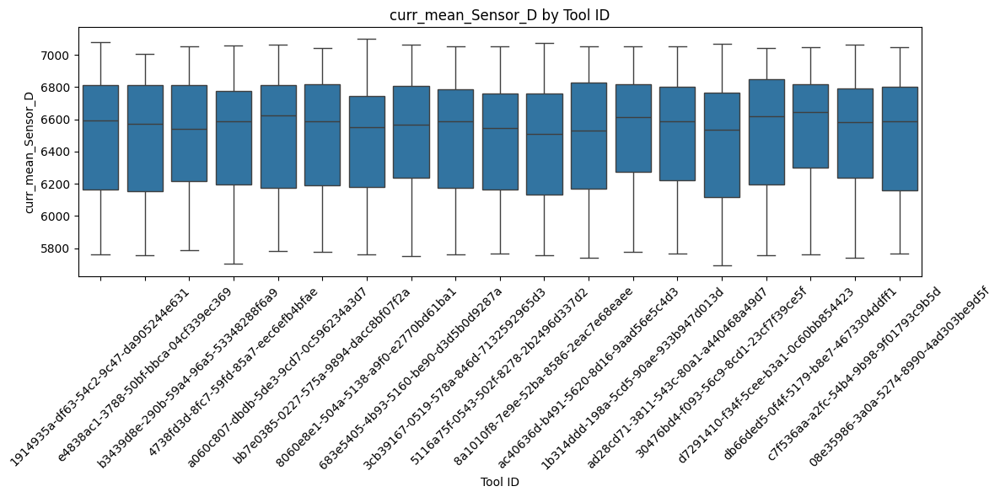

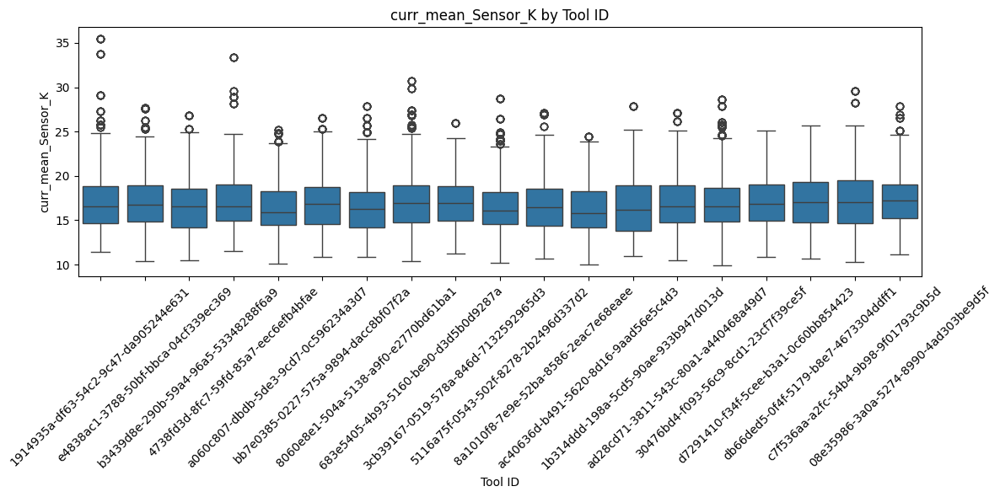

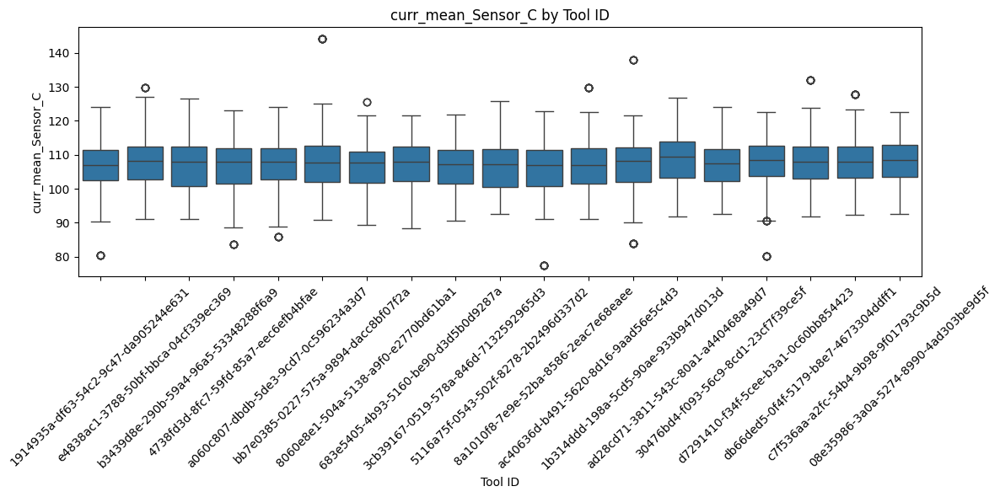

In [ ]:
for sensor in top_sensors:
    plt.figure(figsize=(12, 6))
    sns.boxplot(x="Tool ID", y=sensor, data=toolwise)
    plt.xticks(rotation=45)
    plt.title(f"{sensor} by Tool ID")
    plt.tight_layout()
    plt.show()


### Sensor Value by Process Step

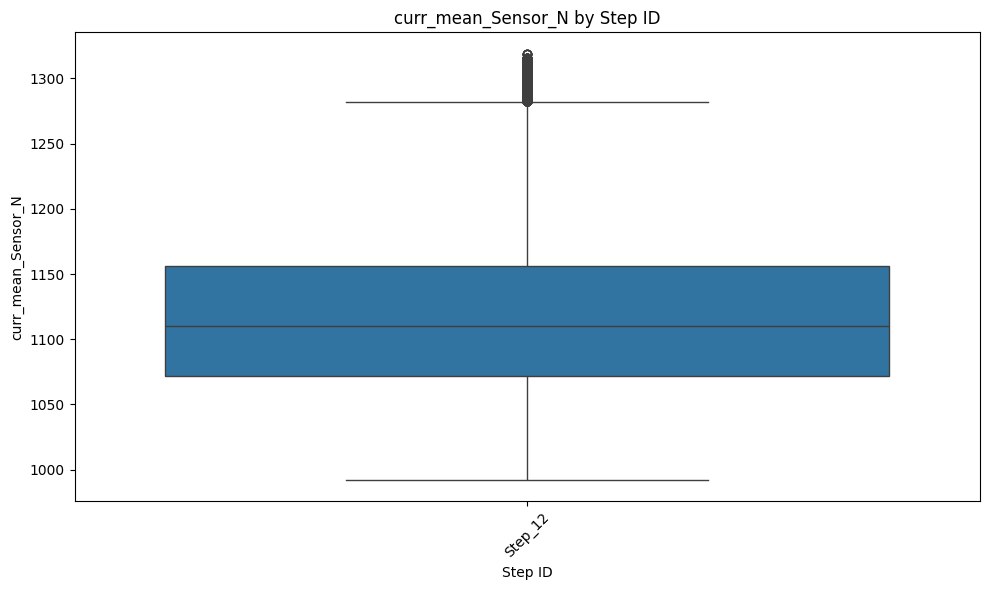

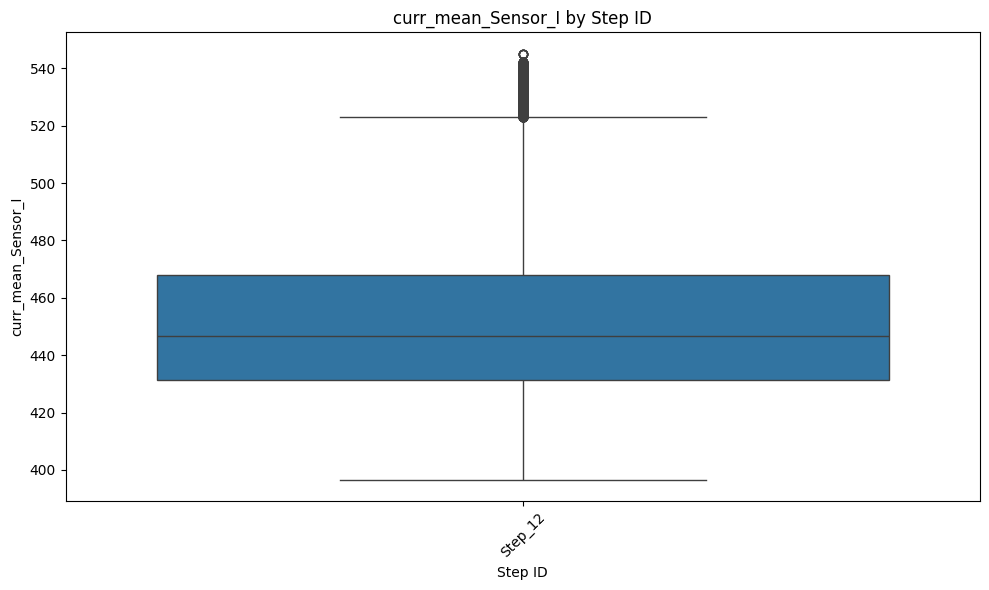

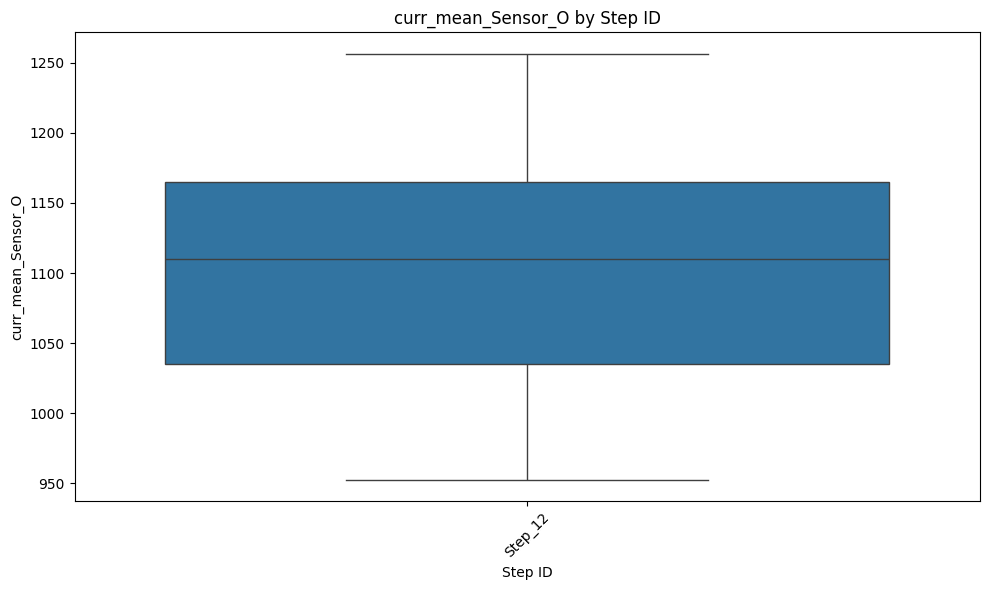

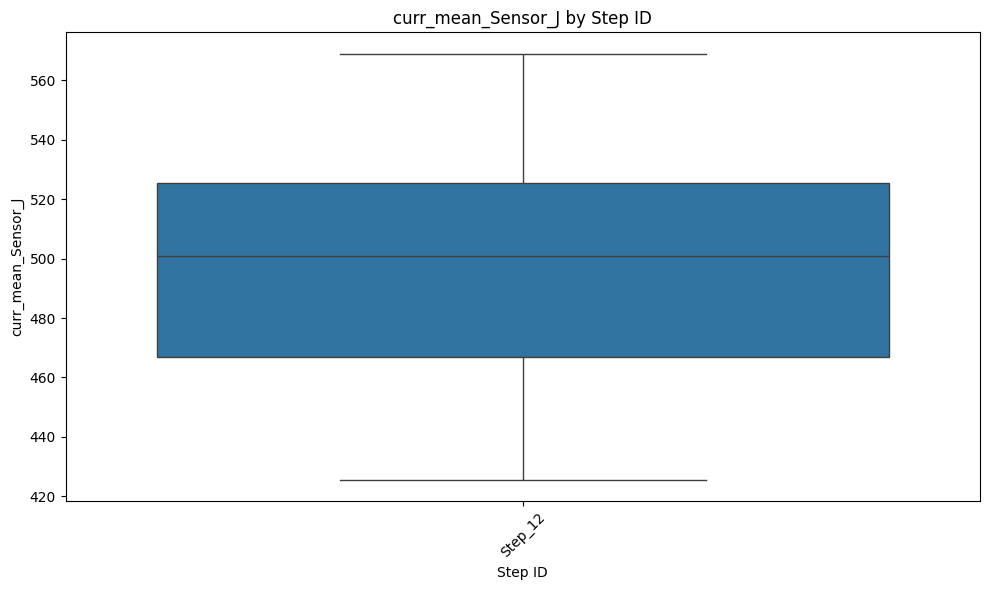

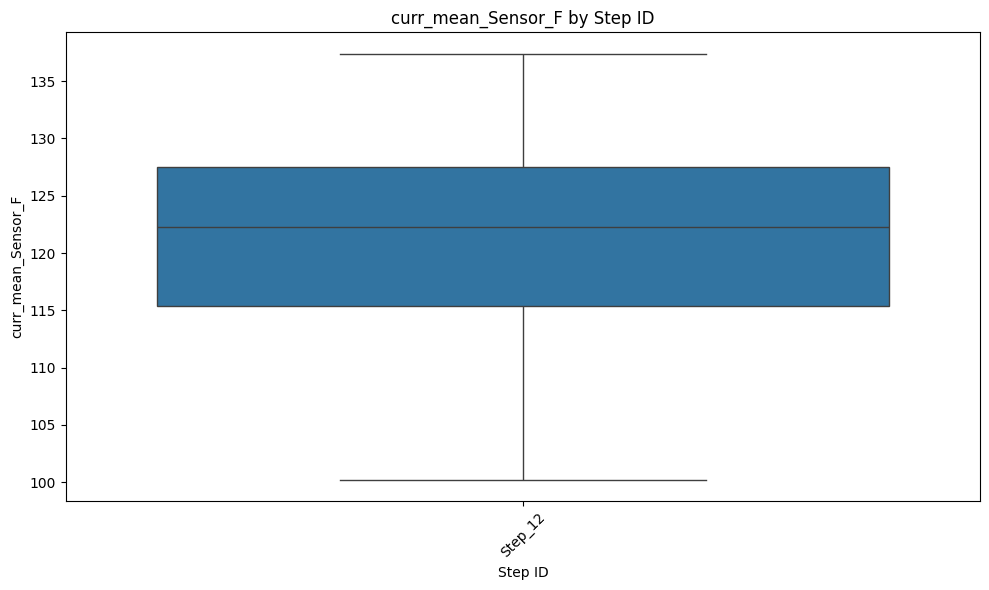

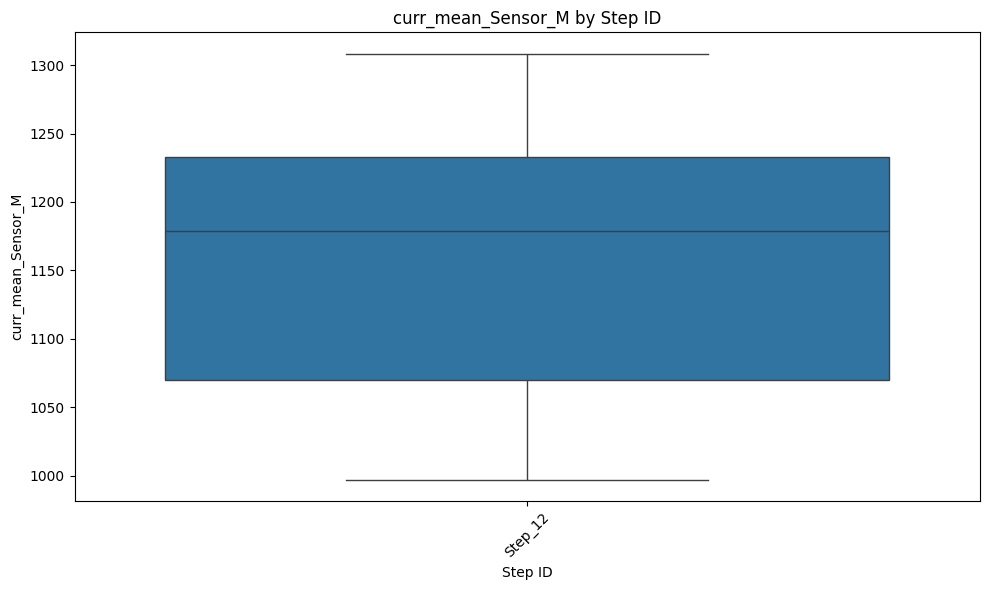

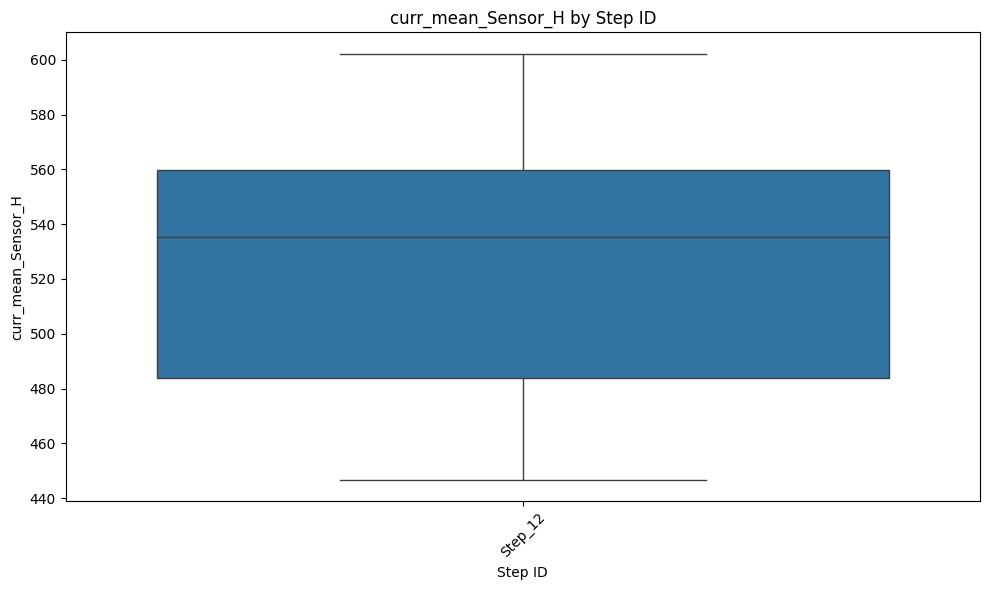

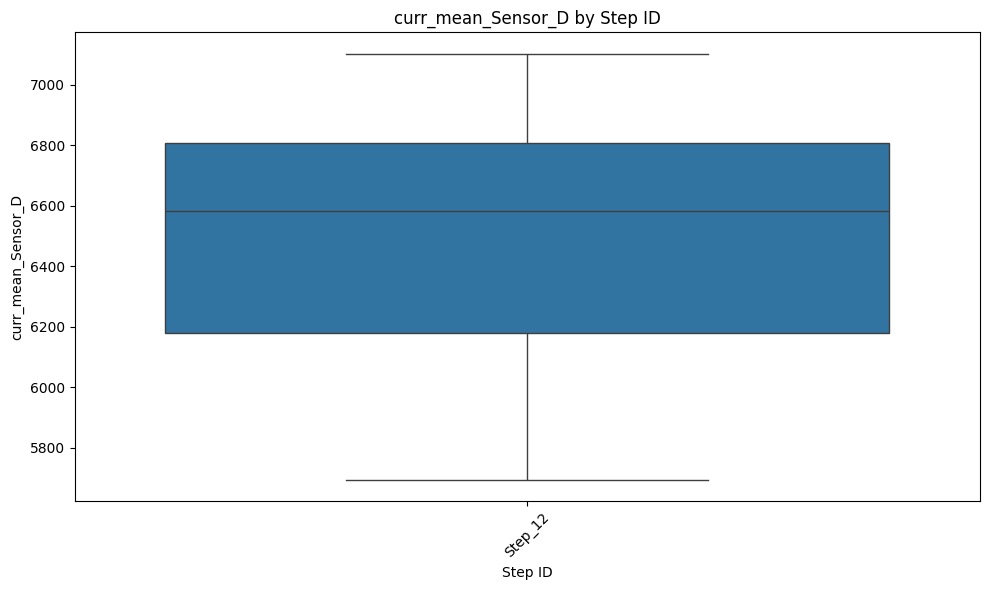

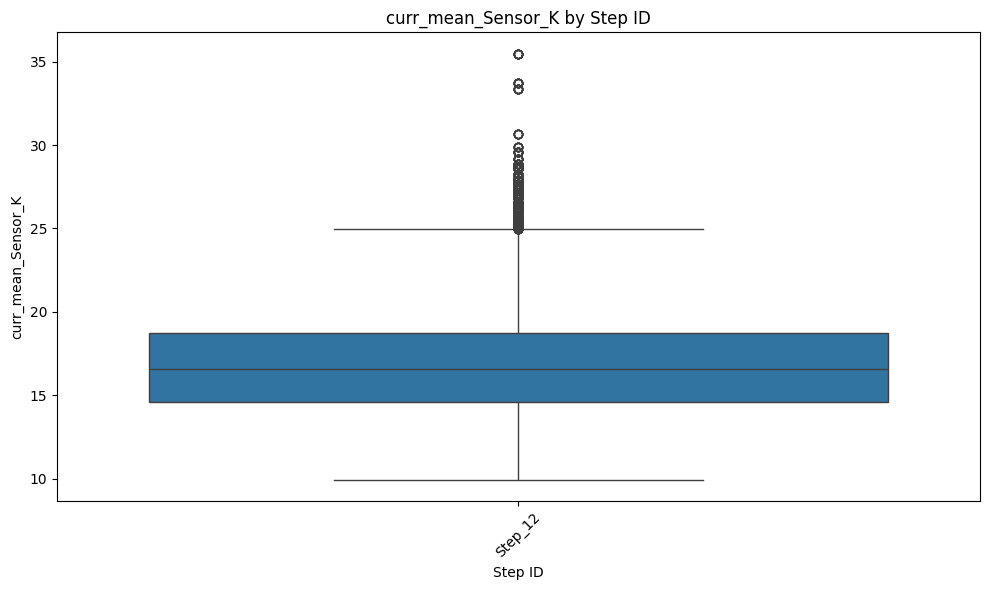

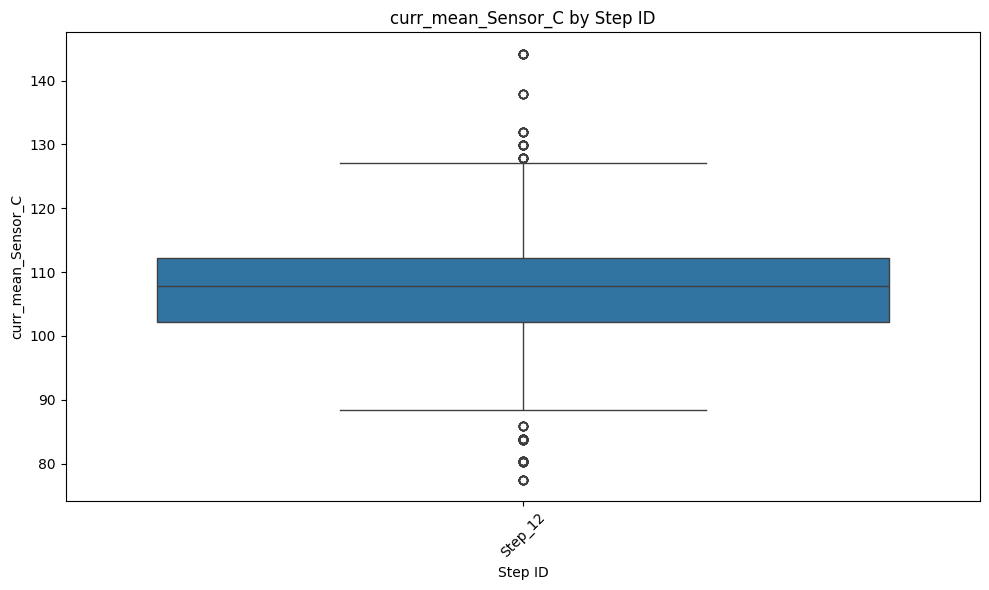

In [ ]:
for sensor in top_sensors:
    plt.figure(figsize=(10, 6))
    sns.boxplot(x="Step ID", y=sensor, data=toolwise)
    plt.xticks(rotation=45)
    plt.title(f"{sensor} by Step ID")
    plt.tight_layout()
    plt.show()


### Run a breakdown of prediction error by Process step

In [ ]:
toolwise["Step ID"].value_counts()

Step ID
Step_12    40572
Name: count, dtype: int64

In [ ]:
y_pred = model.predict(X_test)

toolwise = model_input_df.iloc[y_test.index].copy()
toolwise["Prediction"] = y_pred
toolwise["Actual"] = y_test.to_numpy()
toolwise["Abs Error"] = abs(toolwise["Actual"] - toolwise["Prediction"])

In [ ]:
process_step_map = run_data_df[["Run ID", "Process Step"]].drop_duplicates()
toolwise = toolwise.merge(process_step_map, on="Run ID", how="left")

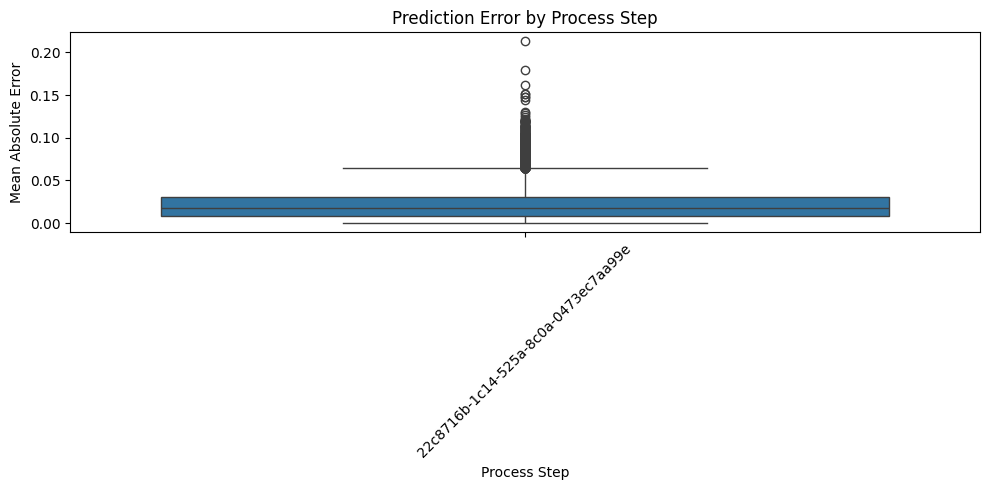

In [ ]:
plt.figure(figsize=(10, 5))
sns.boxplot(x="Process Step", y="Abs Error", data=toolwise)
plt.xticks(rotation=45)
plt.title("Prediction Error by Process Step")
plt.ylabel("Mean Absolute Error")
plt.tight_layout()
plt.show()

The boxplot shows only one Process Step (a UUID-like string), which suggests your model was trained and evaluated on data from only one process step.
    This means you're not yet comparing model performance across different process conditions or recipes.

Low Median Error
    The center of the box (median) appears to be around 0.02 or lower → the model performs well in general for this step.

Presence of Outliers
    There are some dots beyond 0.10 to ~0.22, indicating a small number of predictions with unusually high error.

# Run-Level RMSE Breakdown

### Shows how model performs across different runs (useful if tools degrade or fail differently)

### Reconstruct Run ID in test set

In [ ]:
test_run_ids = model_input_df.iloc[y_test.index]["Run ID"].to_numpy()

run_df = pd.DataFrame({"Run ID": test_run_ids, "Actual": y_test, "Predicted": y_pred})
run_df["sq_error"] = (run_df["Actual"] - run_df["Predicted"]) ** 2

### Compute RMSE per run

In [ ]:
run_rmse = run_df.groupby("Run ID")["sq_error"].mean().apply(np.sqrt).reset_index()
run_rmse.columns = ["Run ID", "RMSE"]

### Plot distribution

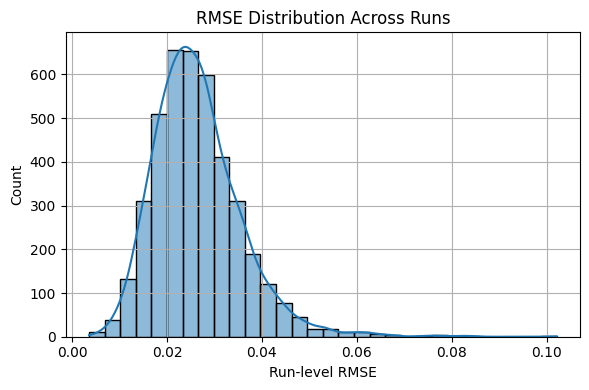

In [ ]:
plt.figure(figsize=(6, 4))
sns.histplot(run_rmse["RMSE"], bins=30, kde=True)
plt.title("RMSE Distribution Across Runs")
plt.xlabel("Run-level RMSE")
plt.grid(True)
plt.tight_layout()
plt.show()

A histogram of RMSE values per Run ID:
    Each bar = one or more runs with a similar RMSE
    The x-axis = Run-level RMSE (how wrong your model was for a given run)
    The y-axis = Number of runs in that RMSE range

Most runs have low RMSE (left side) → The model performs consistently well on most runs.
    This is good — your features are generalizing.

Long right tail (some runs have high RMSE) → The model performs poorly on certain runs.
    1. A few runs are outliers : Tool changed, step ID changed, tool degraded, etc.
    2. Multiple bad runs in a group : Model is missing key features for those runs
    3. Wide RMSE spread : 	Model is inconsistent across run types

Multiple peaks (bimodal/multimodal distribution) 
    Example: RMSE peaks at 0.05 and 0.20

    Model is likely facing different behavior segments (e.g., different tool clusters or recipes) that it can’t treat as one.
    
    Investigate whether certain Tool IDs or Step IDs dominate the high-error group
    
    Plot Run RMSE by Tool ID or by time (calendar sequence)

This plot shows: 
    Strong model performance overall:
        The distribution is tightly centered between 0.02 and 0.03, which is a low error range.
        Most runs (bulk of histogram) have RMSE in this tight band → your model performs consistently well across most of the wafer runs.

    Slight right tail: Some runs have RMSEs approaching 0.06 to 0.10

    Skewed shape: Slight positive skew (longer right tail) implies error is not symmetrically distributed — a few runs disproportionately impact your overall performance.

# List the top-10 worst runs and visualizing their error heatmaps across the wafer

### Create the per-point error DataFrame

In [ ]:
pointwise_df = toolwise.copy()
pointwise_df["Squared Error"] = (
    pointwise_df["Actual"] - pointwise_df["Prediction"]
) ** 2

pointwise_df["Squared Error"] = (
    pointwise_df["Actual"] - pointwise_df["Prediction"]
) ** 2

### Compute RMSE per run

In [ ]:
run_rmse = (
    pointwise_df.groupby("Run ID")["Squared Error"]
    .mean()
    .pow(0.5)
    .reset_index(name="RMSE")
)

### Top-10 worst runs

In [ ]:
top10_runs = run_rmse.sort_values("RMSE", ascending=False).head(10)["Run ID"].tolist()
top10_df = pointwise_df[pointwise_df["Run ID"].isin(top10_runs)]

### Heatmaps

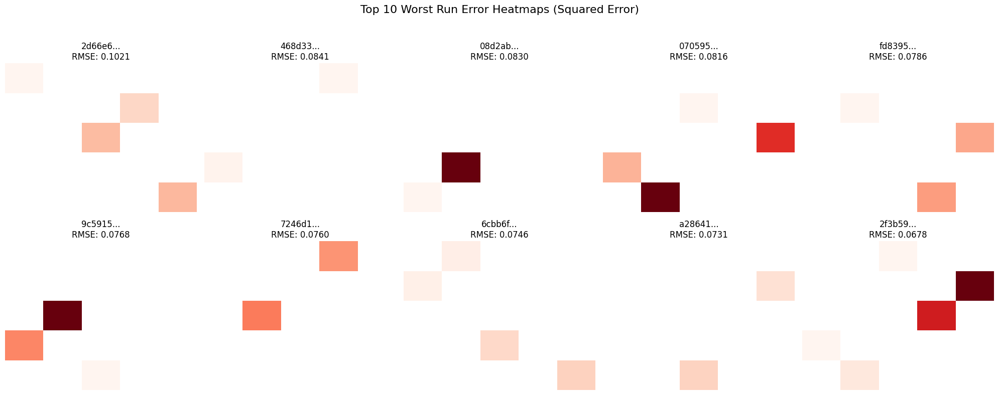

In [ ]:
fig, axes = plt.subplots(2, 5, figsize=(20, 8), sharex=True, sharey=True)
axes = axes.flatten()

for idx, run_id in enumerate(top10_runs):
    run_data = top10_df[top10_df["Run ID"] == run_id]
    pivot = run_data.pivot_table(index="Y", columns="X", values="Squared Error")
    sns.heatmap(pivot, ax=axes[idx], cmap="Reds", cbar=False)
    rmse_val = run_rmse.loc[run_rmse["Run ID"] == run_id, "RMSE"].values[0]
    axes[idx].set_title(f"{run_id[:6]}...\nRMSE: {rmse_val:.4f}")
    axes[idx].invert_yaxis()
    axes[idx].axis("off")

plt.suptitle("Top 10 Worst Run Error Heatmaps (Squared Error)", fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()

Localized dark red zones (e.g. corners, edges) : Systematic spatial bias — model struggles in those wafer areas

Different spatial patterns across runs : May hint at miscalibration, alignment issues, or spatial shift

All points red : Entire run had poor prediction — check tool ID, consumable life, or incoming run sensor values

This plot shows:
    Each subplot is a wafer map (X vs Y) of a single Run ID.
    The heatmap shows squared error per (X, Y) location for that run.

# Inspect Tool ID and Consumable Life of each high-error run

### Check if certain tools always appear in bad runs and check if most bad runs happened when Consumable Life is very high

### Query the run_data_df for metadata

In [ ]:
tool_meta = run_data_df[run_data_df["Run ID"].isin(top10_runs)][
    ["Run ID", "Tool ID", "Consumable Life"]
].drop_duplicates()

display(tool_meta)


,Run ID,Tool ID,Consumable Life
2495085,0705950f-a327-5625-a75f-cd3a131c0d59,683e5405-4b93-5160-be90-d3d5b0d9287a,38.041309
4407510,08d2abd8-8309-5b01-9d85-f44d4a2e4ffa,683e5405-4b93-5160-be90-d3d5b0d9287a,96.916512
6318090,fd8395f0-3fb5-555c-bfc4-5fd6e2d80e35,8a1010f8-7e9e-52ba-8586-2eac7e68eaee,52.534740
8819145,2d66e6cd-34ad-5f11-bc42-9f64a7a98d31,e4838ac1-3788-50bf-bbca-04cf339ec369,67.414688
18263955,9c59156a-d1c6-5e0d-9c88-eb1d15b336dd,c7f536aa-a2fc-54b4-9b98-9f01793c9b5d,173.436432
20512350,6cbb6fa2-be25-5165-aa49-bf74ed4d08b2,4738fd3d-8fc7-59fd-85a7-eec6efb4bfae,69.612419
21218835,468d332c-e6a2-5801-b5f5-2879d7358f05,5116a75f-0543-502f-8278-2b2496d337d2,42.510403
26246715,a28641db-6bc2-55d5-b8e2-e52f635dfec1,8060e8e1-504a-5138-a9f0-e2770bd61ba1,417.431885
29517765,2f3b59ff-88a8-5d95-8ae0-184f0967883a,db66ded5-0f4f-5179-b8e7-4673304ddff1,86.962486
36045615,7246d16c-51bf-5b6f-b5cb-1becd0ca3c28,1914935a-df63-54c2-9c47-da905244e631,220.843979


# Non liner correlation of other sensors

In [ ]:
import scipy.stats as stats

In [ ]:
# Aggregate Incoming Sensors: one feature per Run ID
incoming_features_df = (
    incoming_run_df.groupby(["Run ID", "Sensor Name"])["Sensor Value"]
    .mean()
    .reset_index()
    .pivot(index="Run ID", columns="Sensor Name", values="Sensor Value")
    .reset_index()
)

# Optional: rename columns for clarity
incoming_features_df.columns = ["Run ID"] + [
    f"Incoming_{col}" for col in incoming_features_df.columns[1:]
]


In [ ]:
# Aggregate Run Sensors (mean)
run_features_df = (
    run_data_df.groupby(["Run ID", "Sensor Name"])["Sensor Value"]
    .mean()
    .reset_index()
    .pivot(index="Run ID", columns="Sensor Name", values="Sensor Value")
    .reset_index()
)

# Rename columns
run_features_df.columns = ["Run ID"] + [
    f"Run_{col}" for col in run_features_df.columns[1:]
]


In [ ]:
# Aggregate Target: Mean measurement per run
run_measurement_df = metrology_df.groupby("Run ID")["Measurement"].mean().reset_index()
run_measurement_df.rename(columns={"Measurement": "Mean_Measurement"}, inplace=True)


In [ ]:
# Merge all features + target
df_features = run_measurement_df.merge(
    incoming_features_df, on="Run ID", how="inner"
).merge(run_features_df, on="Run ID", how="inner")

print(f"Combined feature dataframe shape: {df_features.shape}")

Combined feature dataframe shape: (4140, 58)


In [ ]:
import scipy.stats as stats

In [ ]:
# Identify sensor columns
sensor_columns = [
    col
    for col in df_features.columns
    if col.startswith("Incoming_") or col.startswith("Run_")
]

# Compute Spearman for all
spearman_results = []

for sensor in sensor_columns:
    rho, pval = stats.spearmanr(df_features[sensor], df_features["Mean_Measurement"])
    spearman_results.append((sensor, rho, pval))

# Sort by absolute Spearman rho
spearman_results_sorted = sorted(
    spearman_results, key=lambda x: abs(x[1]), reverse=True
)

print("=== Spearman Correlation (sorted) ===")
for sensor, rho, pval in spearman_results_sorted:
    print(f"{sensor}: Spearman rho = {rho:.3f}, p = {pval:.3g}")


=== Spearman Correlation (sorted) ===
Run_Sensor_N: Spearman rho = 0.850, p = 0
Run_Sensor_I: Spearman rho = 0.791, p = 0
Run_Sensor_O: Spearman rho = 0.779, p = 0
Run_Sensor_F: Spearman rho = 0.764, p = 0
Run_Sensor_J: Spearman rho = 0.749, p = 0
Run_Sensor_M: Spearman rho = 0.711, p = 0
Run_Sensor_H: Spearman rho = 0.666, p = 0
Run_Sensor_K: Spearman rho = 0.359, p = 2.38e-126
Run_Sensor_C: Spearman rho = 0.340, p = 1.23e-112
Incoming_Sensor_1: Spearman rho = 0.224, p = 2.47e-48
Run_Sensor_D: Spearman rho = 0.216, p = 9.99e-45
Run_Sensor_E: Spearman rho = -0.166, p = 7.85e-27
Run_Sensor_G: Spearman rho = 0.114, p = 2.06e-13
Incoming_Sensor_34: Spearman rho = -0.043, p = 0.0055
Run_Sensor_L: Spearman rho = 0.040, p = 0.00917
Incoming_Sensor_3: Spearman rho = 0.034, p = 0.0276
Incoming_Sensor_41: Spearman rho = -0.034, p = 0.0294
Incoming_Sensor_23: Spearman rho = -0.034, p = 0.03
Incoming_Sensor_12: Spearman rho = 0.033, p = 0.0315
Incoming_Sensor_11: Spearman rho = 0.033, p = 0.0345


Spearman rho: Measures monotonic relationship
    +1 : perfect increasing relationship
    -1 : perfect decreasing relationship
    0 : no monotonic relationship

Run_Sensor_N, I, O, F, J, M, H : rho > 0.6	Definitely include in model
Run_Sensor_K, C : rho ~ 0.34	Consider including
Incoming_Sensor_1 : rho ~ 0.224	Try it — may help slightly
Incoming_Sensor_X : rho ~ 0	Exclude from model

In [ ]:
from sklearn.feature_selection import mutual_info_regression

In [ ]:
# Prepare X and y
X = df_features[sensor_columns]
y = df_features["Mean_Measurement"]

# Compute MI
mi = mutual_info_regression(X, y, random_state=42)

# Combine results
mi_results = list(zip(sensor_columns, mi))
mi_results_sorted = sorted(mi_results, key=lambda x: x[1], reverse=True)

print("=== Mutual Information (sorted) ===")
for sensor, score in mi_results_sorted:
    print(f"{sensor}: MI score = {score:.4f}")


=== Mutual Information (sorted) ===
Run_Sensor_N: MI score = 0.7453
Run_Sensor_G: MI score = 0.7061
Run_Sensor_I: MI score = 0.6526
Run_Sensor_O: MI score = 0.5946
Run_Sensor_F: MI score = 0.5875
Run_Sensor_J: MI score = 0.5498
Run_Sensor_M: MI score = 0.4512
Run_Sensor_H: MI score = 0.4295
Run_Sensor_D: MI score = 0.2488
Run_Sensor_C: MI score = 0.1827
Run_Sensor_E: MI score = 0.1498
Run_Sensor_K: MI score = 0.1237
Incoming_Sensor_1: MI score = 0.1017
Run_Sensor_L: MI score = 0.0684
Run_Sensor_A: MI score = 0.0488
Incoming_Sensor_32: MI score = 0.0180
Incoming_Sensor_22: MI score = 0.0176
Incoming_Sensor_36: MI score = 0.0141
Incoming_Sensor_17: MI score = 0.0140
Incoming_Sensor_21: MI score = 0.0126
Incoming_Sensor_7: MI score = 0.0100
Incoming_Sensor_28: MI score = 0.0096
Incoming_Sensor_27: MI score = 0.0073
Incoming_Sensor_6: MI score = 0.0067
Incoming_Sensor_30: MI score = 0.0051
Run_Sensor_B: MI score = 0.0049
Incoming_Sensor_37: MI score = 0.0040
Incoming_Sensor_40: MI score = 

Mutual Information : How much information this sensor gives about predicting the target (Mean Measurement)
    MI is ≥ 0; higher is better. 0 means independent (sensor carries no useful signal).

High MI : High priority for model
    Run_Sensor_N: 0.7453 → very strong → must include.
    Run_Sensor_G: 0.7061 → very strong → interestingly this was lower in Spearman → might be non-linear relationship.
    Run_Sensor_I: 0.6526 → strong.

Run_Sensor_G is interesting/weird:
    In Spearman list: Run_Sensor_G: rho = 0.114 → weak monotonic.
    In MI : very high → this suggests that Run_Sensor_G may have a non-linear relationship with target

Most incoming sensors → very low MI (close to 0) → these are likely noise → exclude them from model.

In [ ]:
# Select top N sensors by MI
top_sensors = [sensor for sensor, score in mi_results_sorted[:10]]

# Use for modeling (example X matrix)
X_top = df_features[top_sensors]
y = df_features["Mean_Measurement"]


In [ ]:
# Select top N sensors by MI
N = 10  # you can change this
top_sensors = [sensor for sensor, score in mi_results_sorted[:N]]

print(f"Top {N} sensors by MI:", top_sensors)

Top 10 sensors by MI: ['Run_Sensor_N', 'Run_Sensor_G', 'Run_Sensor_I', 'Run_Sensor_O', 'Run_Sensor_F', 'Run_Sensor_J', 'Run_Sensor_M', 'Run_Sensor_H', 'Run_Sensor_D', 'Run_Sensor_C']


In [ ]:
# Assuming you've already computed mi_results_sorted from previous MI block
N = 10  # or any number you want
top_sensors = [sensor for sensor, score in mi_results_sorted[:N]]

print(f"Top {N} sensors by MI:", top_sensors)


Top 10 sensors by MI: ['Run_Sensor_N', 'Run_Sensor_G', 'Run_Sensor_I', 'Run_Sensor_O', 'Run_Sensor_F', 'Run_Sensor_J', 'Run_Sensor_M', 'Run_Sensor_H', 'Run_Sensor_D', 'Run_Sensor_C']


In [ ]:
X = df_features[top_sensors]
y = df_features["Mean_Measurement"]


In [ ]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42
)

print(f"Train size: {X_train.shape[0]}, Test size: {X_test.shape[0]}")


Train size: 3312, Test size: 828


In [ ]:
import lightgbm as lgb

# Initialize model
lgb_model = lgb.LGBMRegressor(
    n_estimators=100, max_depth=5, learning_rate=0.1, random_state=42
)

# Fit model
lgb_model.fit(X_train, y_train)

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000396 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2550
[LightGBM] [Info] Number of data points in the train set: 3312, number of used features: 10
[LightGBM] [Info] Start training from score 10.224098
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

LGBMRegressor(max_depth=5, random_state=42)

In [ ]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import numpy as np

# Predict
y_pred = lgb_model.predict(X_test)

# Metrics
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print(f"Test RMSE: {rmse:.4f}")
print(f"Test MAE: {mae:.4f}")
print(f"Test R2: {r2:.4f}")


Test RMSE: 0.0596
Test MAE: 0.0373
Test R2: 0.8509


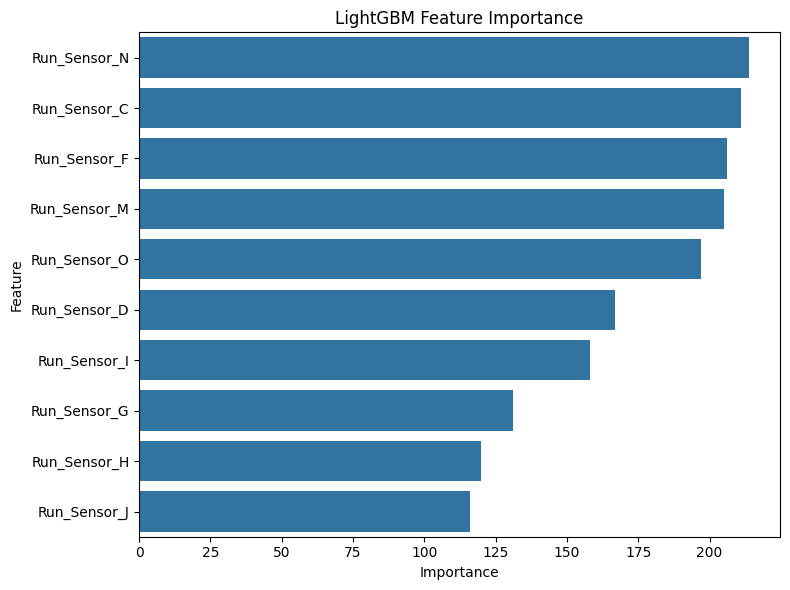

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Get feature importance
importance = lgb_model.feature_importances_
importance_df = pd.DataFrame({"Feature": top_sensors, "Importance": importance})
importance_df = importance_df.sort_values(by="Importance", ascending=False)

# Plot
plt.figure(figsize=(8, 6))
sns.barplot(x="Importance", y="Feature", data=importance_df)
plt.title("LightGBM Feature Importance")
plt.tight_layout()
plt.show()


### Tool feedback - PID control. Check tool id and consumable life

In [ ]:
# Aggregate sensor mean per Run ID, Tool ID, Consumable Life, Sensor Name
sensor_life_df = (
    run_data_df.groupby(["Run ID", "Tool ID", "Consumable Life", "Sensor Name"])[
        "Sensor Value"
    ]
    .mean()
    .reset_index()
)

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

In [ ]:
# Unique Tool IDs in your run_data_df
run_data_df["Tool ID"].unique()

array(['30476bd4-f093-56c9-8cd1-23cf7f39ce5f',
       '683e5405-4b93-5160-be90-d3d5b0d9287a',
       '3cb39167-0519-578a-846d-7132592965d3',
       '8a1010f8-7e9e-52ba-8586-2eac7e68eaee',
       'e4838ac1-3788-50bf-bbca-04cf339ec369',
       '08e35986-3a0a-5274-8990-4ad303be9d5f',
       '1b314ddd-198a-5cd5-90ae-933b947d013d',
       'd7291410-f34f-5cee-b3a1-0c60bb854423',
       'c7f536aa-a2fc-54b4-9b98-9f01793c9b5d',
       '4738fd3d-8fc7-59fd-85a7-eec6efb4bfae',
       '5116a75f-0543-502f-8278-2b2496d337d2',
       'a060c807-dbdb-5de3-9cd7-0c596234a3d7',
       '8060e8e1-504a-5138-a9f0-e2770bd61ba1',
       'db66ded5-0f4f-5179-b8e7-4673304ddff1',
       'bb7e0385-0227-575a-9894-dacc8bf07f2a',
       'ac40636d-b491-5620-8d16-9aad56e5c4d3',
       '1914935a-df63-54c2-9c47-da905244e631',
       'b3439d8e-290b-59a4-96a5-53348288f6a9',
       'ad28cd71-3811-543c-80a1-a440468a49d7'], dtype=object)

In [ ]:
# Unique Sensor Names in your run_data_df
run_data_df["Sensor Name"].unique()


array(['Sensor_A', 'Sensor_B', 'Sensor_C', 'Sensor_D', 'Sensor_E',
       'Sensor_F', 'Sensor_G', 'Sensor_H', 'Sensor_I', 'Sensor_J',
       'Sensor_K', 'Sensor_L', 'Sensor_M', 'Sensor_N', 'Sensor_O'],
      dtype=object)

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/2071928641.py:14: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(x="Consumable Life", y="Sensor Value", data=df_plot, ci=None)


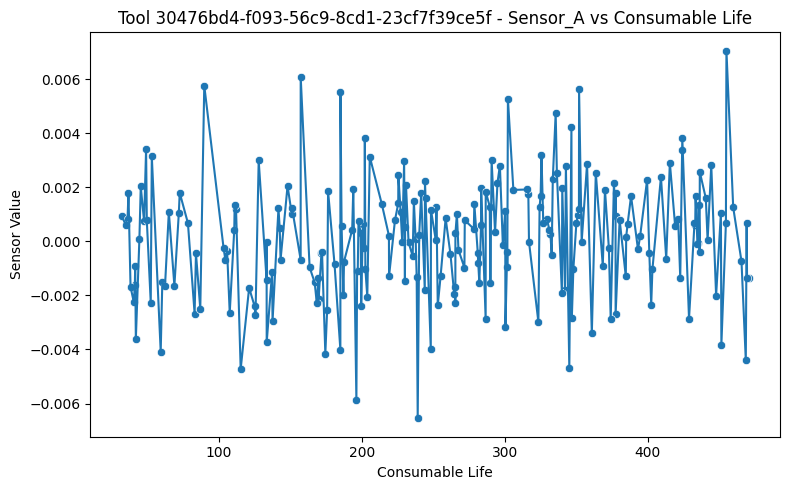

In [ ]:
# Pick one Tool ID and one Sensor Name to plot
tool_id = "30476bd4-f093-56c9-8cd1-23cf7f39ce5f"  # replace with actual Tool ID string
sensor_name = "Sensor_A"  # example

# Filter for this tool and sensor
df_plot = sensor_life_df[
    (sensor_life_df["Tool ID"] == tool_id)
    & (sensor_life_df["Sensor Name"] == sensor_name)
]

# Plot Sensor Value vs Consumable Life
plt.figure(figsize=(8, 5))
sns.scatterplot(x="Consumable Life", y="Sensor Value", data=df_plot)
sns.lineplot(x="Consumable Life", y="Sensor Value", data=df_plot, ci=None)
plt.title(f"Tool {tool_id} - {sensor_name} vs Consumable Life")
plt.xlabel("Consumable Life")
plt.ylabel("Sensor Value")
plt.tight_layout()
plt.show()

### Auto PID Plotting

In [ ]:
# Aggregate Sensor Value mean per Run ID, Tool ID, Consumable Life, Sensor Name
sensor_life_df = (
    run_data_df.groupby(["Run ID", "Tool ID", "Consumable Life", "Sensor Name"])[
        "Sensor Value"
    ]
    .mean()
    .reset_index()
)


In [ ]:
# Define list of sensors to plot — top Run sensors
sensors_to_plot = [
    "Sensor_A",
    "Sensor_B",
    "Sensor_C",
    "Sensor_D",
    "Sensor_E",
    "Sensor_F",
    "Sensor_G",
    "Sensor_H",
    "Sensor_I",
    "Sensor_J",
    "Sensor_K",
    "Sensor_L",
    "Sensor_M",
    "Sensor_N",
    "Sensor_O",
]

#### Auto-plot loop

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


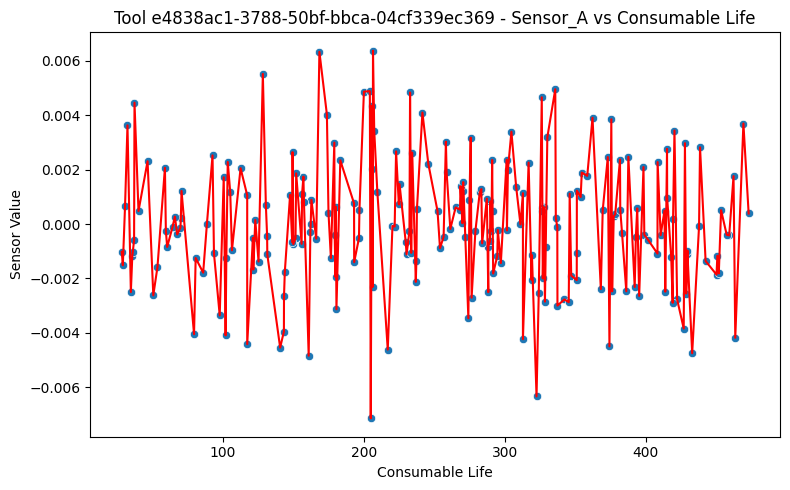

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


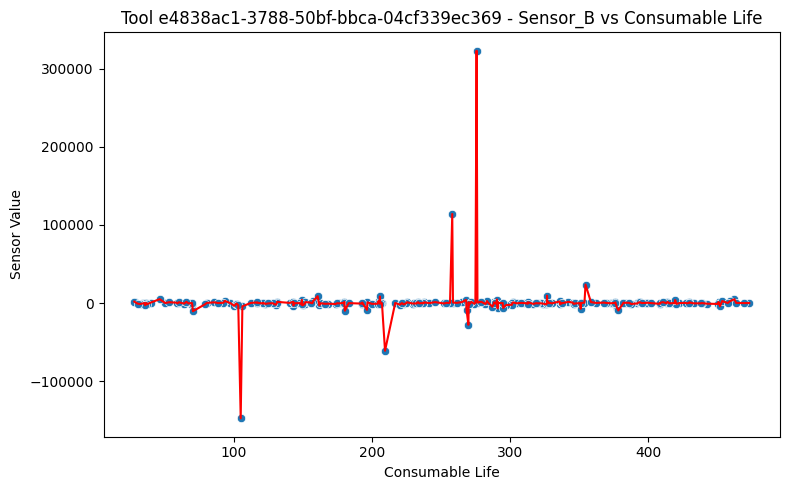

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


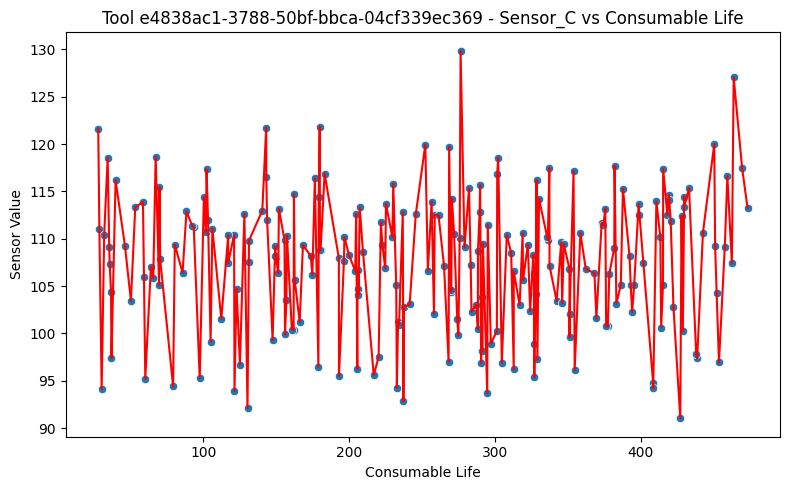

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


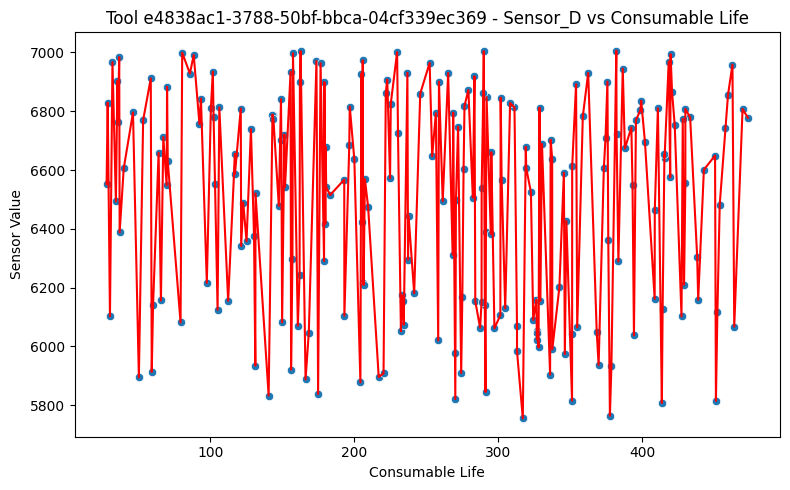

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


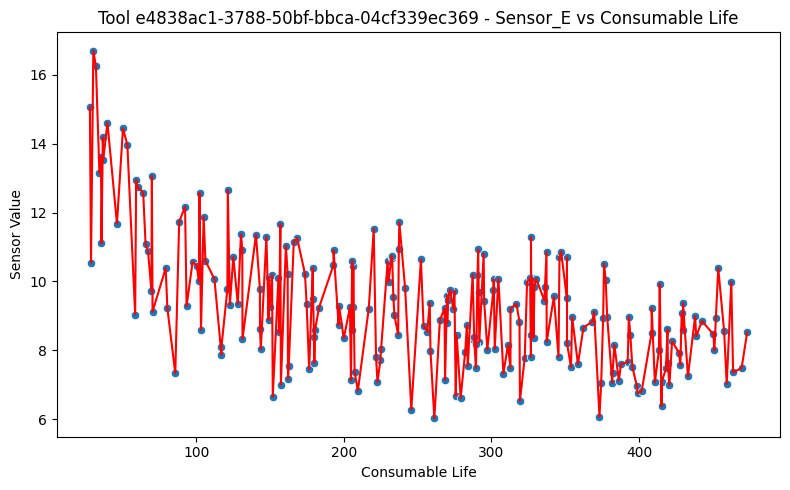

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


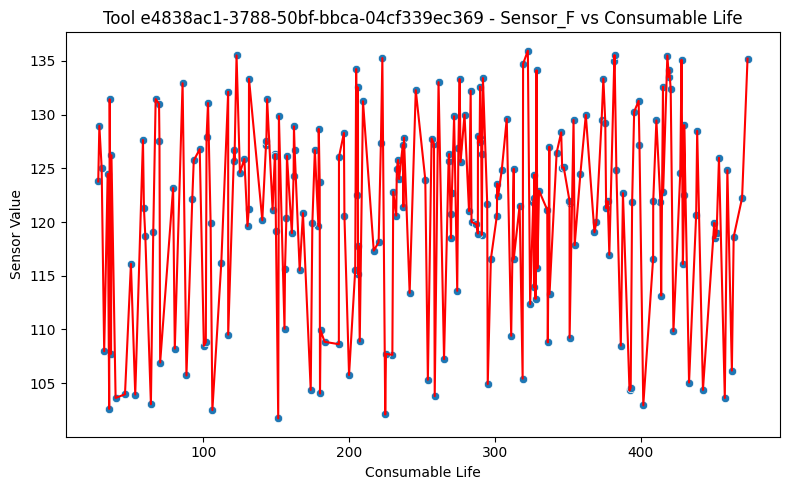

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


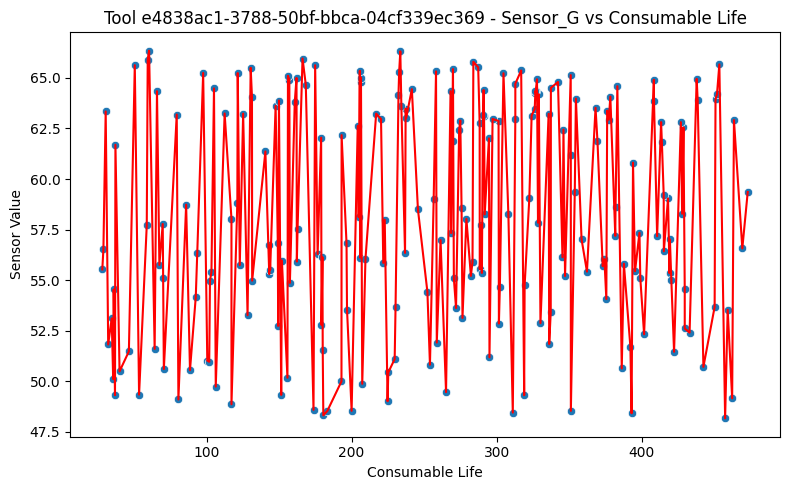

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


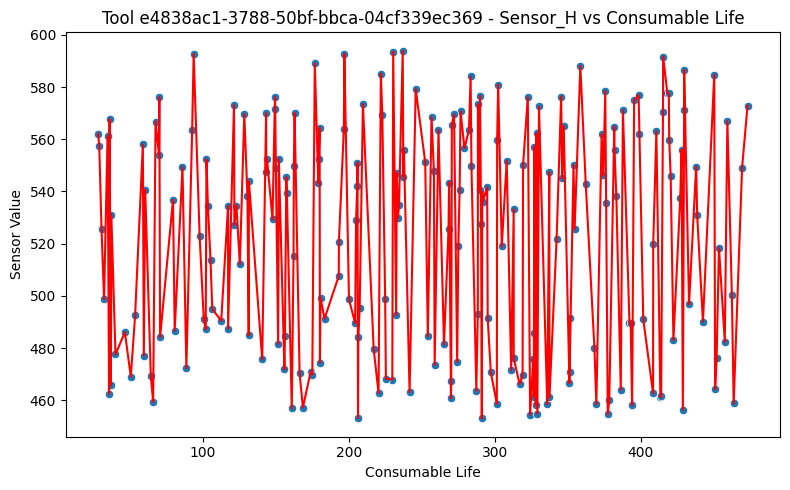

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


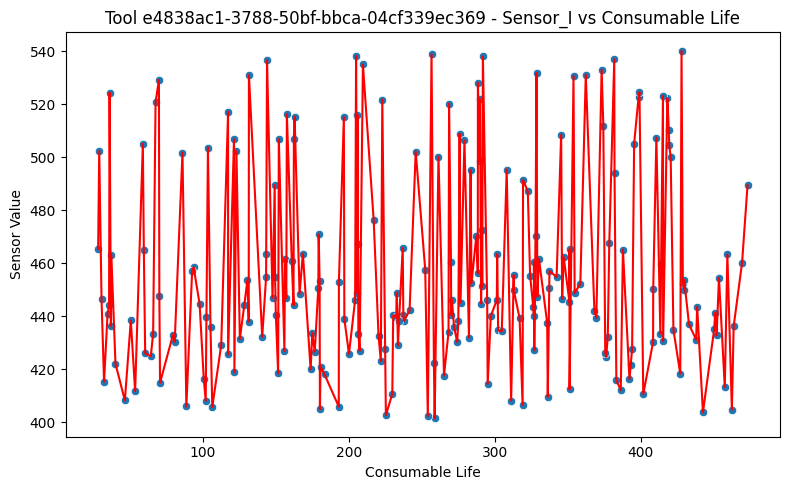

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


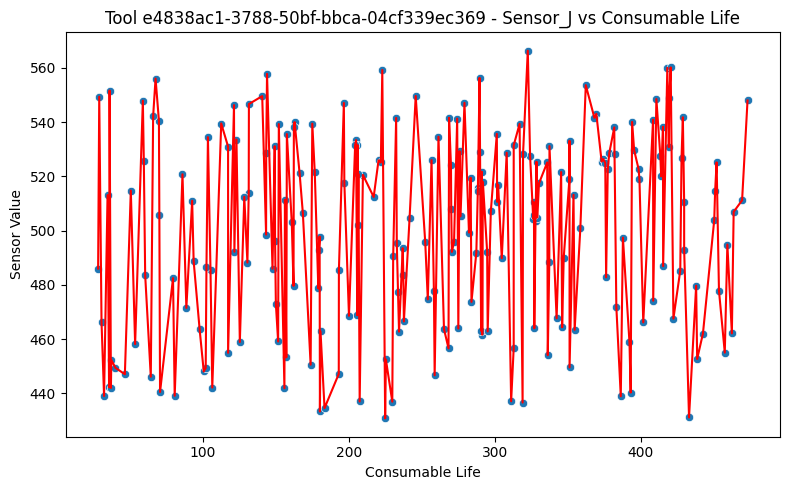

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


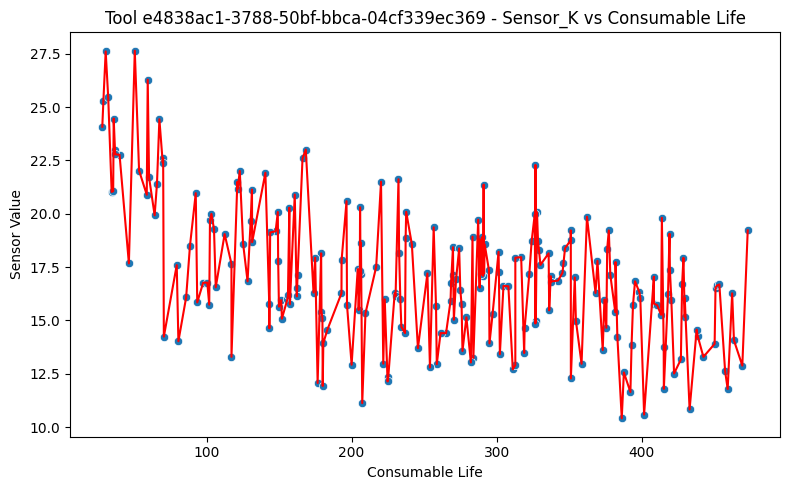

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


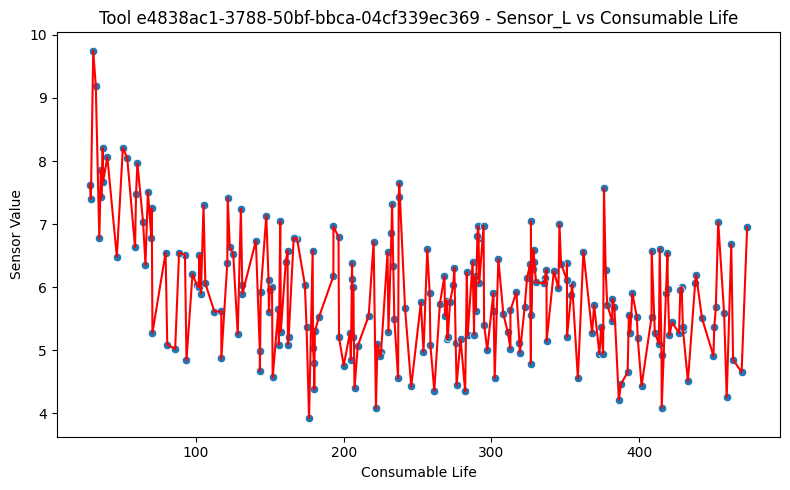

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


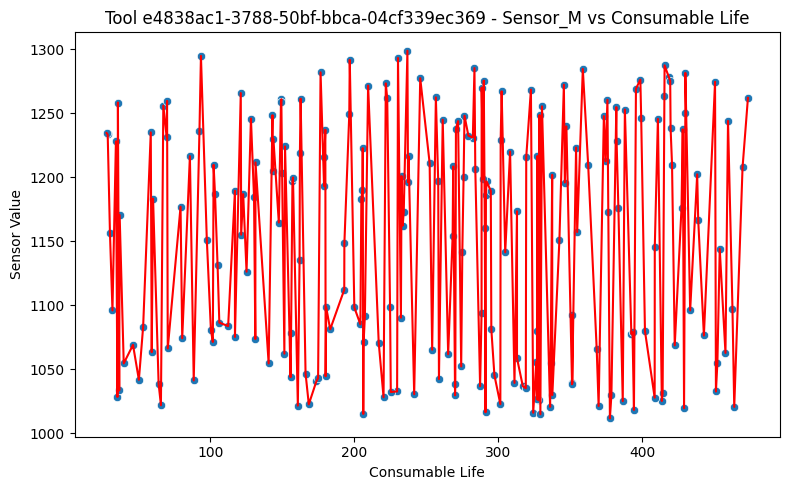

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


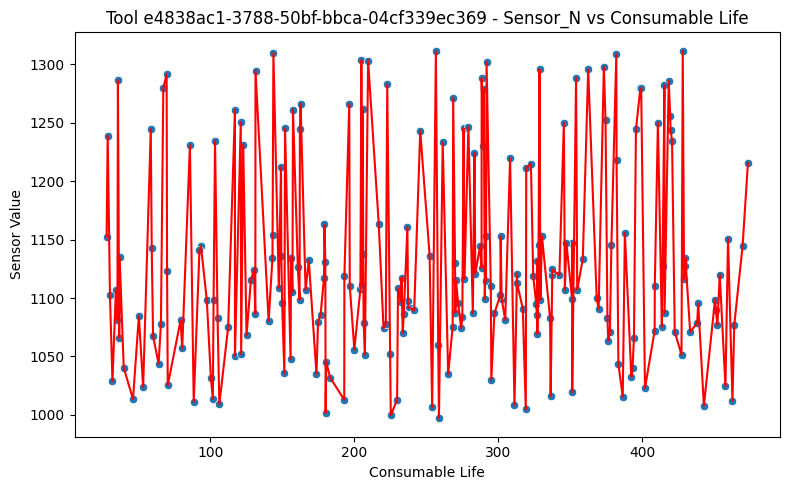

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


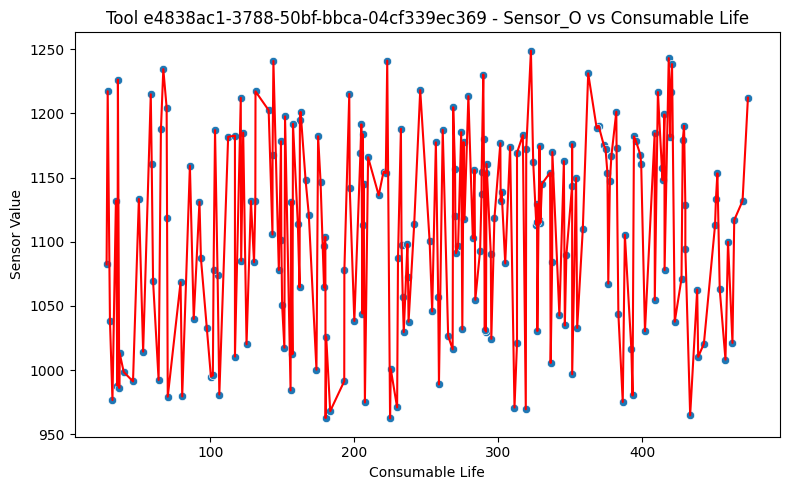

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


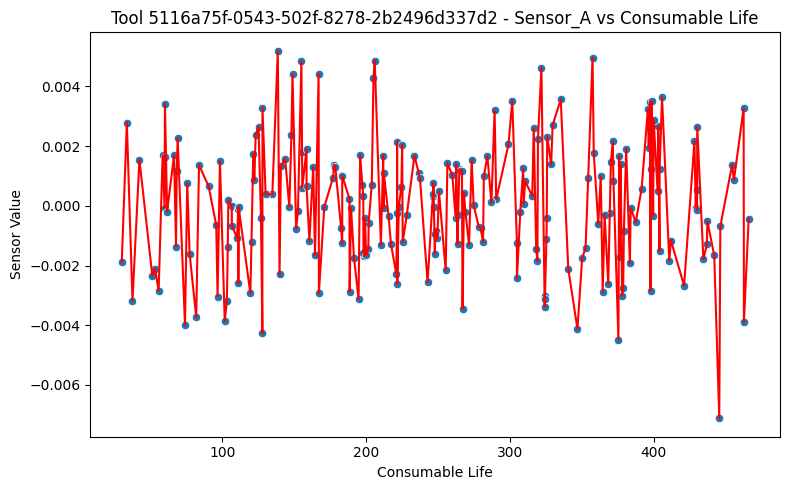

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


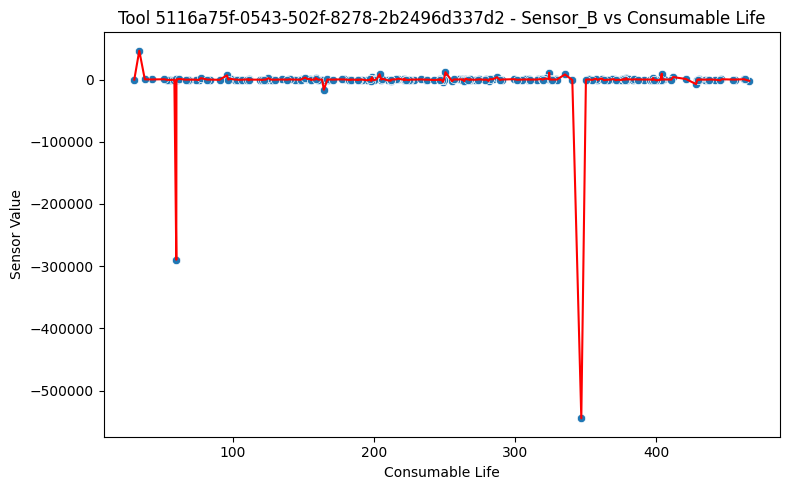

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


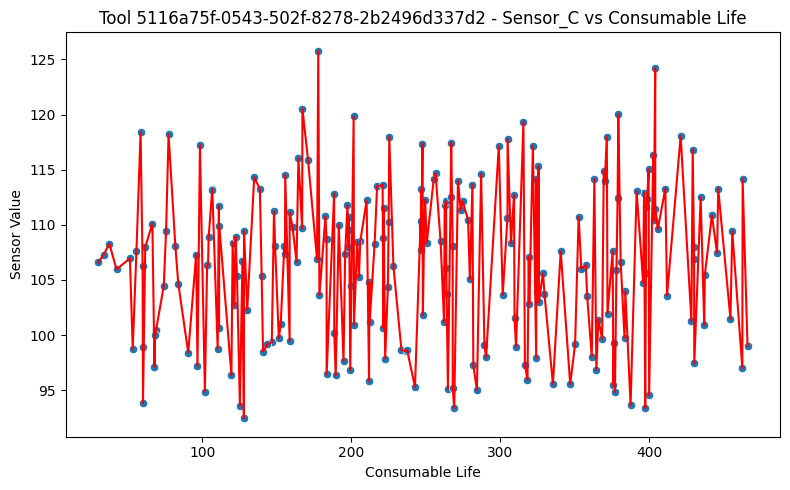

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


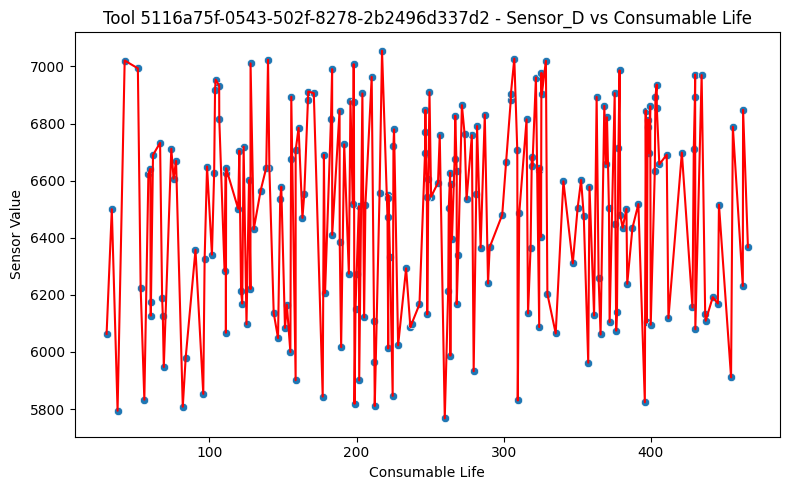

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


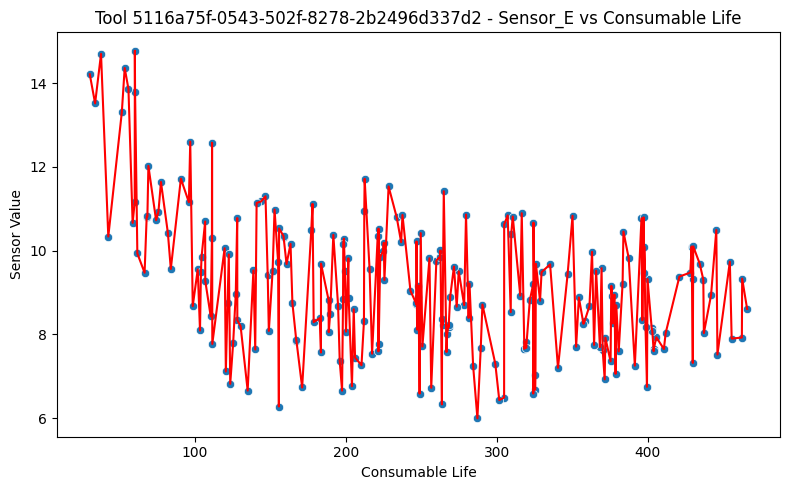

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


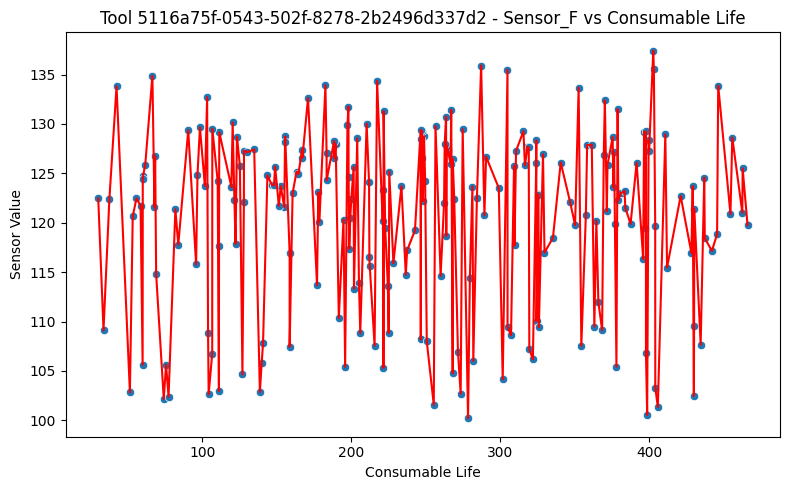

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


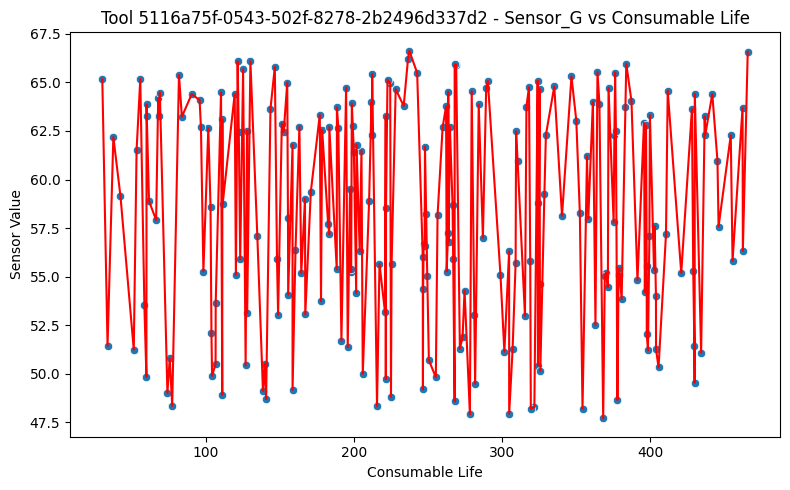

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


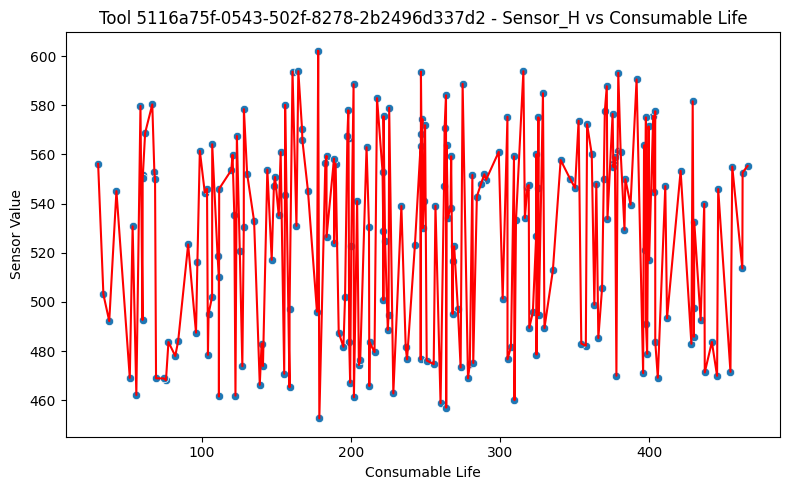

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


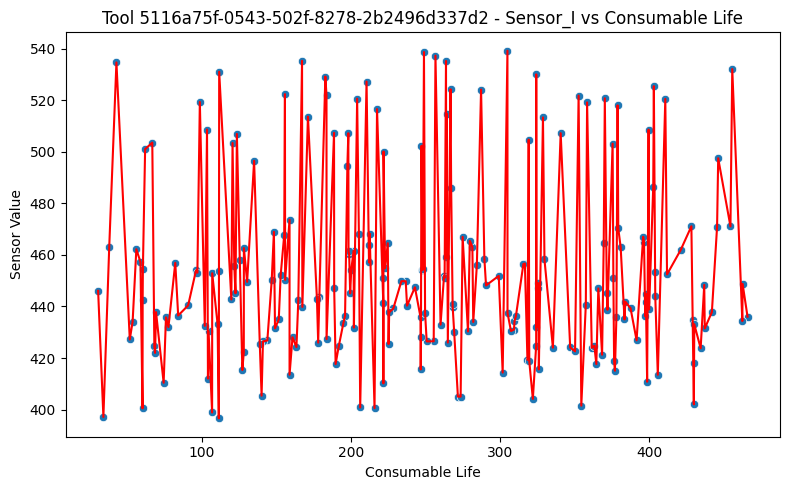

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


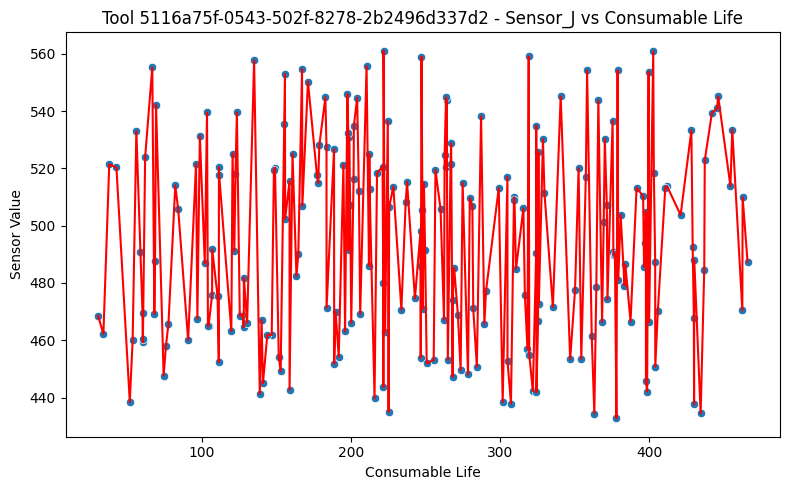

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


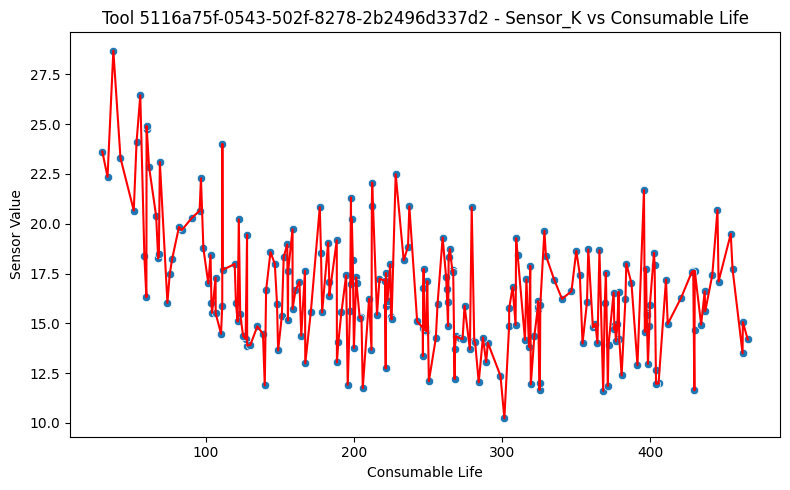

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


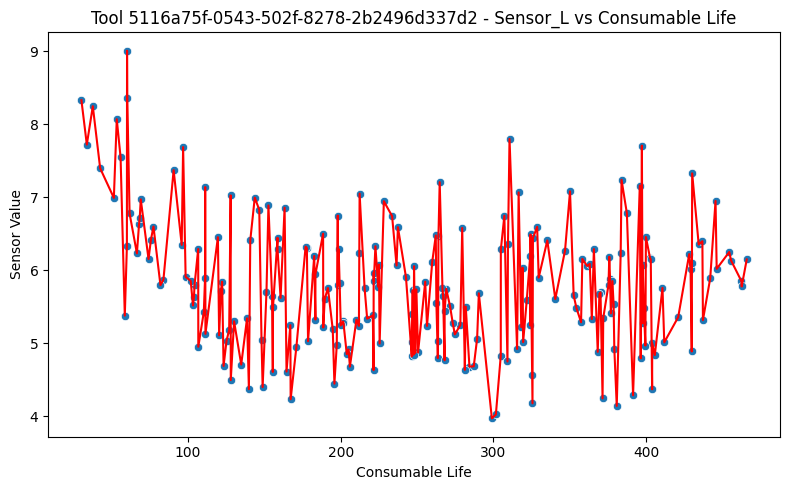

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


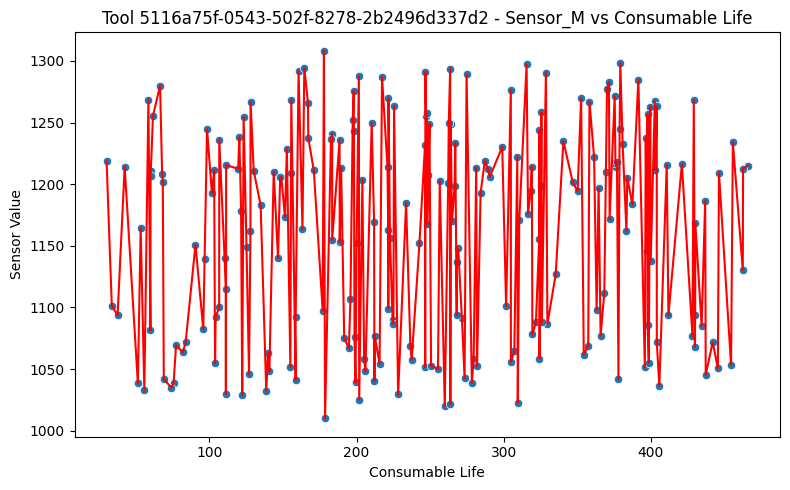

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


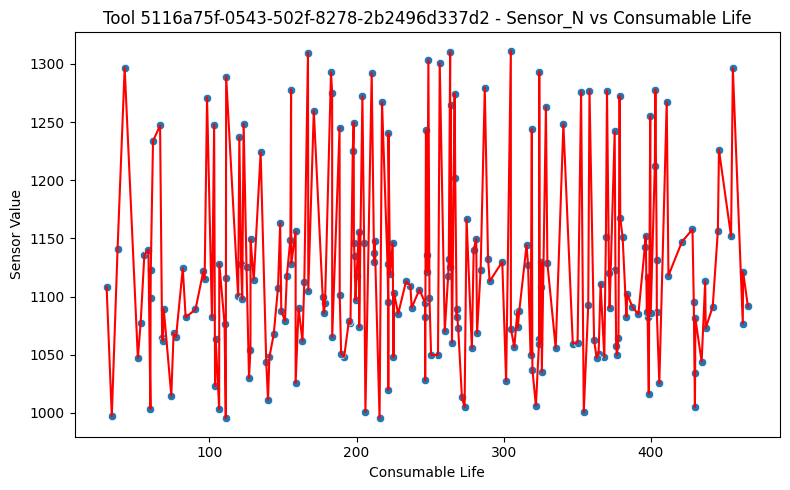

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


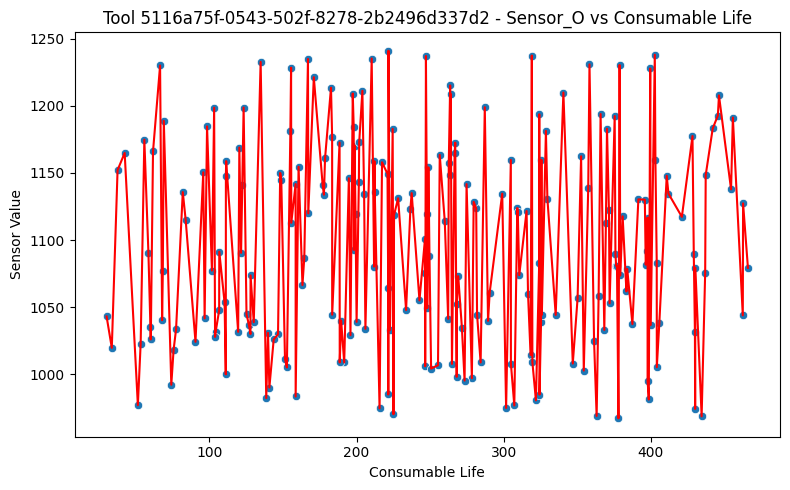

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


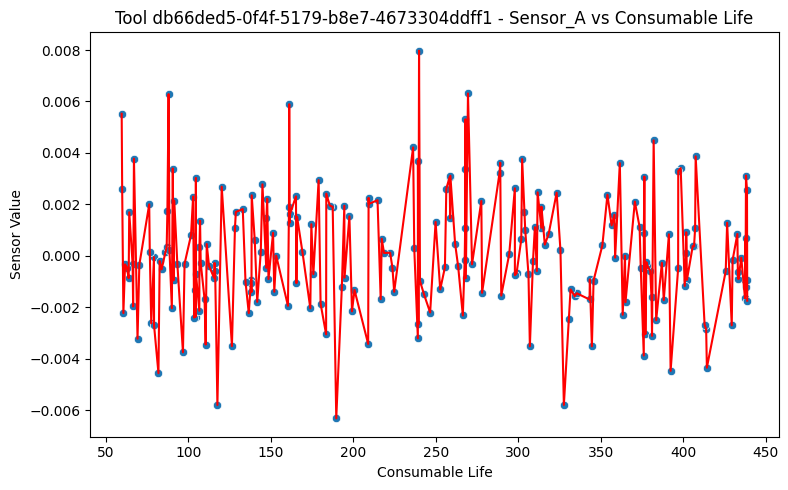

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


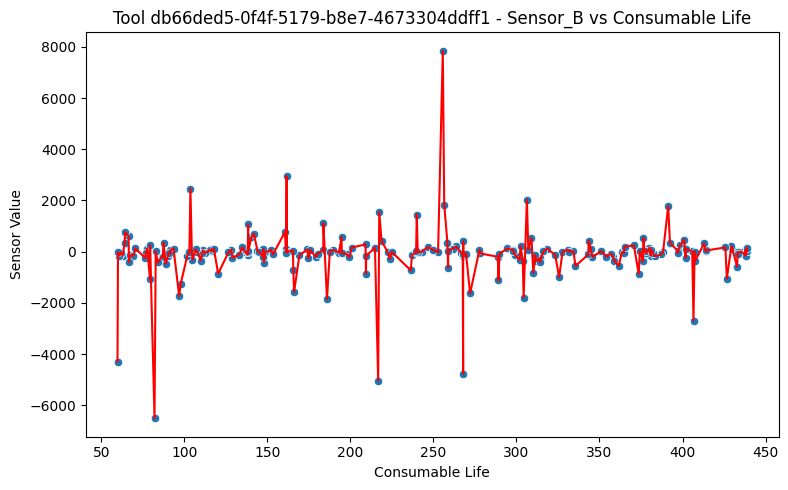

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


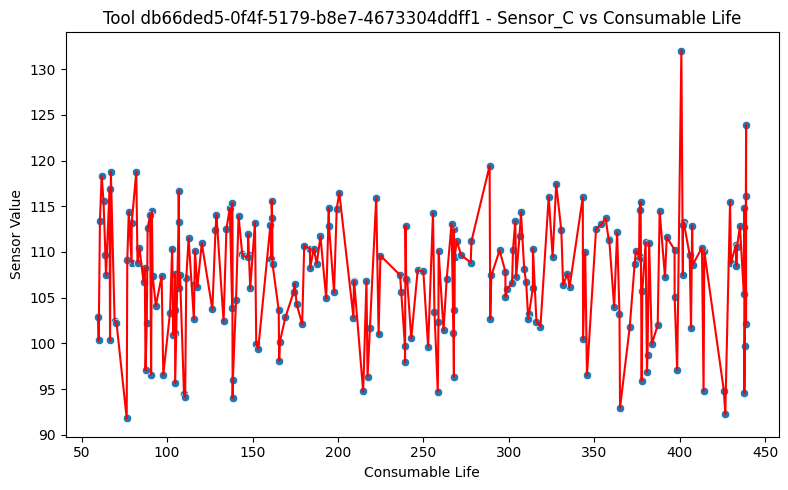

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


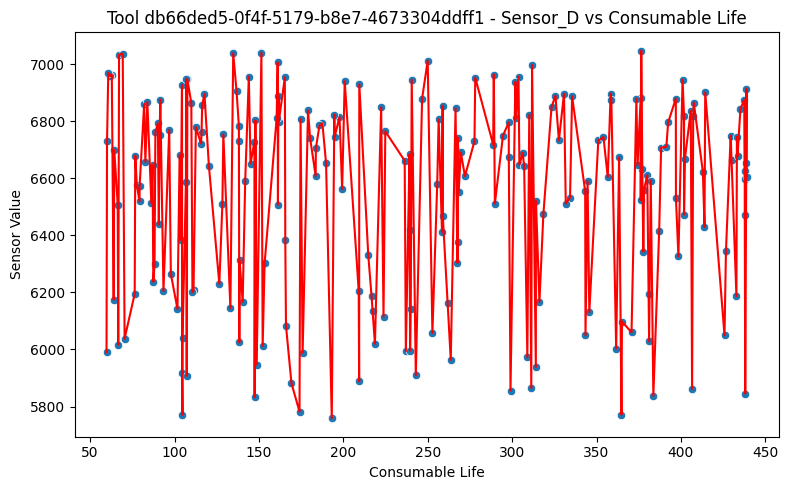

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


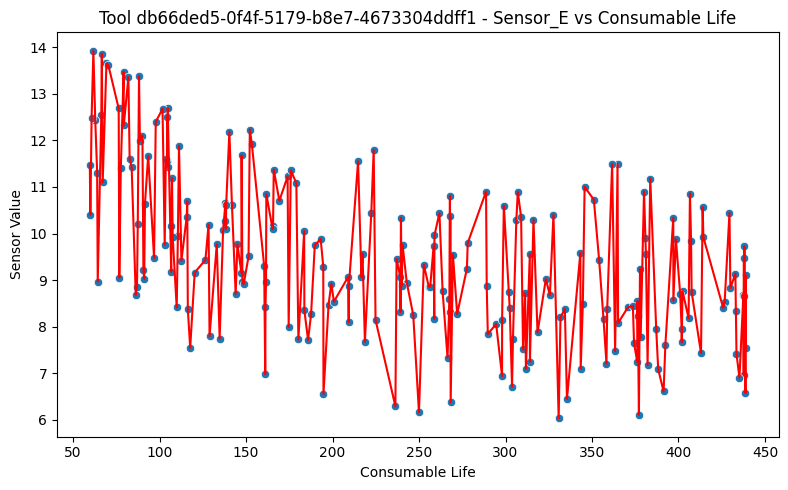

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


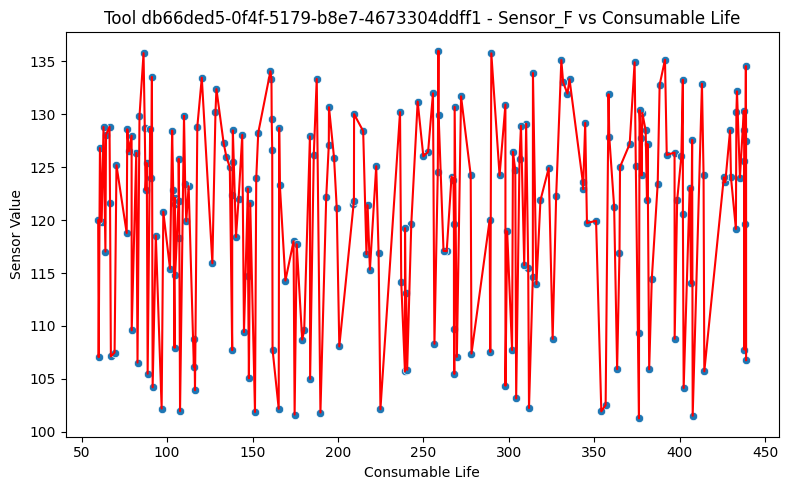

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


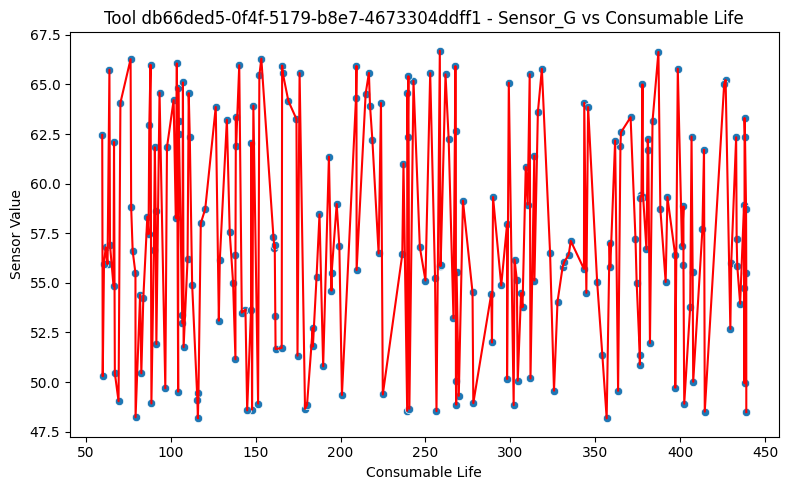

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


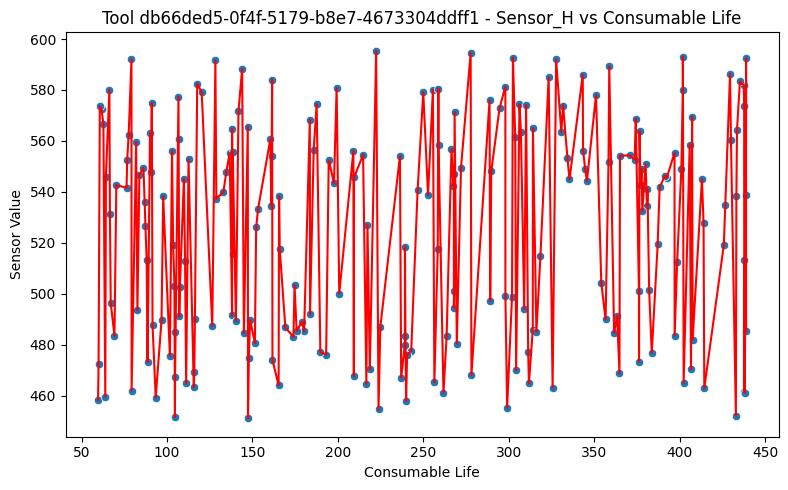

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


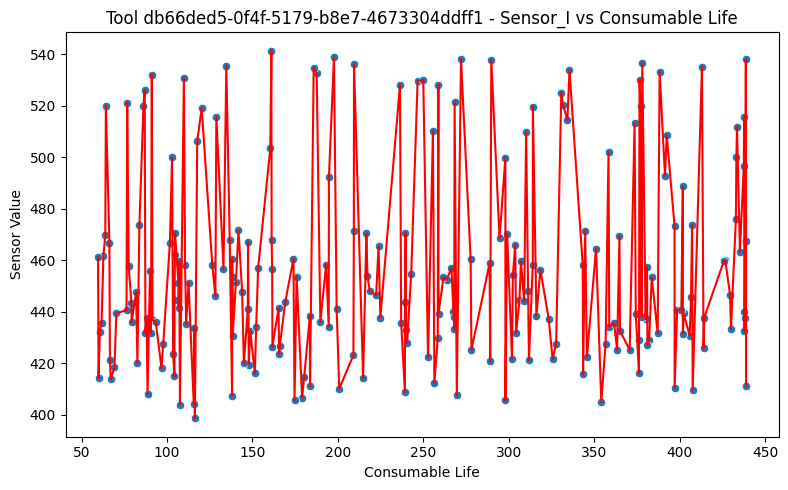

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


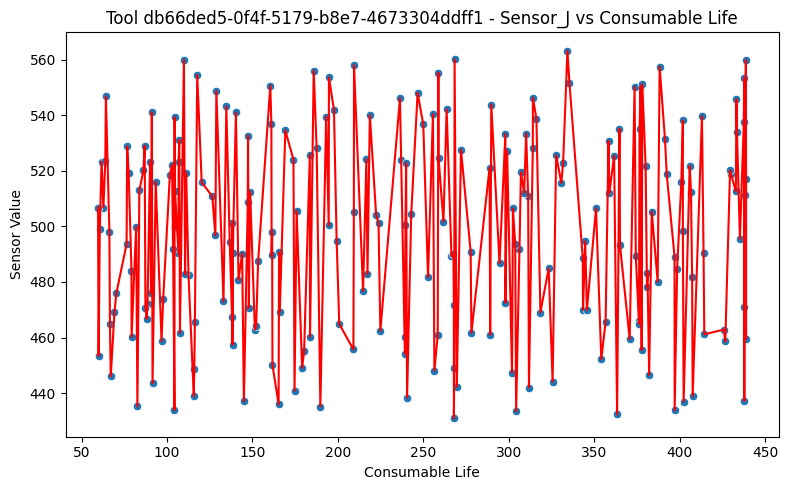

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


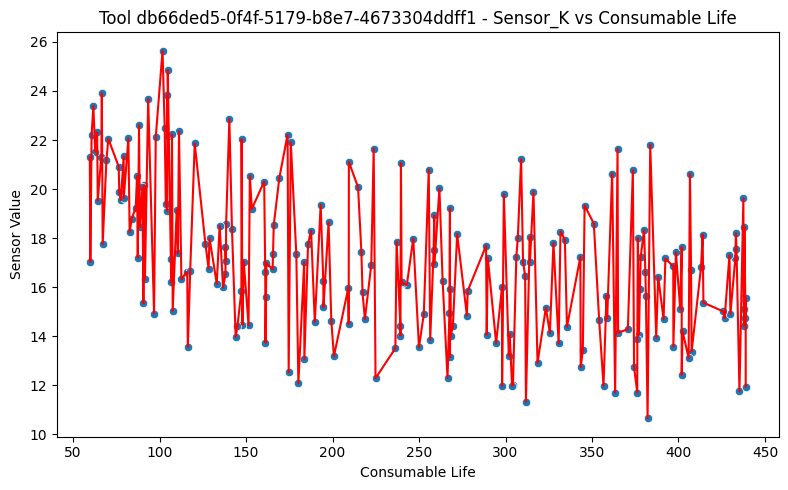

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


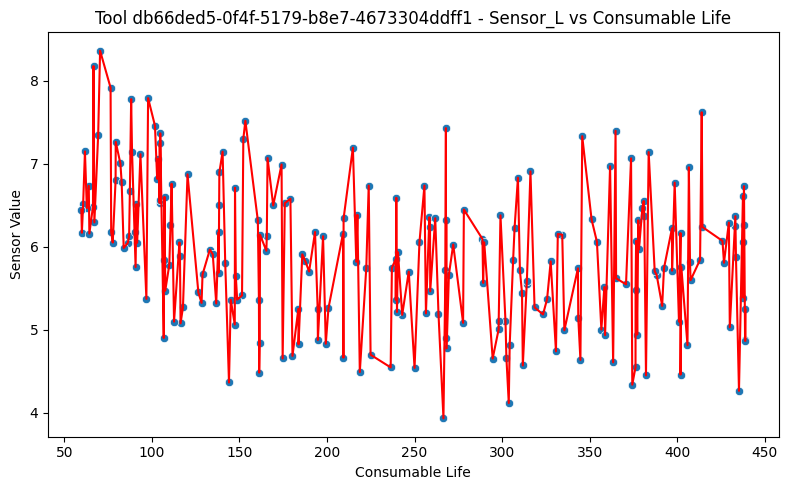

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


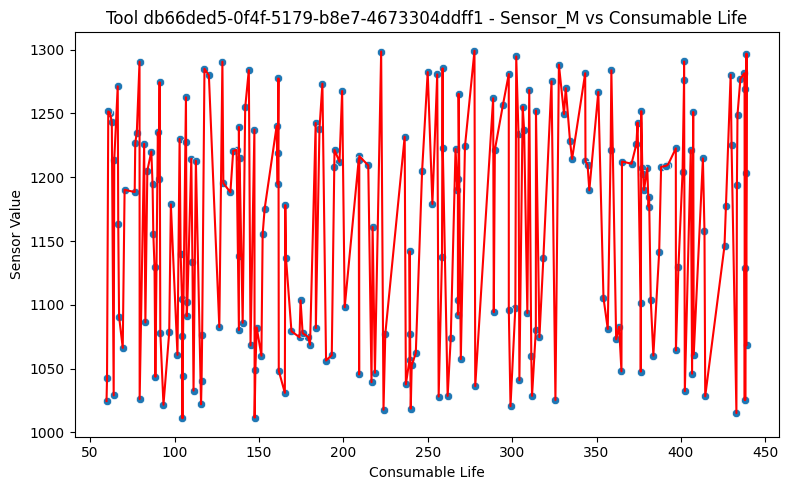

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


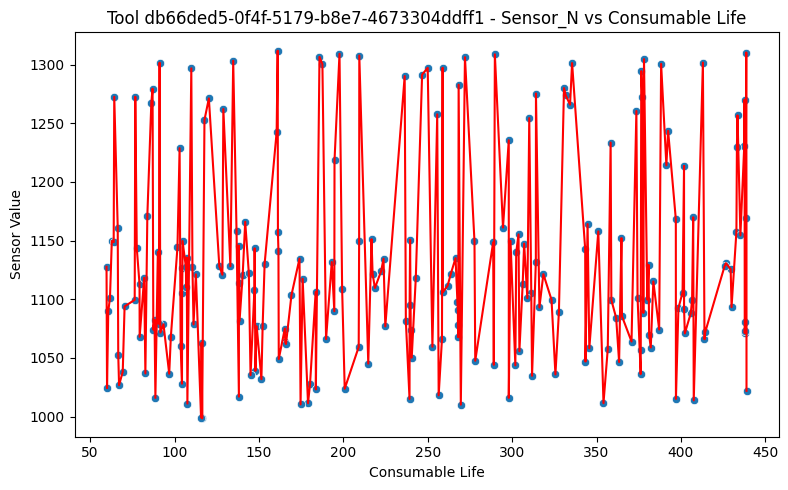

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


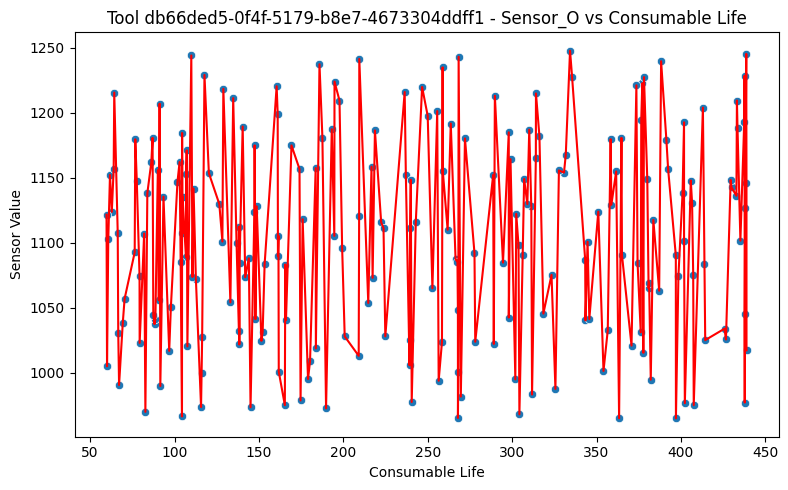

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


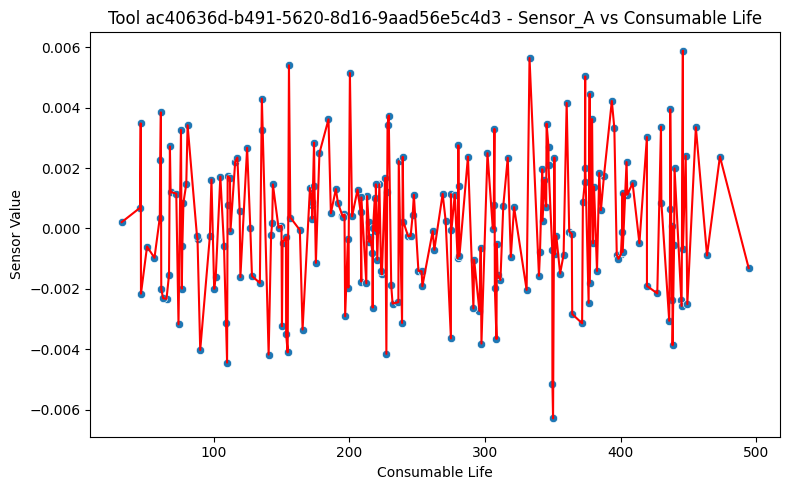

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


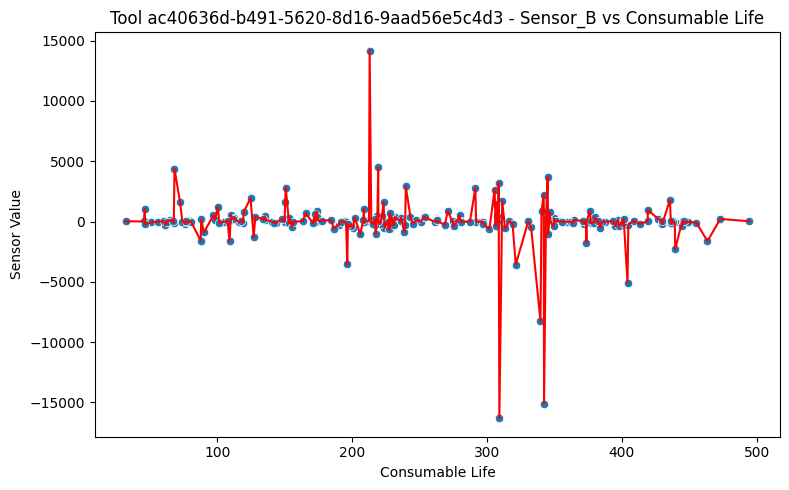

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


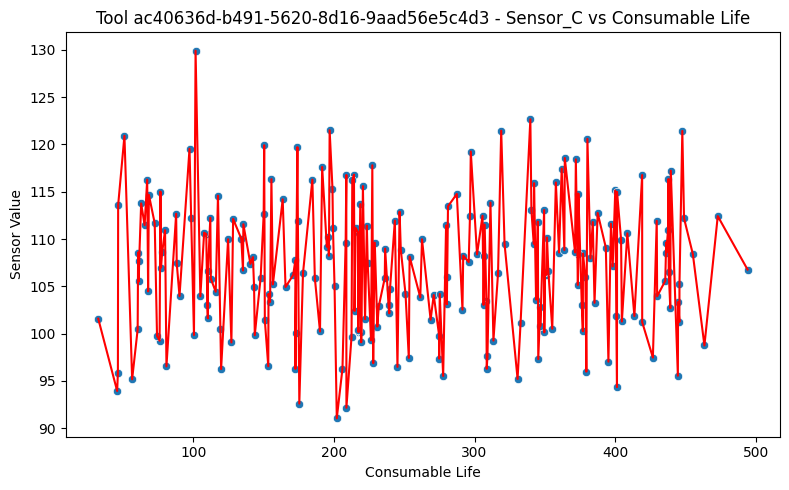

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


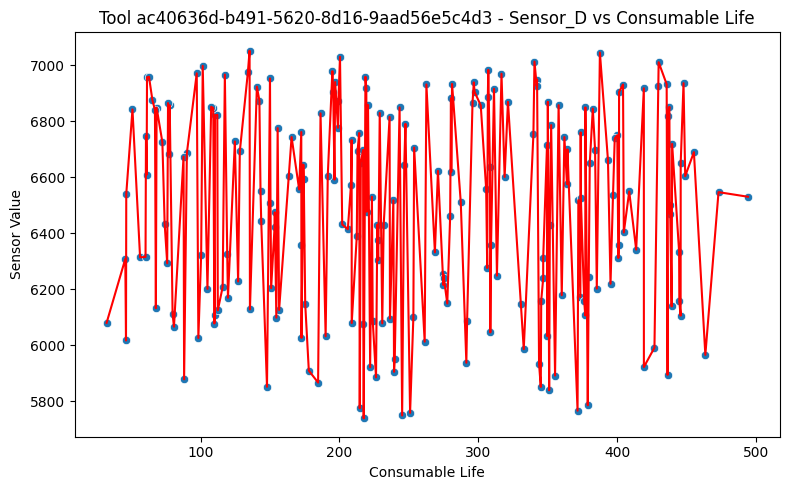

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


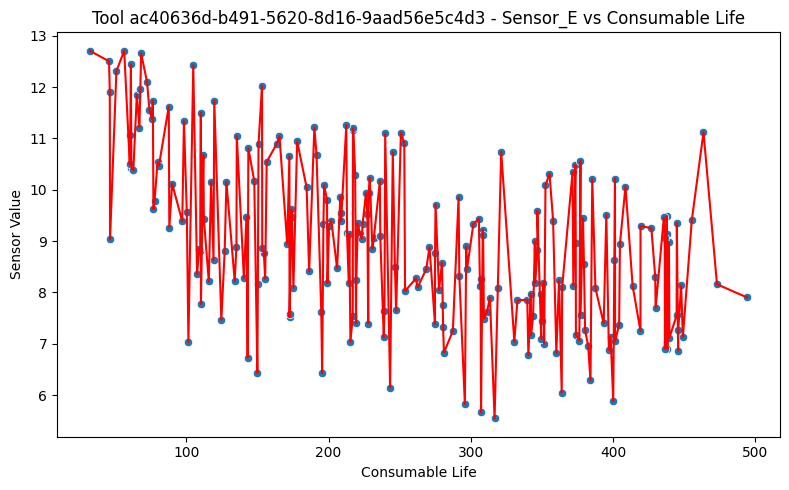

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


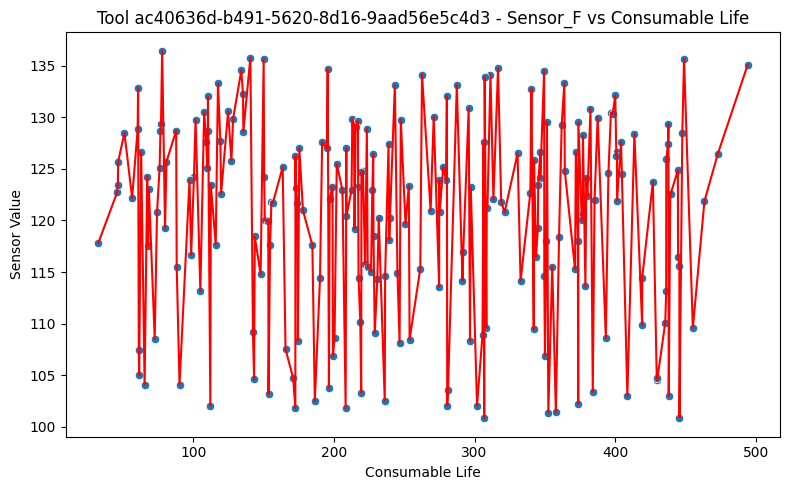

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


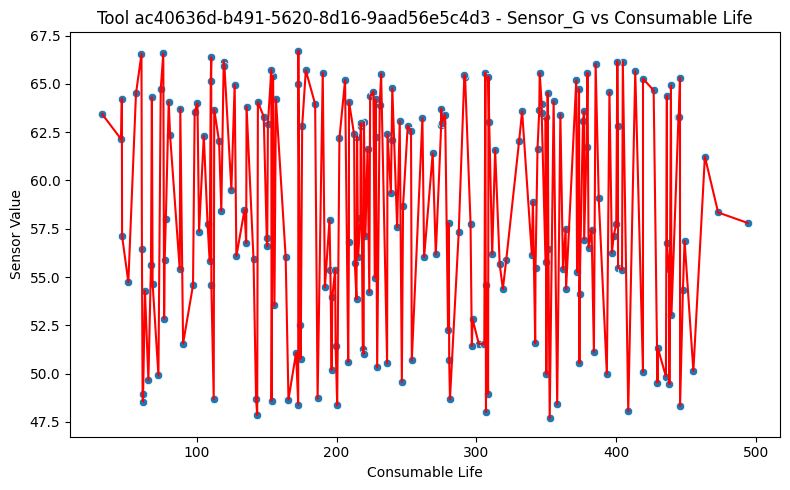

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


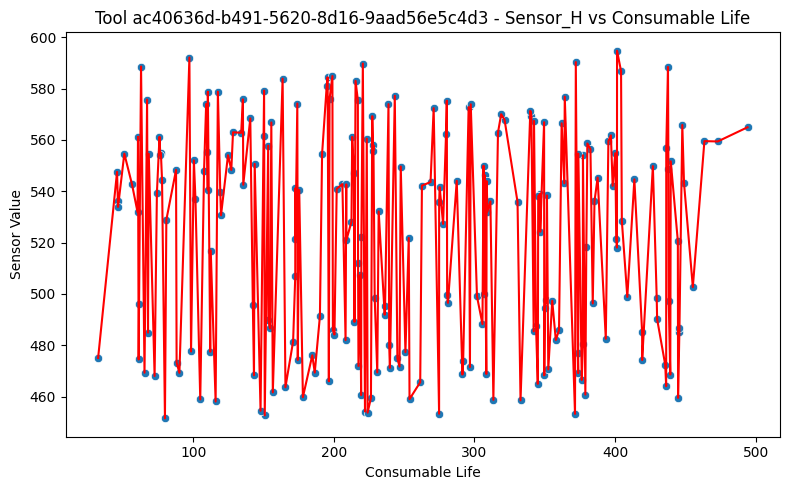

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


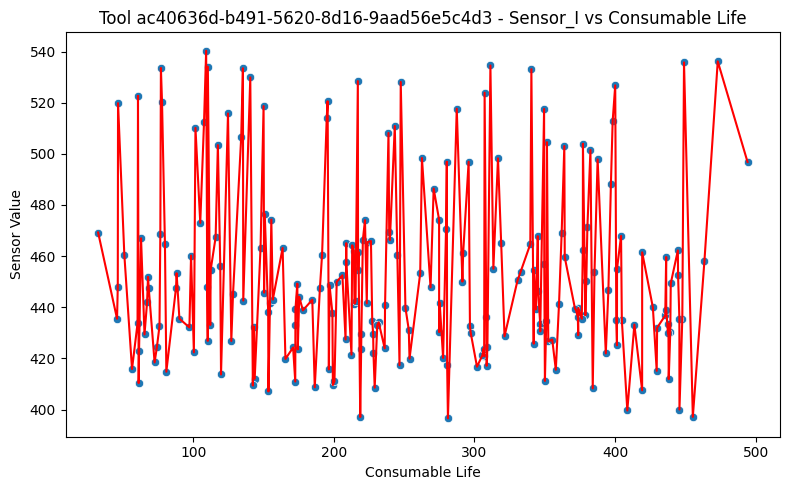

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


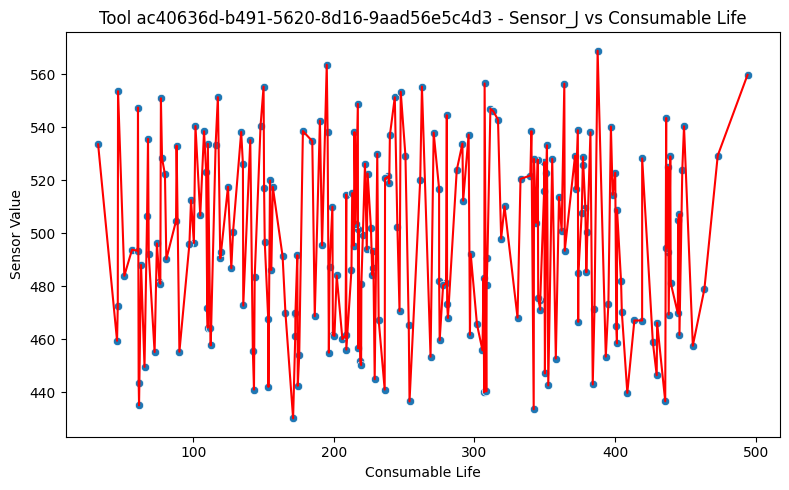

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


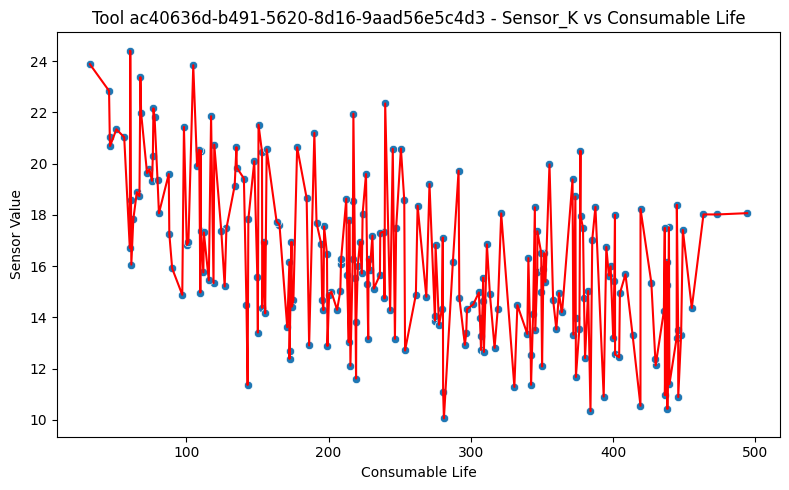

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


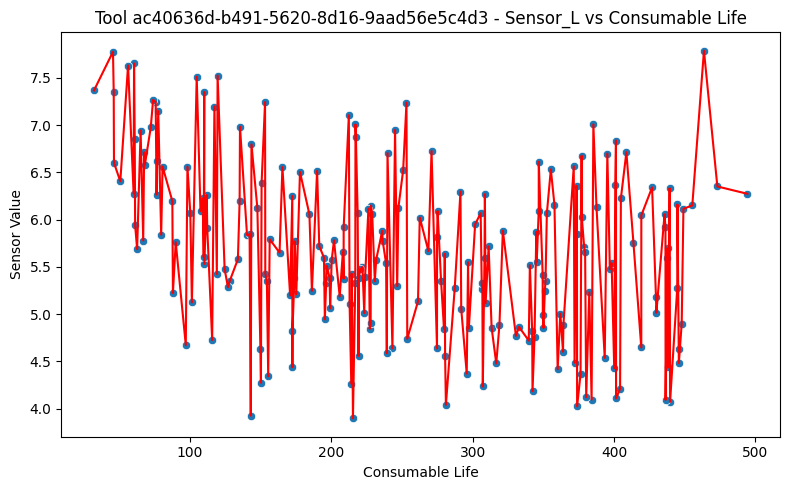

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


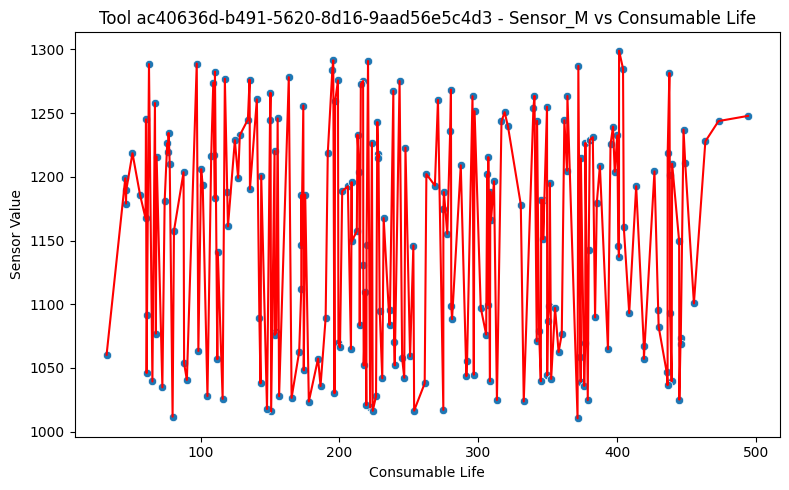

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


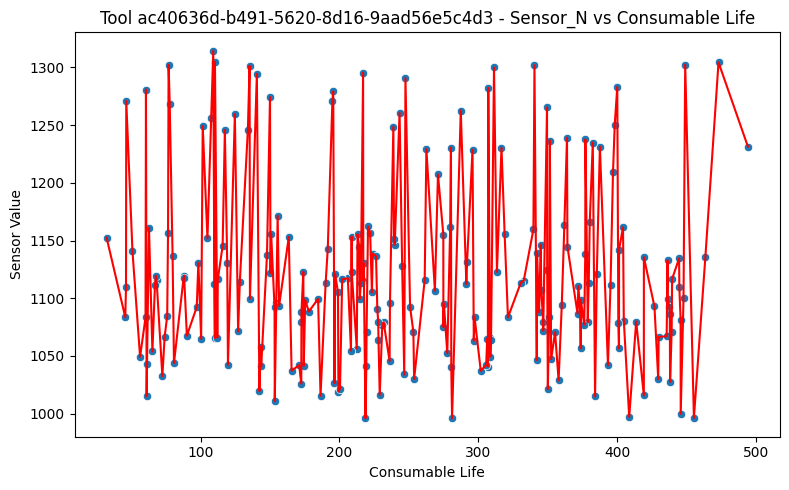

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


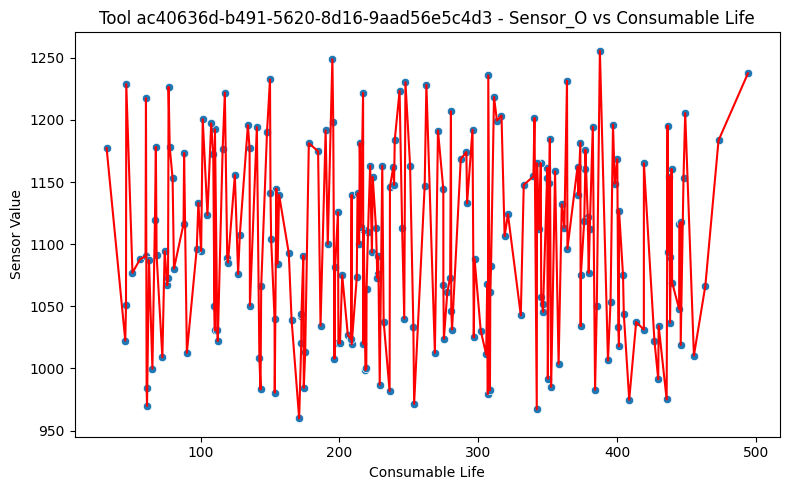

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


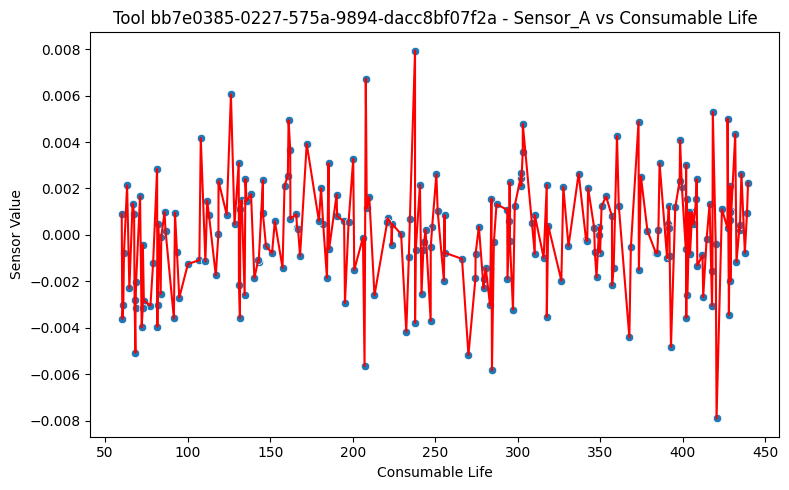

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


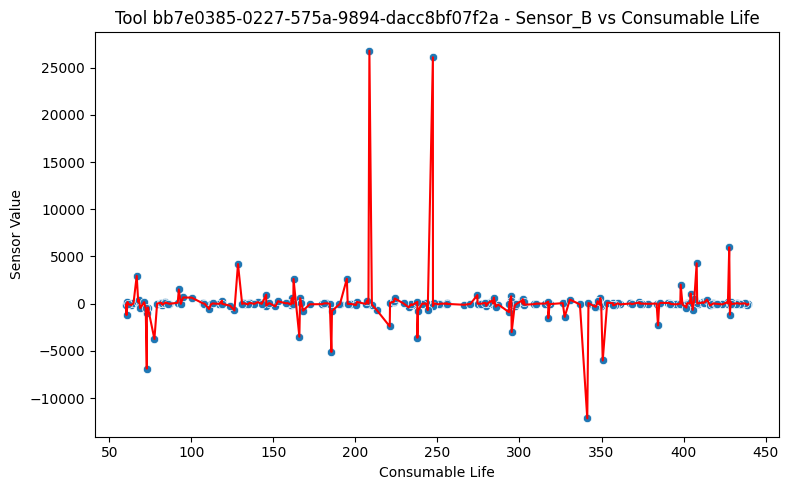

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


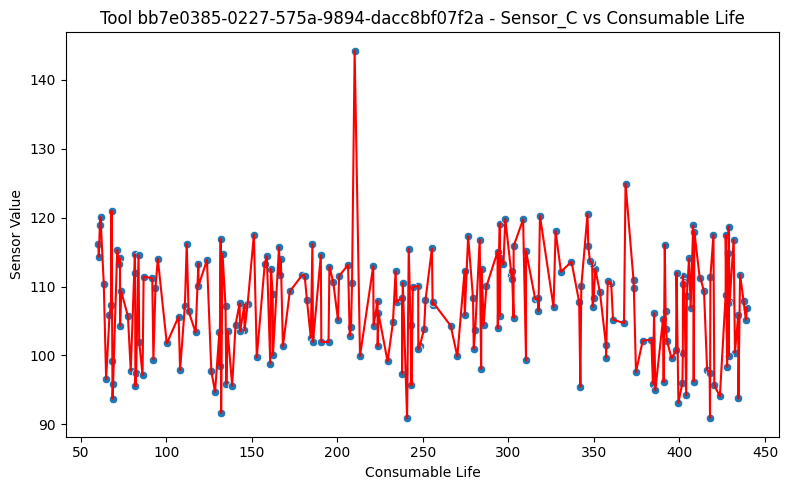

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


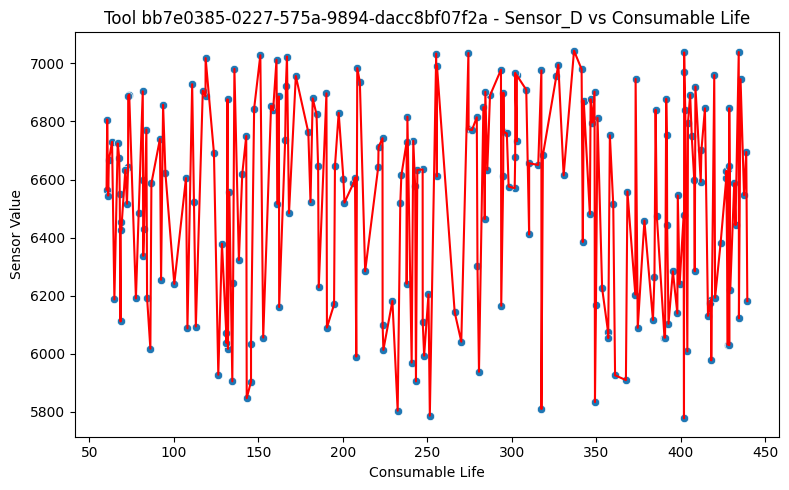

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


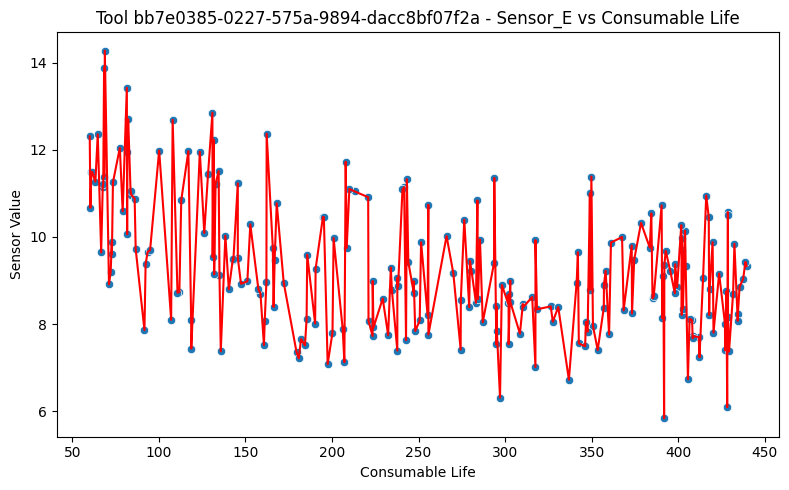

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


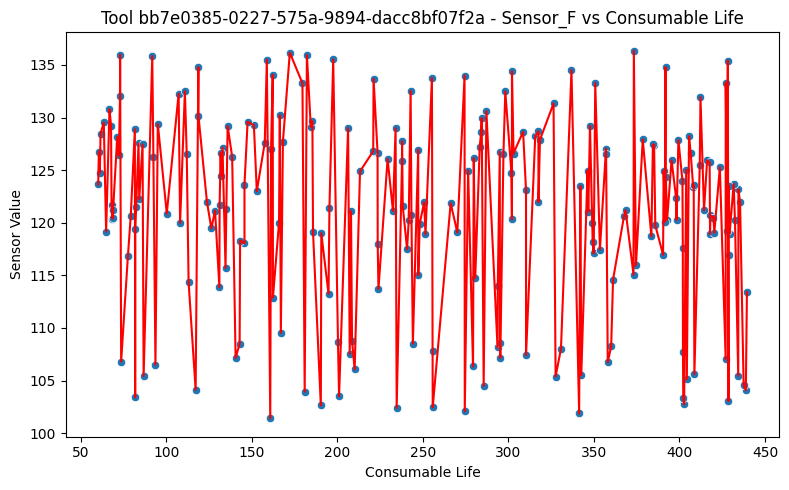

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


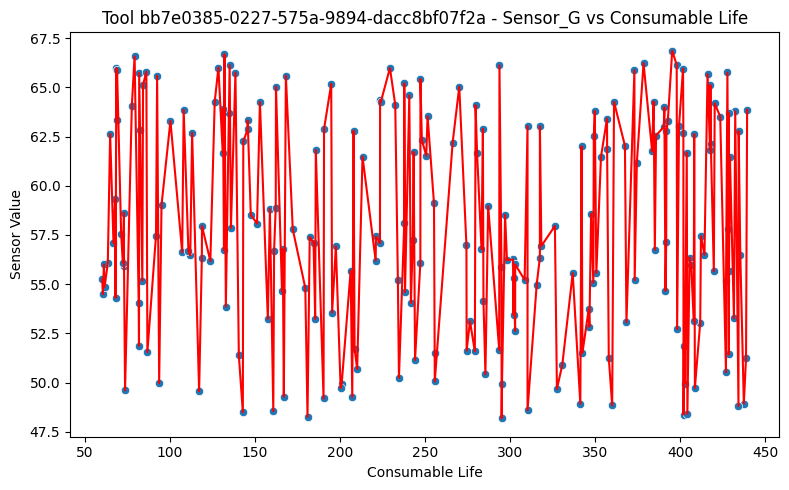

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


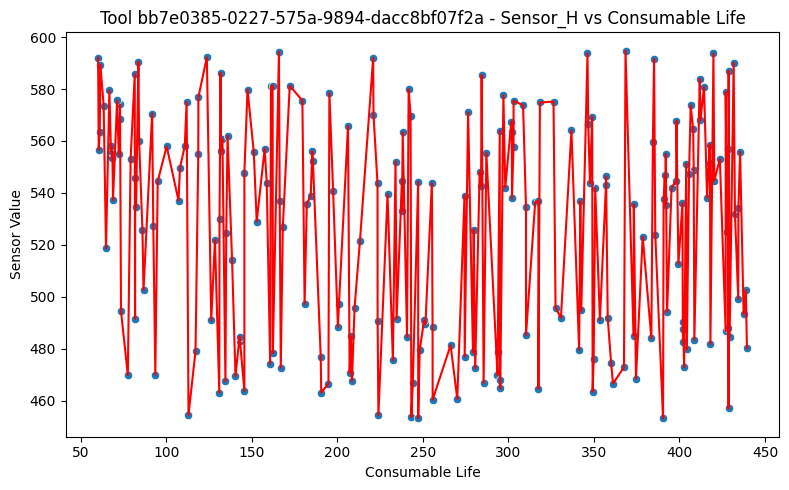

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


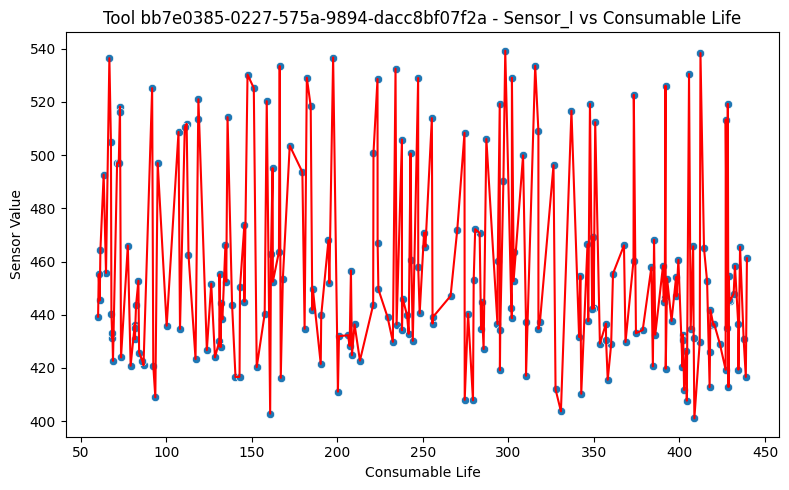

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


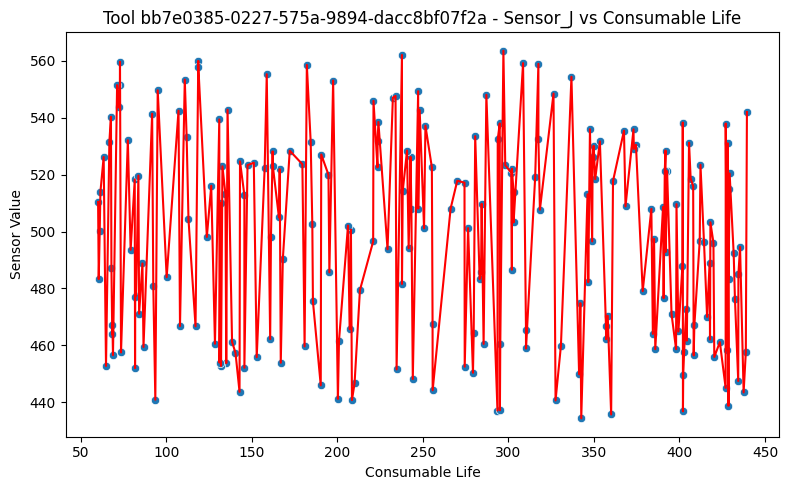

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


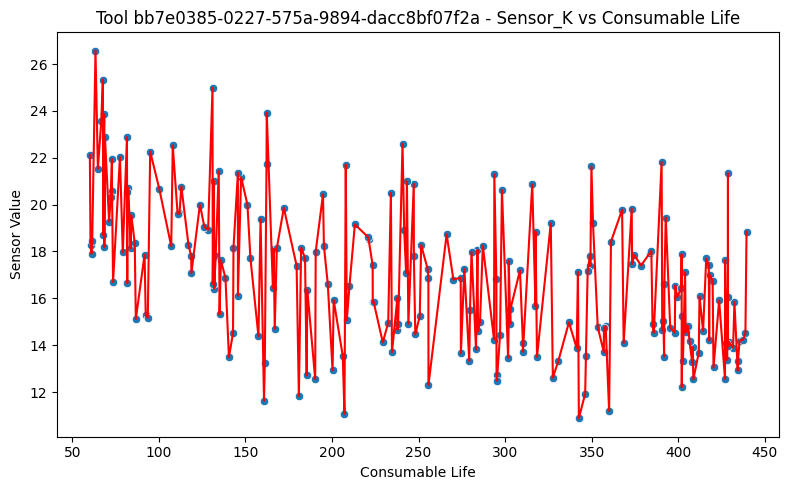

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


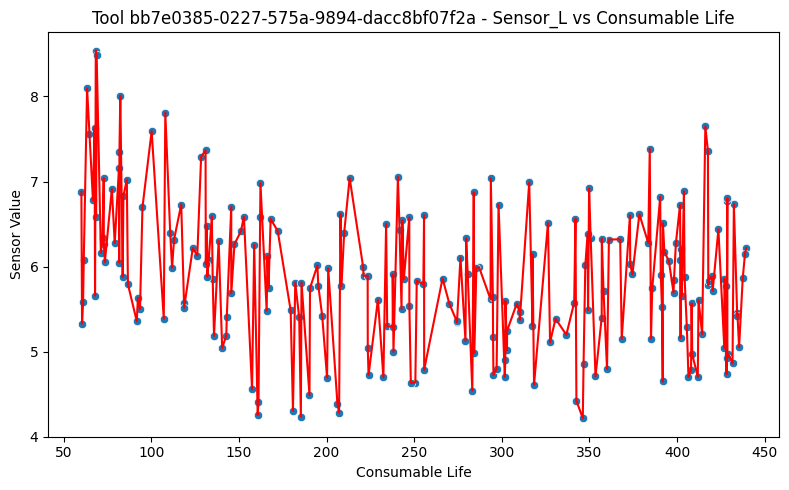

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


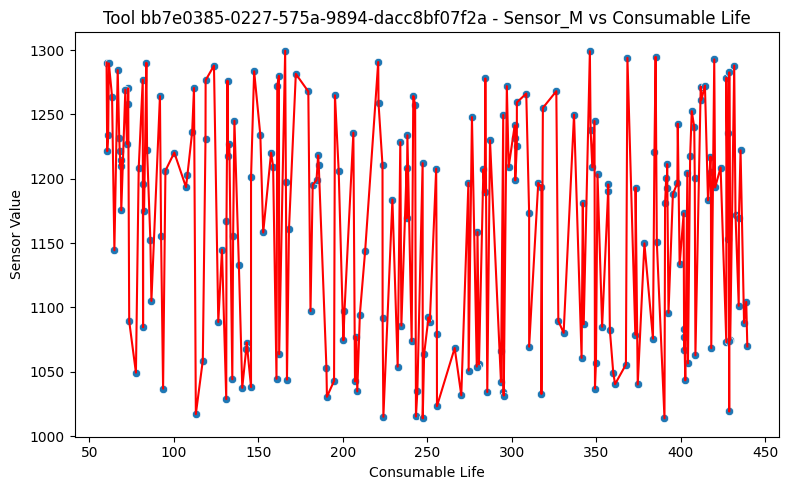

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


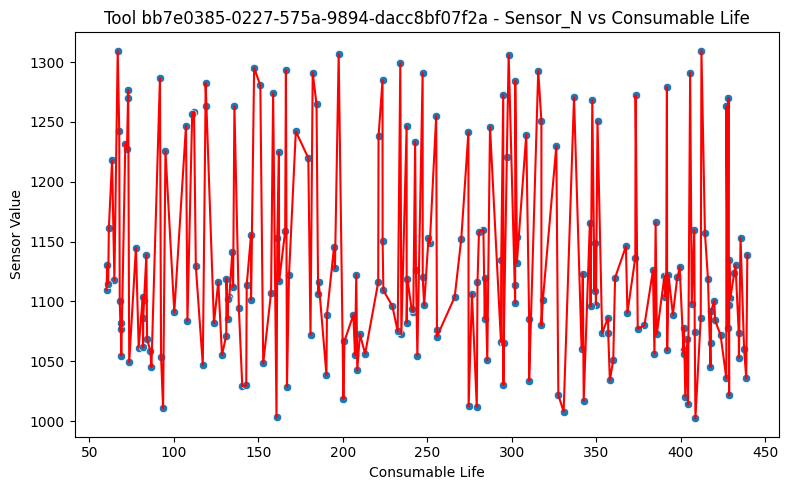

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


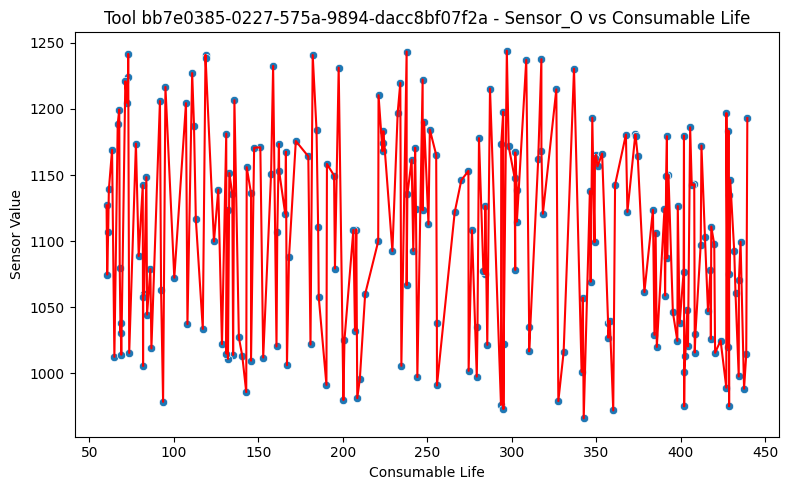

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


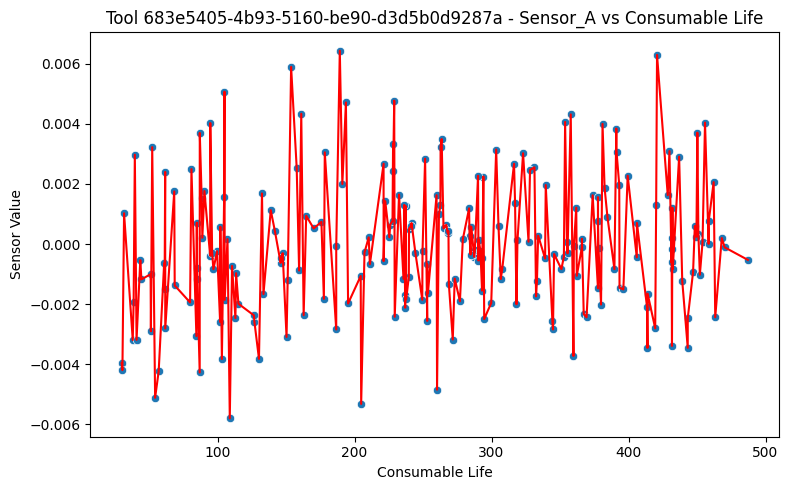

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


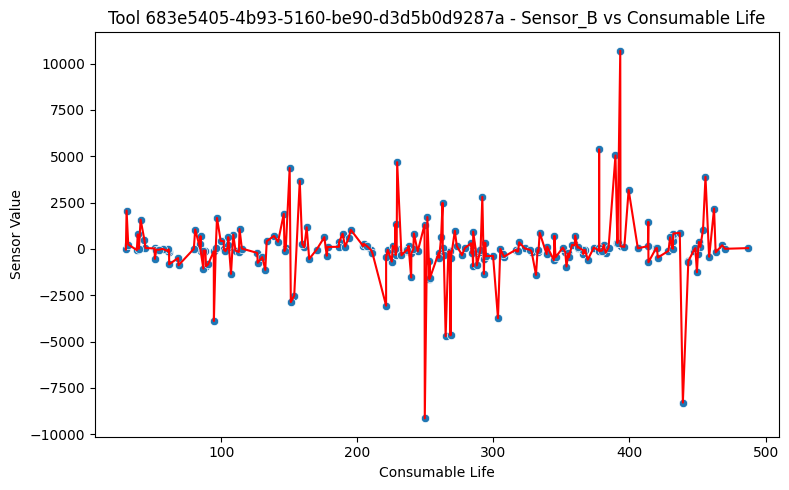

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


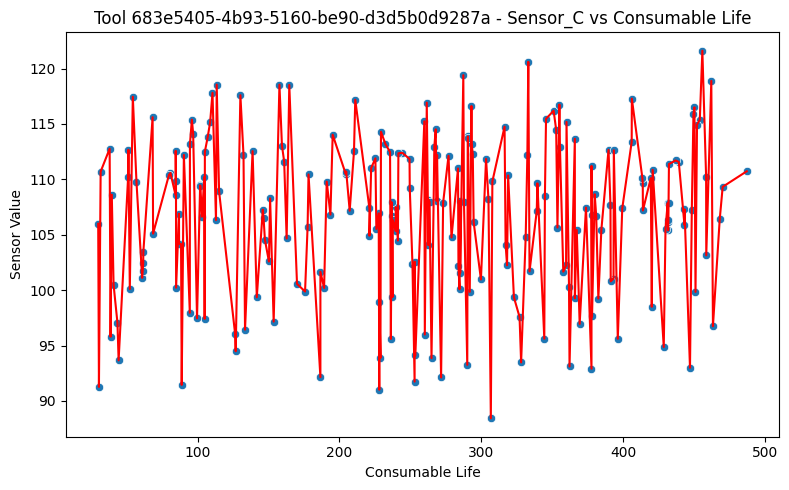

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


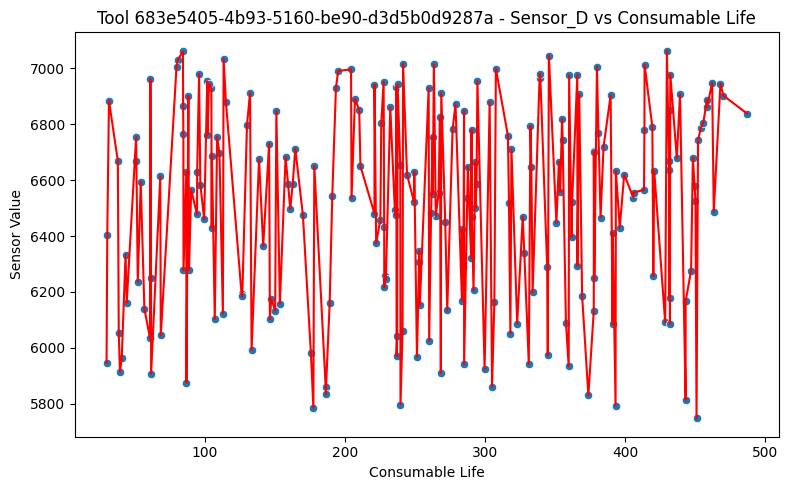

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


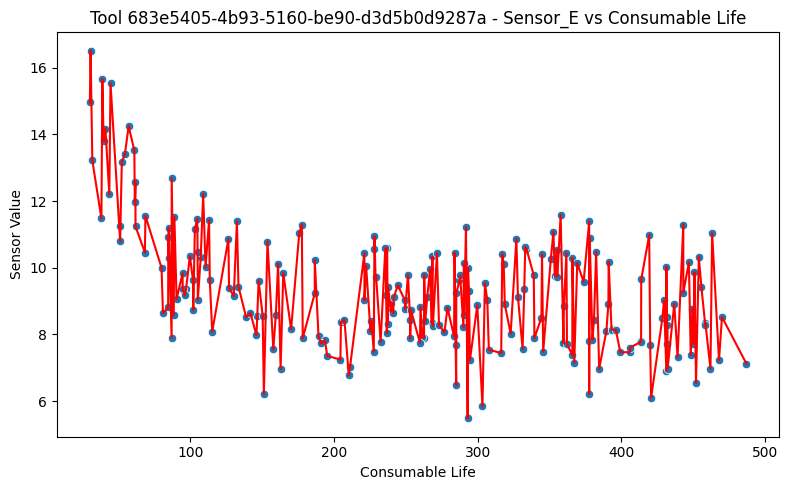

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


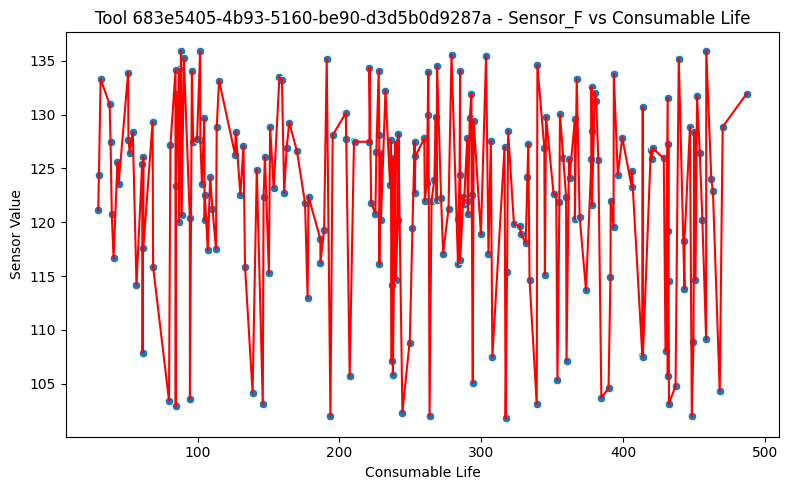

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


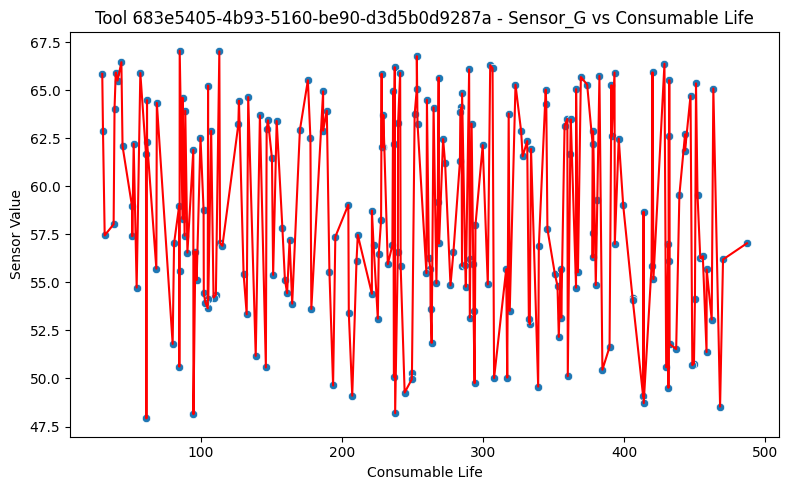

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


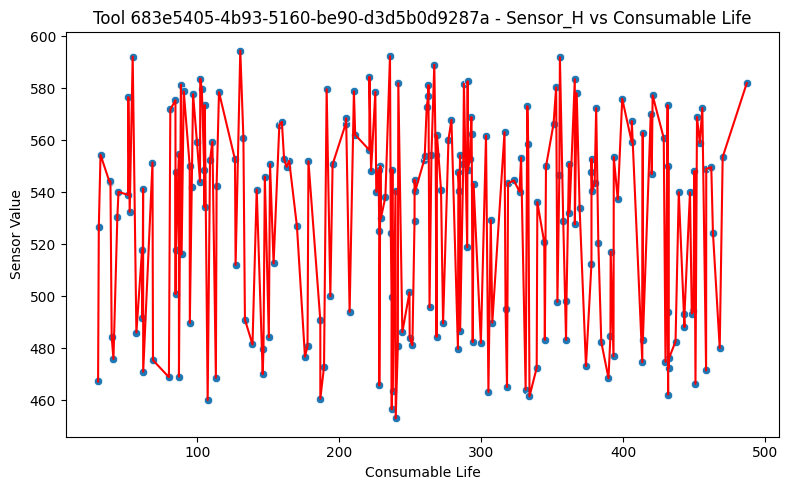

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


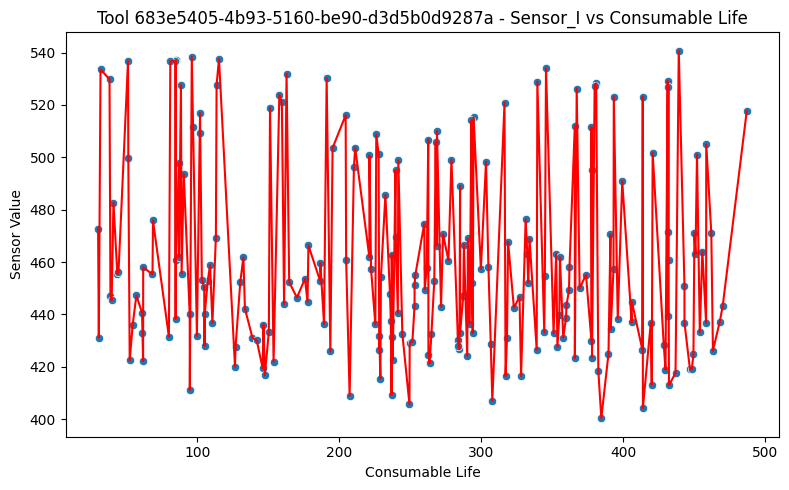

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


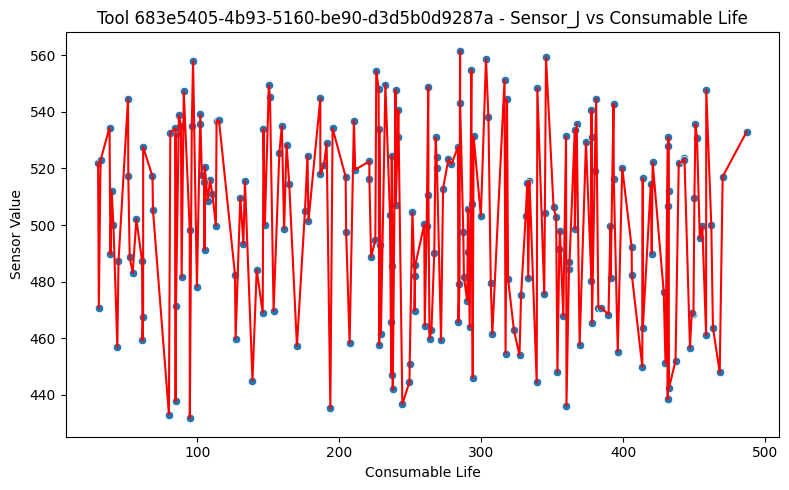

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


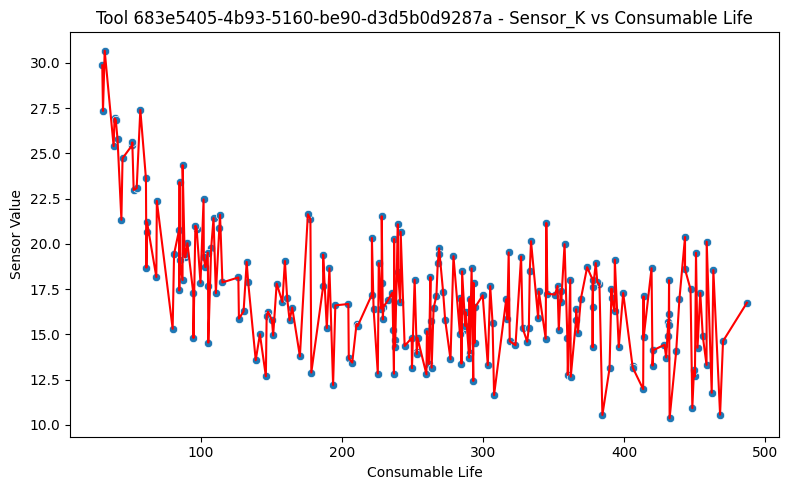

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


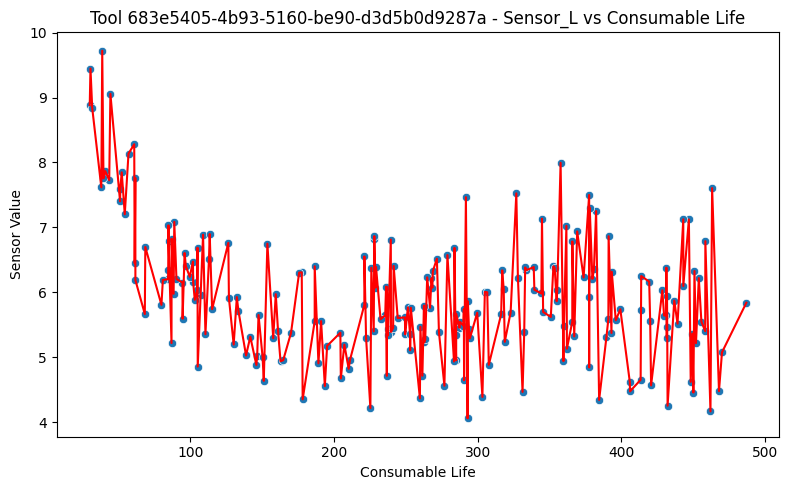

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


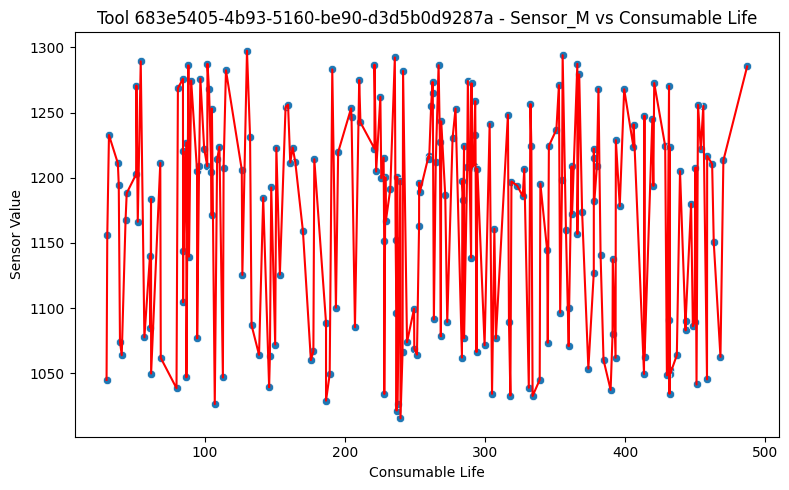

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


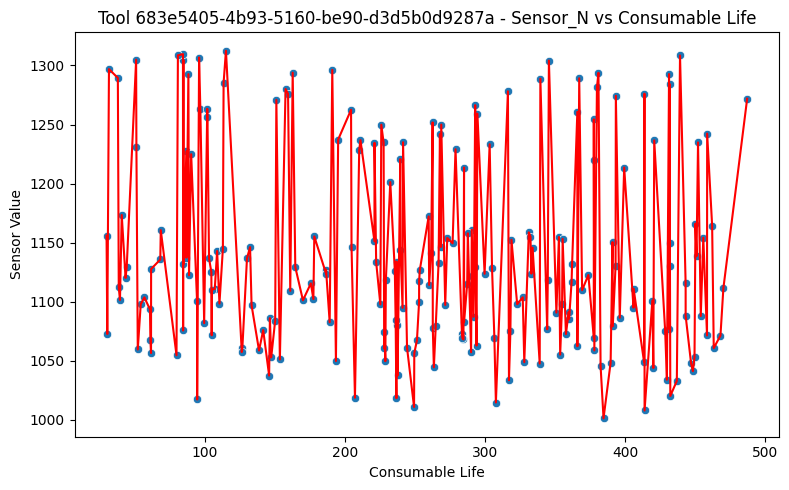

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


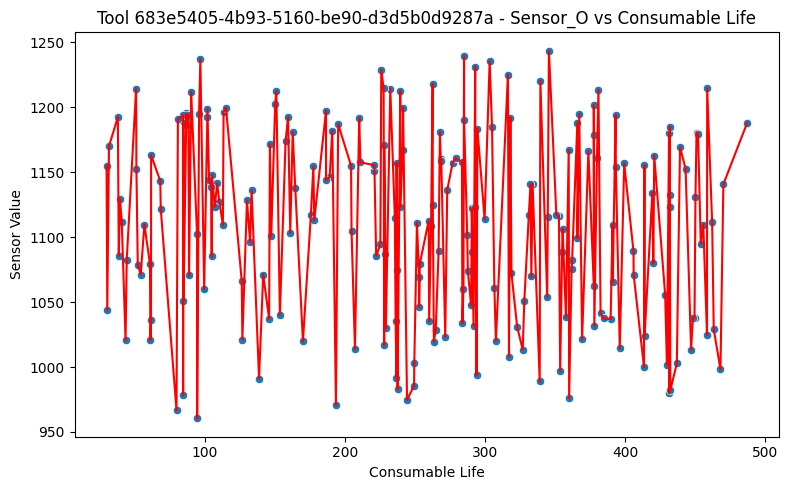

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


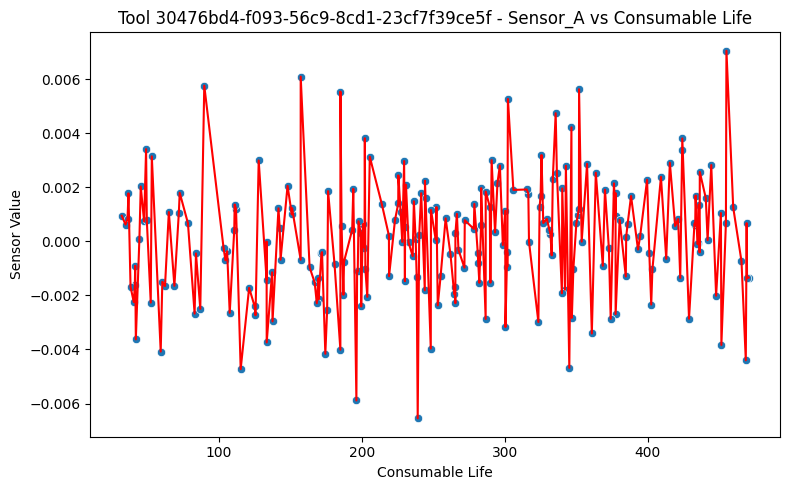

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


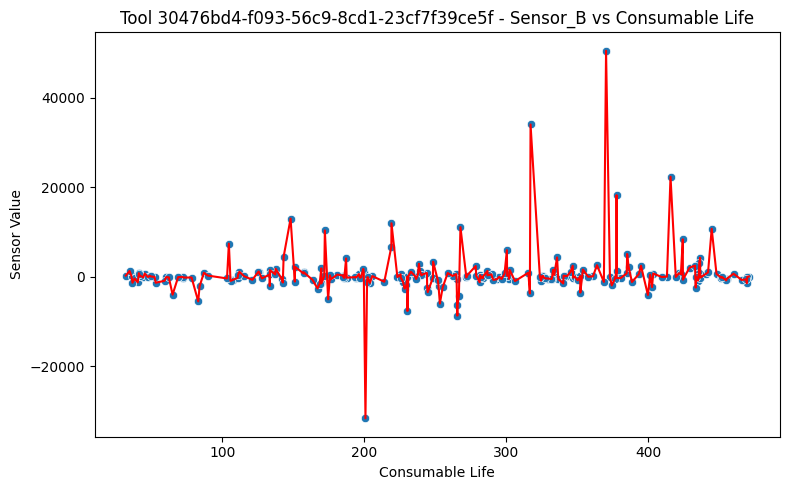

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


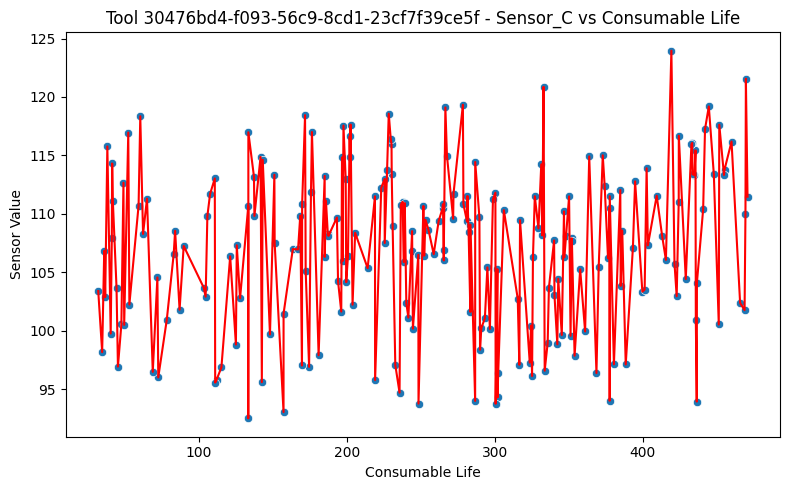

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


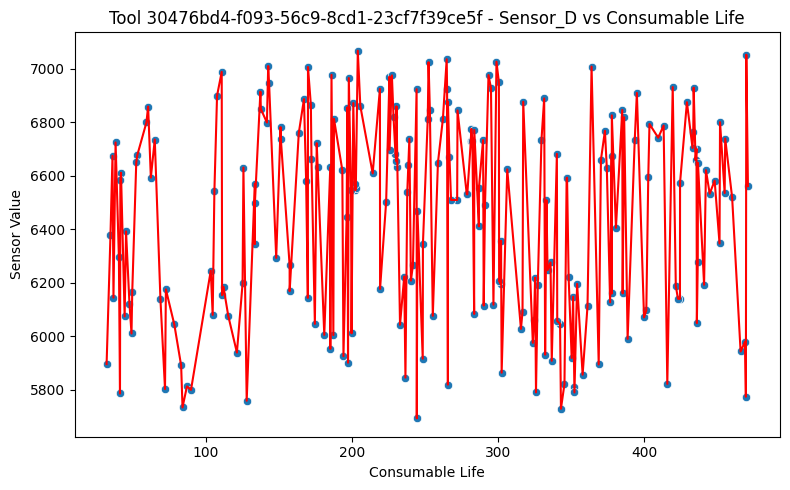

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


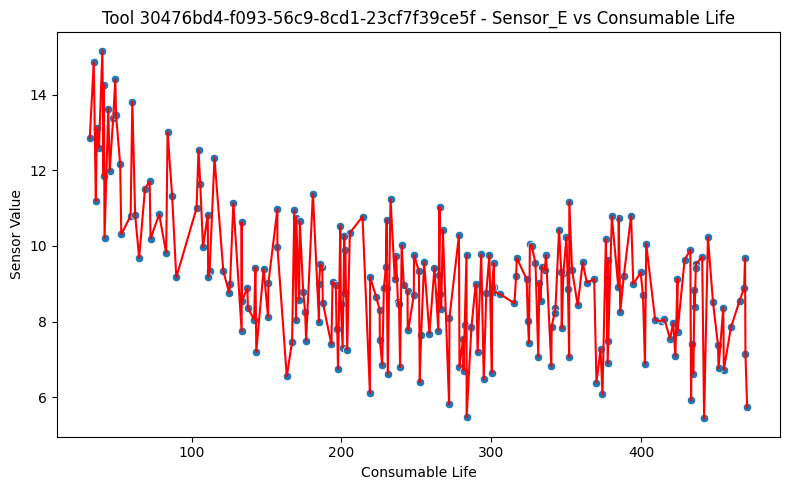

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


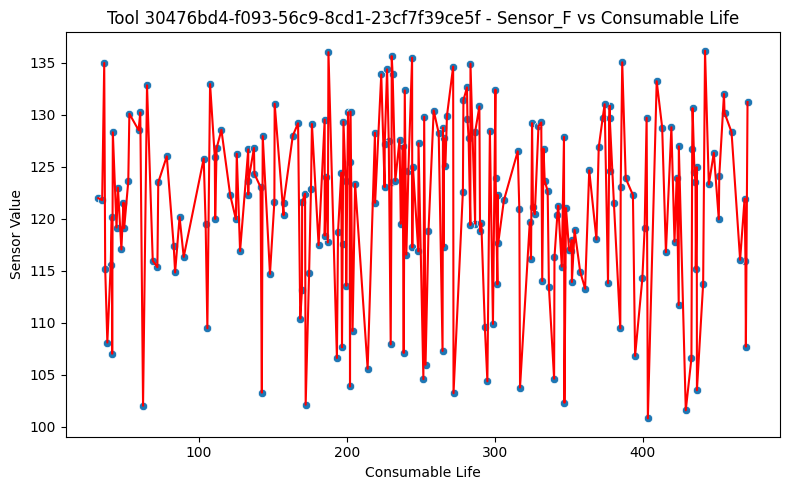

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


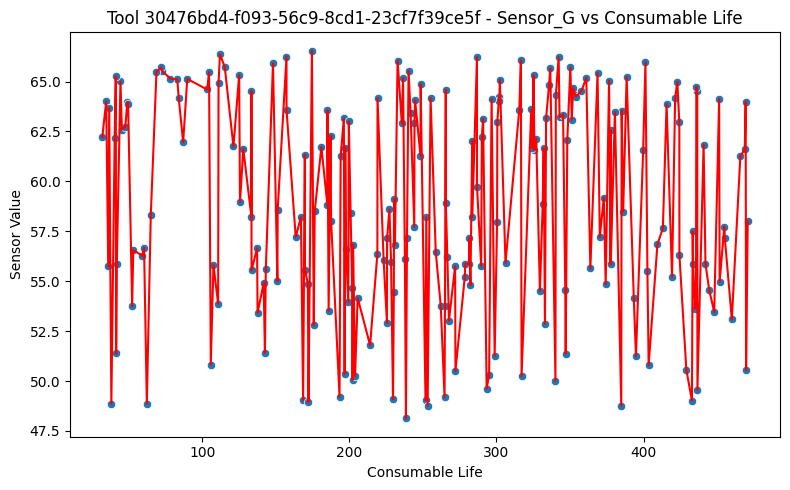

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


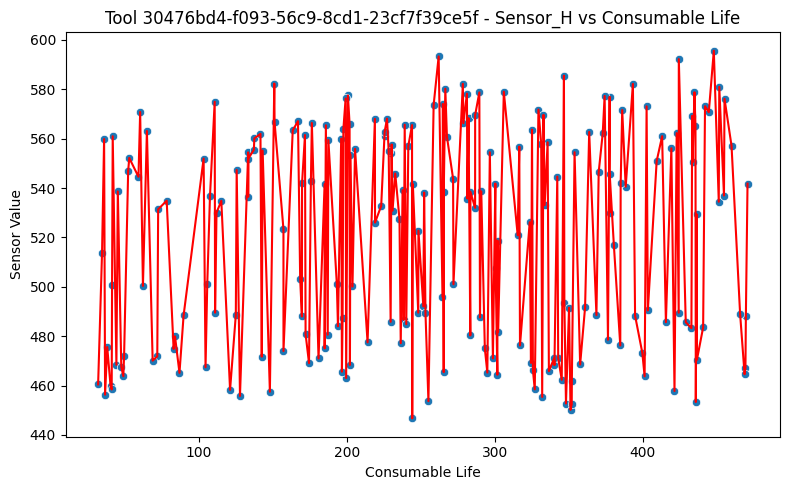

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


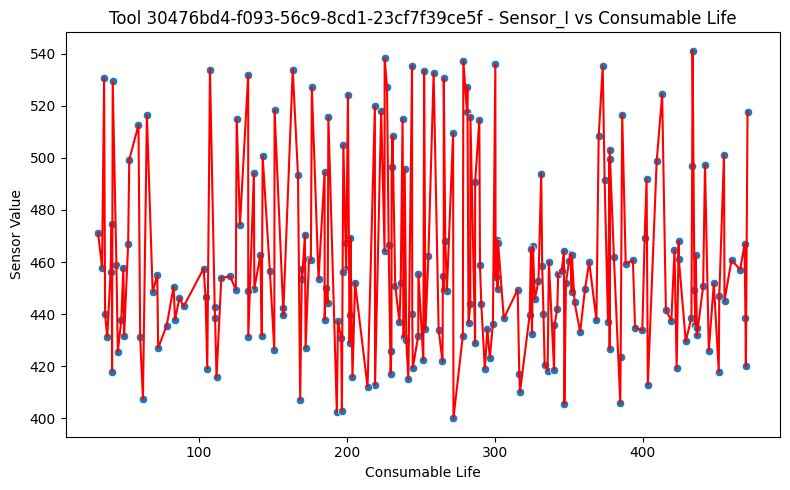

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


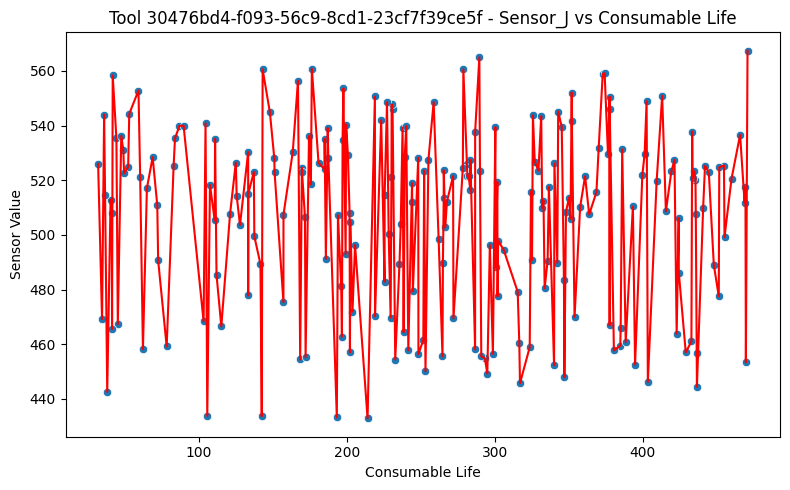

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


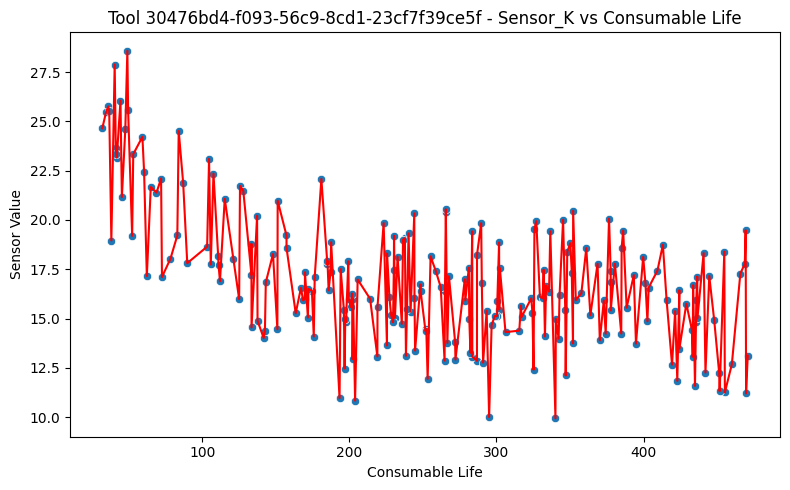

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


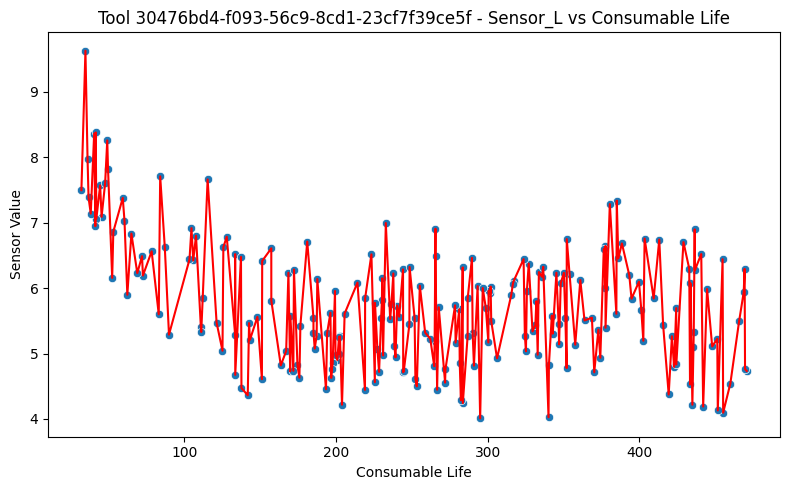

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


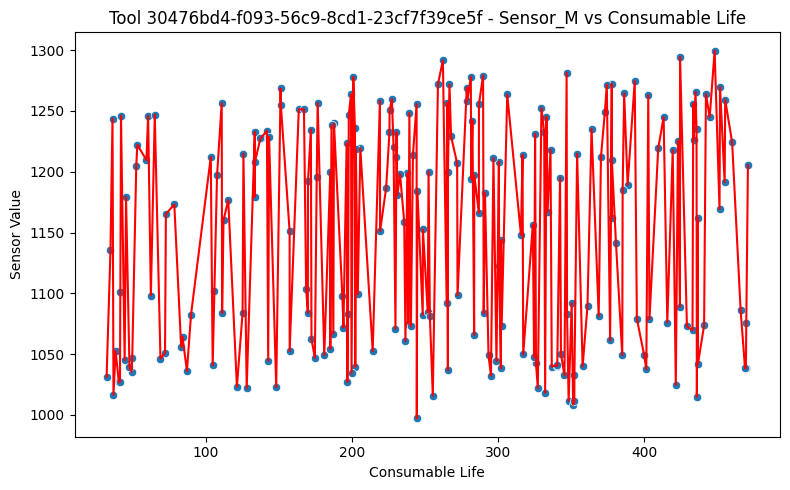

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


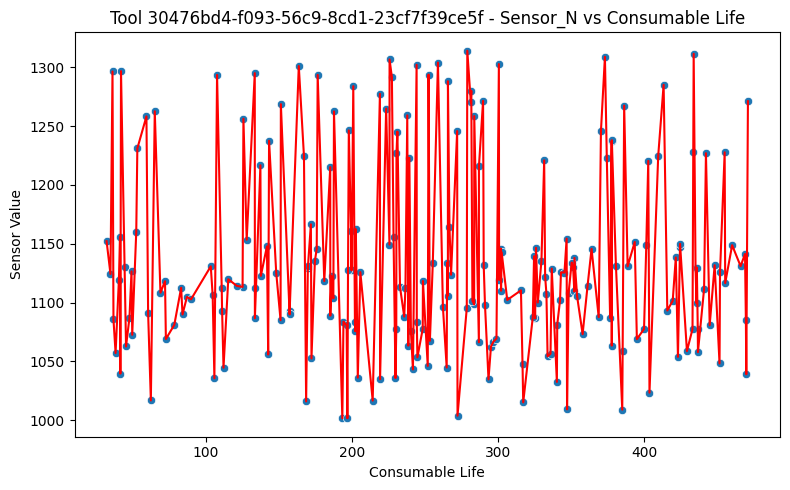

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


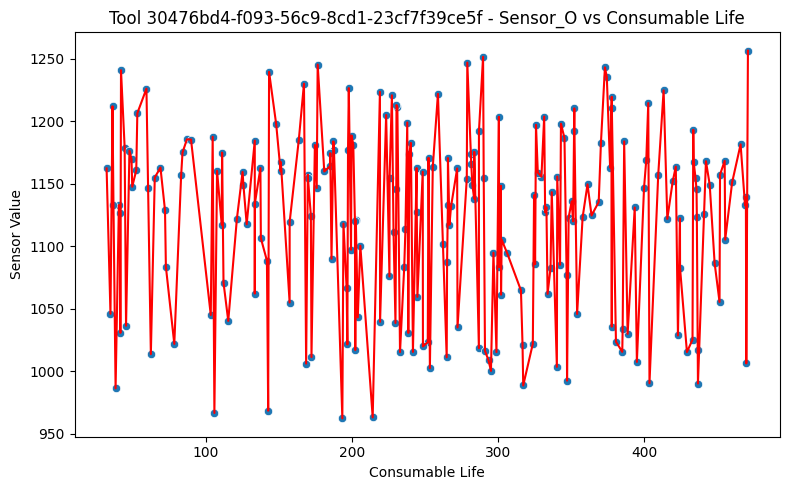

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


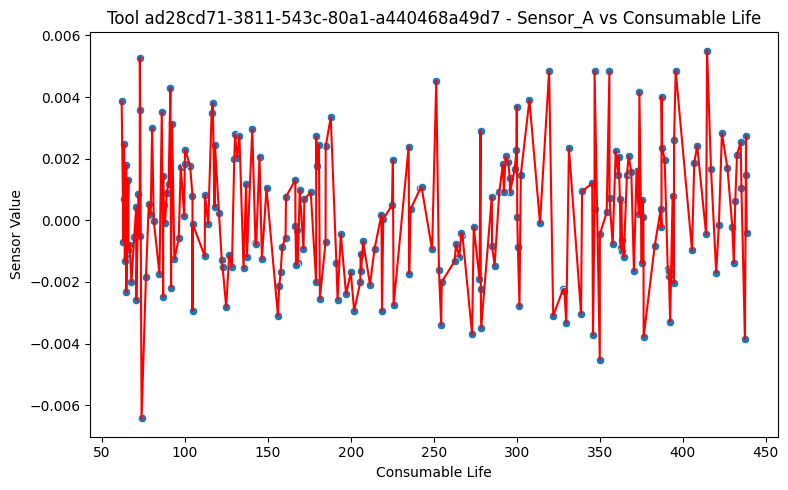

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


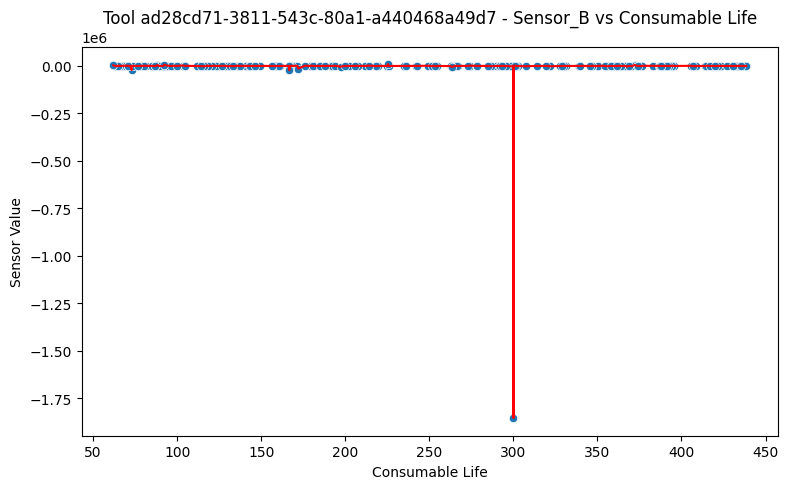

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


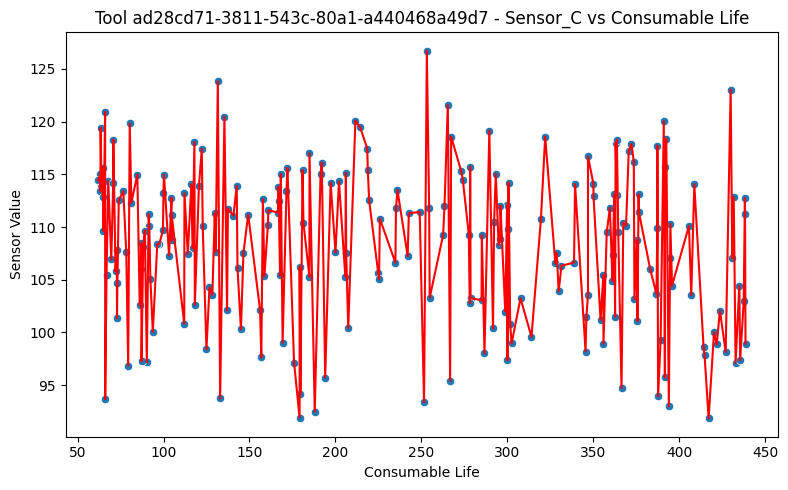

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


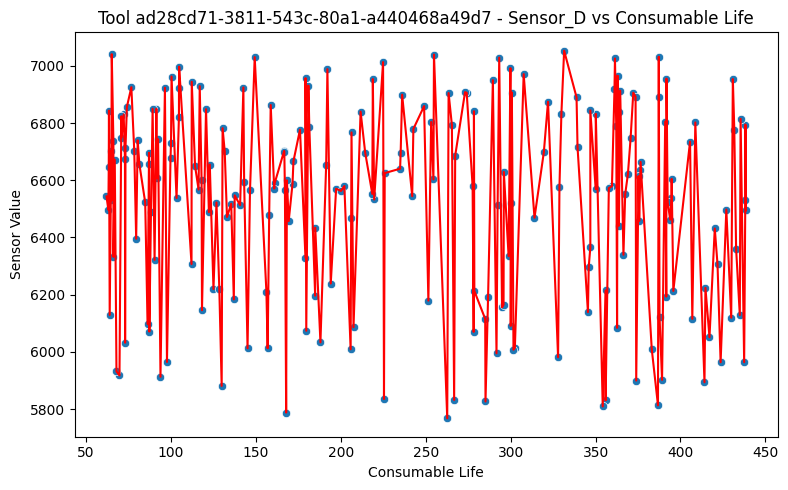

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


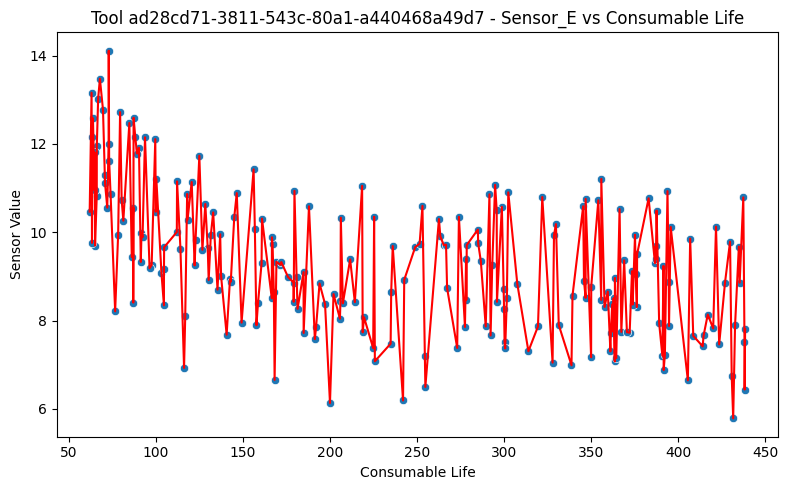

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


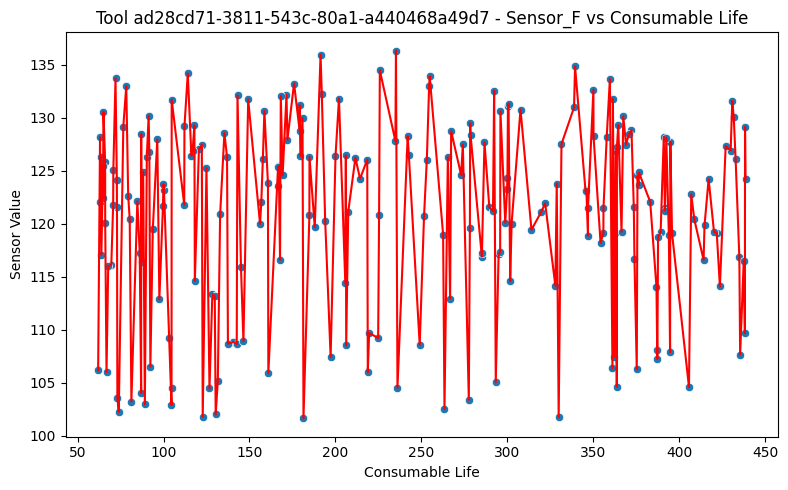

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


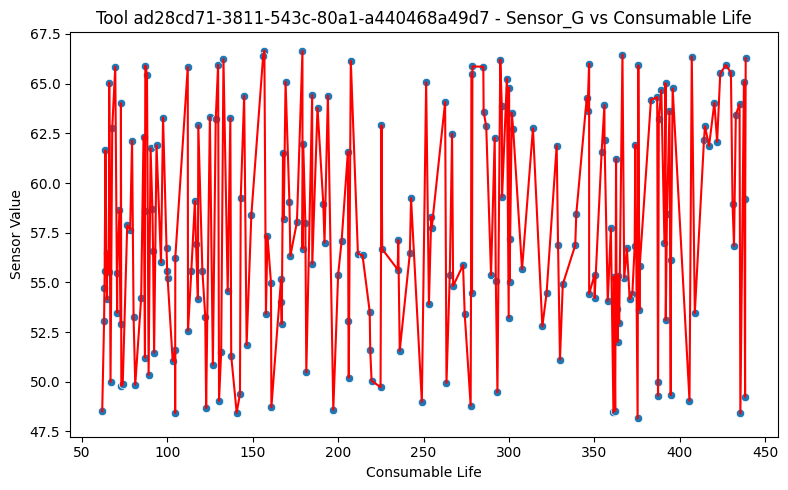

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


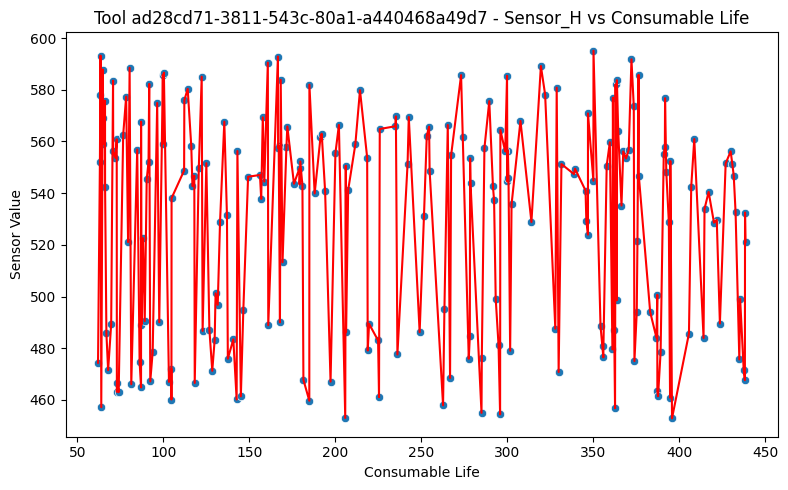

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


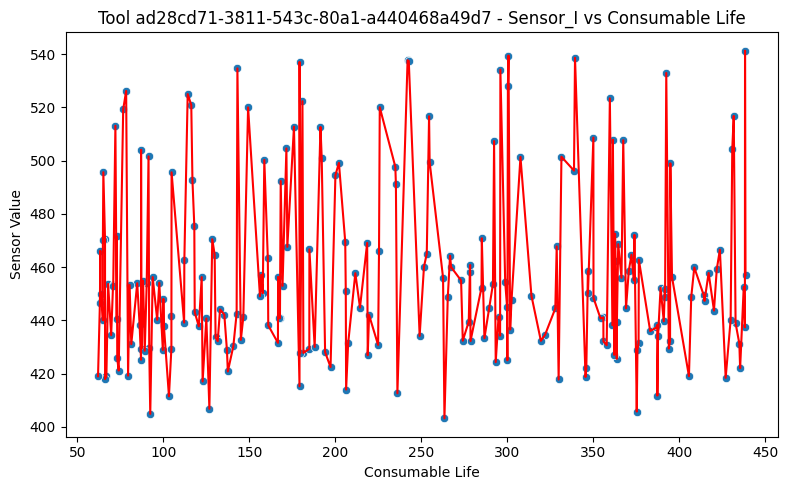

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


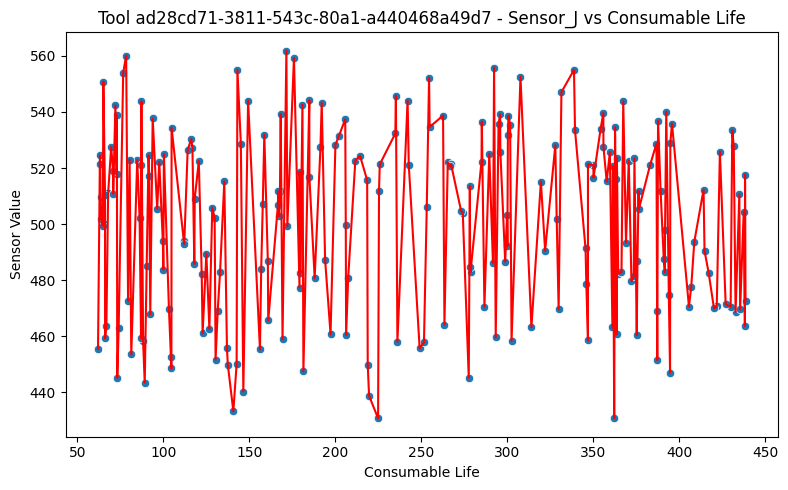

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


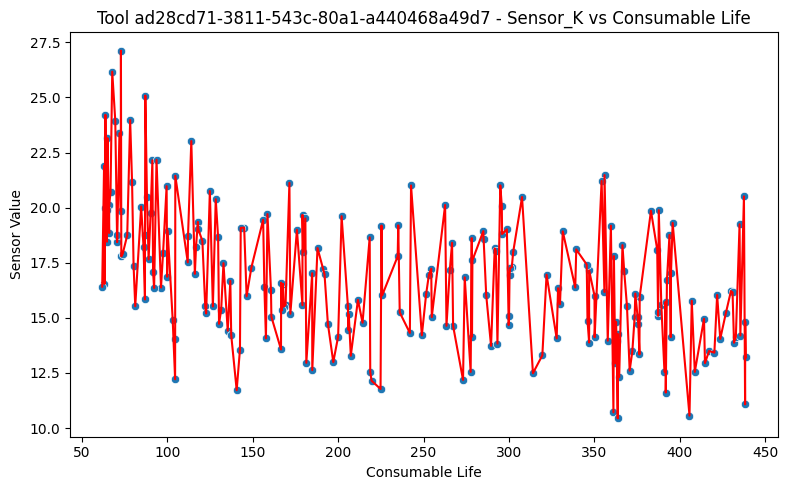

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


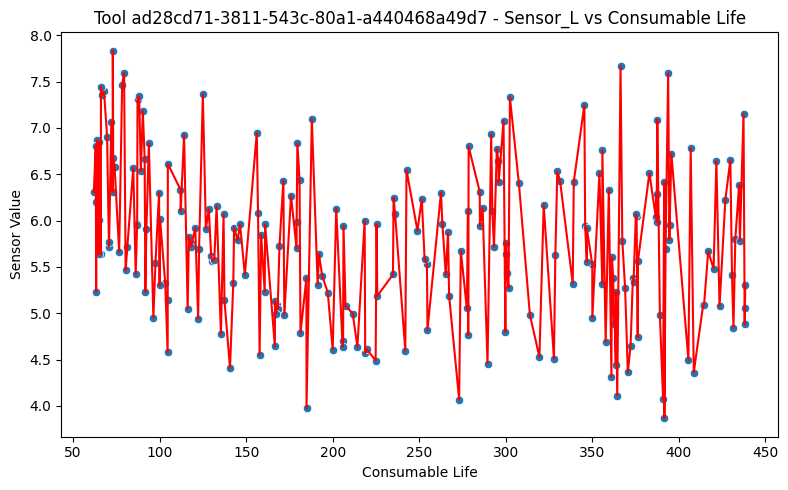

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


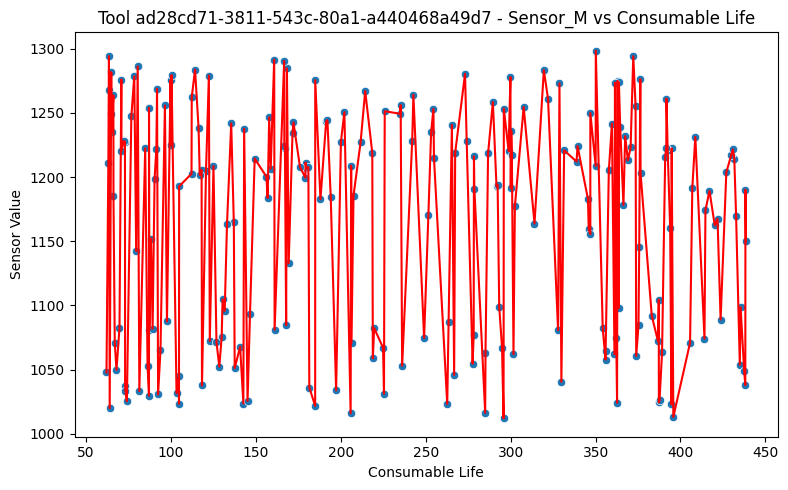

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


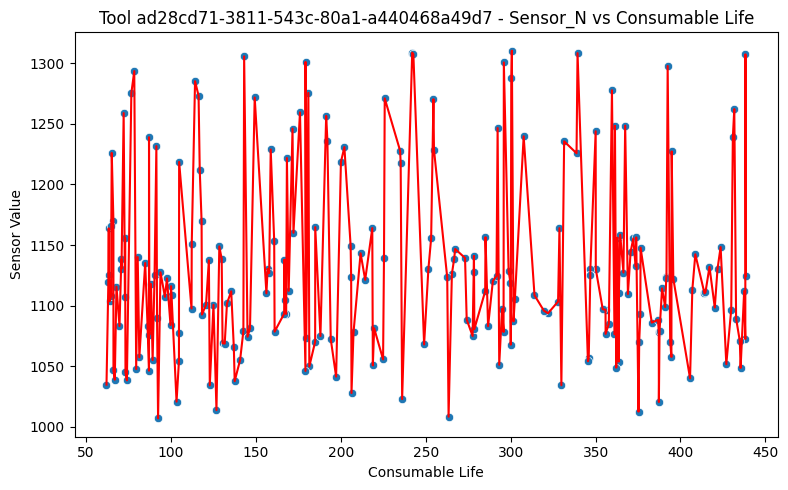

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


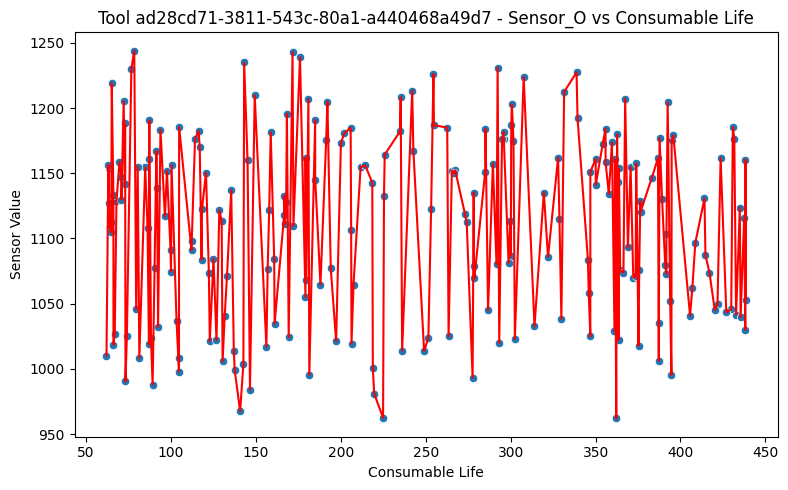

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


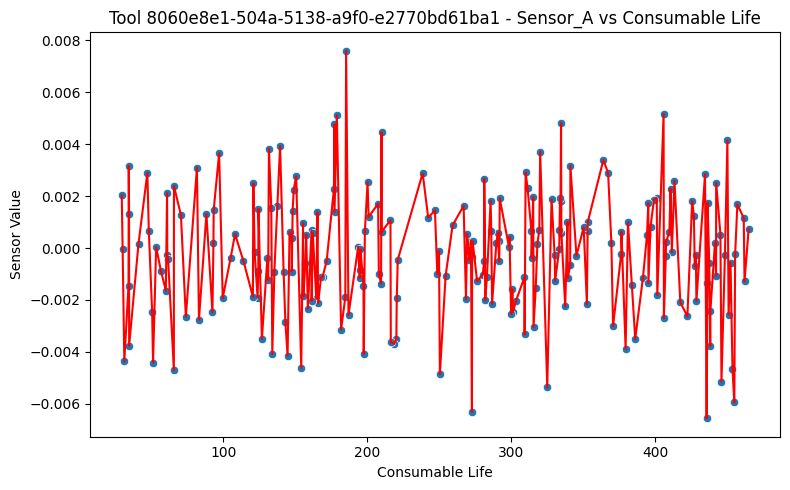

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


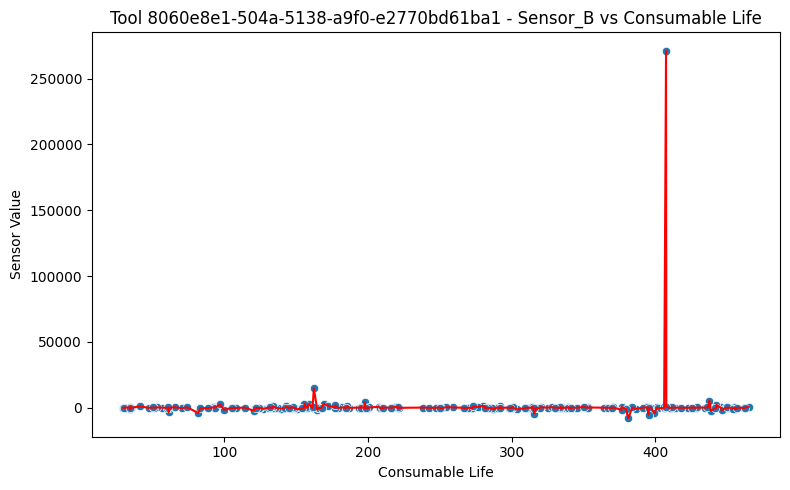

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


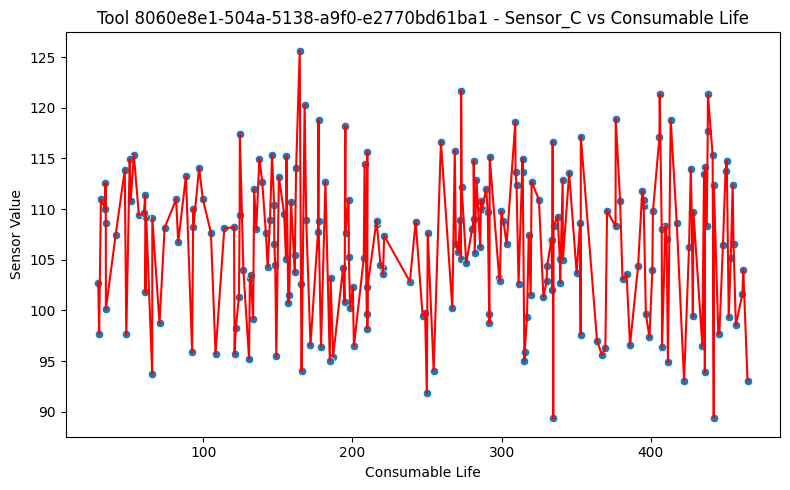

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


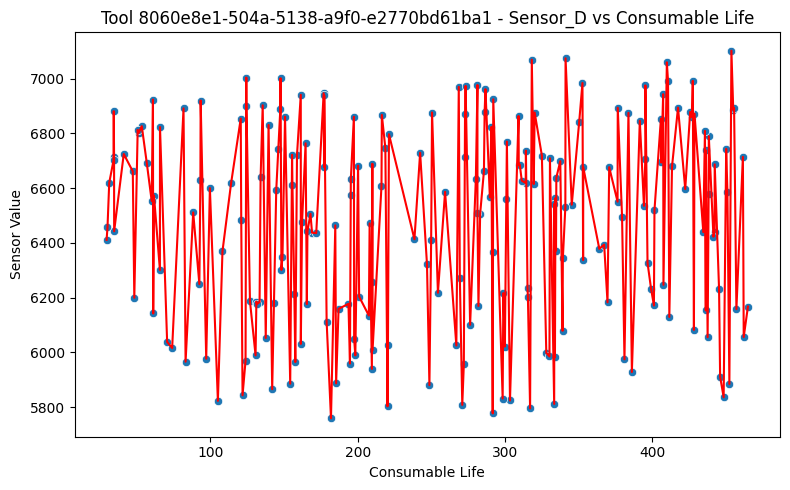

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


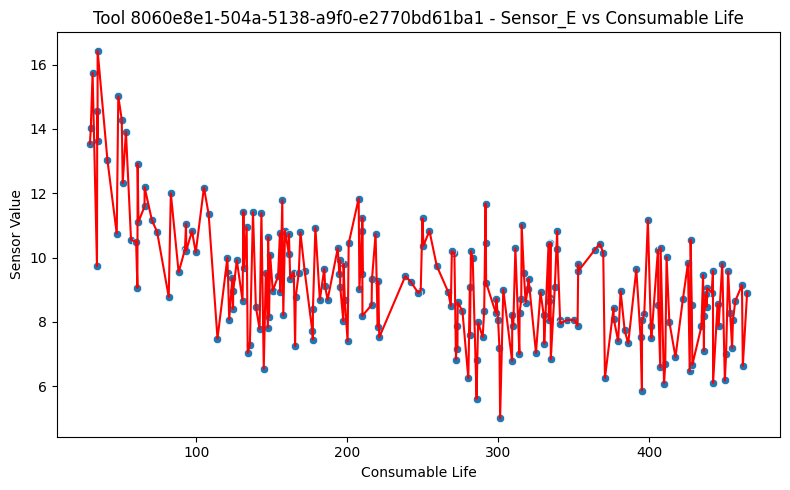

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


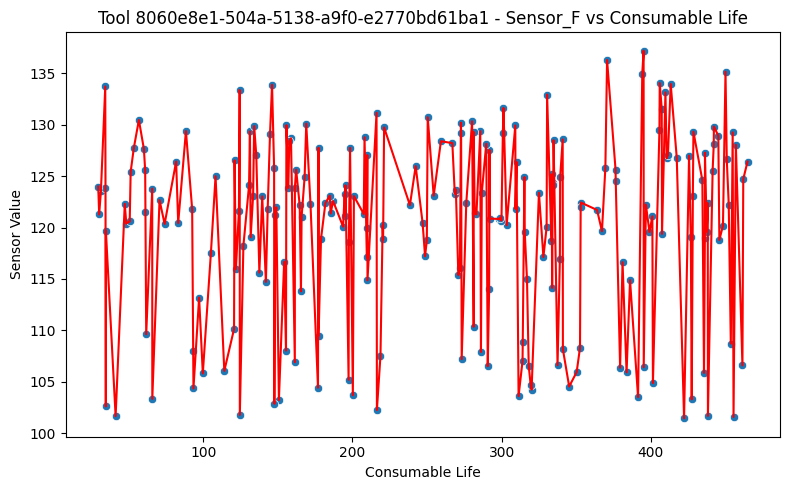

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


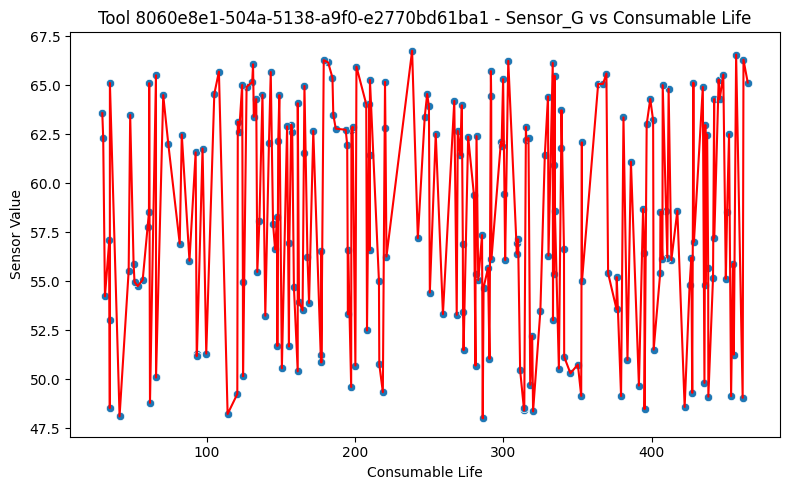

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


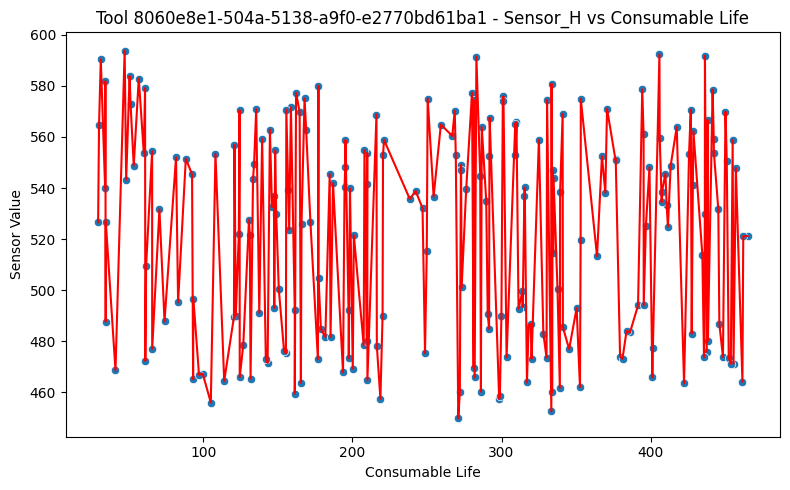

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


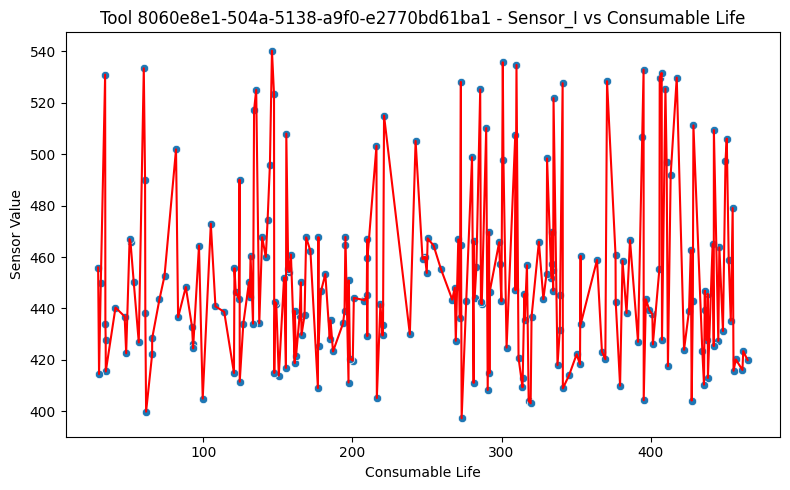

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


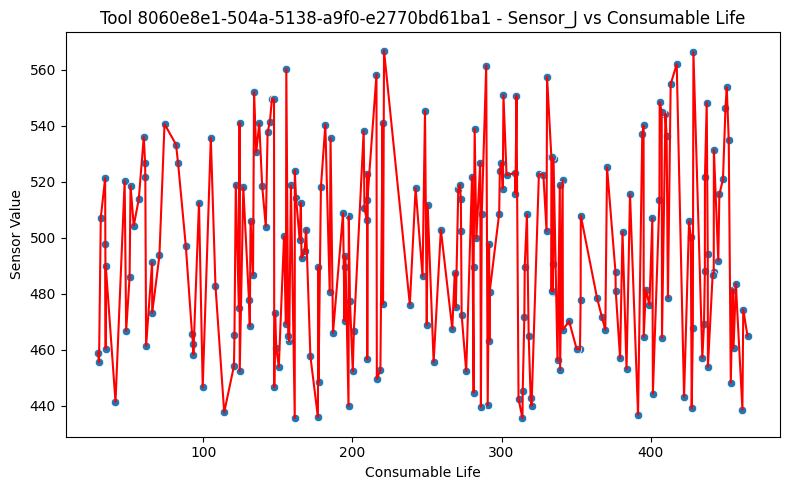

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


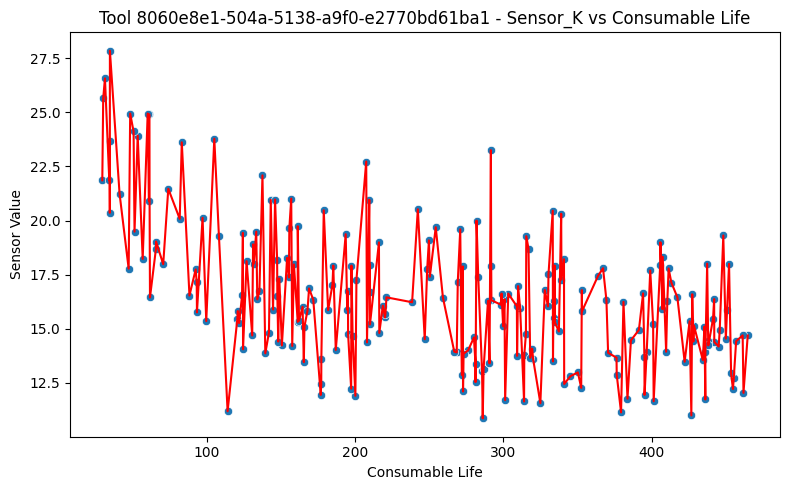

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


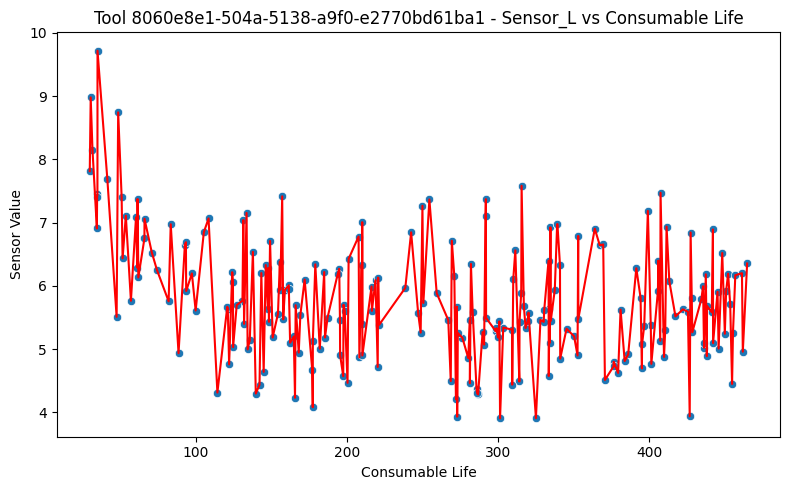

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


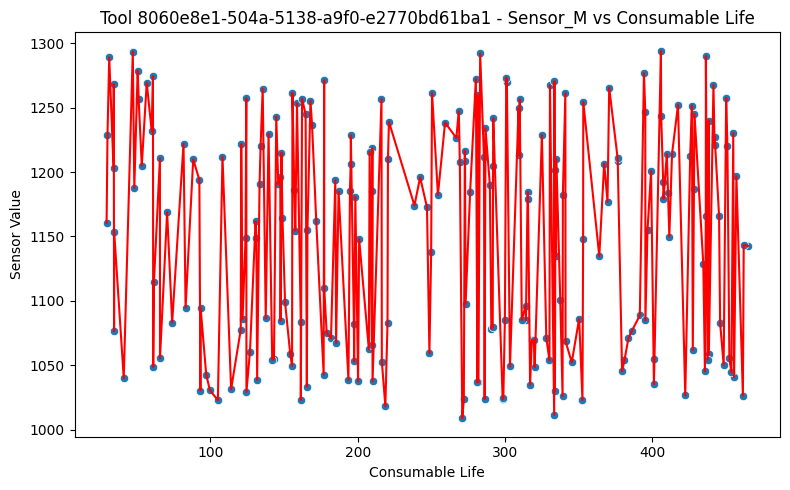

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


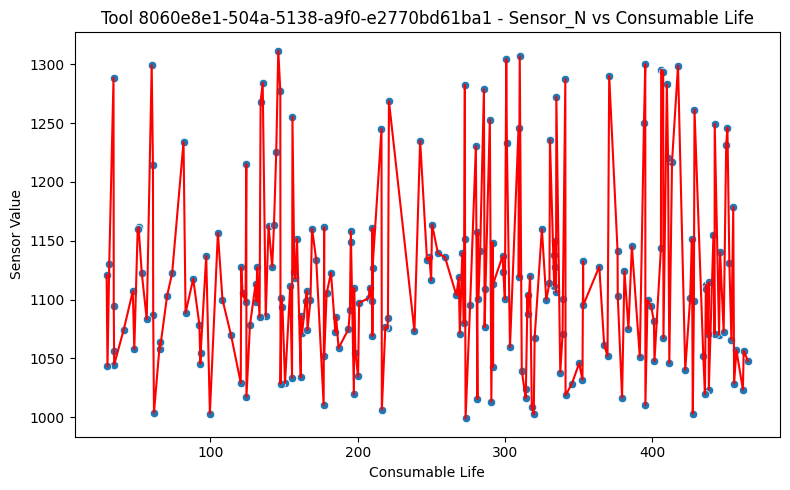

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


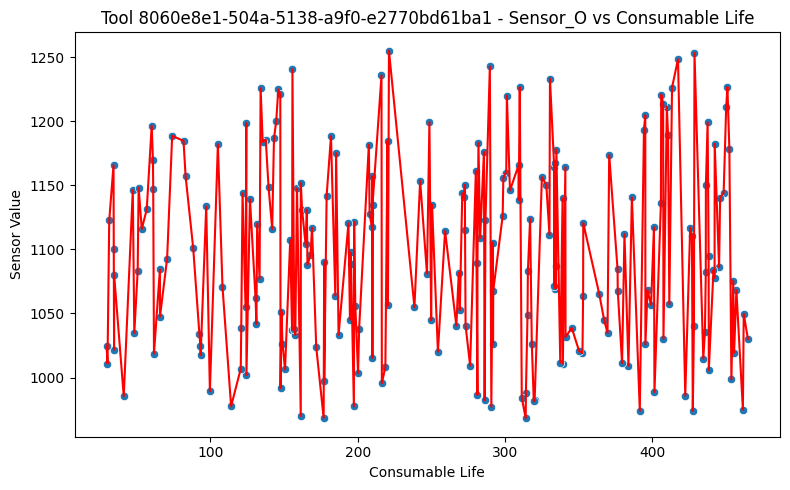

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


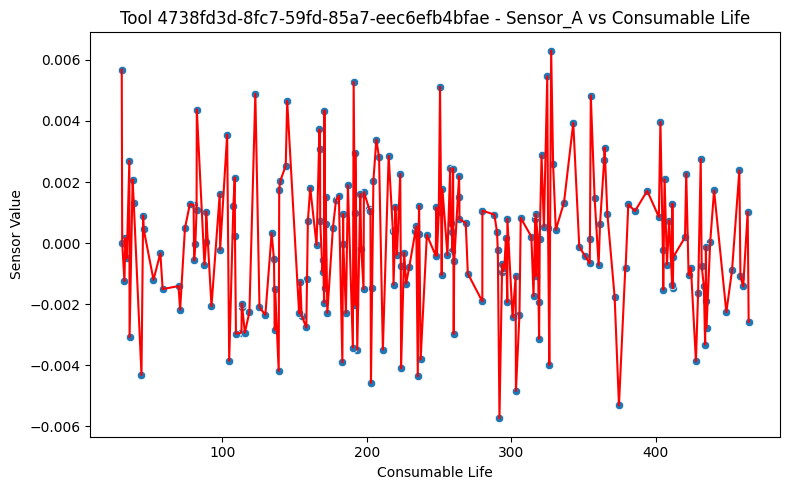

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


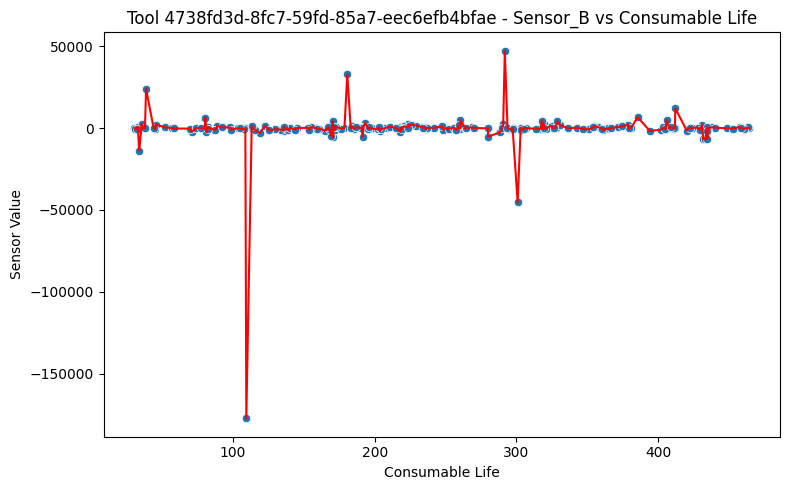

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


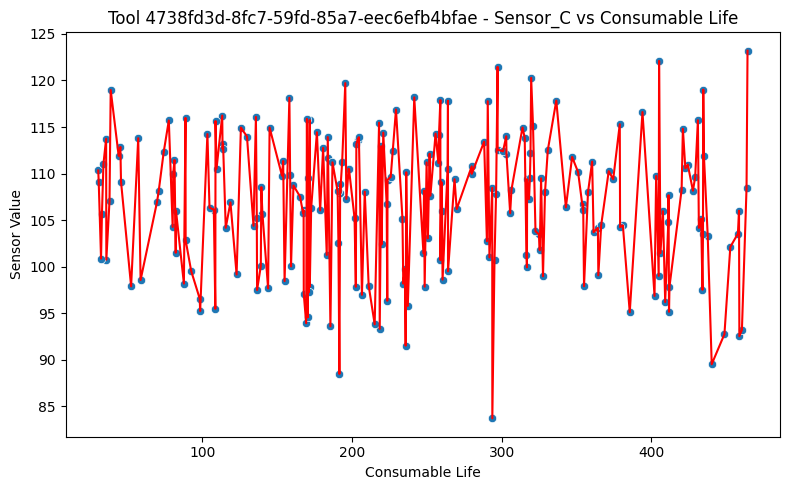

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


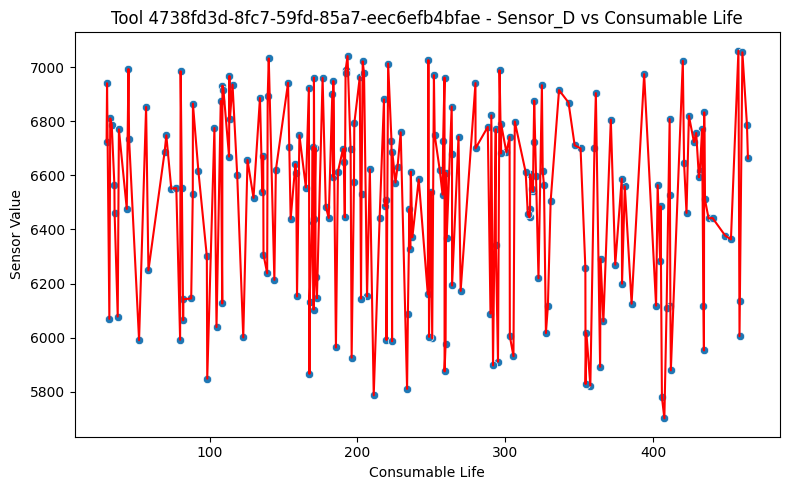

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


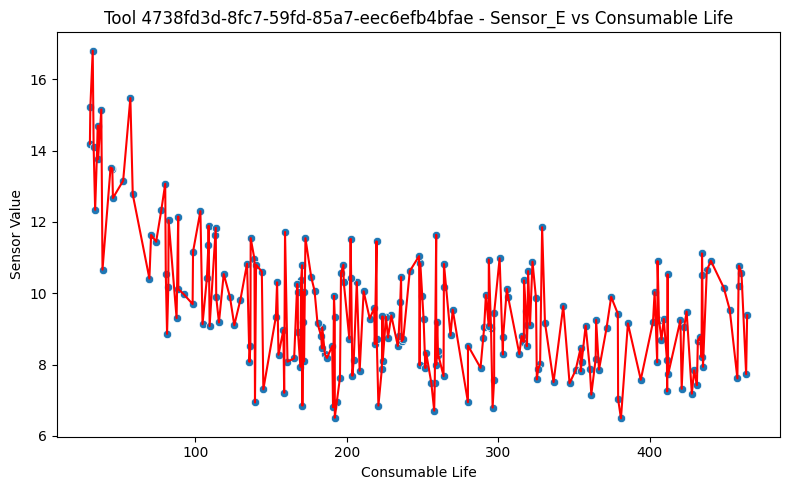

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


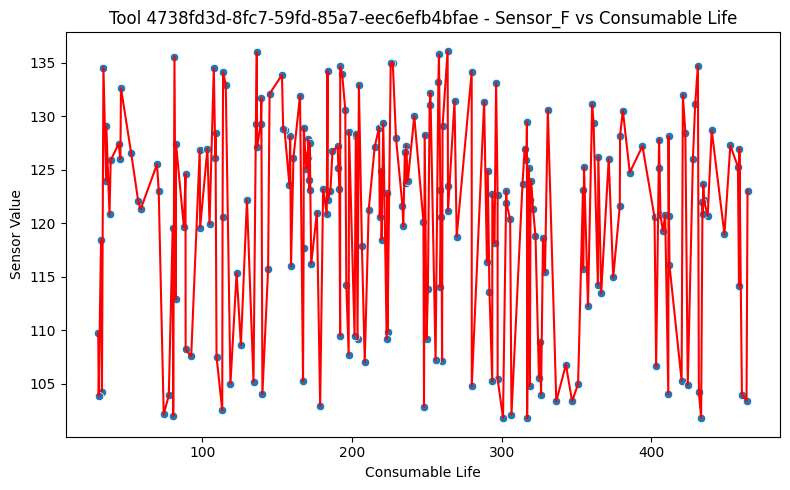

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


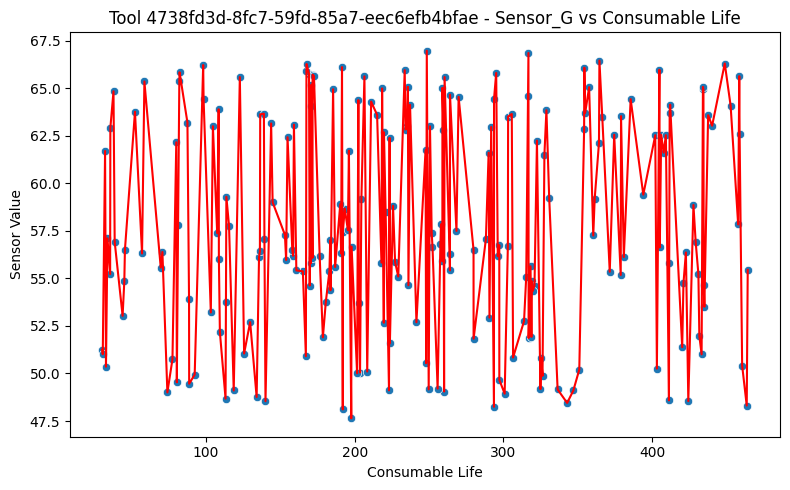

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


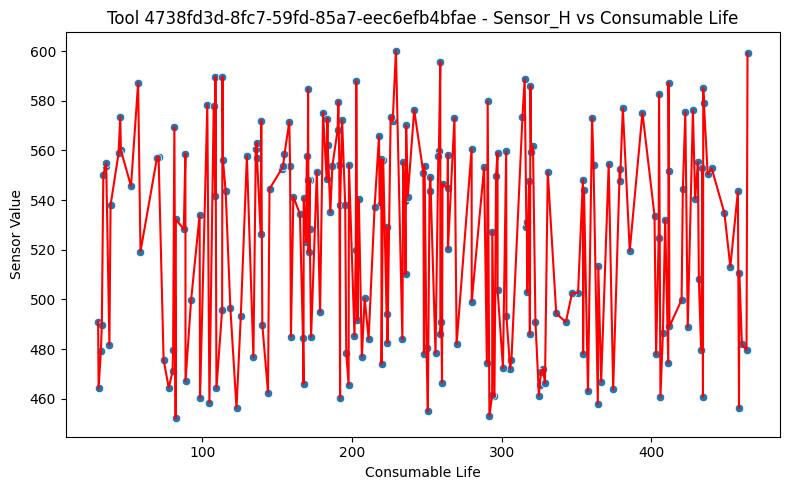

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


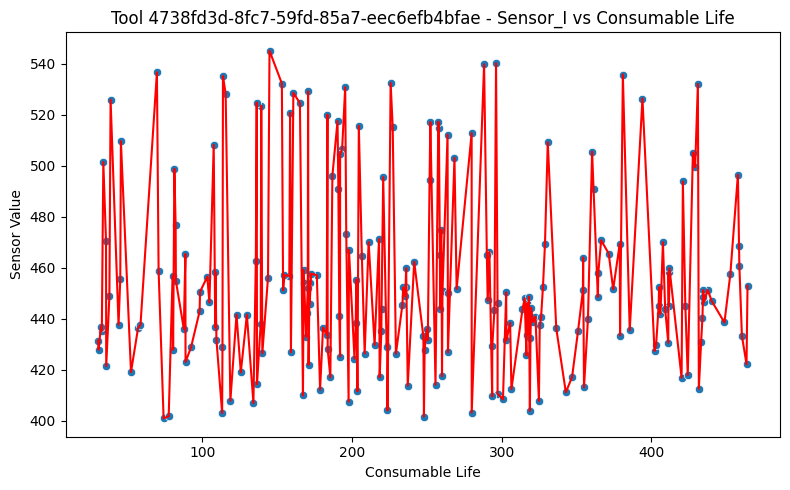

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


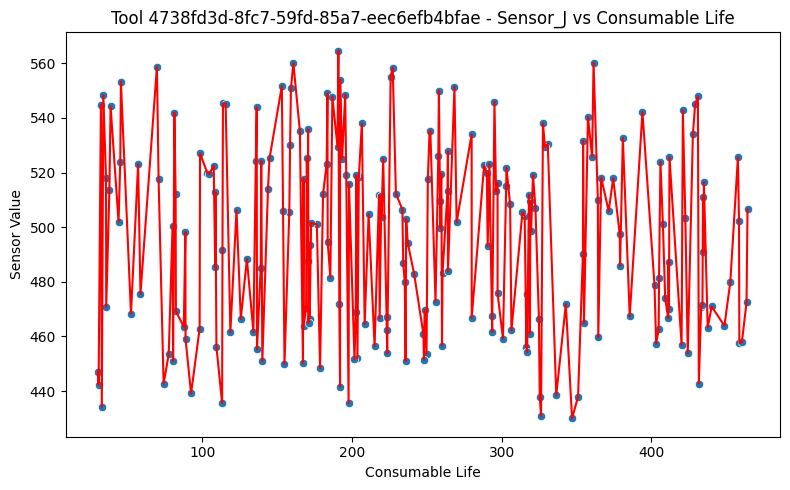

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


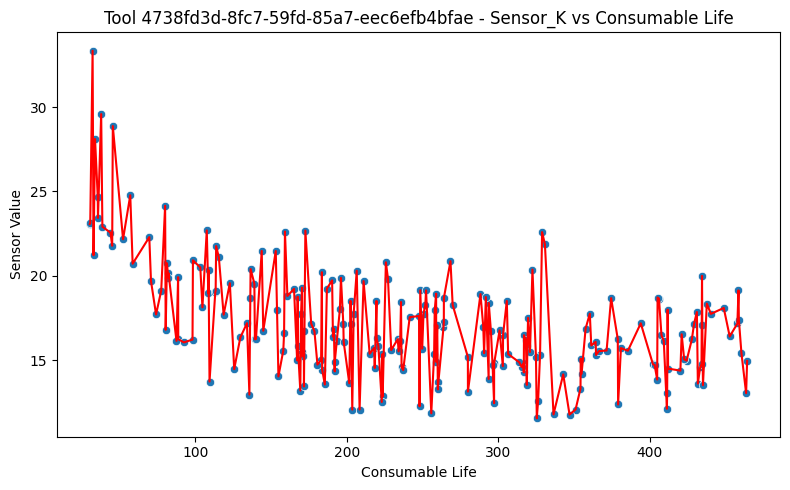

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


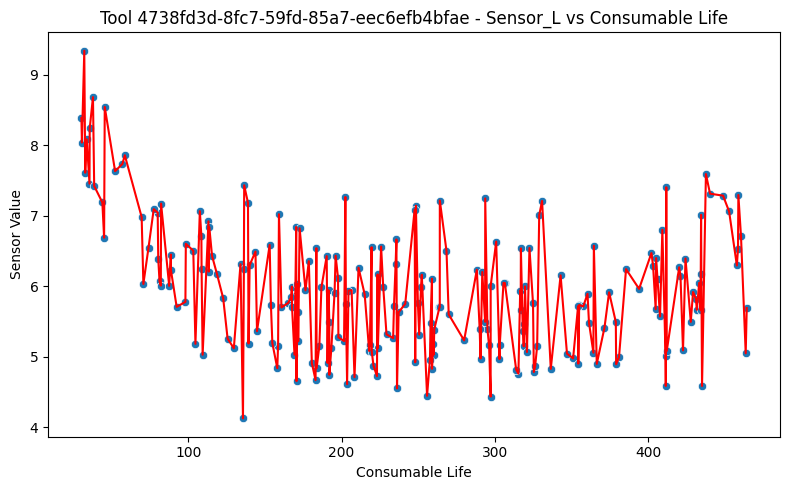

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


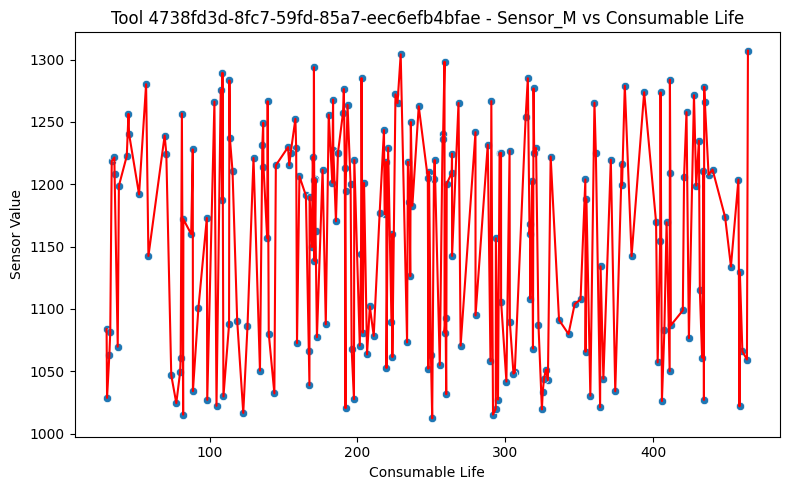

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


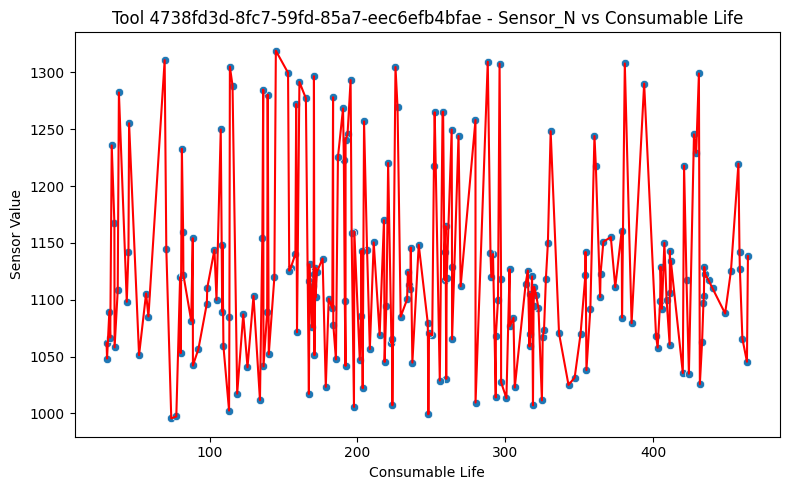

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


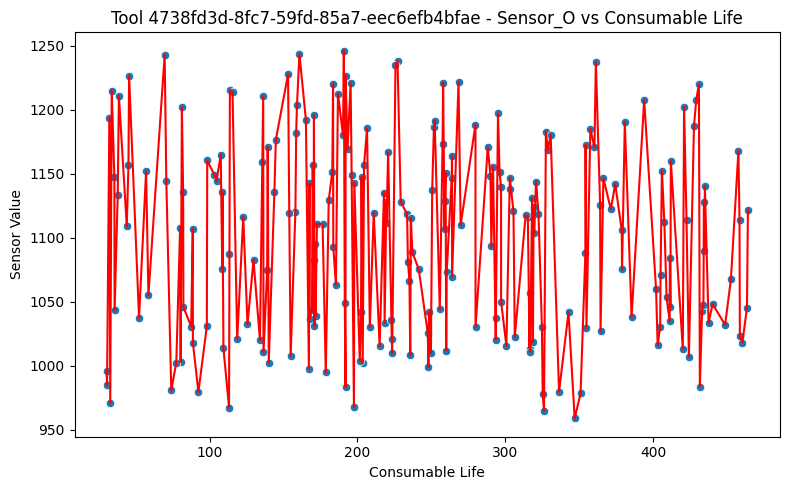

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


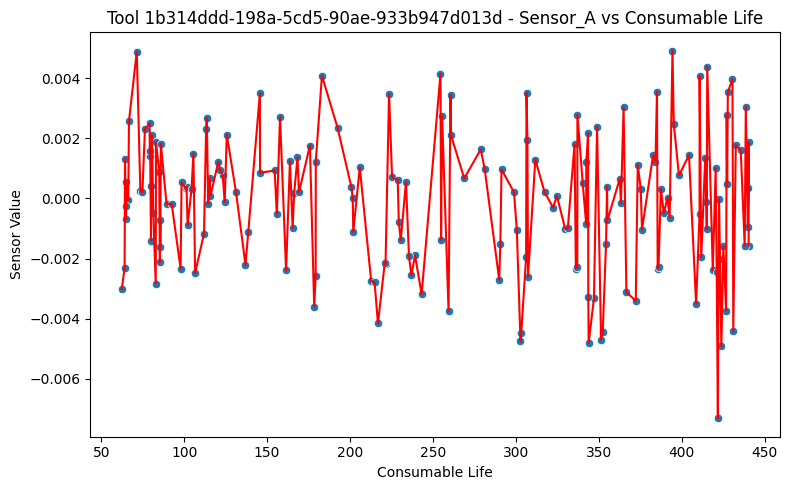

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


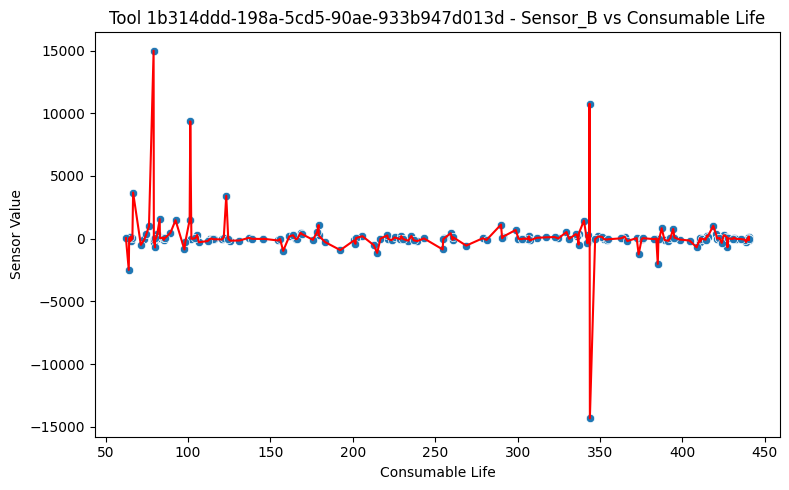

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


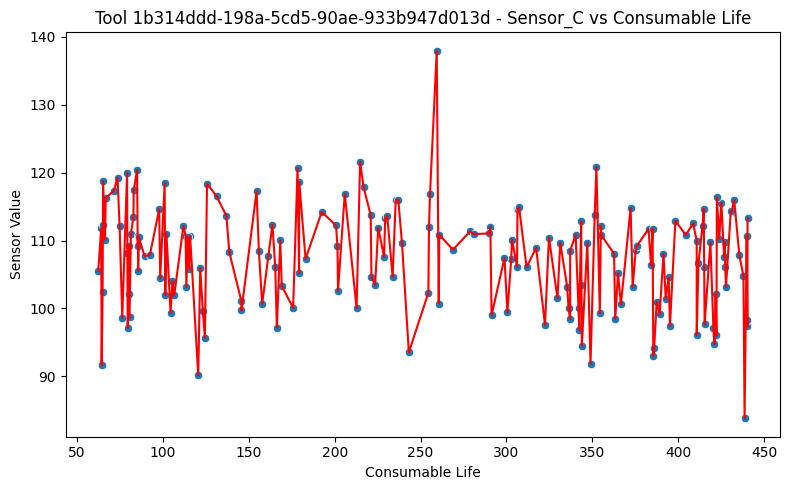

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


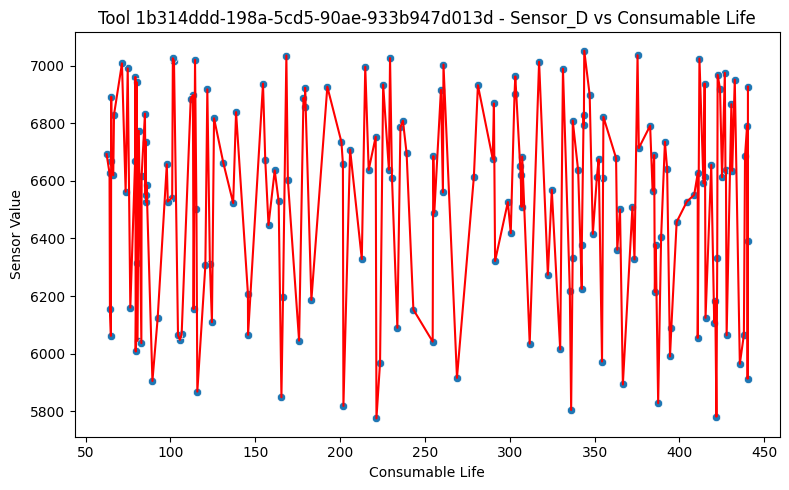

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


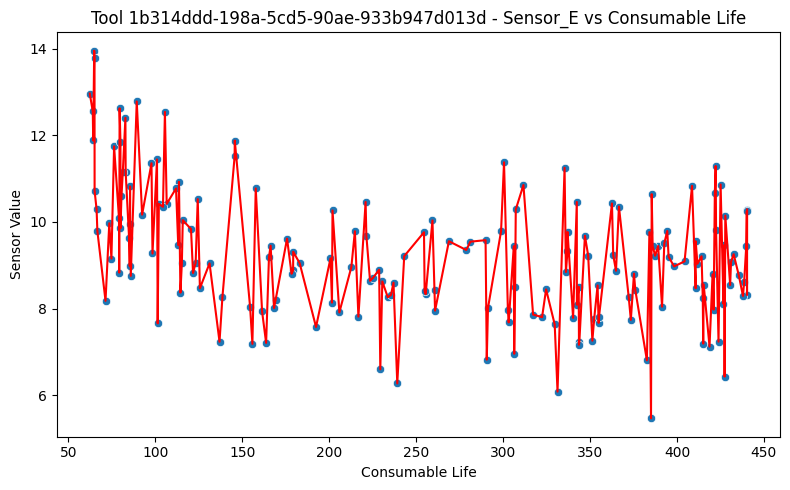

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


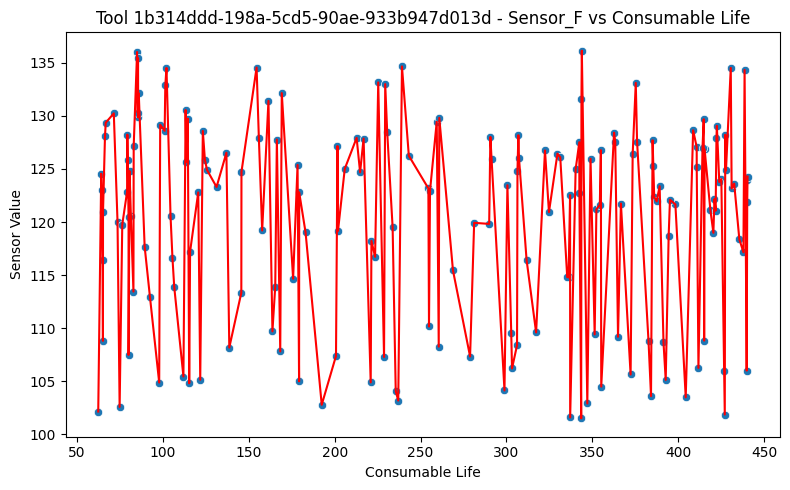

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


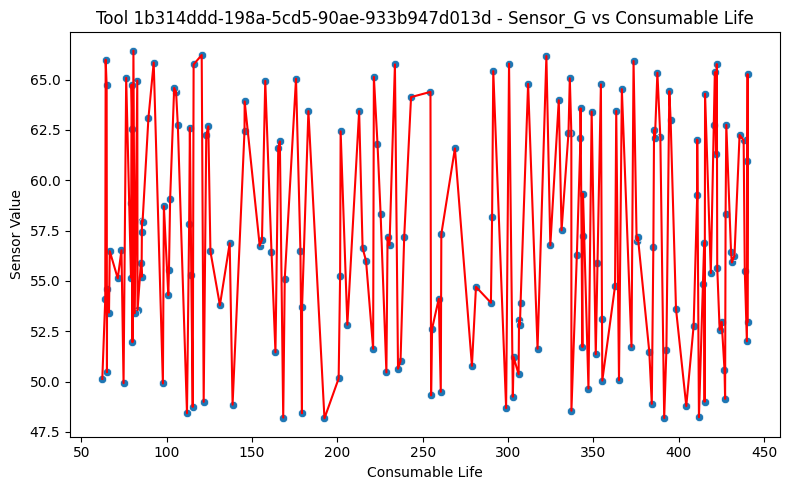

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


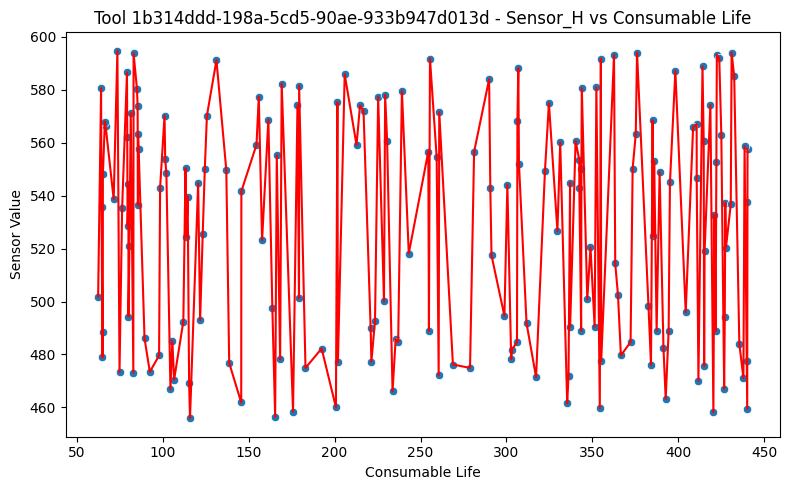

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


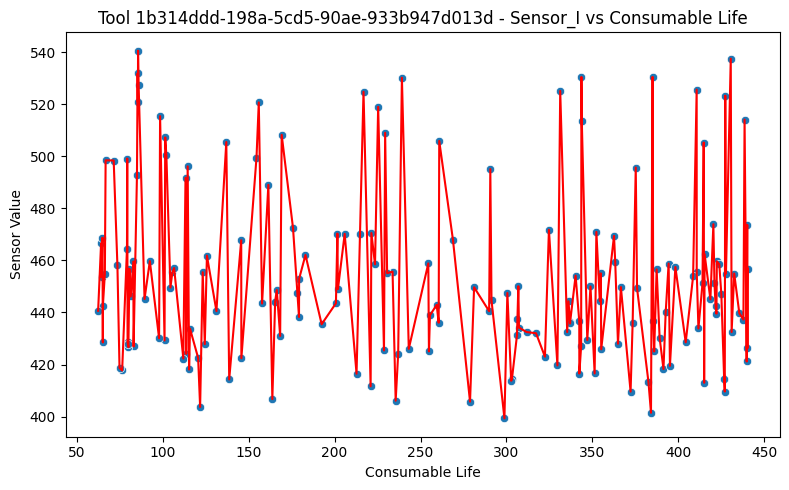

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


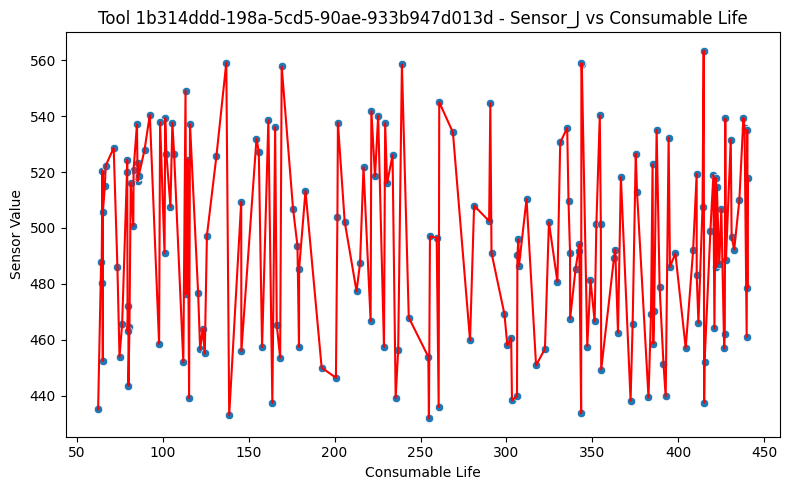

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


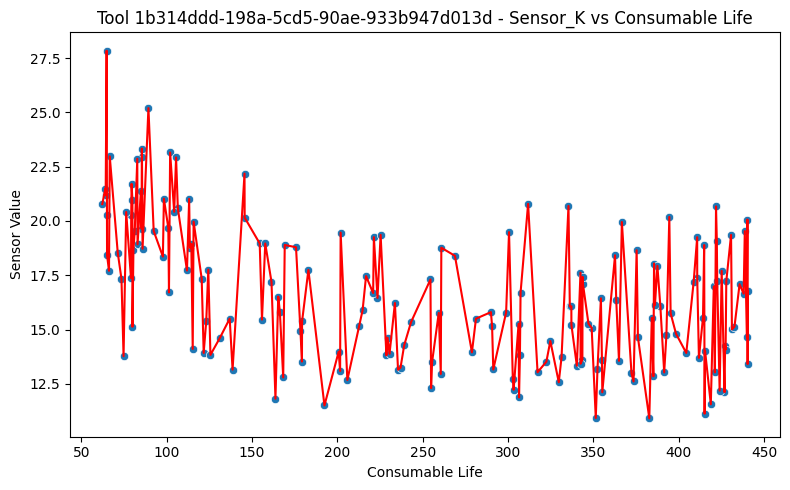

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


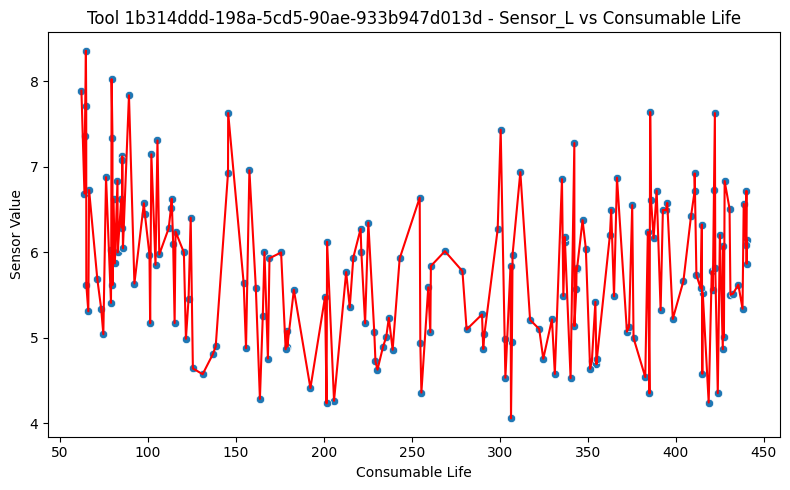

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


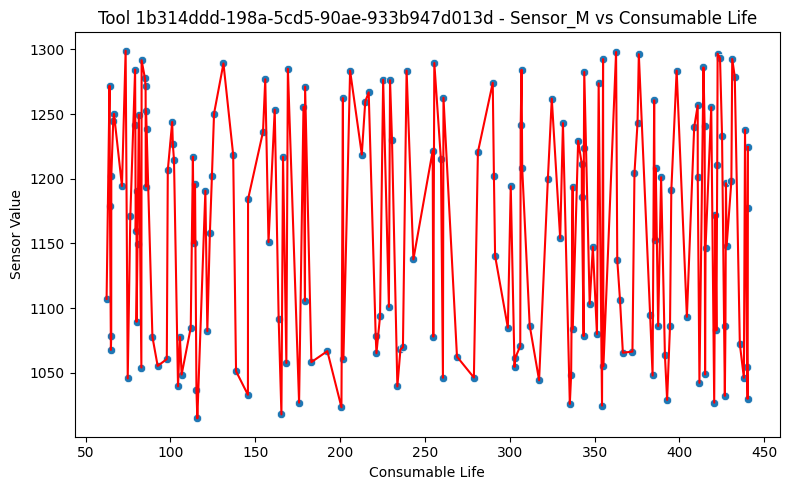

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


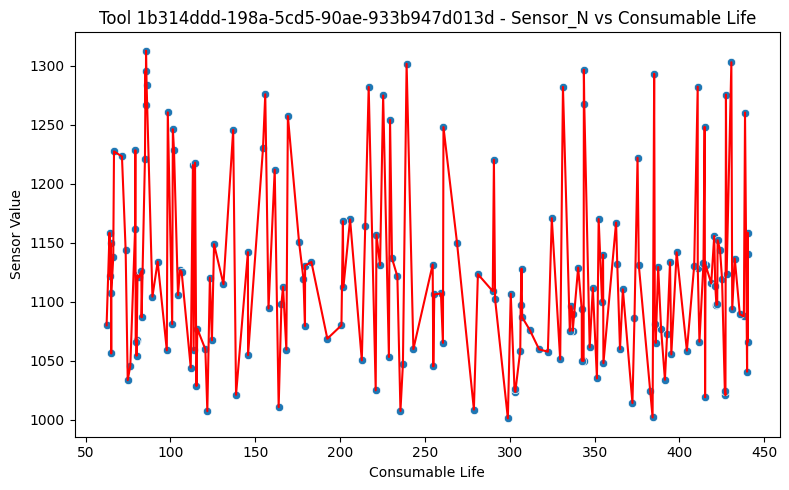

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


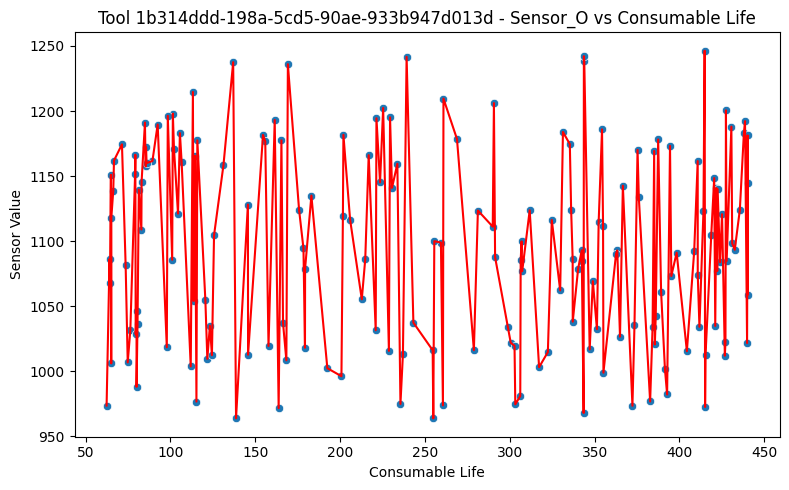

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


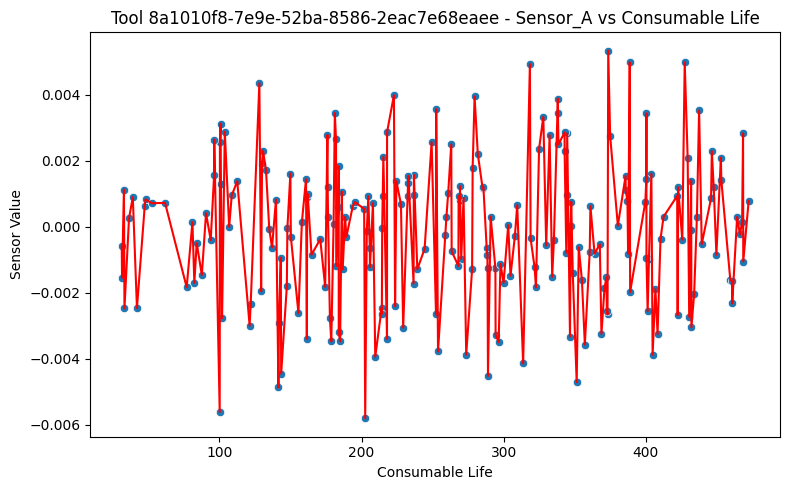

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


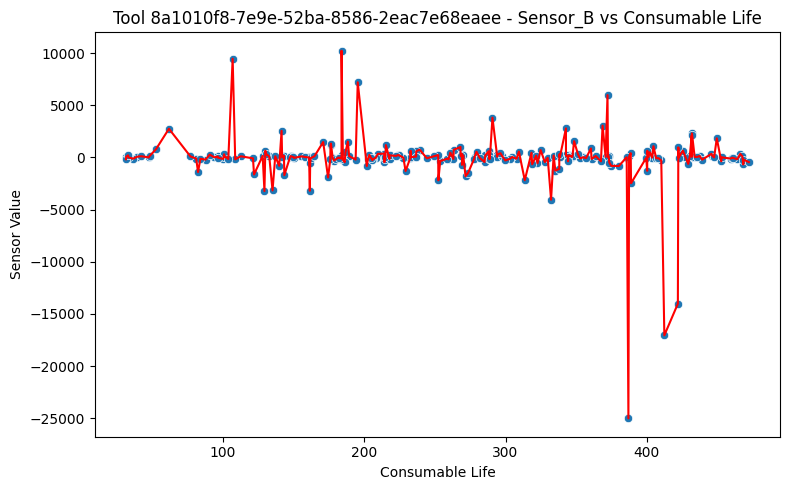

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


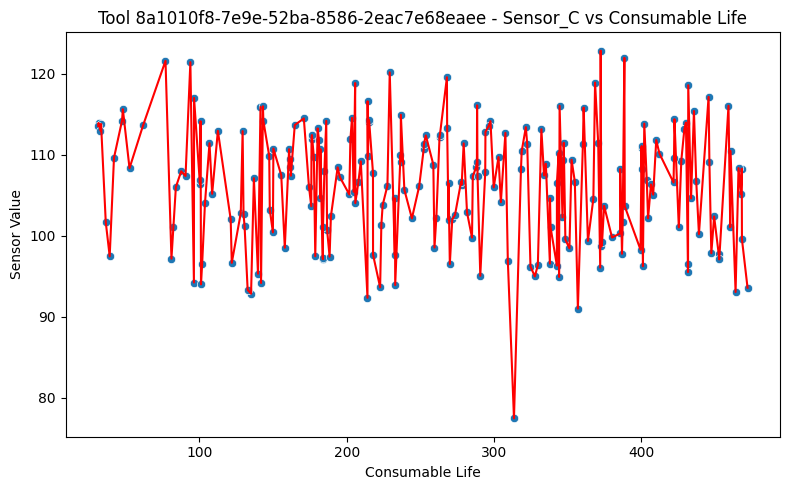

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


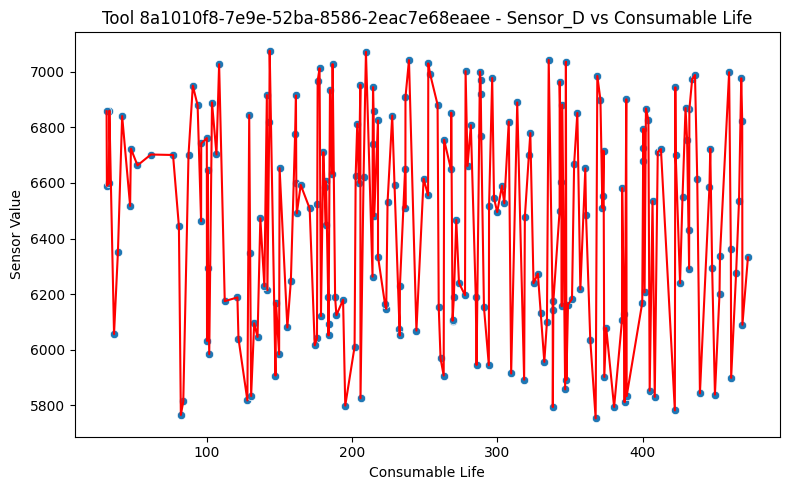

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


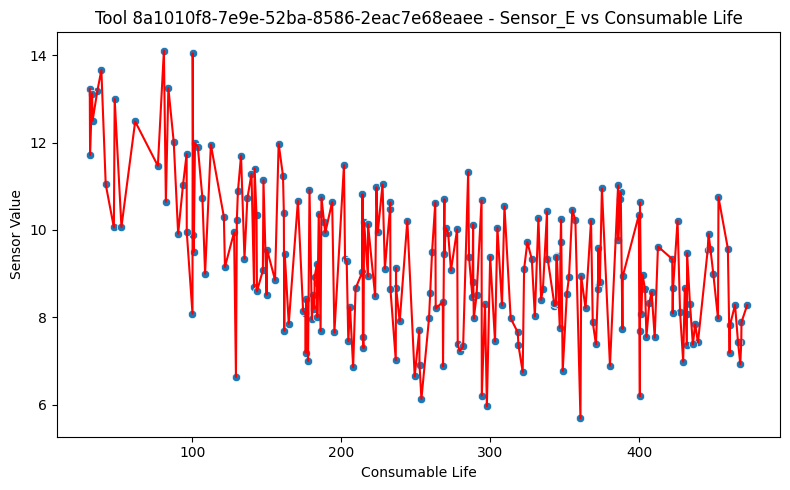

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


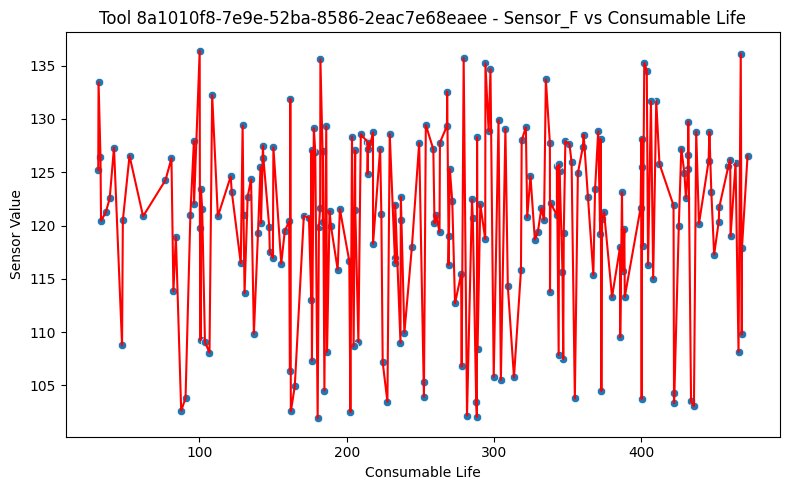

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


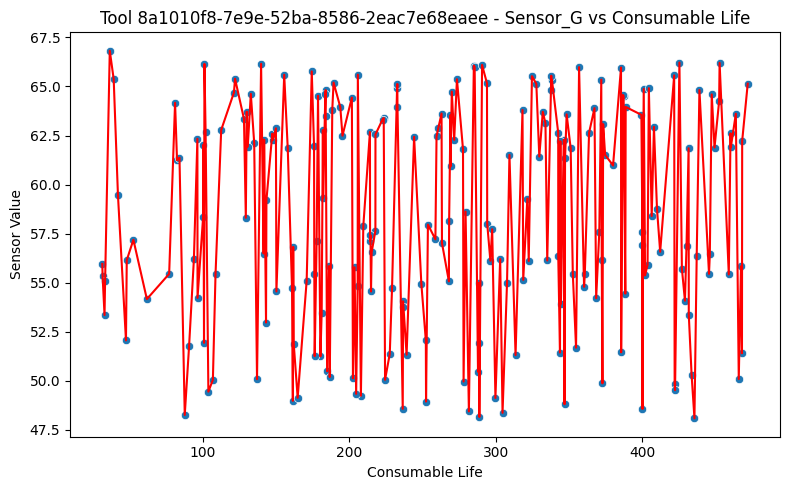

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


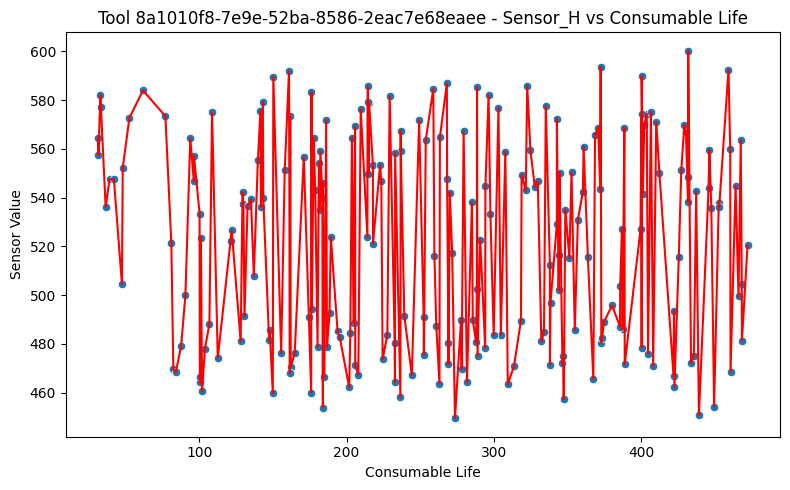

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


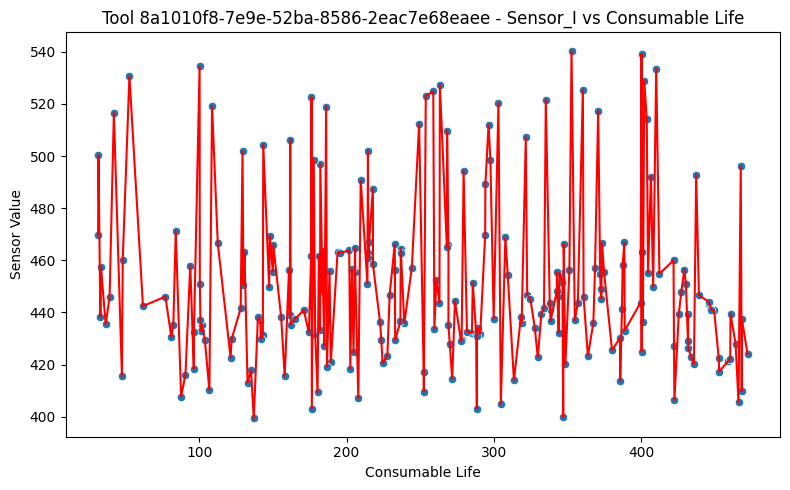

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


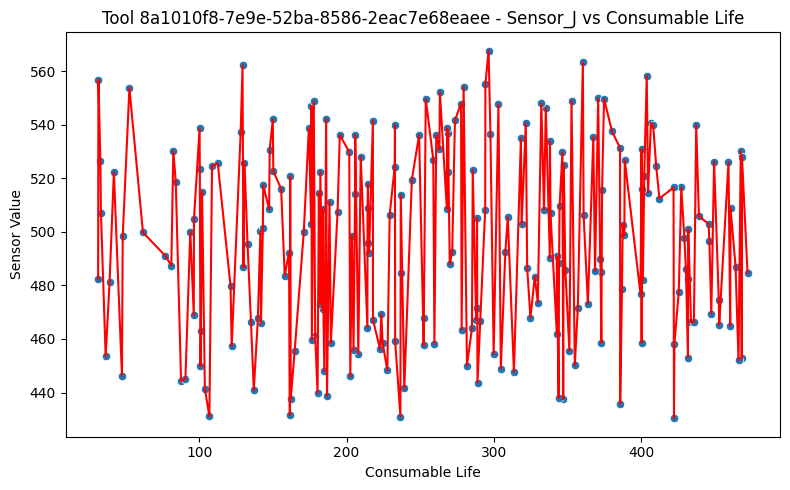

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


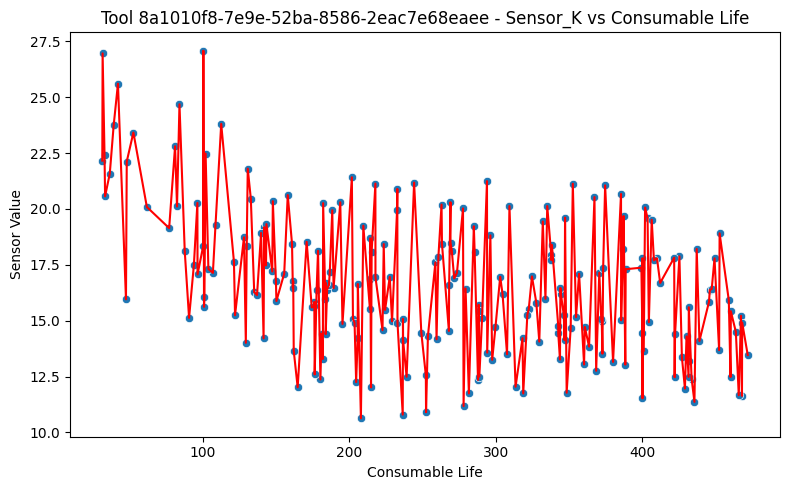

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


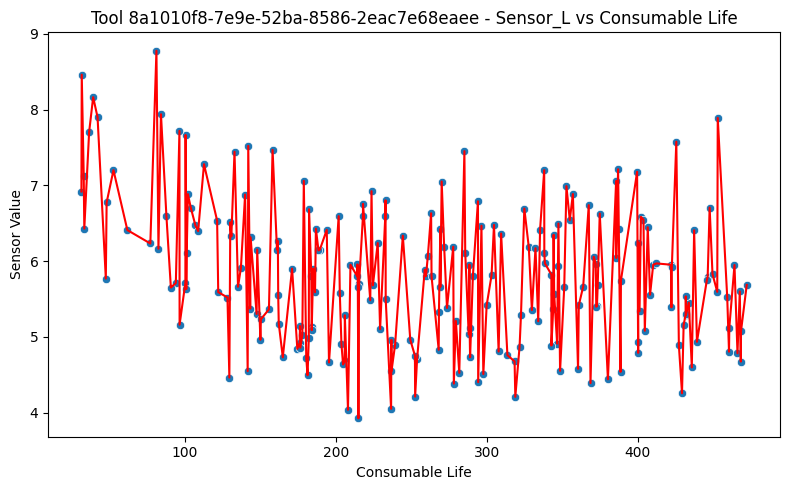

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


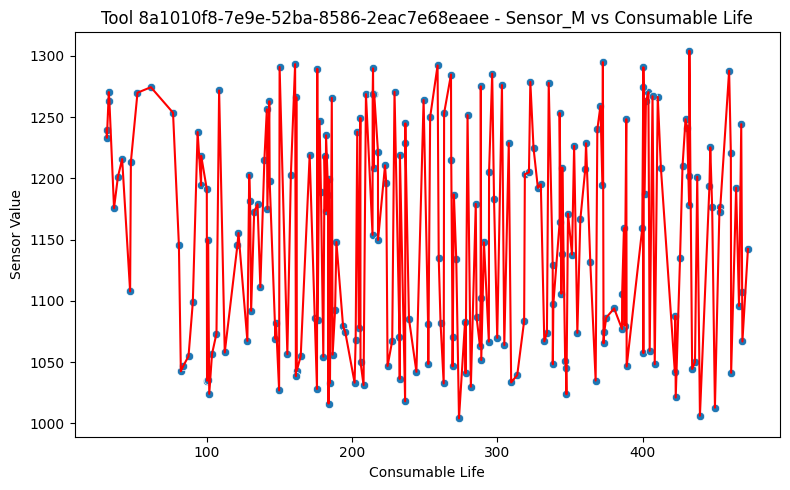

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


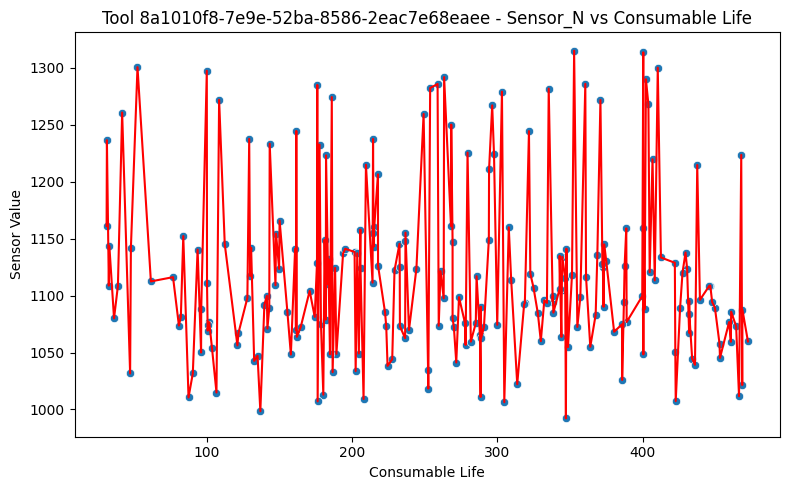

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


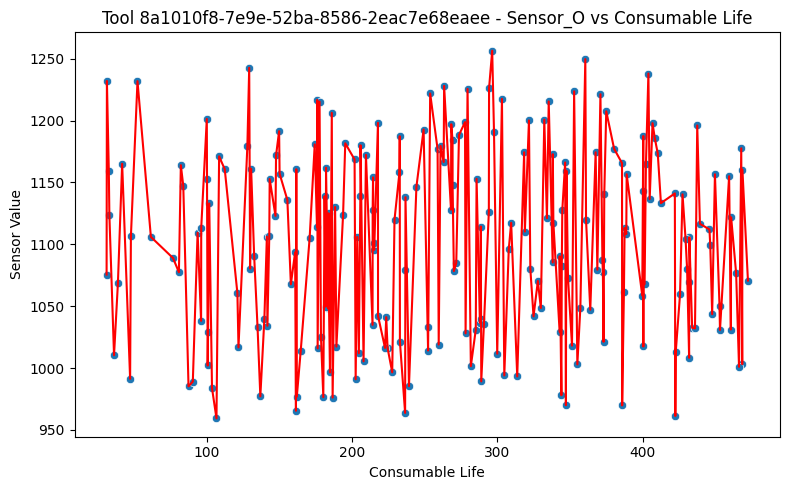

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


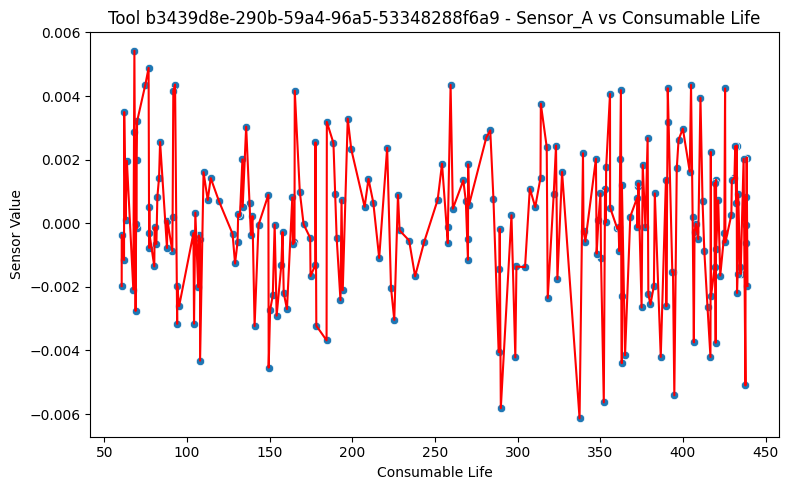

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


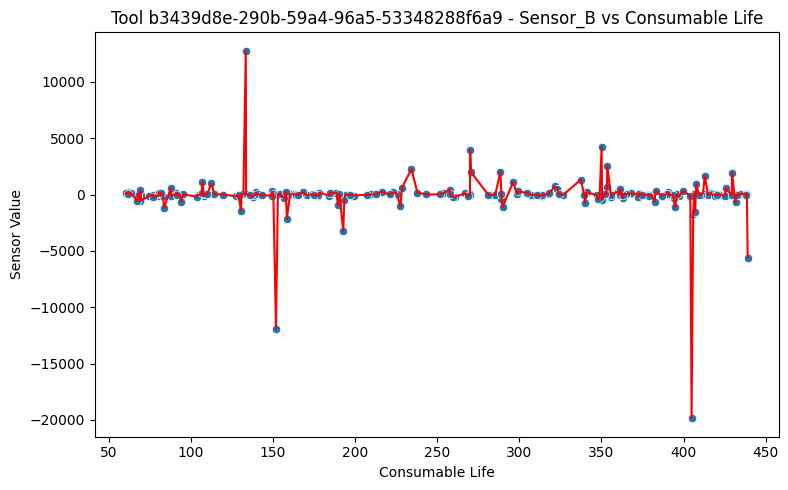

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


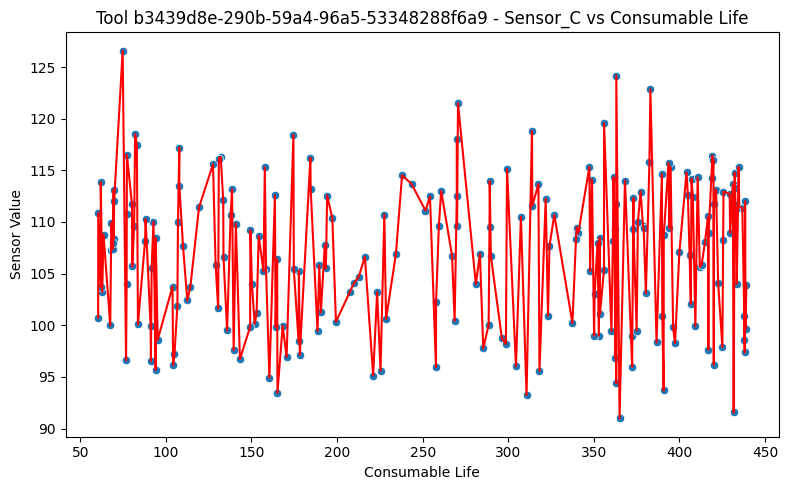

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


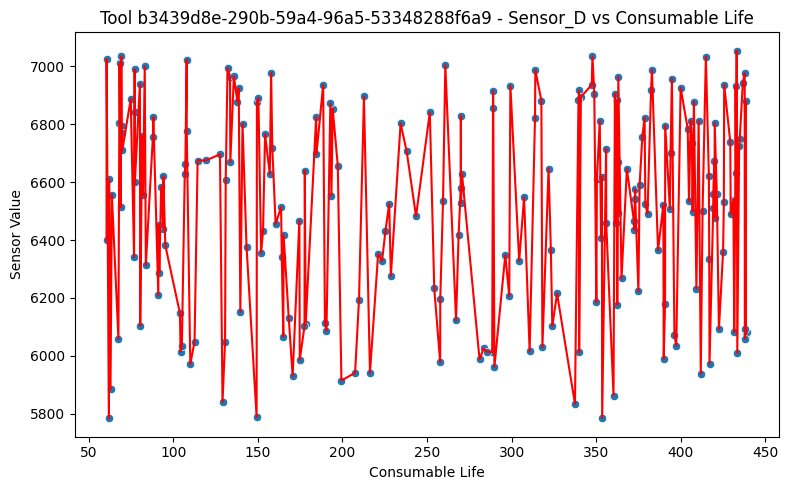

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


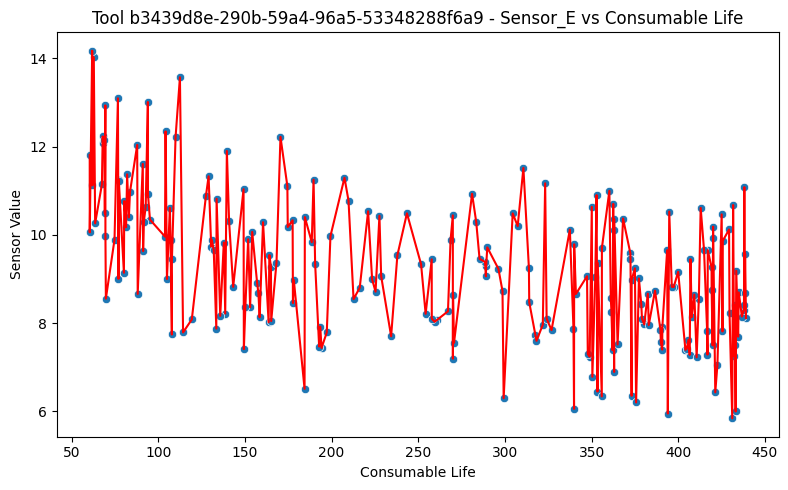

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


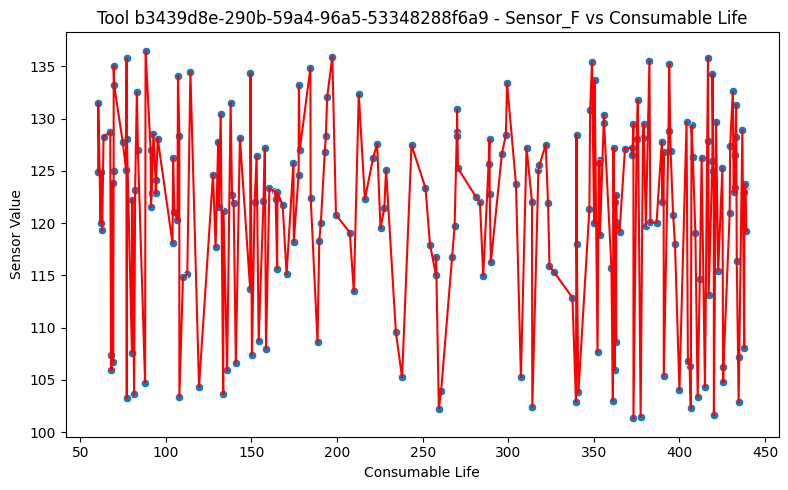

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


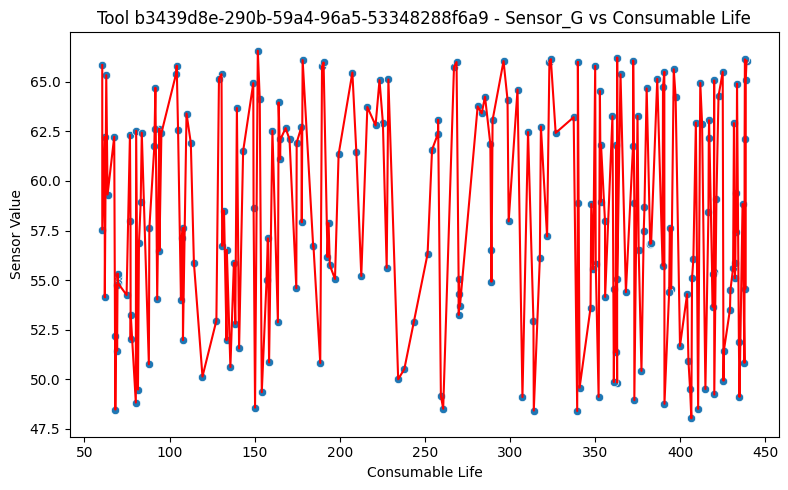

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


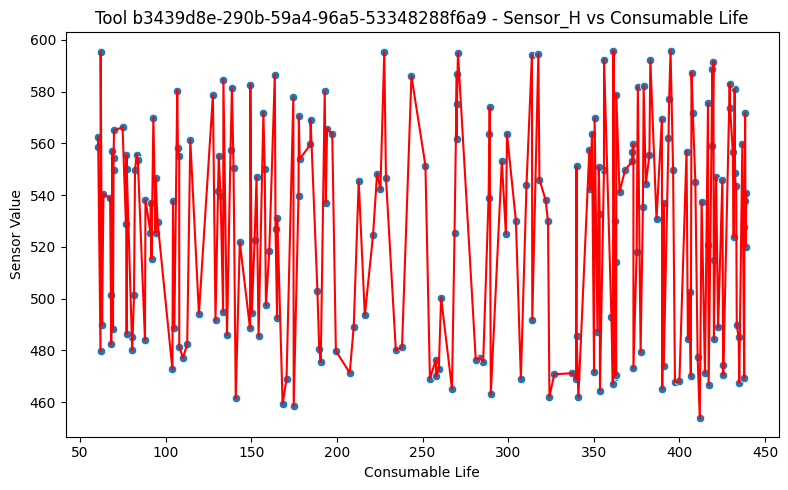

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


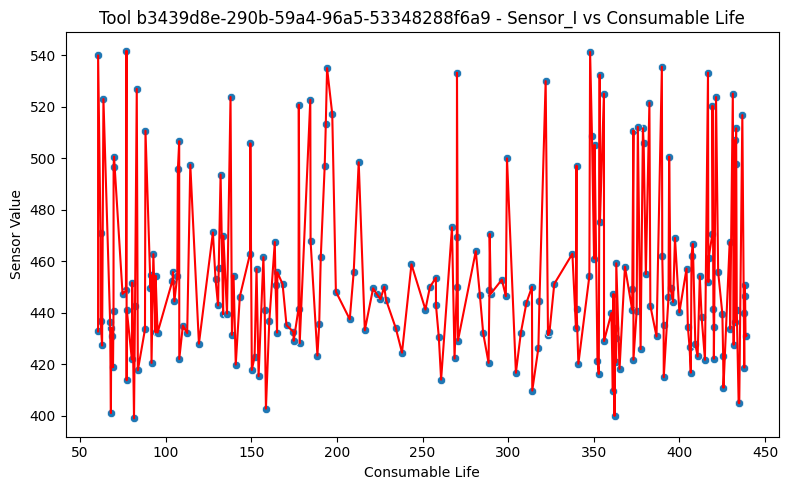

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


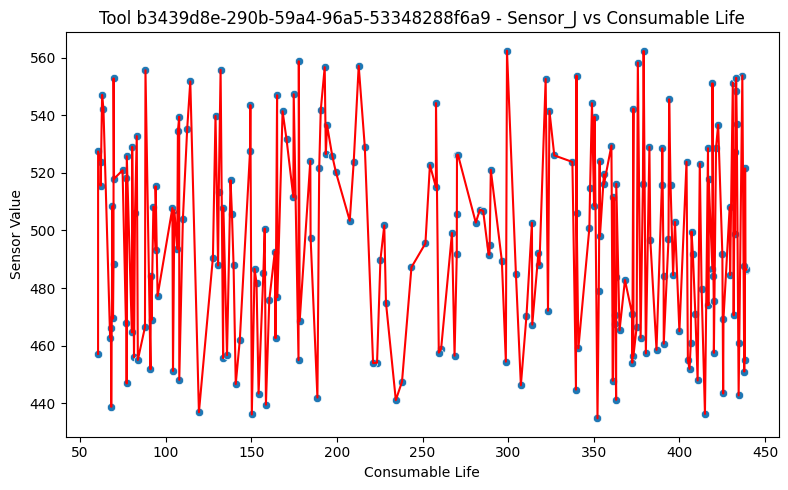

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


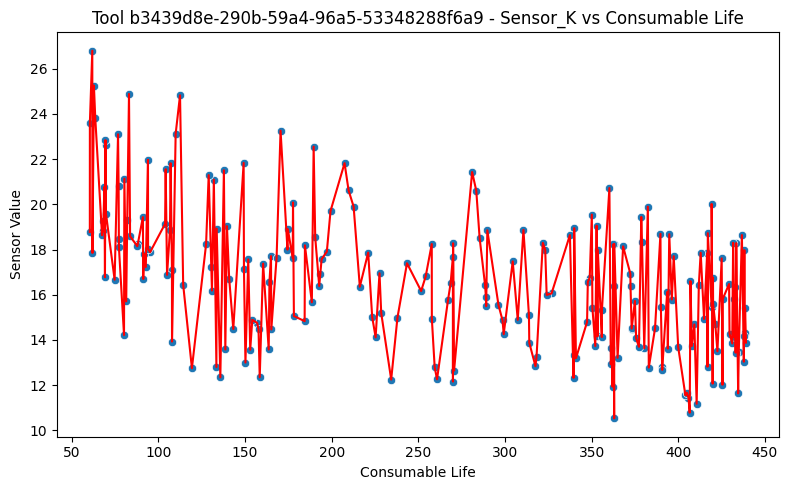

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


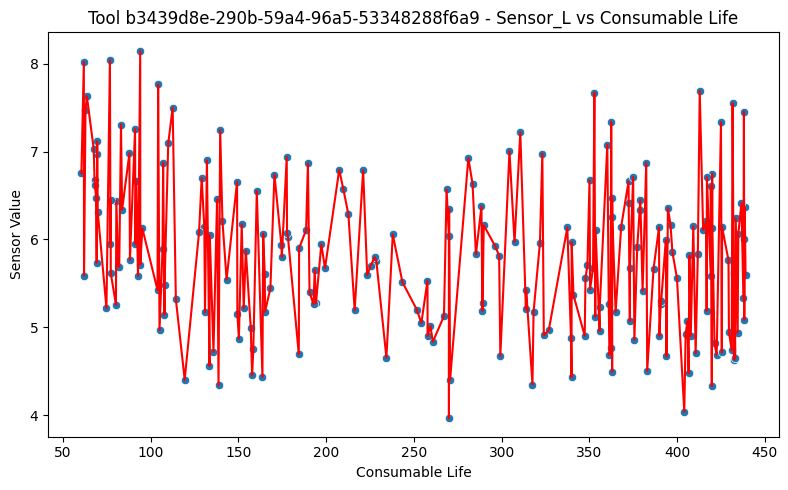

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


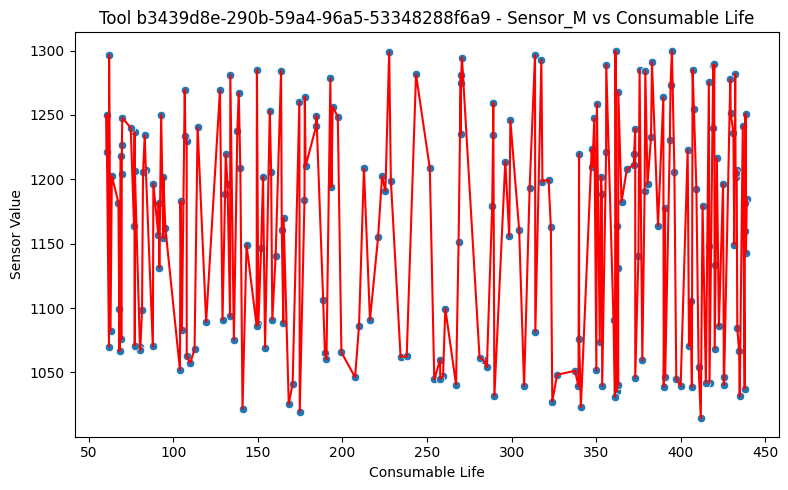

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


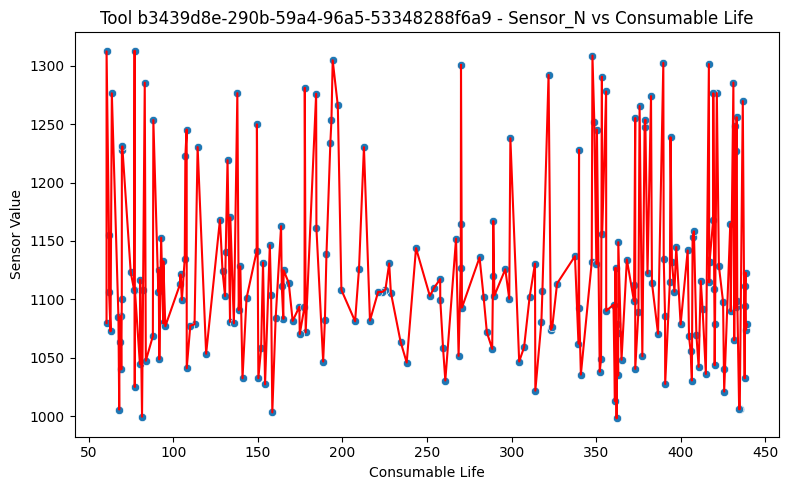

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


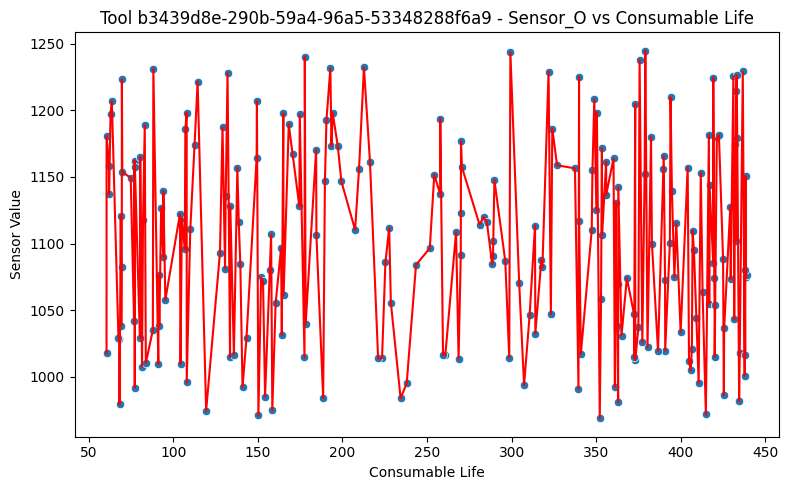

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


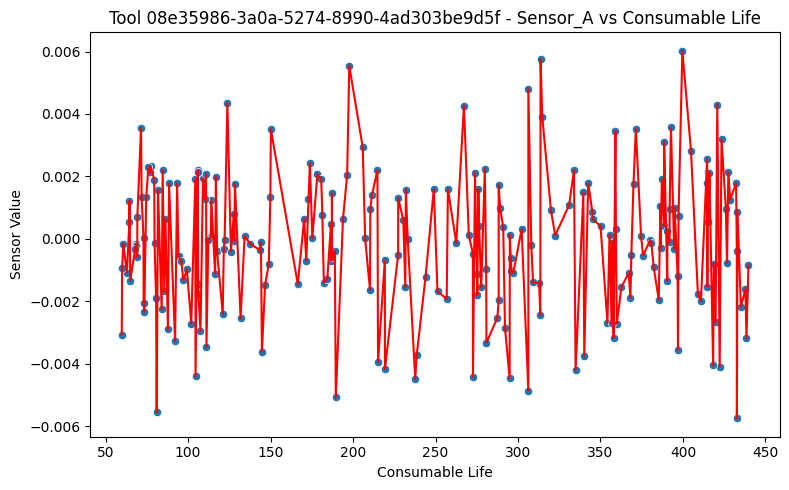

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


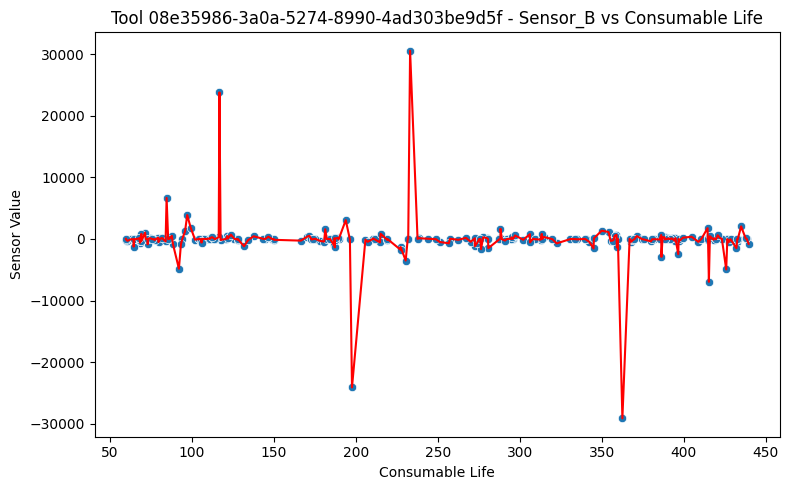

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


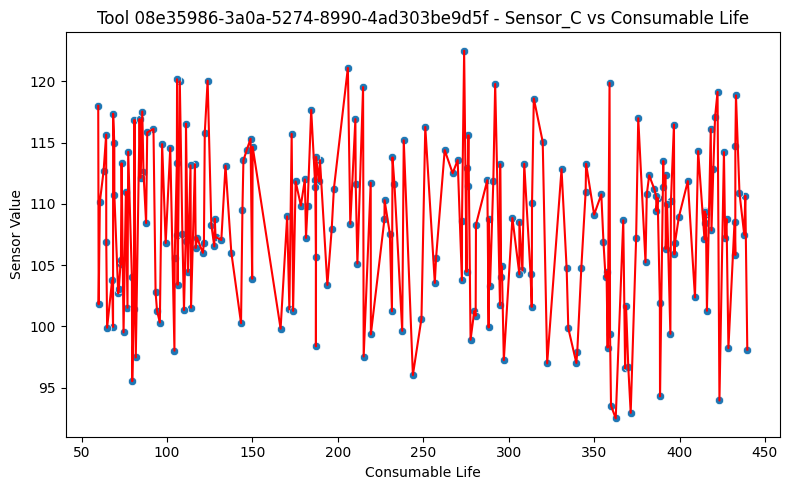

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


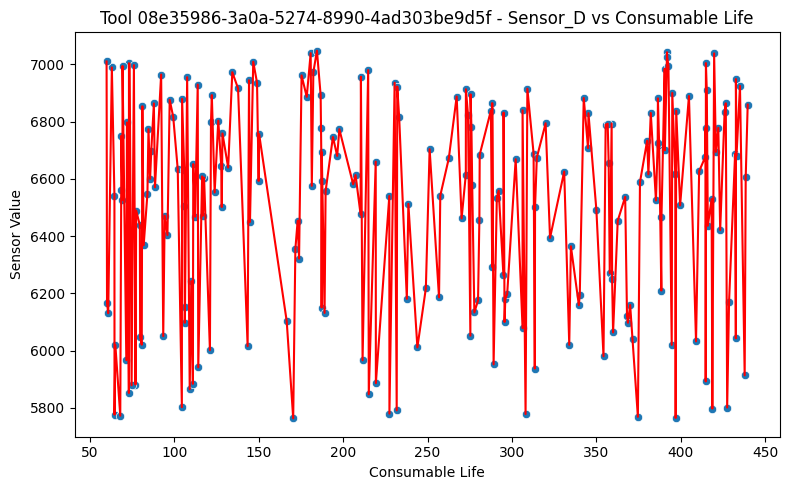

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


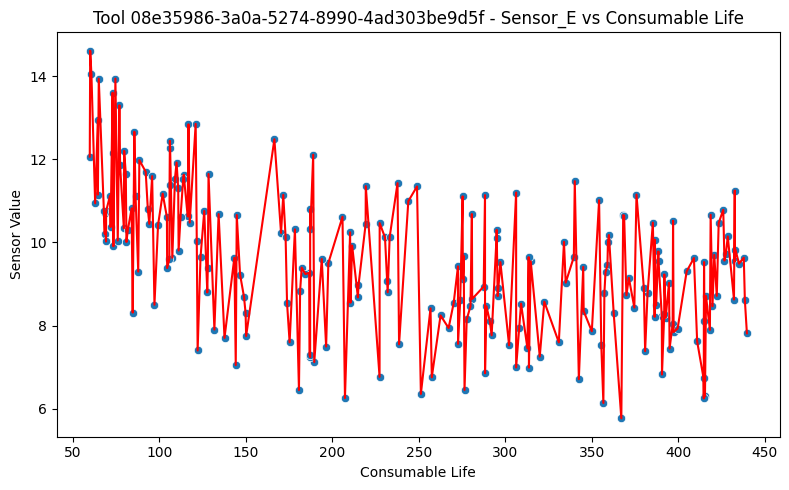

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


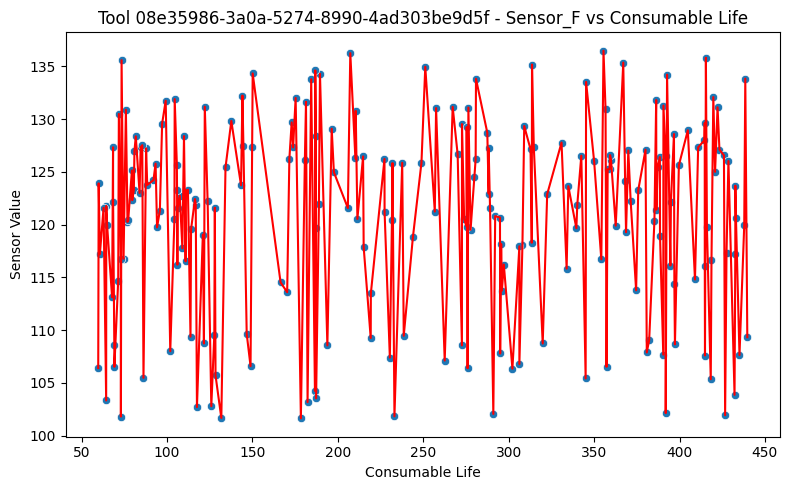

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


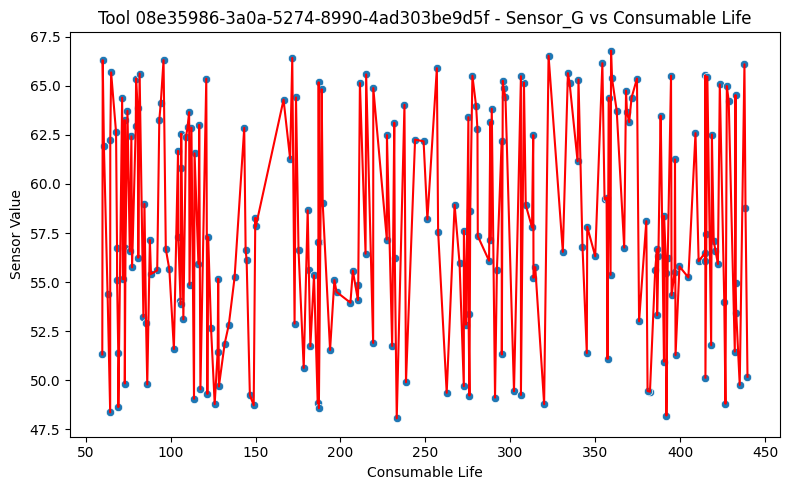

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


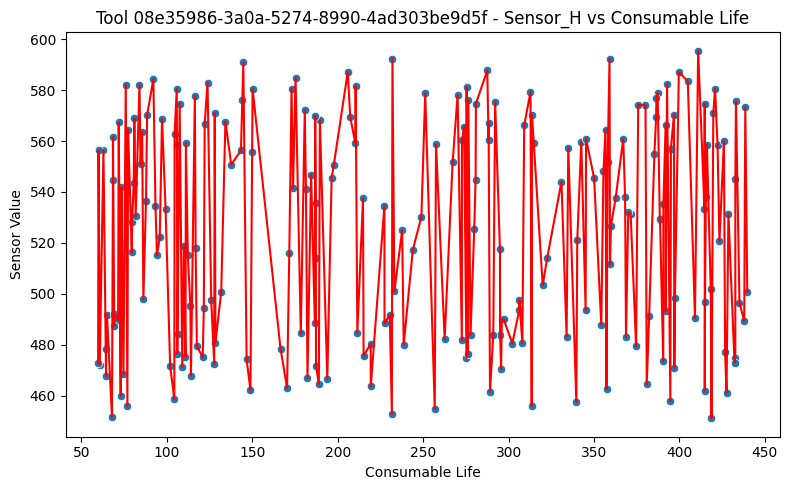

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


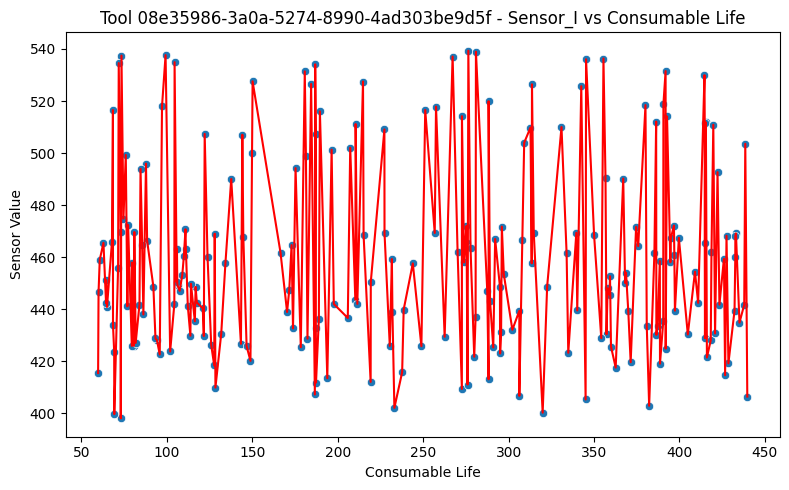

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


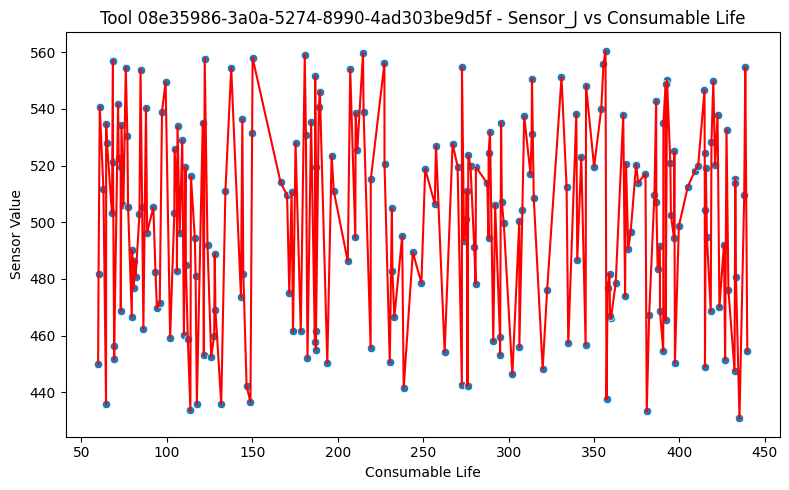

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


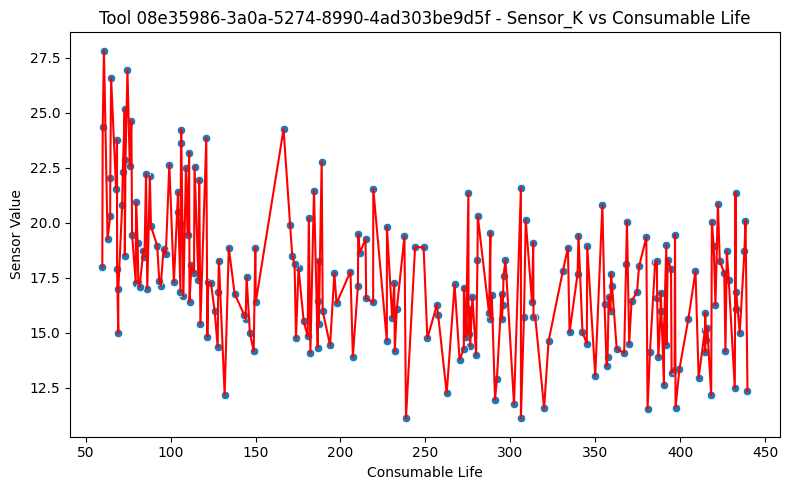

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


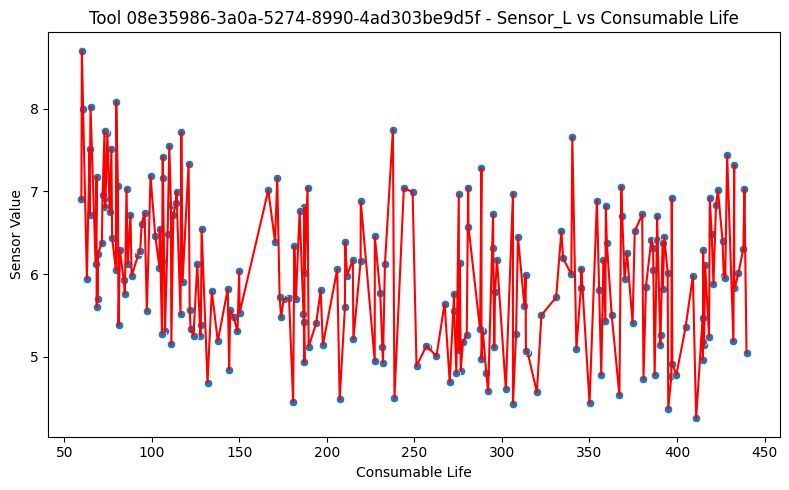

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


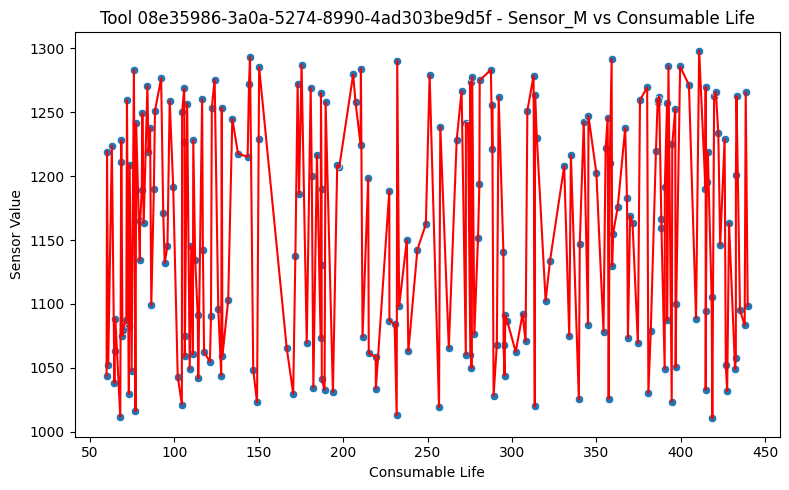

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


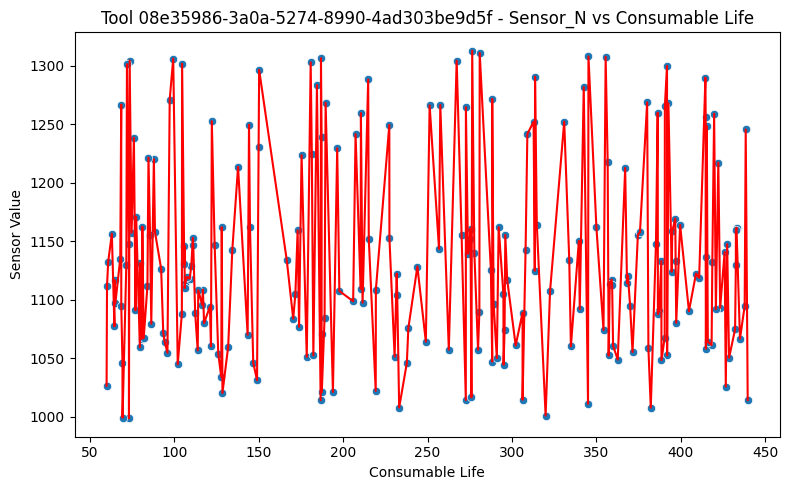

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


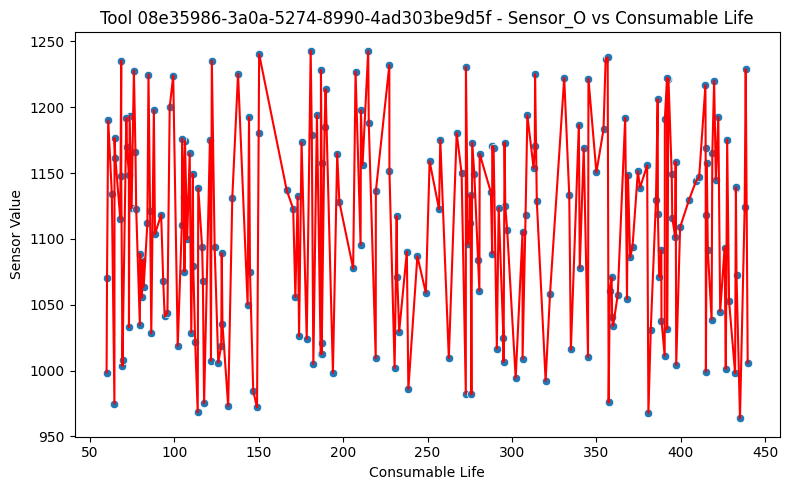

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


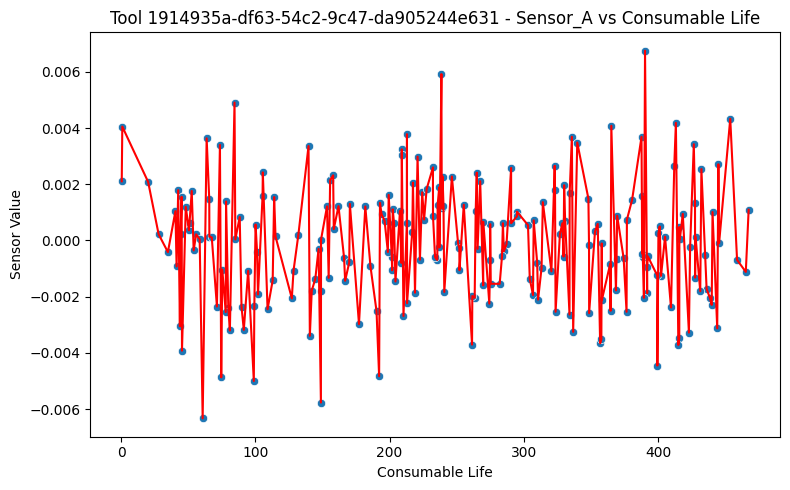

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


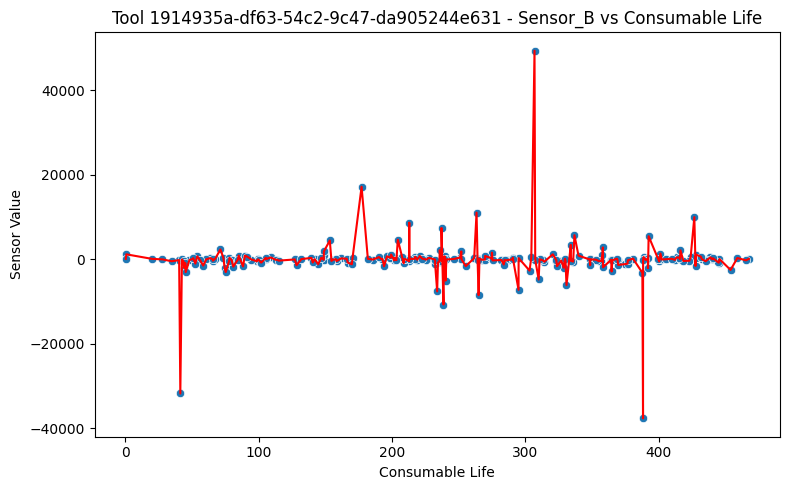

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


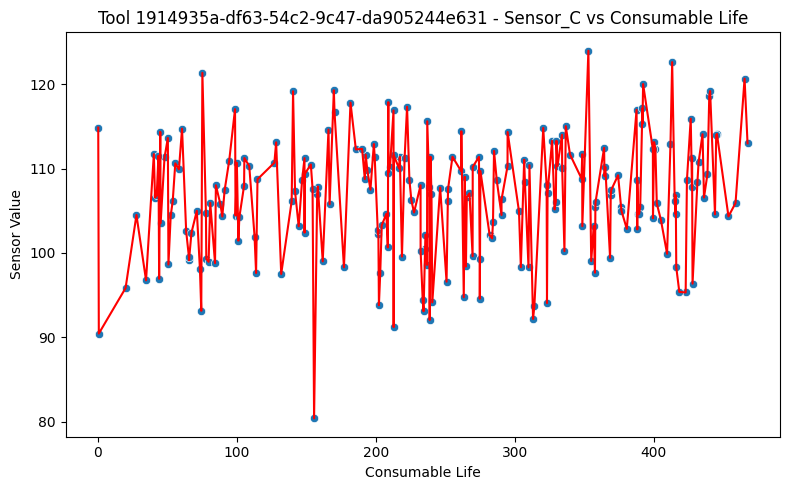

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


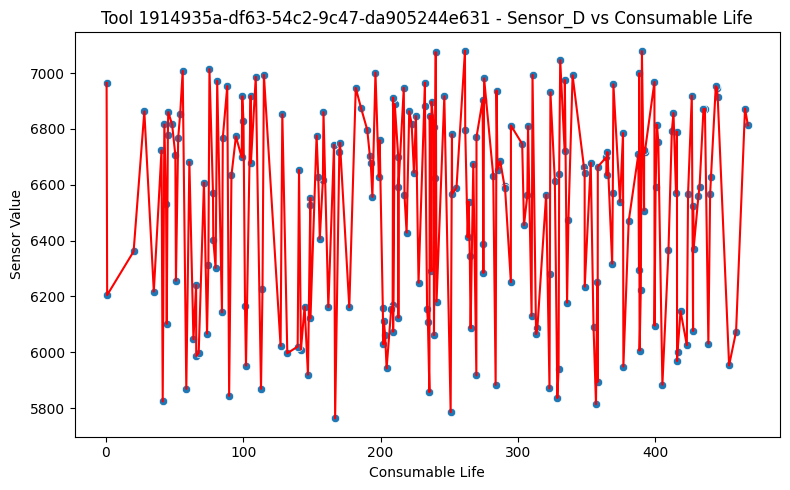

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


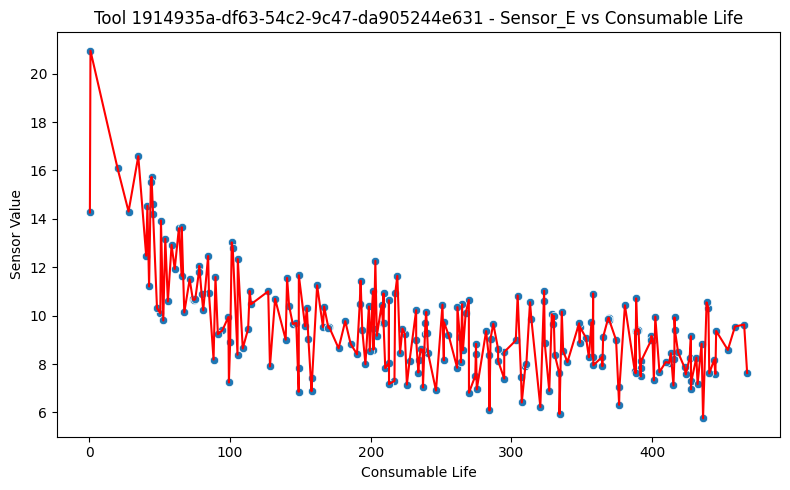

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


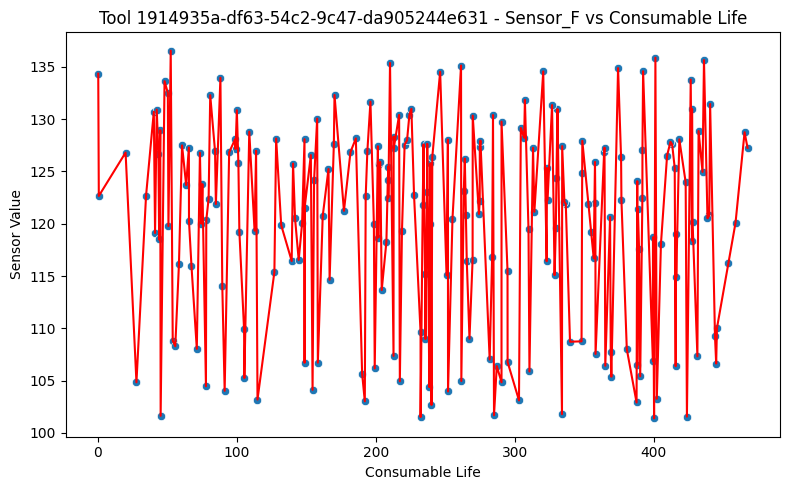

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


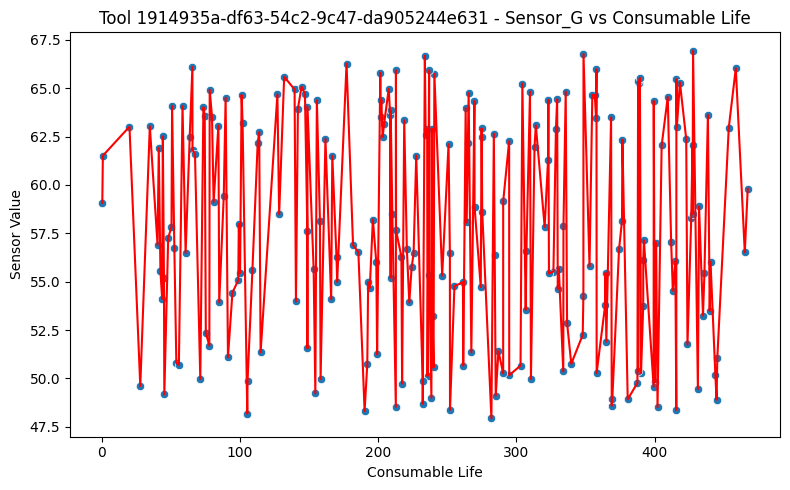

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


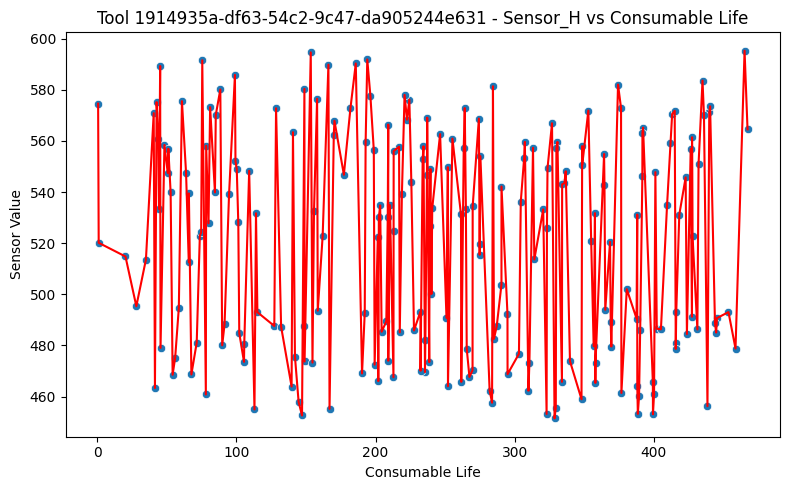

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


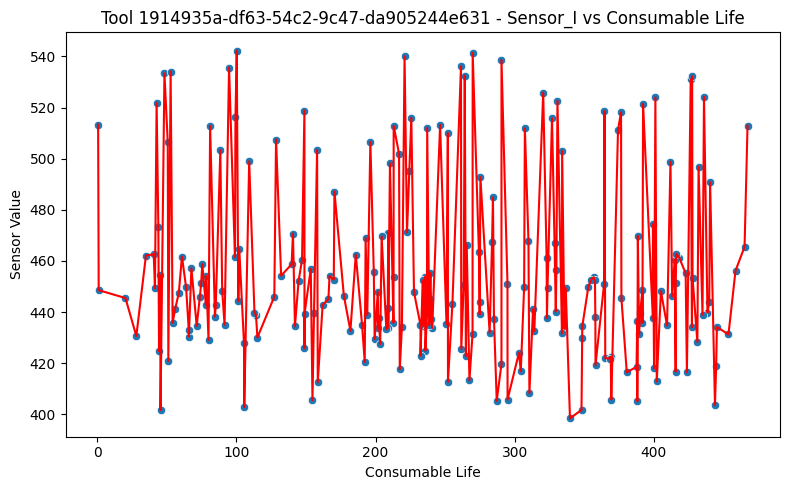

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


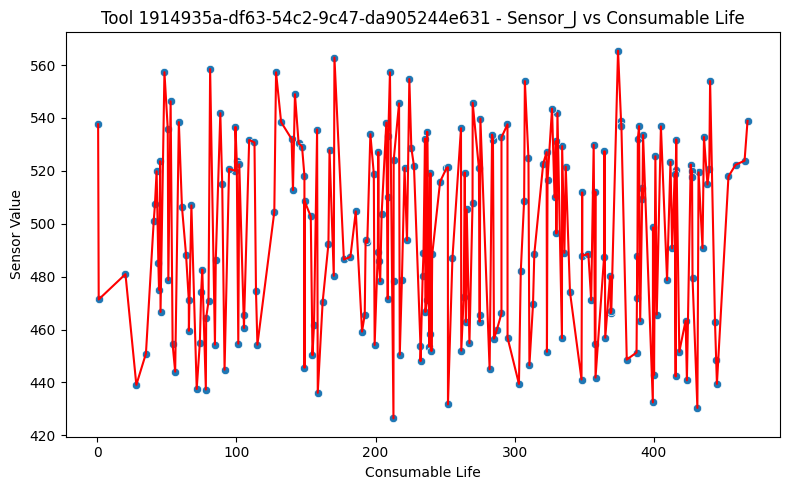

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


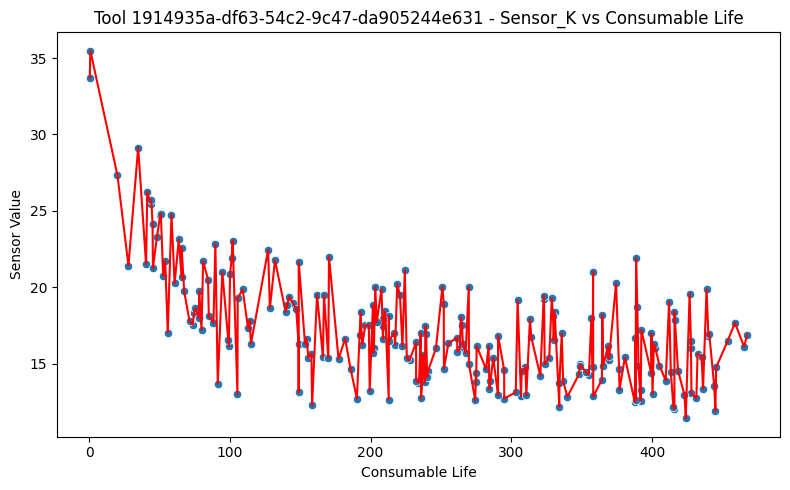

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


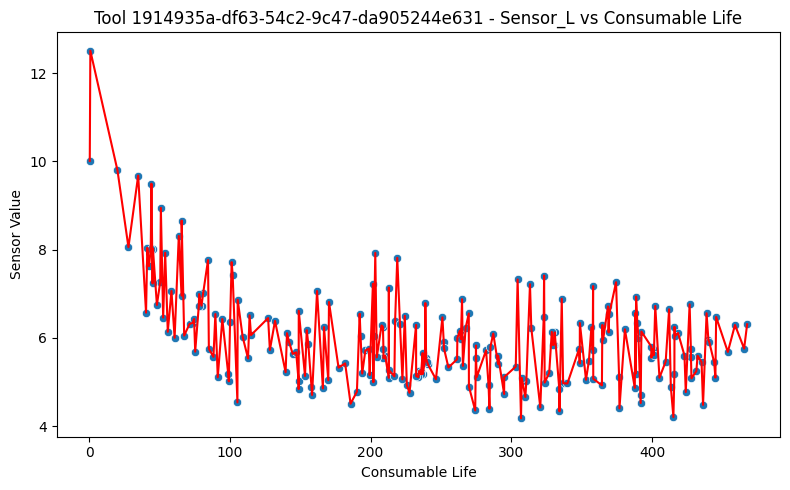

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


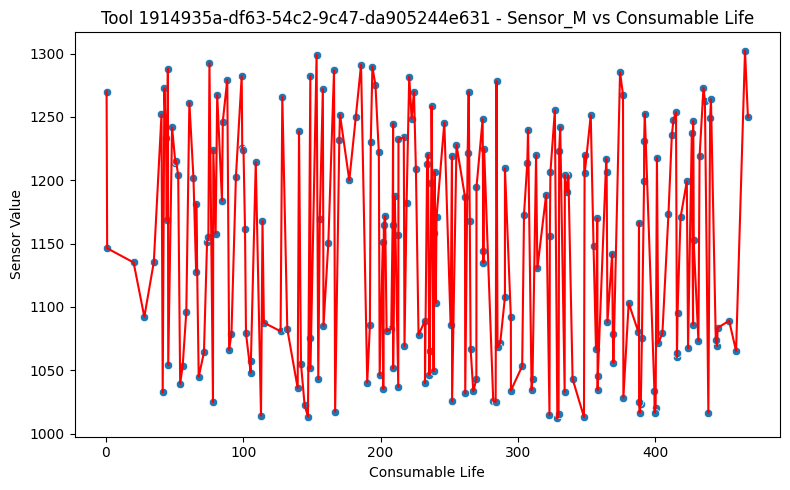

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


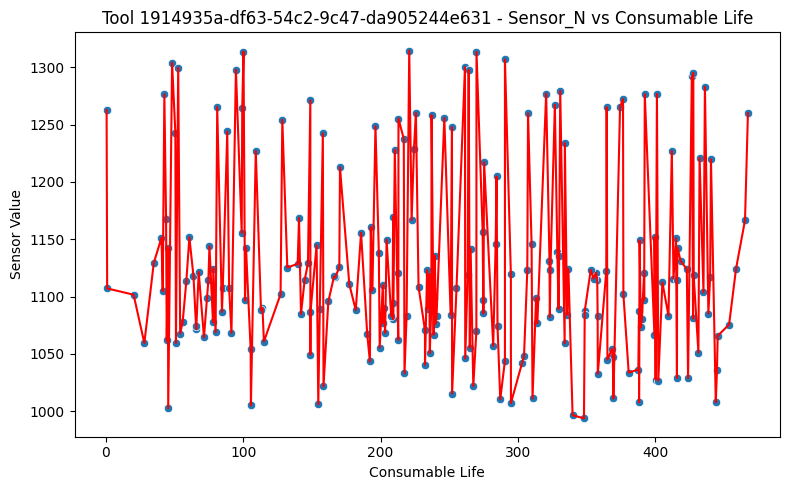

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


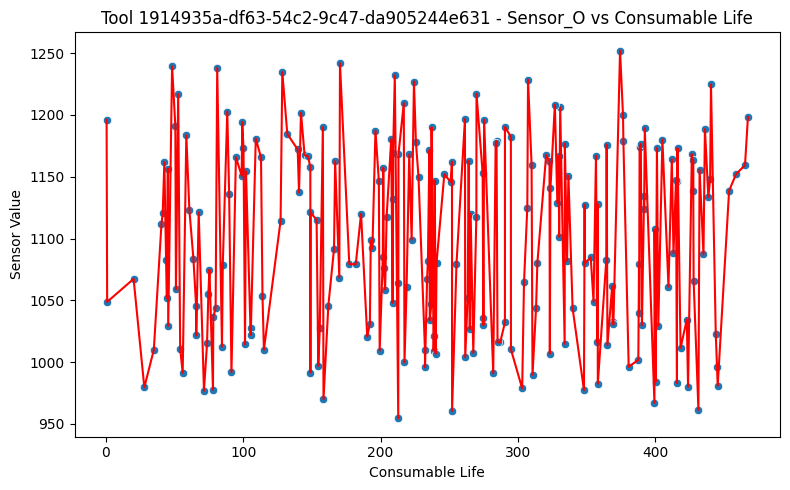

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


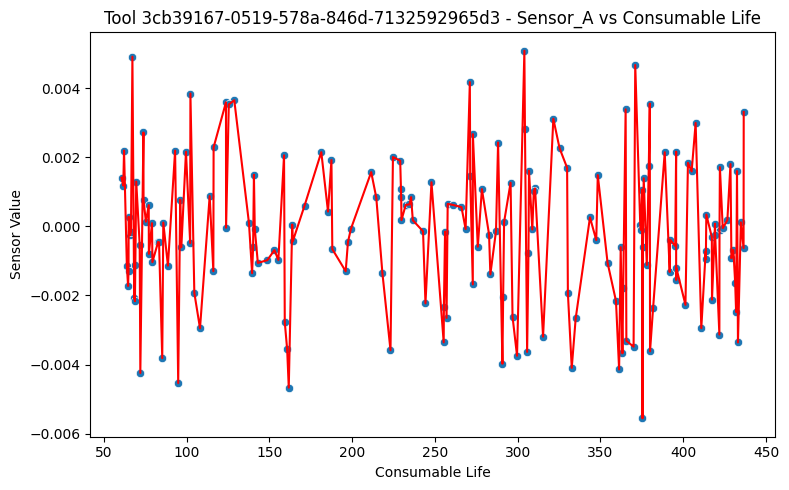

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


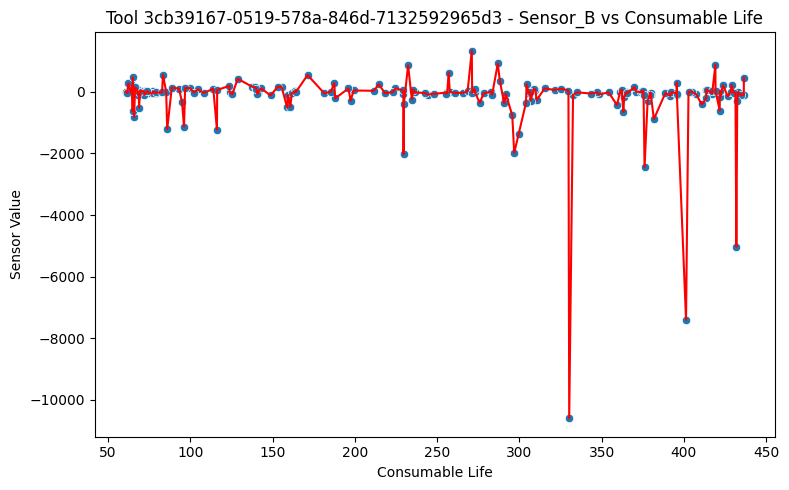

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


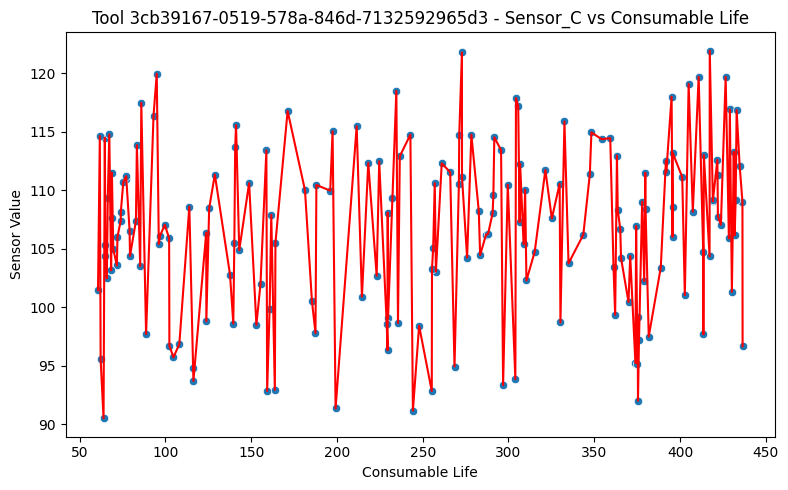

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


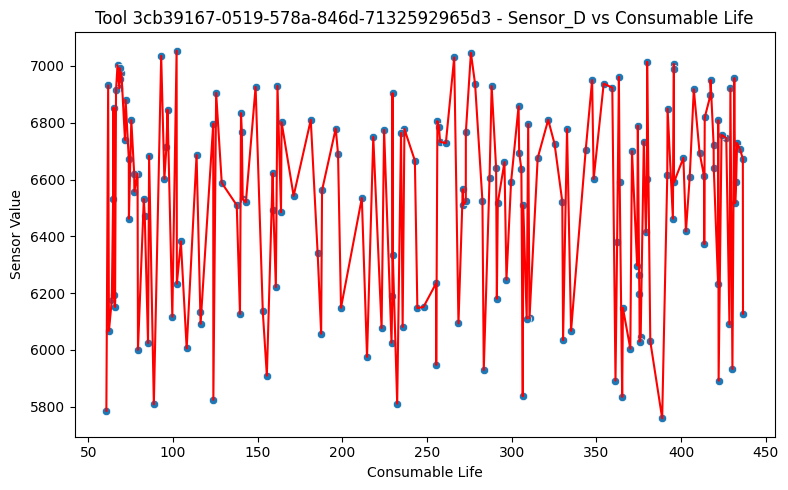

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


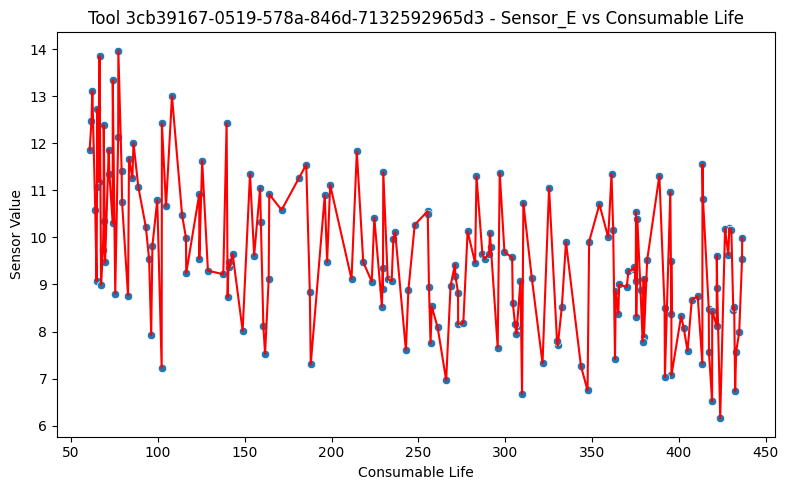

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


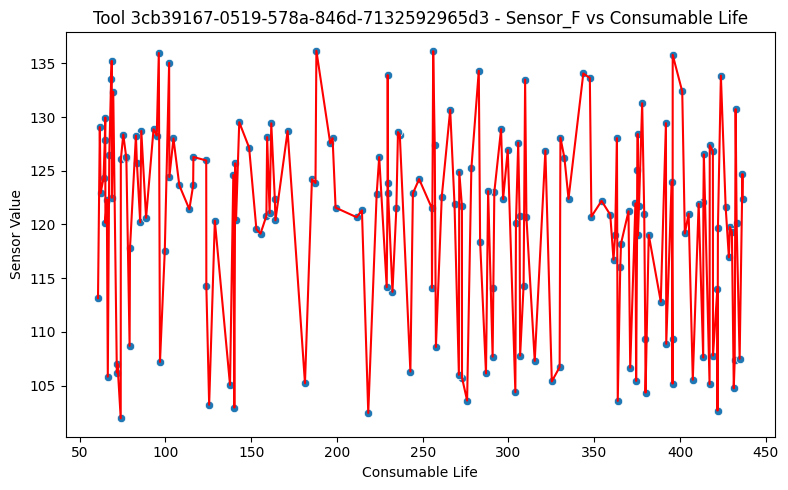

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


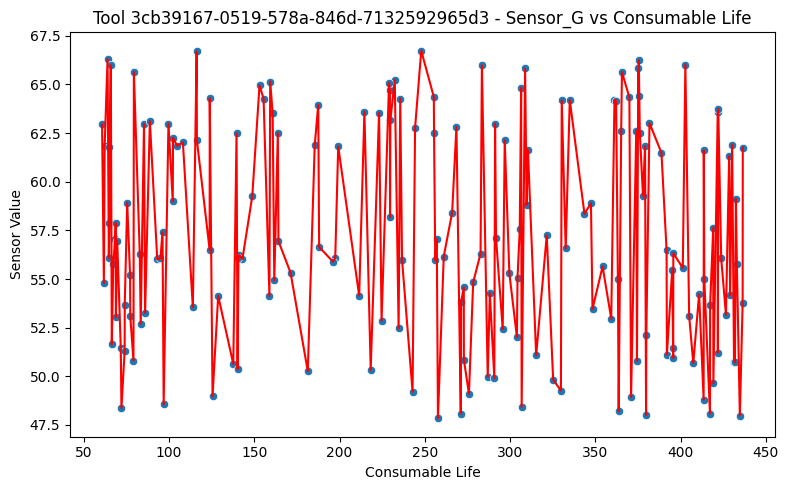

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


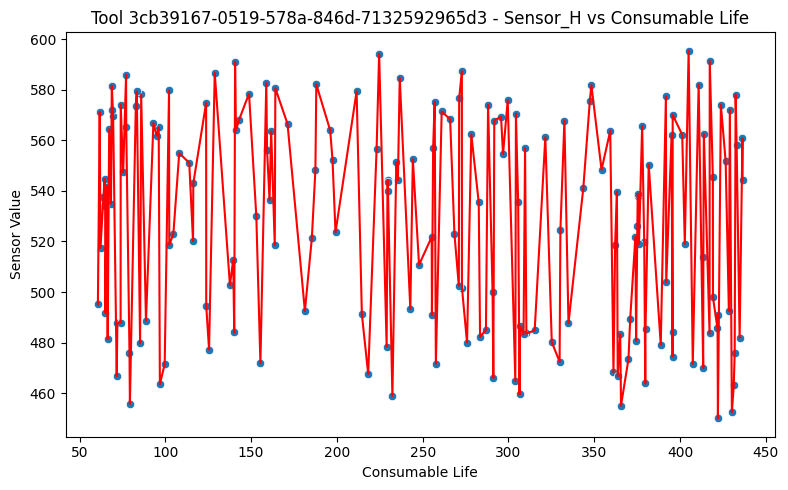

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


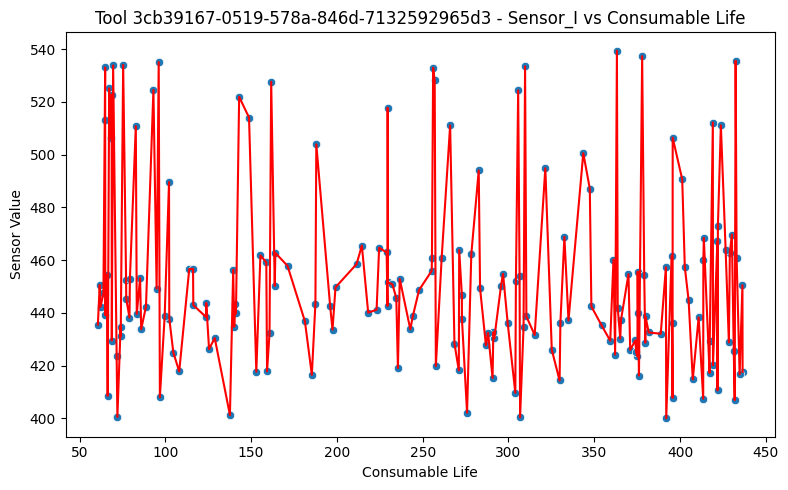

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


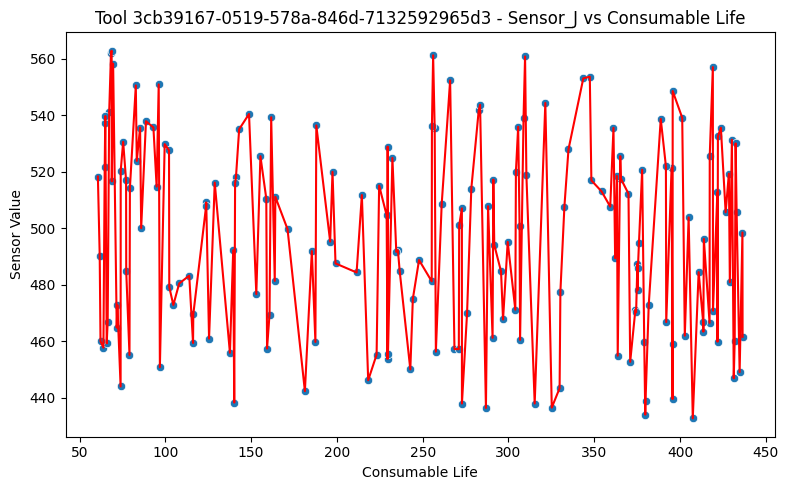

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


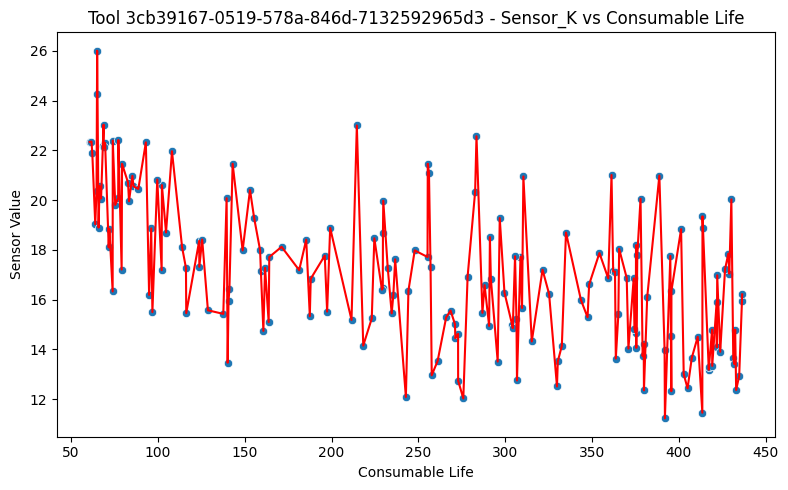

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


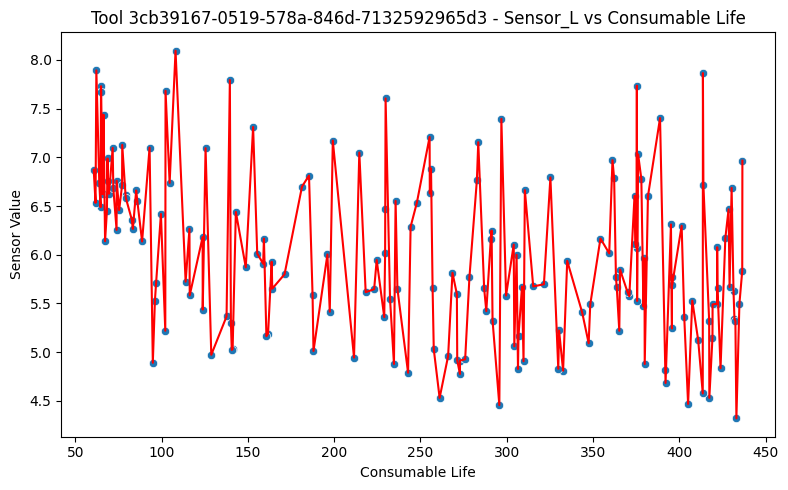

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


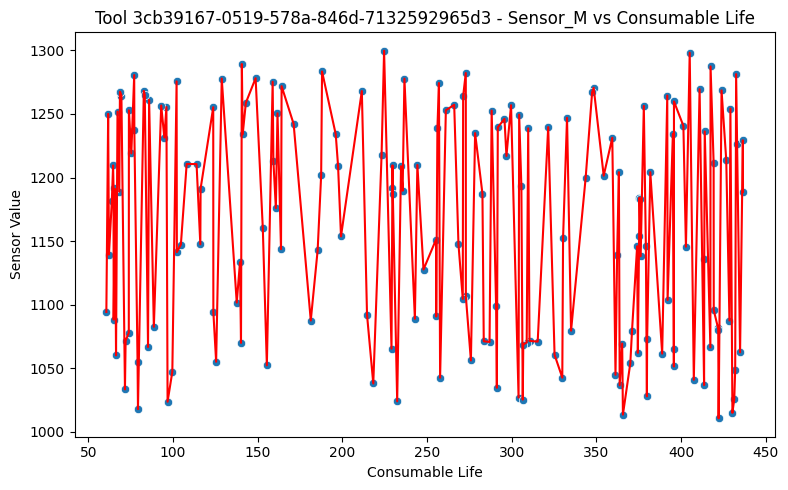

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


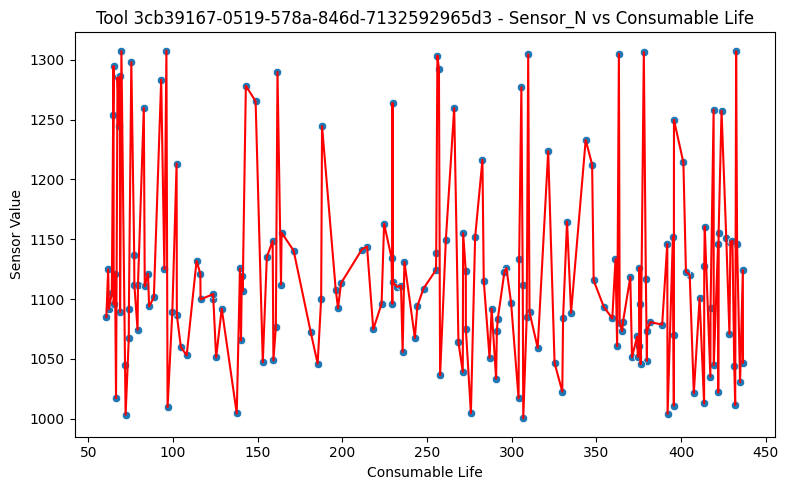

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


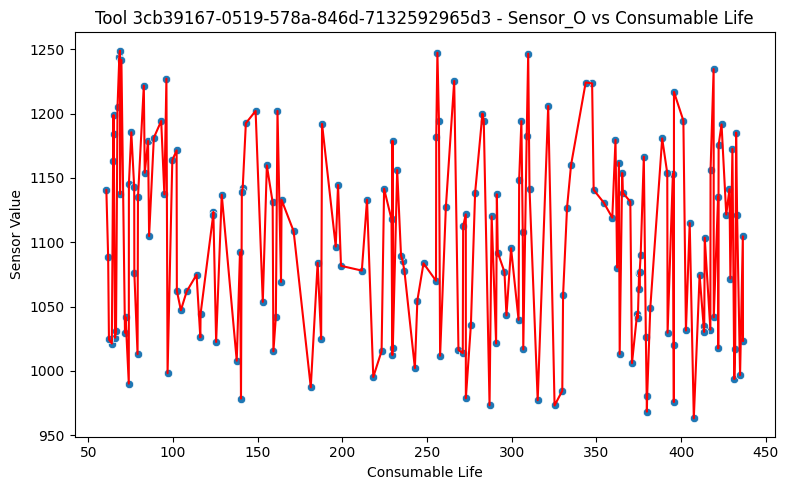

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


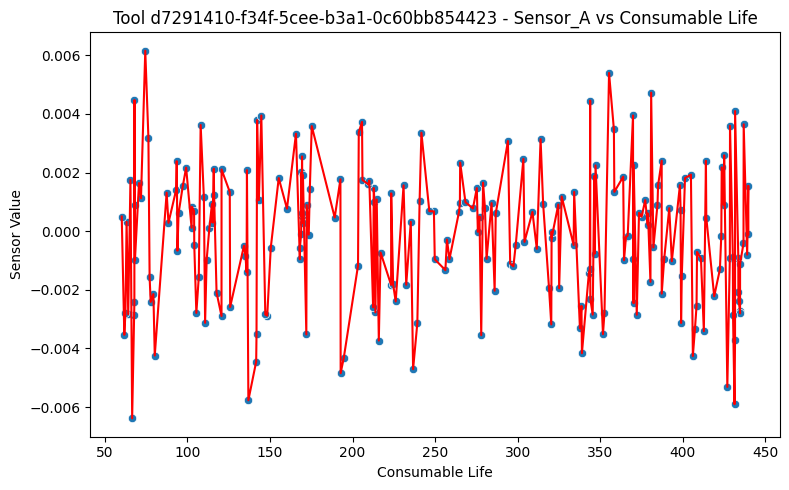

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


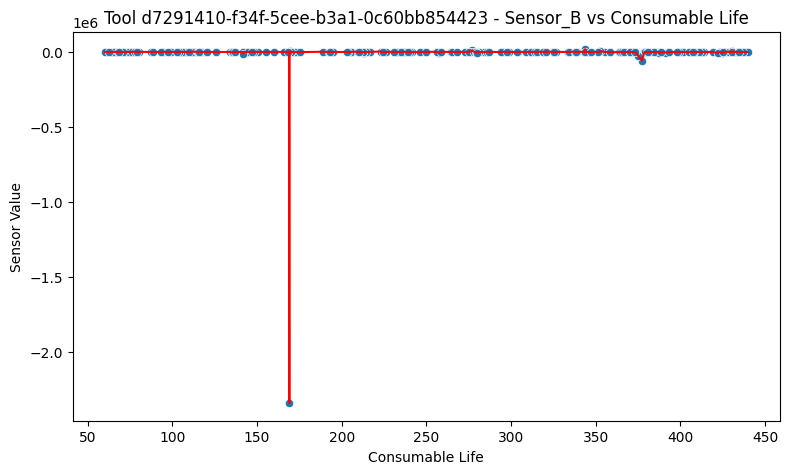

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


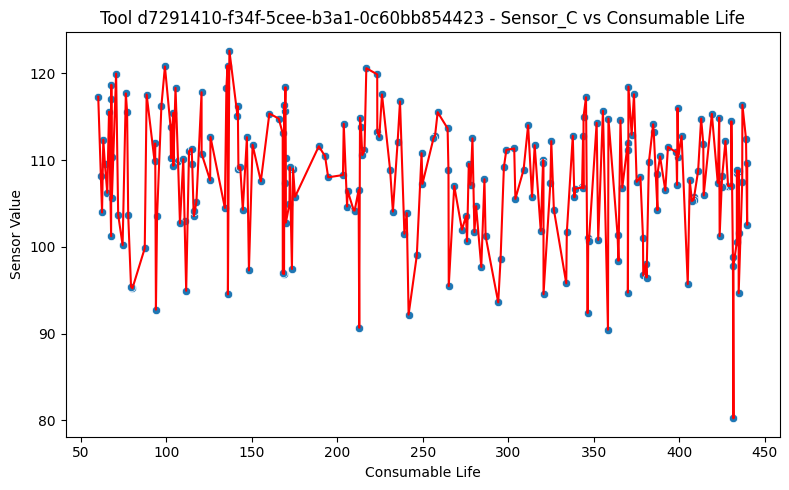

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


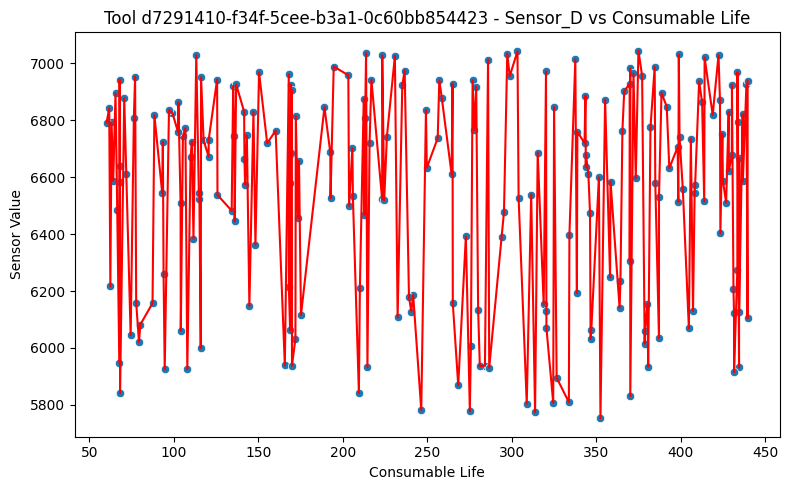

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


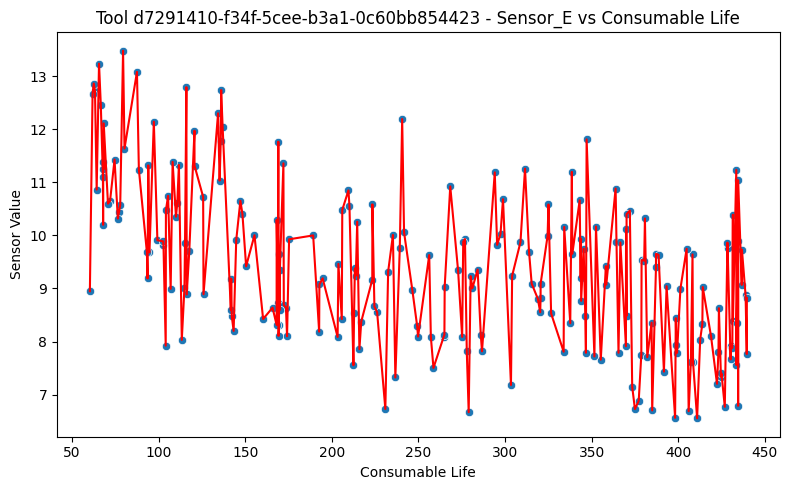

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


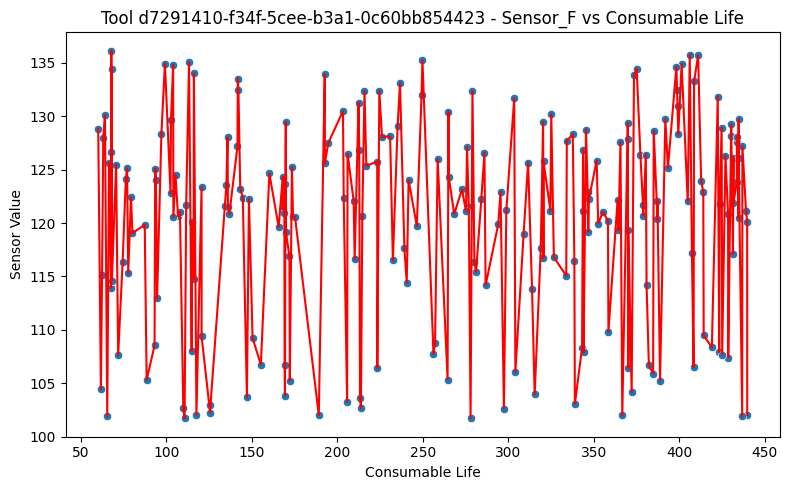

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


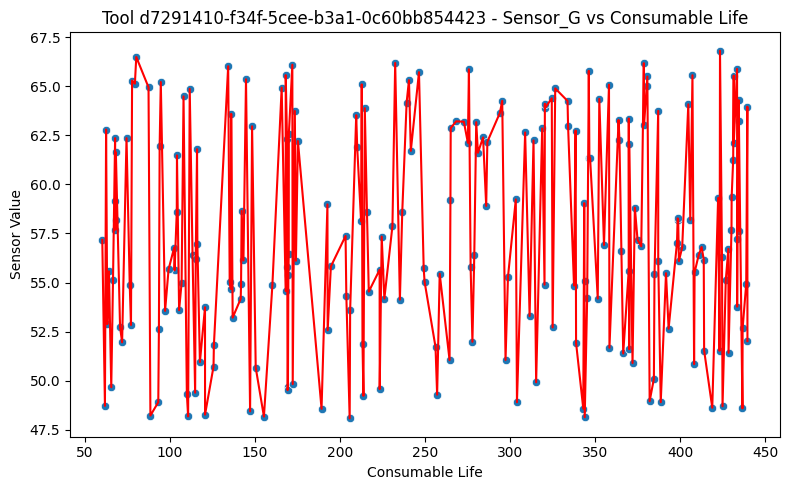

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


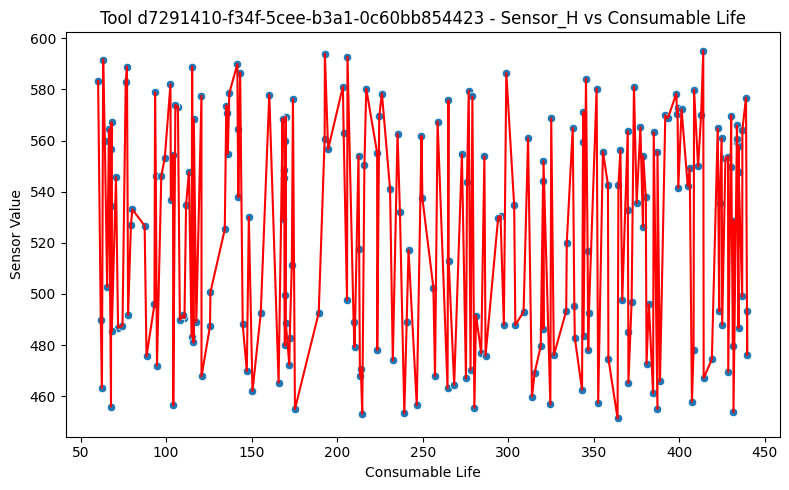

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


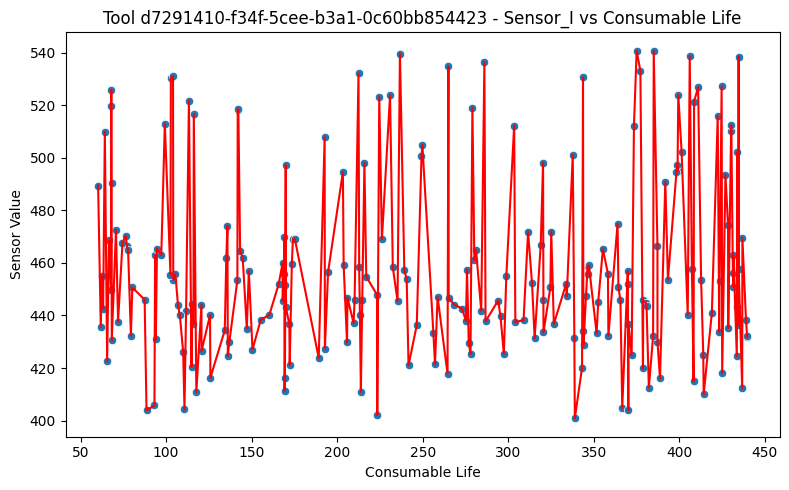

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


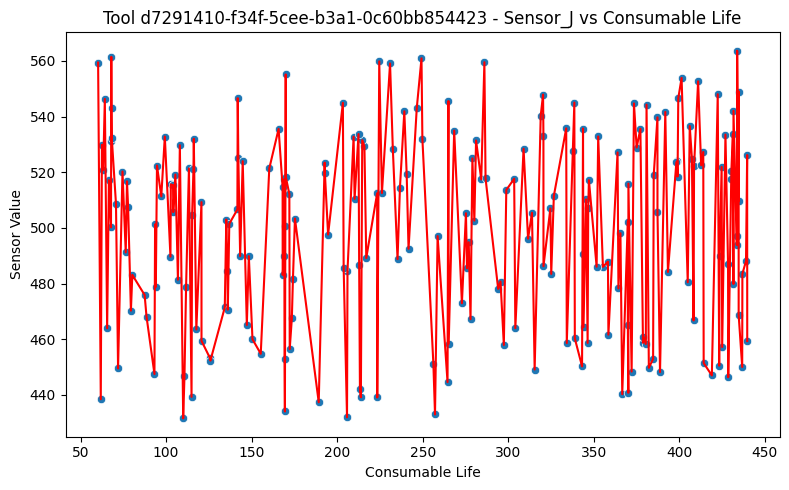

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


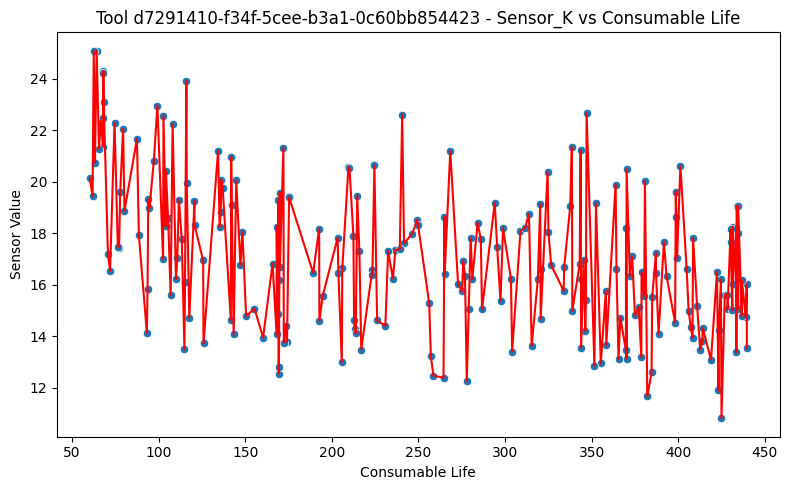

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


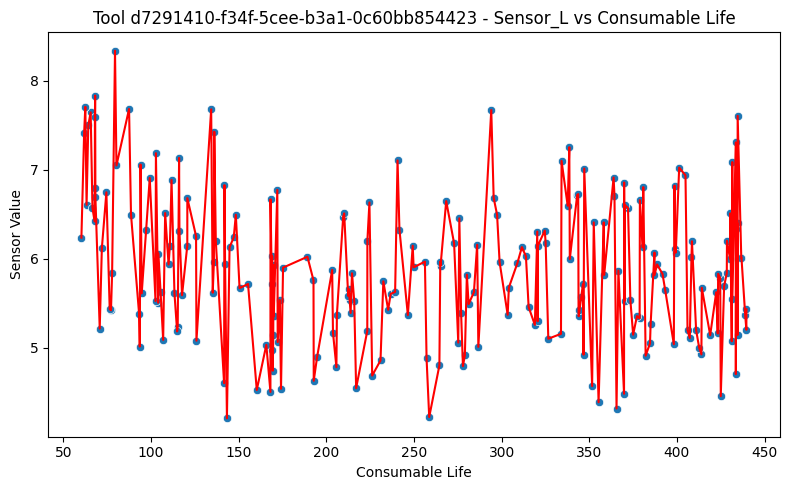

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


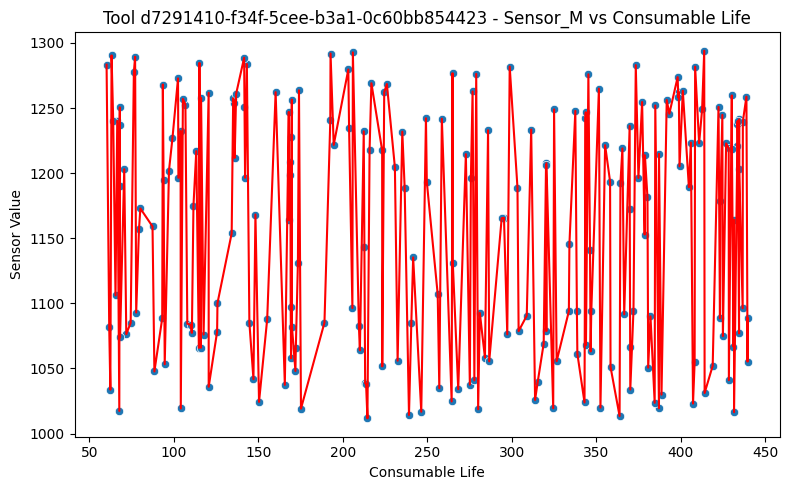

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


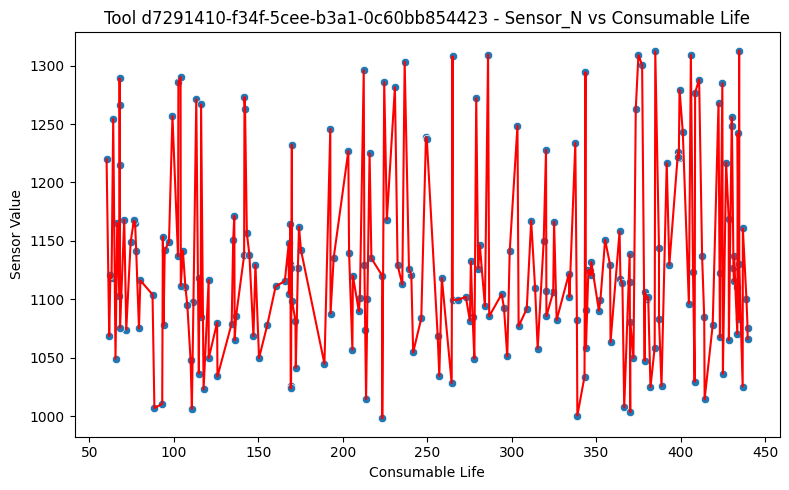

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


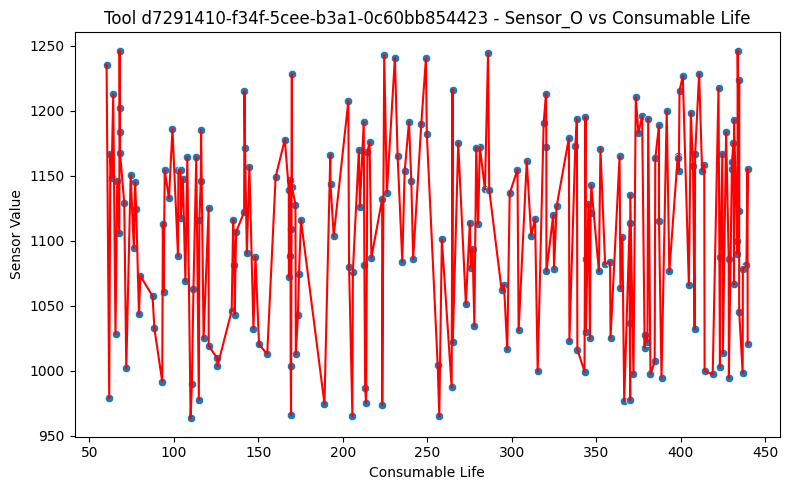

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


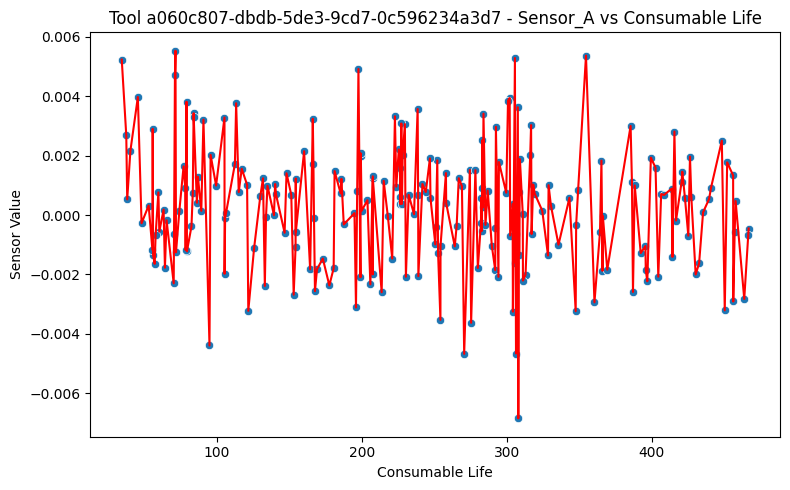

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


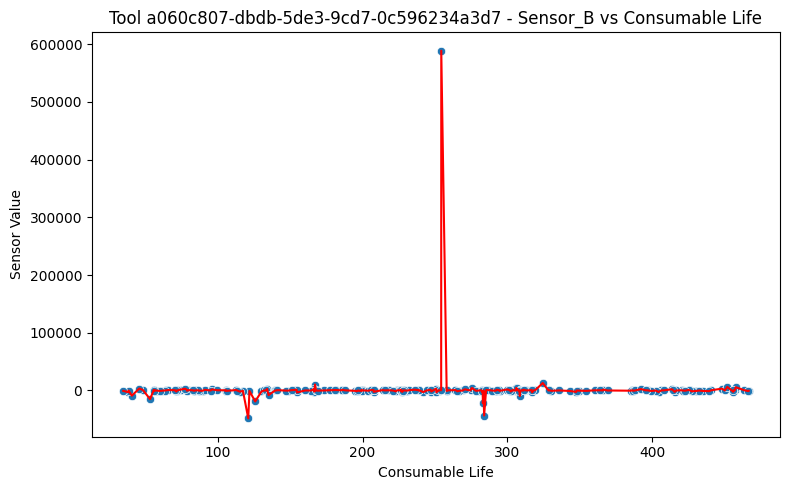

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


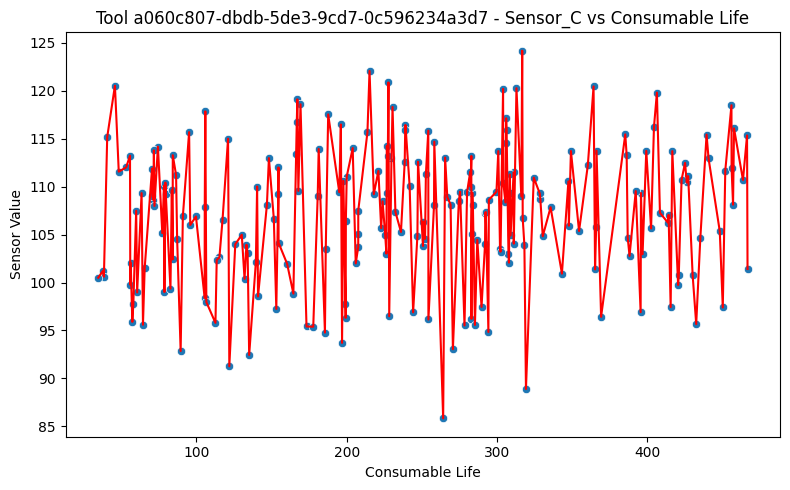

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


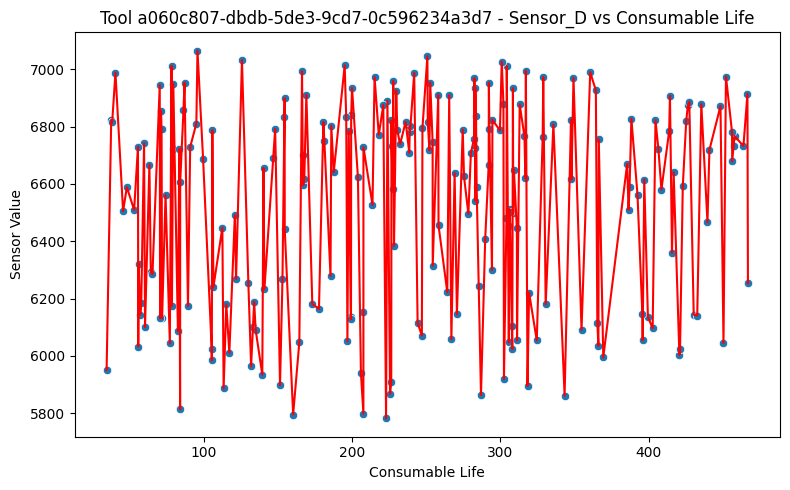

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


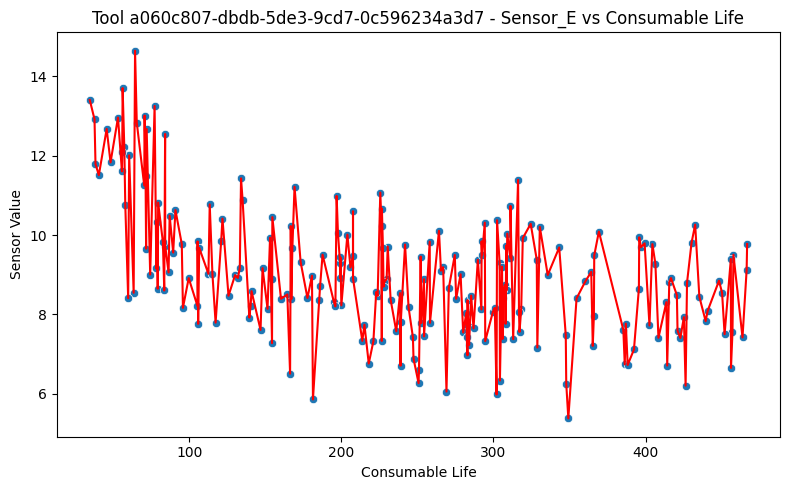

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


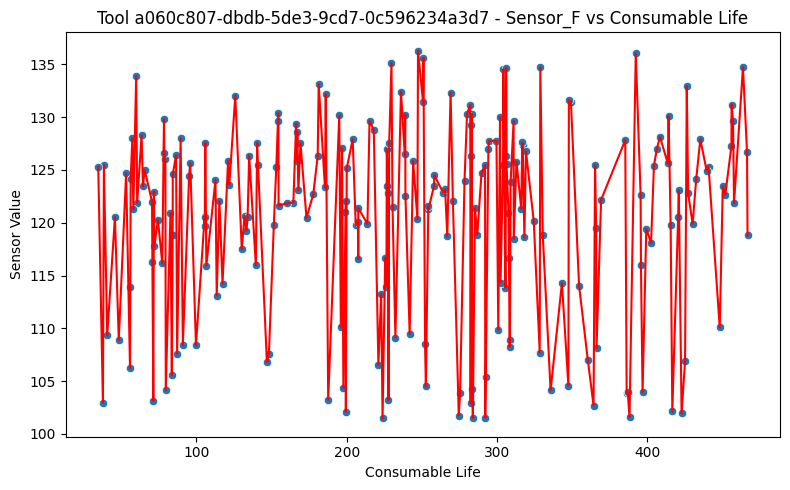

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


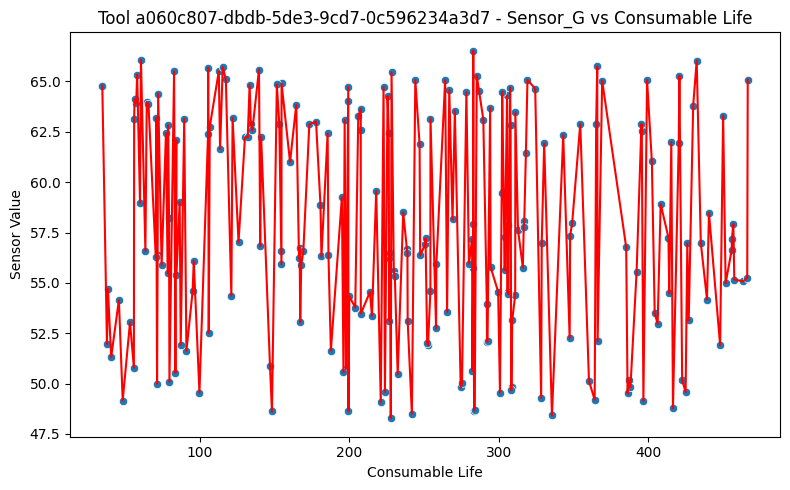

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


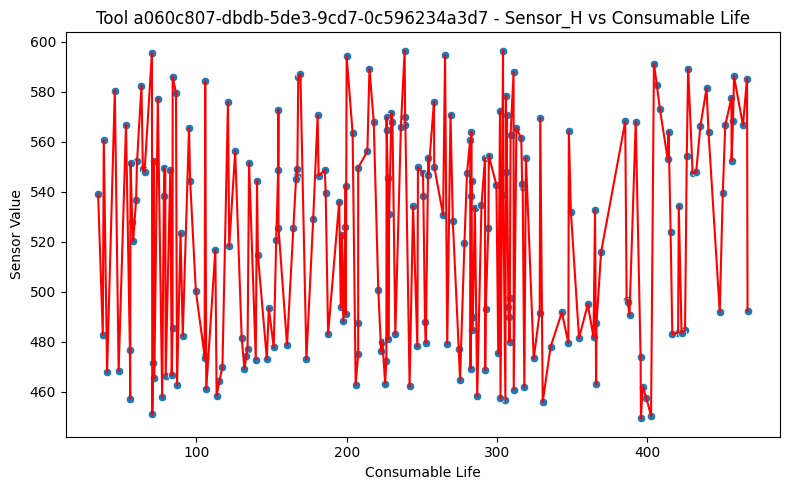

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


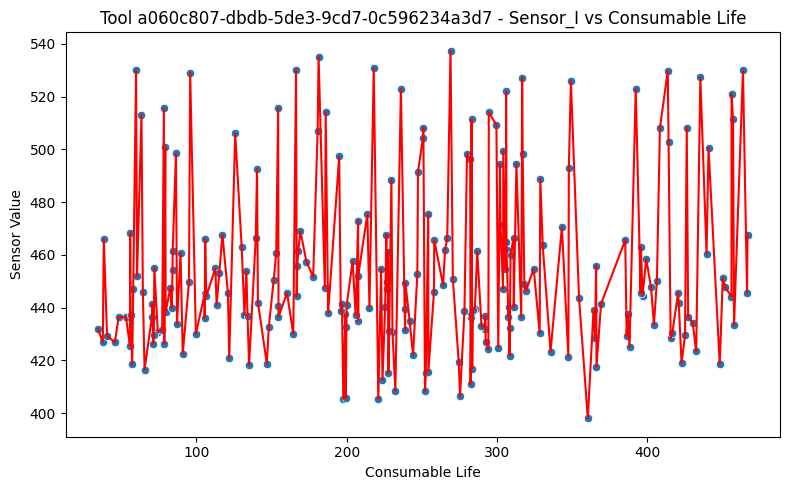

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


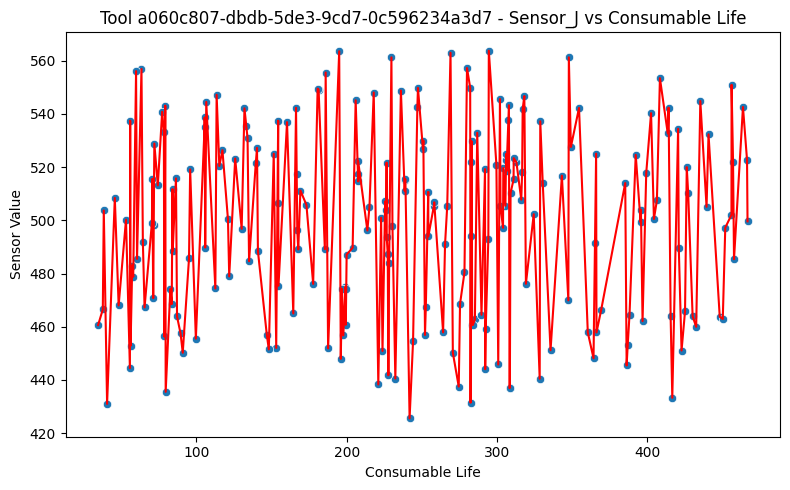

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


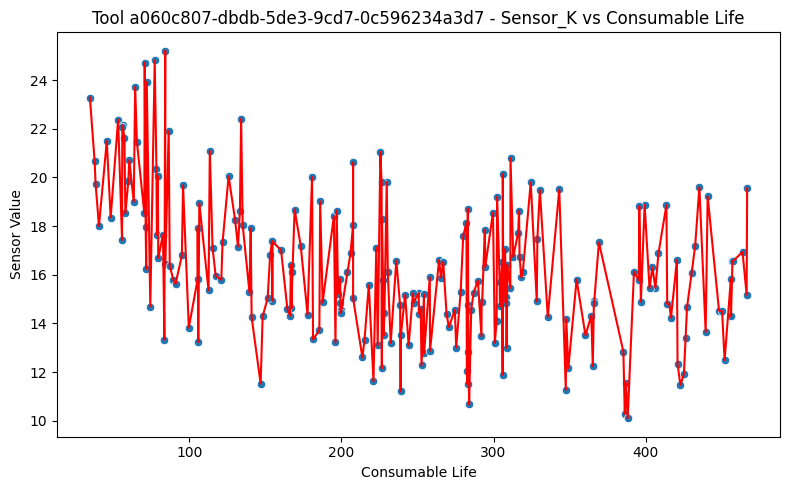

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


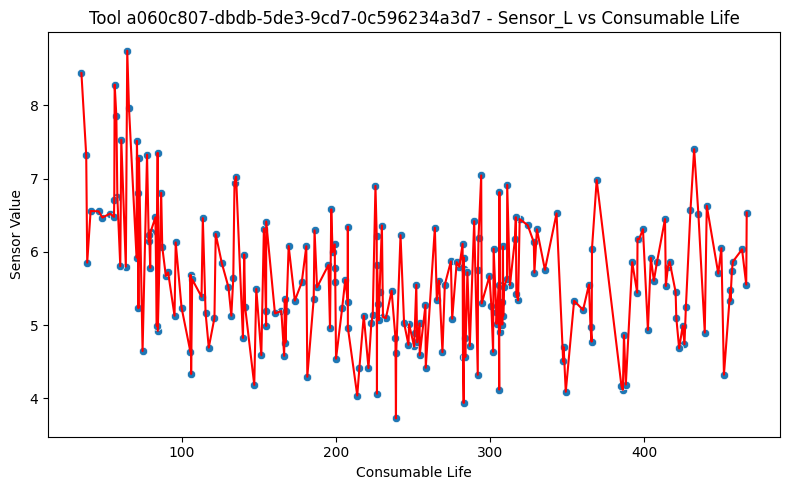

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


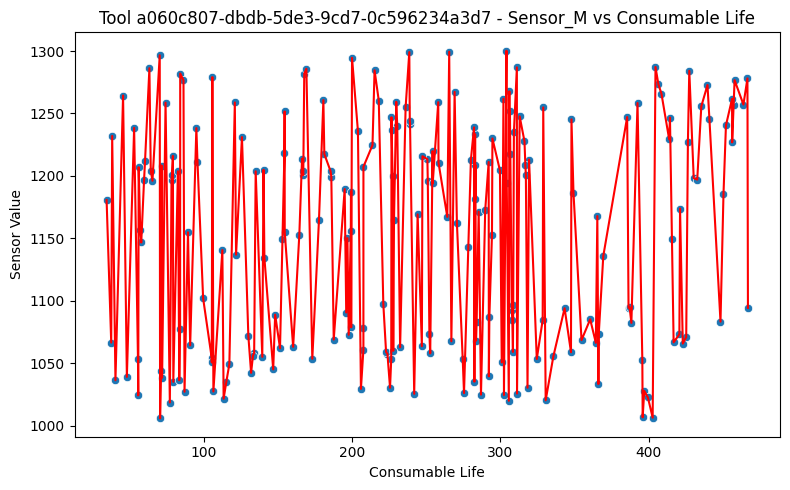

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


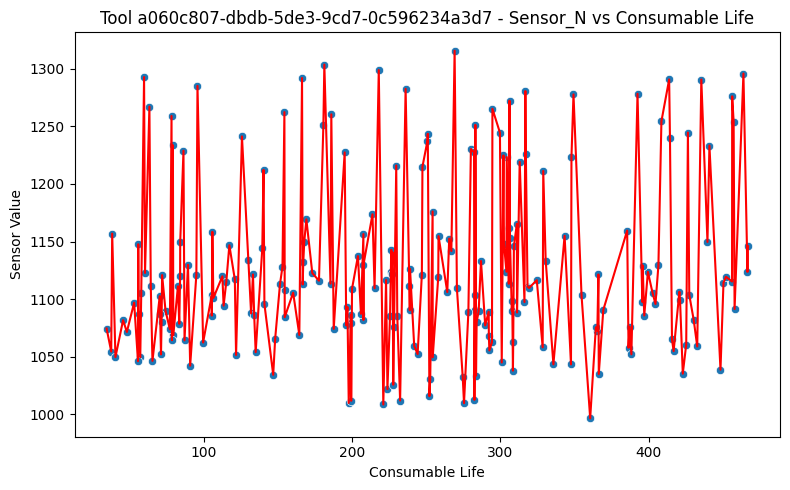

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


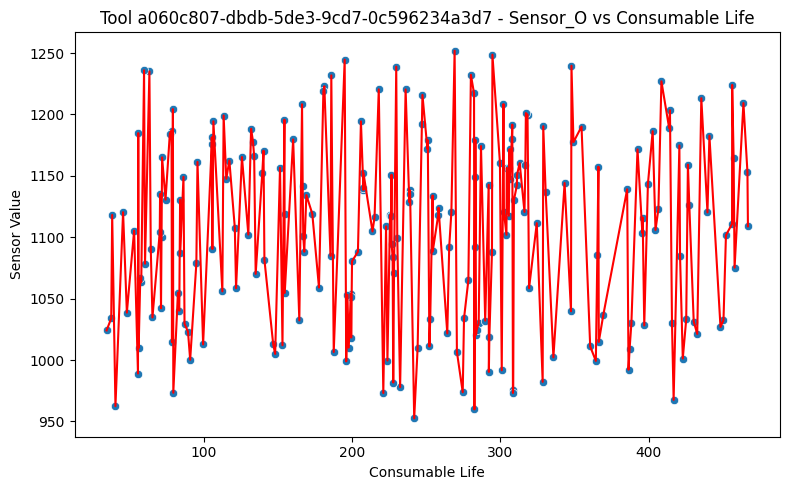

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


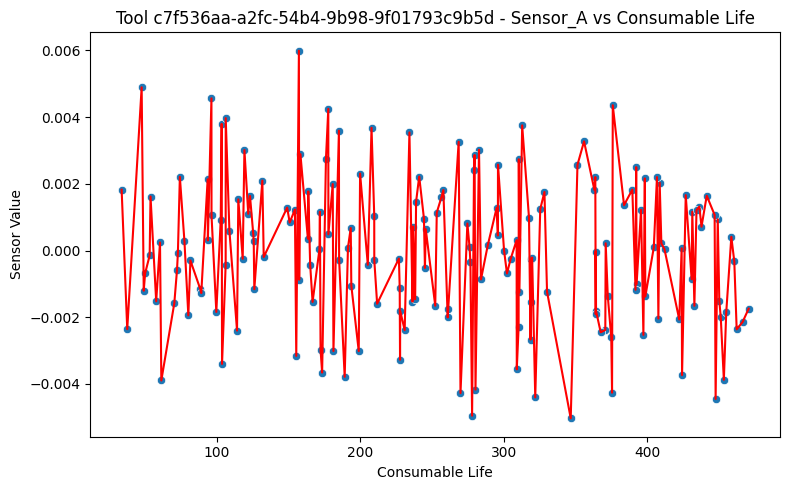

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


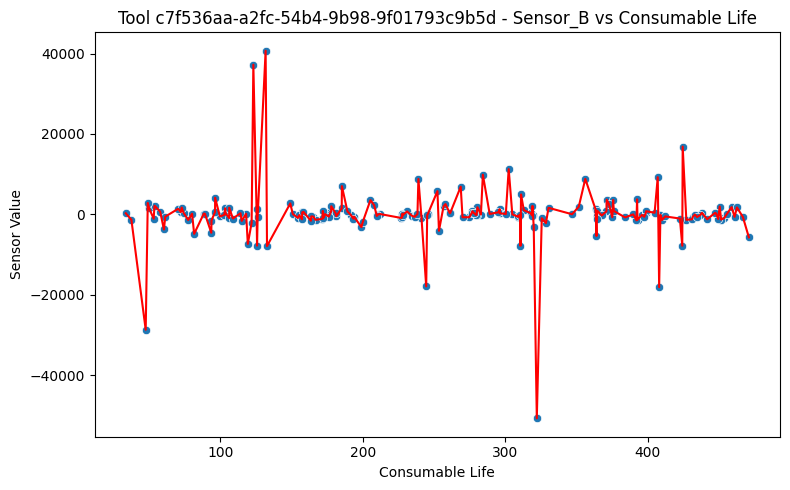

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


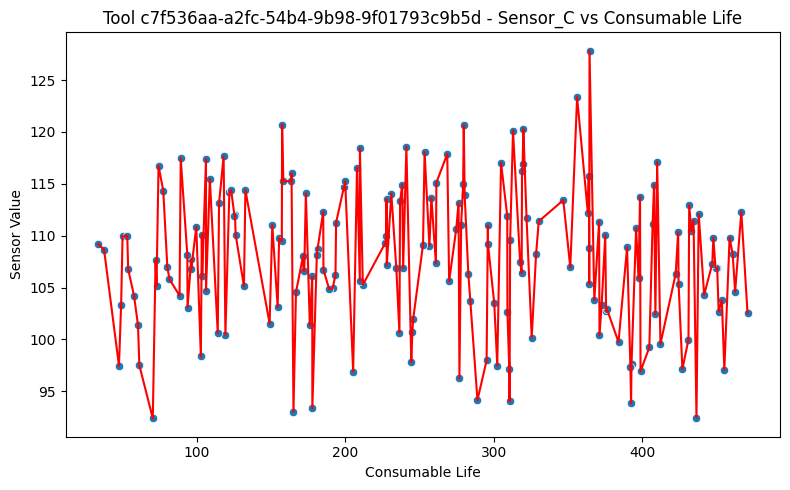

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


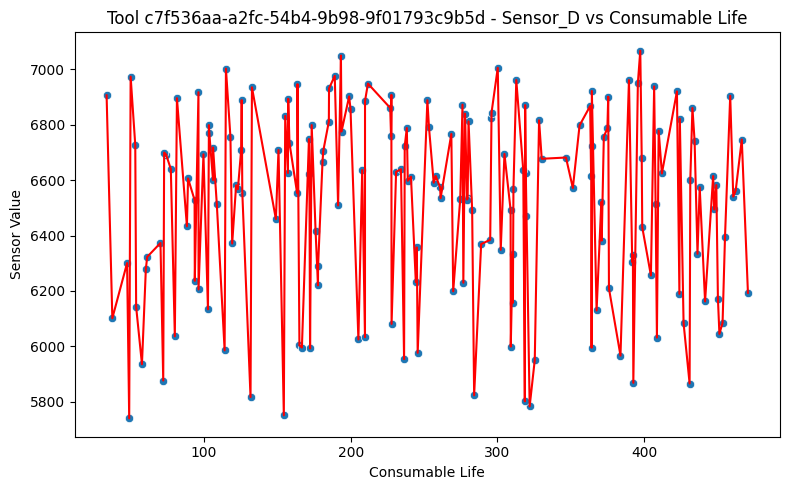

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


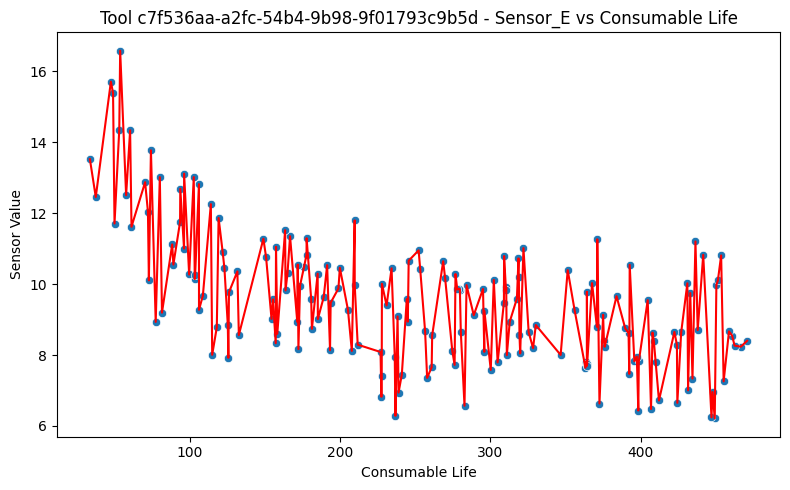

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


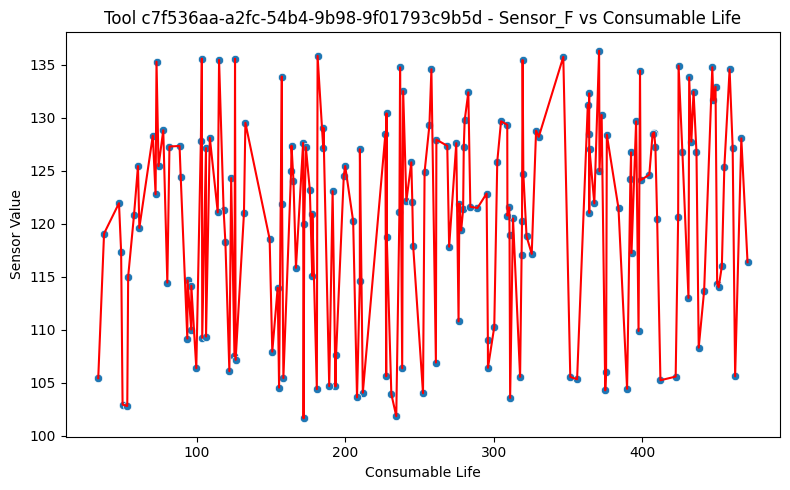

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


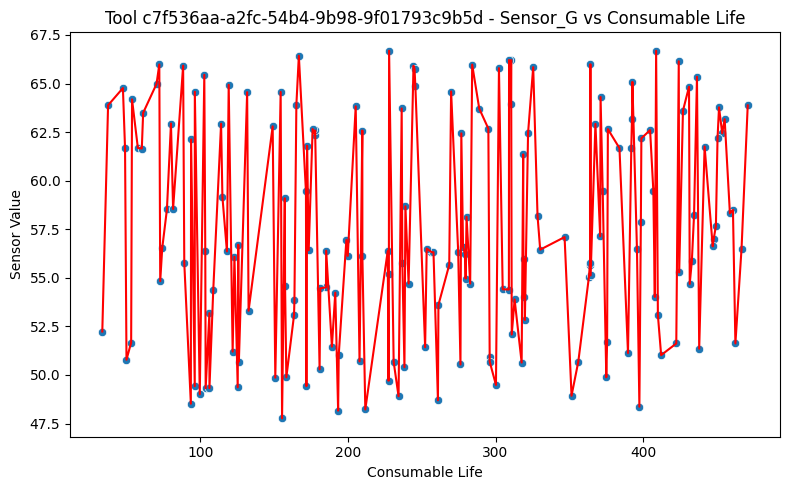

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


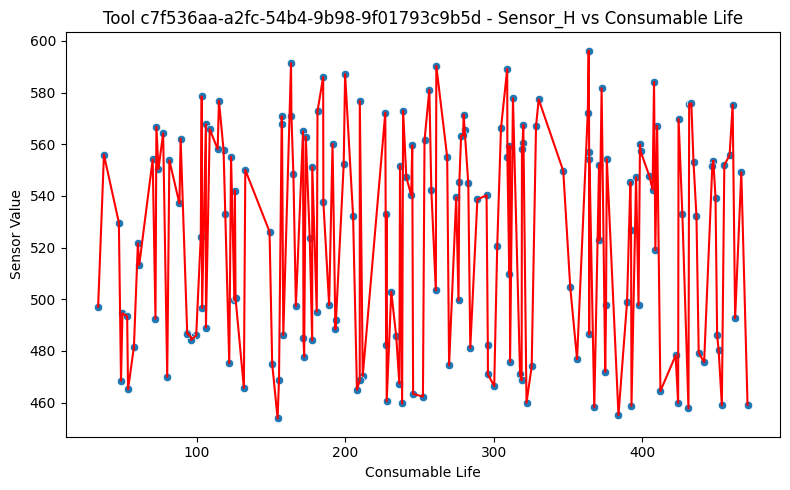

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


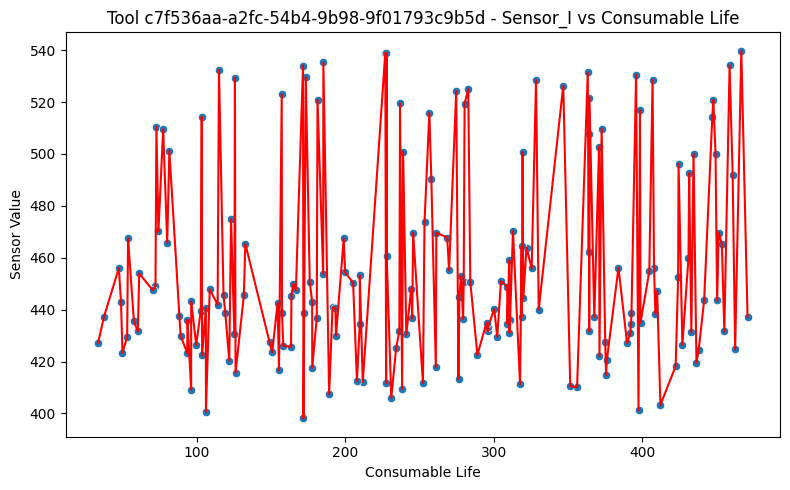

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


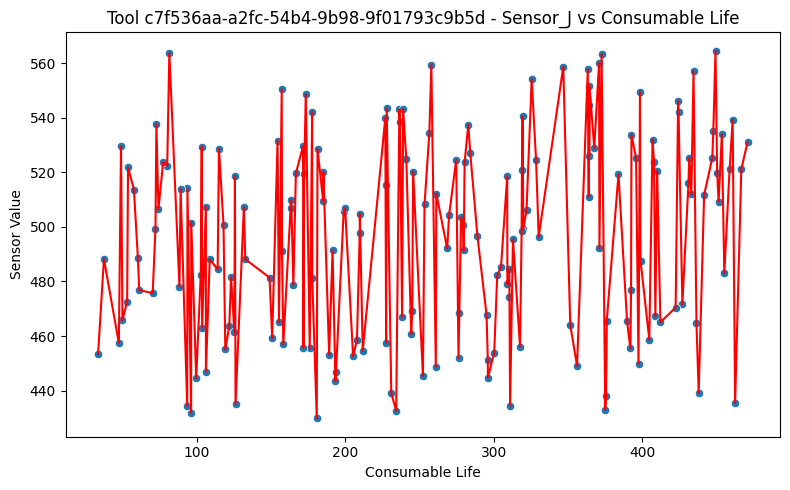

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


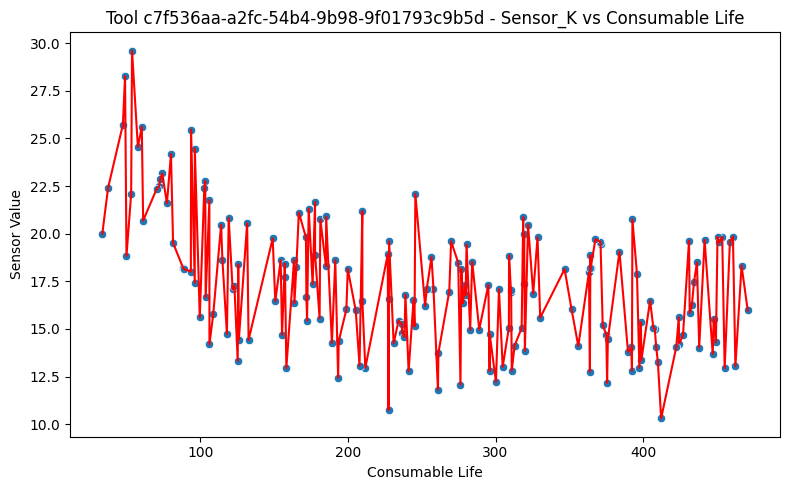

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


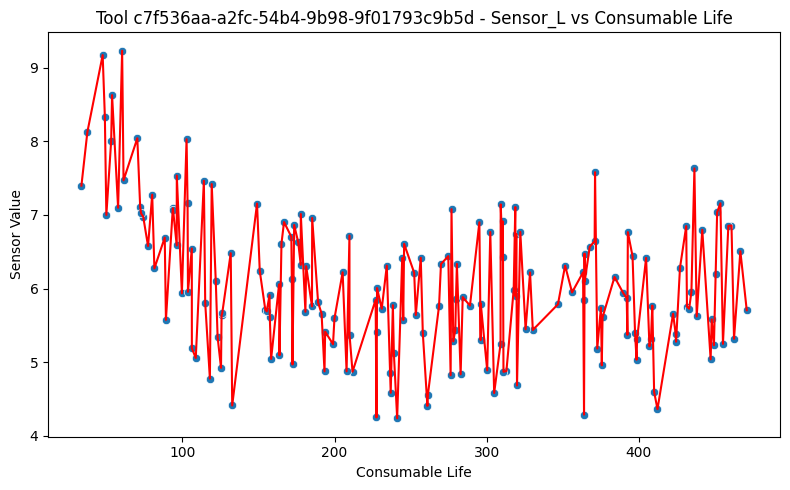

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


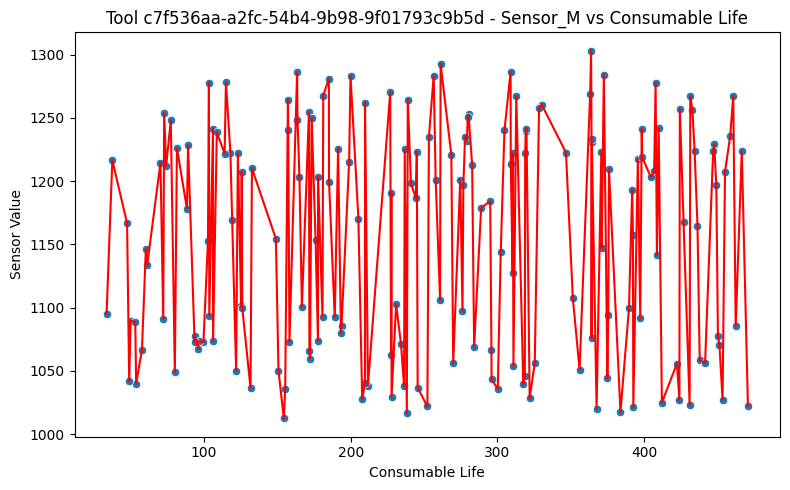

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


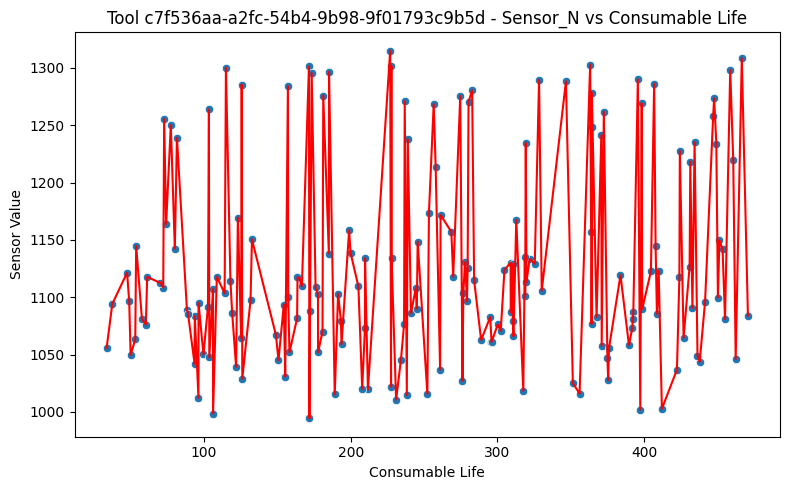

/var/folders/9w/hw9nd0vx0ps0zp0ctxjb21_80000gn/T/ipykernel_4255/3316384877.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


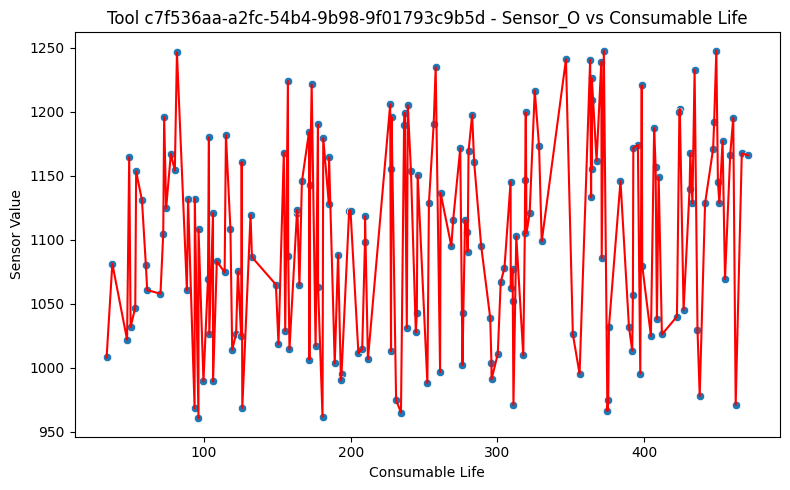

In [ ]:
# Unique Tool IDs
tool_ids = sensor_life_df["Tool ID"].unique()

# Loop over Tool IDs and Sensors
for tool_id in tool_ids:
    for sensor_name in sensors_to_plot:
        df_plot = sensor_life_df[
            (sensor_life_df["Tool ID"] == tool_id)
            & (sensor_life_df["Sensor Name"] == sensor_name)
        ]

        if len(df_plot) < 10:
            # Skip if too few data points
            continue

        # Plot
        plt.figure(figsize=(8, 5))
        sns.scatterplot(x="Consumable Life", y="Sensor Value", data=df_plot)
        sns.lineplot(
            x="Consumable Life", y="Sensor Value", data=df_plot, ci=None, color="red"
        )
        plt.title(f"Tool {tool_id} - {sensor_name} vs Consumable Life")
        plt.xlabel("Consumable Life")
        plt.ylabel("Sensor Value")
        plt.tight_layout()
        plt.show()


### Some tools 255 run IDs, some tools 180 - find out why

In [ ]:
# Count distinct Run IDs per Tool ID
tool_run_counts = run_data_df.groupby("Tool ID")["Run ID"].nunique().reset_index()
tool_run_counts = tool_run_counts.rename(columns={"Run ID": "Num_Runs"})

# Sort descending
tool_run_counts = tool_run_counts.sort_values("Num_Runs", ascending=False)

# Show
tool_run_counts

,Tool ID,Num_Runs
0,08e35986-3a0a-5274-8990-4ad303be9d5f,225
1,1914935a-df63-54c2-9c47-da905244e631,225
17,db66ded5-0f4f-5179-b8e7-4673304ddff1,225
16,d7291410-f34f-5cee-b3a1-0c60bb854423,225
14,bb7e0385-0227-575a-9894-dacc8bf07f2a,225
13,b3439d8e-290b-59a4-96a5-53348288f6a9,225
12,ad28cd71-3811-543c-80a1-a440468a49d7,225
11,ac40636d-b491-5620-8d16-9aad56e5c4d3,225
10,a060c807-dbdb-5de3-9cd7-0c596234a3d7,225
9,8a1010f8-7e9e-52ba-8586-2eac7e68eaee,225


In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

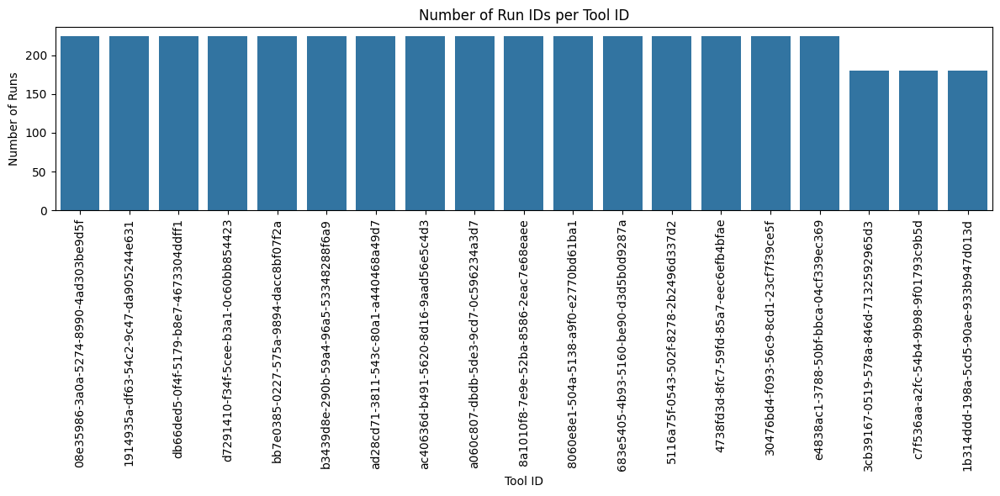

In [ ]:
plt.figure(figsize=(12, 6))
sns.barplot(x="Tool ID", y="Num_Runs", data=tool_run_counts)
plt.xticks(rotation=90)
plt.title("Number of Run IDs per Tool ID")
plt.xlabel("Tool ID")
plt.ylabel("Number of Runs")
plt.tight_layout()
plt.show()


#### count number of runs per tool ID

In [ ]:
tool_run_counts = run_data_df.groupby("Tool ID")["Run ID"].nunique().reset_index()
tool_run_counts = tool_run_counts.rename(columns={"Run ID": "Num_Runs"})


#### time range of runs per tool ID

In [ ]:
tool_time_range = (
    run_data_df.groupby("Tool ID")["Run Start Time"].agg(["min", "max"]).reset_index()
)
tool_time_range = tool_time_range.rename(
    columns={"min": "Min_Run_Start_Time", "max": "Max_Run_Start_Time"}
)


#### number of process steps per tool ID

In [ ]:
tool_process_counts = (
    run_data_df.groupby("Tool ID")["Process Step"].nunique().reset_index()
)
tool_process_counts = tool_process_counts.rename(
    columns={"Process Step": "Num_Process_Steps"}
)


#### combine into a table

In [ ]:
# Merge the 3 tables
tool_eda_df = tool_run_counts.merge(tool_time_range, on="Tool ID").merge(
    tool_process_counts, on="Tool ID"
)

# Sort by Num_Runs descending
tool_eda_df = tool_eda_df.sort_values("Num_Runs", ascending=False)

# Show the table
tool_eda_df


,Tool ID,Num_Runs,Min_Run_Start_Time,Max_Run_Start_Time,Num_Process_Steps
0,08e35986-3a0a-5274-8990-4ad303be9d5f,225,2024-01-01 00:00:00,2024-01-04 04:20:40,1
1,1914935a-df63-54c2-9c47-da905244e631,225,2024-01-01 00:00:00,2024-01-04 04:38:15,1
17,db66ded5-0f4f-5179-b8e7-4673304ddff1,225,2024-01-01 00:17:35,2024-01-04 04:38:15,1
16,d7291410-f34f-5cee-b3a1-0c60bb854423,225,2024-01-01 00:00:00,2024-01-04 04:38:15,1
14,bb7e0385-0227-575a-9894-dacc8bf07f2a,225,2024-01-01 00:00:00,2024-01-04 04:38:15,1
13,b3439d8e-290b-59a4-96a5-53348288f6a9,225,2024-01-01 00:00:00,2024-01-04 04:38:15,1
12,ad28cd71-3811-543c-80a1-a440468a49d7,225,2024-01-01 00:00:00,2024-01-04 04:38:15,1
11,ac40636d-b491-5620-8d16-9aad56e5c4d3,225,2024-01-01 00:00:00,2024-01-04 04:38:15,1
10,a060c807-dbdb-5de3-9cd7-0c596234a3d7,225,2024-01-01 00:00:00,2024-01-04 04:38:15,1
9,8a1010f8-7e9e-52ba-8586-2eac7e68eaee,225,2024-01-01 00:00:00,2024-01-04 04:38:15,1


the minimum run start time and number of process step is the same for all, however, for the max run start time, only 1 tool that has number of runs of 180 is earlier, but the other two runs of 180, is the same as the 225

Min Run Start Time is the same for all tools → all tools started logging at the same time → so no late tool start → not the cause of fewer runs

Num Process Steps is the same for all tools → all tools are used for the same recipes → so recipe coverage is not the cause of fewer runs.

Max Run Start Time:
    1 tool with 180 runs → earlier Max Run Start Time → this is likely due to tool went down / maintenance / stopped early → this explains this case.
    2 other tools with 180 runs → Max Run Start Time is the same as the 225 run tools → this means these 2 tools were still active till the end → but did fewer runs → we need to dig further.

For the first tool (early Max Run Start Time) → clear explanation → it stopped early → fewer runs → you can state this.

For the other 2 tools:
    They ran the full period → but only produced ~180 runs → possible reasons:
    Lower utilization → operator assigned fewer jobs to this tool.
    Higher cycle time → this tool runs take longer → so fewer runs in same period.
    More downtime per run → more maintenance per run → so fewer runs completed.
    Possible data missing → some Run IDs not captured (less likely if logging is clean)

#### Check average time per run per tool

In [ ]:
# Compute average run duration per Tool ID
run_data_df["Run_Duration"] = (
    run_data_df["Run End Time"] - run_data_df["Run Start Time"]
).dt.total_seconds()

# Take first record per Run ID (to avoid duplicates)
first_run_df = run_data_df.groupby("Run ID").first().reset_index()

# Now compute average run duration per Tool ID
tool_run_duration = first_run_df.groupby("Tool ID")["Run_Duration"].mean().reset_index()
tool_run_duration = tool_run_duration.rename(
    columns={"Run_Duration": "Avg_Run_Duration_sec"}
)

# Merge with your tool_eda_df
tool_eda_df = tool_eda_df.merge(tool_run_duration, on="Tool ID")

# Show updated table
tool_eda_df.sort_values("Num_Runs", ascending=False)


,Tool ID,Num_Runs,Min_Run_Start_Time,Max_Run_Start_Time,Num_Process_Steps,Avg_Run_Duration_sec
0,08e35986-3a0a-5274-8990-4ad303be9d5f,225,2024-01-01 00:00:00,2024-01-04 04:20:40,1,755.0
1,1914935a-df63-54c2-9c47-da905244e631,225,2024-01-01 00:00:00,2024-01-04 04:38:15,1,755.0
15,e4838ac1-3788-50bf-bbca-04cf339ec369,225,2024-01-01 00:00:00,2024-01-04 04:38:15,1,755.0
14,30476bd4-f093-56c9-8cd1-23cf7f39ce5f,225,2024-01-01 00:00:00,2024-01-04 04:38:15,1,755.0
13,4738fd3d-8fc7-59fd-85a7-eec6efb4bfae,225,2024-01-01 00:00:00,2024-01-04 04:38:15,1,755.0
12,5116a75f-0543-502f-8278-2b2496d337d2,225,2024-01-01 00:00:00,2024-01-04 04:38:15,1,755.0
11,683e5405-4b93-5160-be90-d3d5b0d9287a,225,2024-01-01 00:00:00,2024-01-04 04:38:15,1,755.0
10,8060e8e1-504a-5138-a9f0-e2770bd61ba1,225,2024-01-01 00:00:00,2024-01-04 04:38:15,1,755.0
9,8a1010f8-7e9e-52ba-8586-2eac7e68eaee,225,2024-01-01 00:00:00,2024-01-04 04:38:15,1,755.0
8,a060c807-dbdb-5de3-9cd7-0c596234a3d7,225,2024-01-01 00:00:00,2024-01-04 04:38:15,1,755.0


Average run time is the same for all.

Currently, rule out three causes:
    1. Min Run Start Time → same → not late start.
    2. Num Process Steps → same → not restricted recipe.
    3. Avg Run Duration → same → not slower runs.

But, two tools remained unexplained:
    Have full Max Run Start Time → ran full time period.
    Have same Avg Run Duration.
    Have fewer runs (~180 vs 225).   

### gap analysis

In [ ]:
# First record per Run ID
first_run_df = run_data_df.groupby("Run ID").first().reset_index()

# Keep only needed columns
first_run_df = first_run_df[["Run ID", "Tool ID", "Run Start Time"]]


#### For each Tool ID → compute time between consecutive runs

In [ ]:
# For each Tool ID, compute time delta between consecutive runs
gap_list = []

for tool_id, df_tool in first_run_df.groupby("Tool ID"):
    df_tool = df_tool.sort_values("Run Start Time")
    df_tool["Gap_sec"] = df_tool["Run Start Time"].diff().dt.total_seconds()

    # Store results
    gap_list.append(
        pd.DataFrame({"Tool ID": tool_id, "Gap_sec": df_tool["Gap_sec"].dropna()})
    )

# Combine all results
gap_df = pd.concat(gap_list, ignore_index=True)


#### Summarize gaps per Tool ID

In [ ]:
# Compute avg gap per tool
gap_summary = (
    gap_df.groupby("Tool ID")["Gap_sec"]
    .agg(["mean", "median", "max", "count"])
    .reset_index()
)
gap_summary = gap_summary.rename(
    columns={
        "mean": "Avg_Gap_sec",
        "median": "Median_Gap_sec",
        "max": "Max_Gap_sec",
        "count": "Num_Gaps",
    }
)

# Merge with tool_eda_df
tool_eda_df = tool_eda_df.merge(gap_summary, on="Tool ID")

# Show full combined table
print(tool_eda_df.sort_values("Num_Runs", ascending=False))


                                 Tool ID  Num_Runs  Min_Run_Start_Time  \
0   08e35986-3a0a-5274-8990-4ad303be9d5f       225 2024-01-01 00:00:00   
1   1914935a-df63-54c2-9c47-da905244e631       225 2024-01-01 00:00:00   
15  e4838ac1-3788-50bf-bbca-04cf339ec369       225 2024-01-01 00:00:00   
14  30476bd4-f093-56c9-8cd1-23cf7f39ce5f       225 2024-01-01 00:00:00   
13  4738fd3d-8fc7-59fd-85a7-eec6efb4bfae       225 2024-01-01 00:00:00   
12  5116a75f-0543-502f-8278-2b2496d337d2       225 2024-01-01 00:00:00   
11  683e5405-4b93-5160-be90-d3d5b0d9287a       225 2024-01-01 00:00:00   
10  8060e8e1-504a-5138-a9f0-e2770bd61ba1       225 2024-01-01 00:00:00   
9   8a1010f8-7e9e-52ba-8586-2eac7e68eaee       225 2024-01-01 00:00:00   
8   a060c807-dbdb-5de3-9cd7-0c596234a3d7       225 2024-01-01 00:00:00   
7   ac40636d-b491-5620-8d16-9aad56e5c4d3       225 2024-01-01 00:00:00   
6   ad28cd71-3811-543c-80a1-a440468a49d7       225 2024-01-01 00:00:00   
5   b3439d8e-290b-59a4-96a5-53348288f6

the other 2 tools with 180 runs, had higher avg gap sec, meaning that they had more idle time, fewer runs completed. 

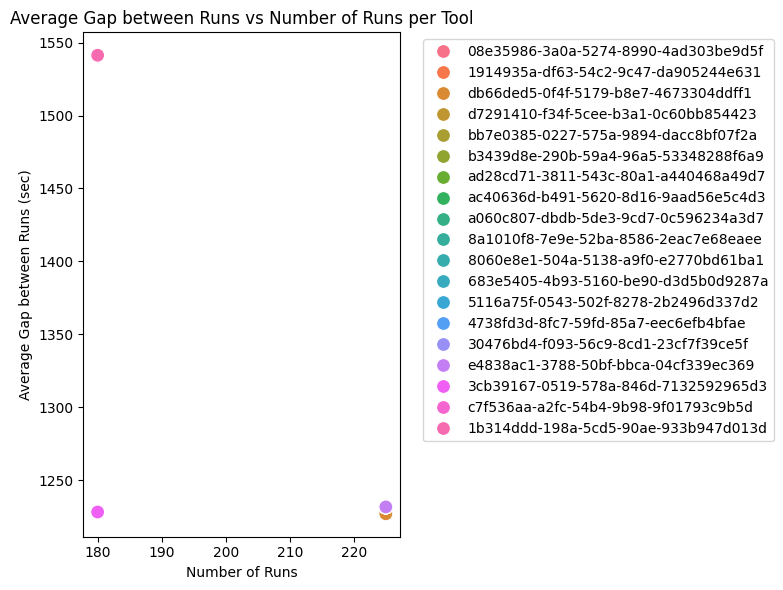

In [ ]:
plt.figure(figsize=(8, 6))

sns.scatterplot(
    x="Num_Runs",
    y="Avg_Gap_sec",
    data=tool_eda_df,
    hue="Tool ID",
    s=100,  # make points bigger
)

plt.title("Average Gap between Runs vs Number of Runs per Tool")
plt.xlabel("Number of Runs")
plt.ylabel("Average Gap between Runs (sec)")
plt.legend(bbox_to_anchor=(1.05, 1), loc="upper left")
plt.tight_layout()
plt.show()

Main pattern:
Tools with ~225 runs → all clustered on right (Num_Runs ≈ 225).

    Their Avg_Gap_sec is low and about the same → these tools were kept busy → small idle time → high utilization.
    Tools with ~180 runs → on left (Num_Runs ≈ 180).
    Their Avg_Gap_sec is clearly higher → more idle time between runs → explains why they have fewer runs.

This matches the exact reasoning:
    Tools with higher idle time → fewer runs completed → not due to slow runs or fewer recipes → due to idle time / scheduling / downtime.

Other tools (225 runs)	Small gaps → well utilized → completed more runs
One tool (180 runs) stopped early	Clear cause → stopped early → fewer runs
Two tools (180 runs, full time window)	Larger average gaps → more idle → explains fewer runs

### Utilization

In [40]:
# Compute Run Duration per row (already done previously)
run_data_df["Run_Duration"] = (
    run_data_df["Run End Time"] - run_data_df["Run Start Time"]
).dt.total_seconds()

# First record per Run ID → to avoid duplicate rows
first_run_df = run_data_df.groupby("Run ID").first().reset_index()

# Keep relevant columns
first_run_df = first_run_df[
    ["Run ID", "Tool ID", "Run Start Time", "Run End Time", "Run_Duration"]
]


In [41]:
# Total run time per tool
tool_total_run_time = (
    first_run_df.groupby("Tool ID")["Run_Duration"].sum().reset_index()
)
tool_total_run_time = tool_total_run_time.rename(
    columns={"Run_Duration": "Total_Run_Time_sec"}
)

In [42]:
# Min and Max Run Start Time per tool → total available window
tool_time_range = (
    run_data_df.groupby("Tool ID")["Run Start Time"].agg(["min", "max"]).reset_index()
)
tool_time_range["Available_Time_sec"] = (
    tool_time_range["max"] - tool_time_range["min"]
).dt.total_seconds()

# Keep columns we need
tool_time_range = tool_time_range.rename(
    columns={"min": "Min_Run_Start_Time", "max": "Max_Run_Start_Time"}
)


In [43]:
# Merge run time and available time
tool_utilization_df = tool_total_run_time.merge(
    tool_time_range[["Tool ID", "Available_Time_sec"]], on="Tool ID"
)

# Compute Utilization %
tool_utilization_df["Utilization_percent"] = (
    tool_utilization_df["Total_Run_Time_sec"]
    / tool_utilization_df["Available_Time_sec"]
) * 100

# Sort descending
tool_utilization_df = tool_utilization_df.sort_values(
    "Utilization_percent", ascending=False
)

# Show final table
tool_utilization_df


,Tool ID,Total_Run_Time_sec,Available_Time_sec,Utilization_percent
4,3cb39167-0519-578a-846d-7132592965d3,135900.0,219845.0,61.816280
0,08e35986-3a0a-5274-8990-4ad303be9d5f,169875.0,274840.0,61.808689
17,db66ded5-0f4f-5179-b8e7-4673304ddff1,169875.0,274840.0,61.808689
10,a060c807-dbdb-5de3-9cd7-0c596234a3d7,169875.0,275895.0,61.572337
16,d7291410-f34f-5cee-b3a1-0c60bb854423,169875.0,275895.0,61.572337
14,bb7e0385-0227-575a-9894-dacc8bf07f2a,169875.0,275895.0,61.572337
13,b3439d8e-290b-59a4-96a5-53348288f6a9,169875.0,275895.0,61.572337
12,ad28cd71-3811-543c-80a1-a440468a49d7,169875.0,275895.0,61.572337
11,ac40636d-b491-5620-8d16-9aad56e5c4d3,169875.0,275895.0,61.572337
9,8a1010f8-7e9e-52ba-8586-2eac7e68eaee,169875.0,275895.0,61.572337


Tools with ~225 runs → should have higher Utilization % → more busy.
Tools with ~180 runs but full time window → should have lower Utilization % → more idle → matches Gap plot.
Tool that stopped early → Utilization % may still be high (if it ran constantly until it stopped), or lower.

### Utilization report

In [45]:
tool_run_counts = run_data_df.groupby("Tool ID")["Run ID"].nunique().reset_index()
tool_run_counts = tool_run_counts.rename(columns={"Run ID": "Num_Runs"})


In [46]:
# Merge Utilization % with Num_Runs
utilization_plot_df = tool_utilization_df.merge(tool_run_counts, on="Tool ID")


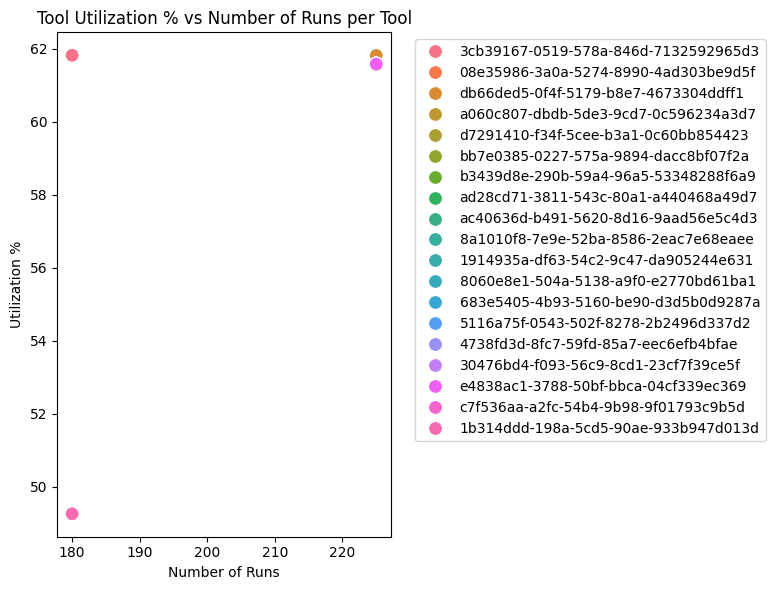

In [48]:
plt.figure(figsize=(8, 6))

sns.scatterplot(
    x="Num_Runs",
    y="Utilization_percent",
    data=utilization_plot_df,
    hue="Tool ID",
    s=100,
)

plt.title("Tool Utilization % vs Number of Runs per Tool")
plt.xlabel("Number of Runs")
plt.ylabel("Utilization %")
plt.legend(bbox_to_anchor=(1.05, 1), loc="upper left")
plt.tight_layout()
plt.show()
